```
##################################################################
┌──────────────────────────────────────────────────────────────┐  
│**************************************************************│  
│*****************___***********_******************************│  
│****************/ __\__*_*_*__| |__***___**_*__***************│  
│***************/ /  / _` | '__| '_ \*/ _ \| '_ \**************│  
│**************/ /__| (_| | |**| |_) | (_) | |*| |*************│  
│**************\____/\__,_|_|**|_.__/*\___/|_|*|_|*************│  
│**************************************************************│  
│****************_********_************************************│  
│*****/\/\***___| |_*__*_| |*___*_*__**___**___**___***********│  
│****/    \*/ _ \ __/ _` | |/ _ \ '_ \/ __|/ _ \/ __|**_____***│  
│***/ /\/\ \  __/ || (_| | |  __/ |*| \__ \  __/\__ \*|_____|**│  
│***\/****\/\___|\__\__,_|_|\___|_|*|_|___/\___||___/**********│  
│**************************************************************│  
│*************************_*******_******_*********************│  
│******************/\***/(_)*___*| |*___| |_*******************│  
│***********ULTRA**\ \*/ / |/ _ \| |/ _ \ __|******************│  
│*******************\ V /| | (_) | |  __/ |_*******************│  
│********************\_/*|_|\___/|_|\___|\__|******************│  
│**************************************************************│  
└──────────────────────────────────────────────────────────────┘  
##################################################################
```

Here David is learning how to use equivalent currents to generate fields, and also how to efficiently propage fields in 3D FDTD simulations performed with MEEP.

In [8]:
import meep as mp
import numpy as np
# %matplotlib notebook
from matplotlib import pyplot as plt
%config InlineBackend.figure_format ='retina'
import os
import uuid
import subprocess
import pickle
import time
import sys
from matplotlib.colors import ListedColormap, LogNorm, Normalize
import h5py
home_folder = os.path.expanduser('~')

if sys.platform == 'darwin':
    sys.path.append(os.path.join(home_folder,
                    'Google Drive/Zia Lab/Codebase/zialab'))
else:
    print("Make amends for Windows or your other OS.")
sys.path.append(os.getcwd())

%reload_ext autoreload
%autoreload 2
from cem.metalenses_5 import *
import datetime
from tabulate import tabulate
import pyperclip
import itertools
from scipy.ndimage.filters import gaussian_filter
from itertools import product
from cem.standard_candle import *
import matplotlib.colors as colors
print('MEEP version %s' % mp.__version__)

MEEP version 1.16.1


## H = 10, sim_cell_width = 20, focusing at infinity

In [9]:
metalenses_dir = '~/Google Drive/Zia Lab/Log/Metalenses'

Running RCWA calculations...
0.24077007108856868


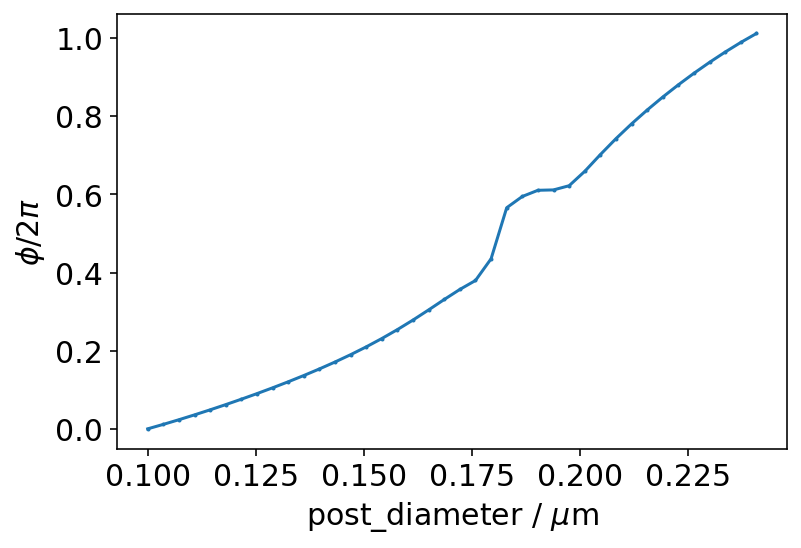

Calculating honeycomb grid...
Evaluating the required phases according to the given phase profile...
Evaluating the required posts radii to produce the required phases...
Creating the posts in the simulation volume...
Plotting metasurface layout


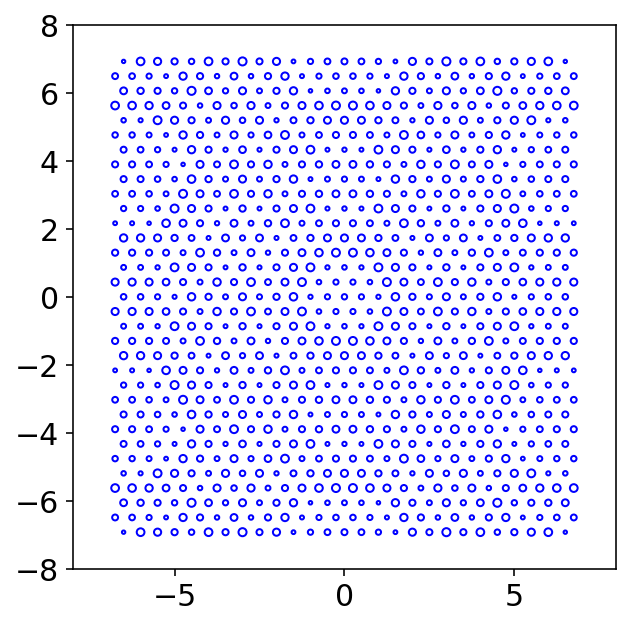

Plotting vertical cross section...


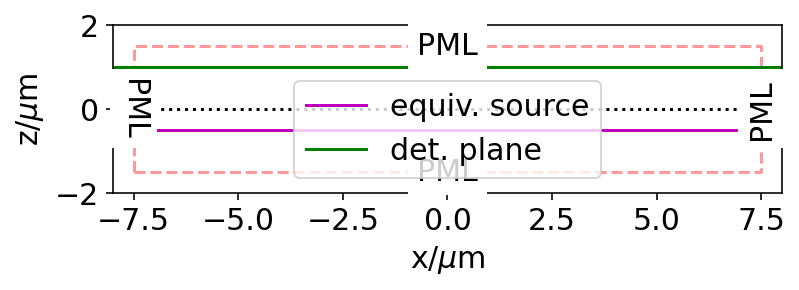

Plotting the bigger picture...


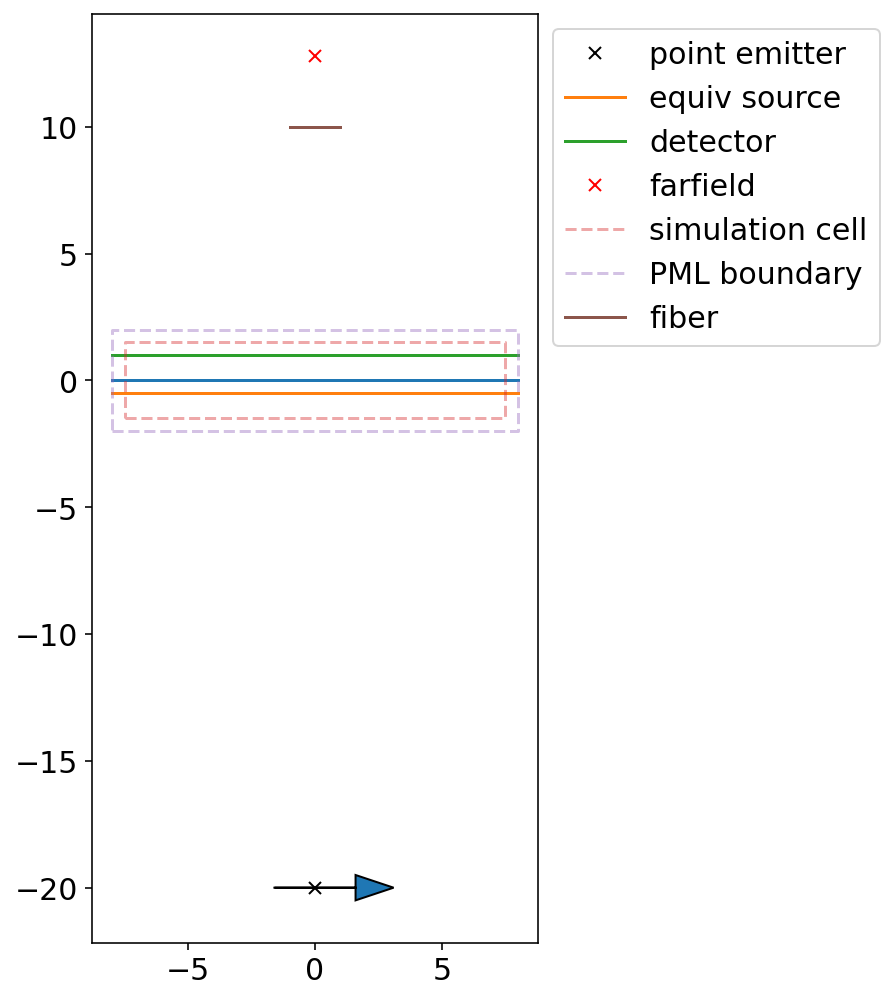

Setting up the simulation cell...
Setting up the equivalent currents...
Setting up the geometry...
-----------
Initializing structure...
time for choose_chunkdivision = 0.00621915 s
Working in 3D dimensions.
Computational cell is 16 x 16 x 4 with resolution 25
     block, center = (0,0,-1)
          size (16,16,2)
          axes (1,0,0), (0,1,0), (0,0,1)
          dielectric constant epsilon diagonal = (5.8418,5.8418,5.8418)
     block, center = (0,0,1)
          size (16,16,2)
          axes (1,0,0), (0,1,0), (0,0,1)
          dielectric constant epsilon diagonal = (1,1,1)
     cylinder, center = (-6.5,-6.9282,0.4)
          radius 0.05, height 0.8, axis (0, 0, 1)
          dielectric constant epsilon diagonal = (5.8418,5.8418,5.8418)
     cylinder, center = (-6.75,-6.49519,0.4)
          radius 0.0868704, height 0.8, axis (0, 0, 1)
          dielectric constant epsilon diagonal = (5.8418,5.8418,5.8418)
     cylinder, center = (-6,-6.9282,0.4)
          radius 0.113745, height 0.8, ax

Meep progress: 4.44/6.833963177352513 = 65.0% done in 198.6s, 107.1s to go
on time step 222 (time=4.44), 0.772004 s/step
Meep progress: 4.5600000000000005/6.833963177352513 = 66.7% done in 203.2s, 101.3s to go
on time step 228 (time=4.56), 0.771261 s/step
Meep progress: 4.68/6.833963177352513 = 68.5% done in 207.8s, 95.6s to go
on time step 234 (time=4.68), 0.772332 s/step
Meep progress: 4.8/6.833963177352513 = 70.2% done in 212.5s, 90.0s to go
on time step 240 (time=4.8), 0.773084 s/step
Meep progress: 4.92/6.833963177352513 = 72.0% done in 217.1s, 84.5s to go
on time step 246 (time=4.92), 0.780622 s/step
Meep progress: 5.04/6.833963177352513 = 73.7% done in 221.8s, 78.9s to go
on time step 252 (time=5.04), 0.768447 s/step
Meep progress: 5.16/6.833963177352513 = 75.5% done in 226.5s, 73.5s to go
on time step 258 (time=5.16), 0.787262 s/step
Meep progress: 5.28/6.833963177352513 = 77.3% done in 231.2s, 68.0s to go
on time step 264 (time=5.28), 0.784465 s/step
Meep progress: 5.4/6.83396

In [22]:
metalens = {'resolution': 25,
            'epsilon_bottom': 5.8418,
            'epsilon_top': 1.0,
            'sim_cell_width': 16.,
            'sim_cell_height': 4.,
            'PML_width': 0.5,
            'wavelength': 0.6, # in vacuum
            'symmetries': [],
            'complex_fields': True,
            'num_cores': 1,
            'quiet':False,
            'source_width':0,
            'cell_width': 0.5,
            'post_height': 0.8,
            'start_time': time(),
            'min_post_diameter': 0.1,
            'save_to_pkl': False,
            'metalens_id': str(time()).split('.')[0],
            'R': 7.0, # radius of the metalens
            'l': 0.5, # breathing space between current plane and PML boundary
            'w': 1, # radius of the detector surface
            'd': 10.,  # distance between top of posts and detector surface
            'dip_dir':{'phi':np.pi/2., 'theta':0.},
            'nf': 1.0, # z coordinate where the field is collected
            'H': 20., # depth of dipole wrt to middle of sim volume
            's': 0.5} # depth of the equiv current plane wrt to z=0
assert metalens['nf'] > metalens['post_height'], "nearfield must be collected after the metalens"
assert metalens['R'] <= (metalens['sim_cell_width']/2-metalens['PML_width']-metalens['l']), "lens won't fit"
metalens['ff'] = 1.2*metalens['d'] + metalens['post_height'] # z coordinate until which the farfield will be computed
metalens['n_bottom'] = np.sqrt(metalens['epsilon_bottom'])
metalens['n'] = metalens['n_bottom']
metalens['n_top'] = np.sqrt(metalens['epsilon_top'])
metalens['wavelength_bottom'] = metalens['wavelength']/np.sqrt(metalens['epsilon_bottom'])
metalens['wavelength_top'] = metalens['wavelength']/np.sqrt(metalens['epsilon_top'])
metalens['sim_time'] = metalens['sim_cell_height']/2*(metalens['n_bottom']+metalens['n_top'])
metalens['source_coord'] = - metalens['H']
metalens['k_bottom'] = 2*np.pi/metalens['wavelength_bottom']
metalens['k_top'] = 2*np.pi/metalens['wavelength_top']
metalens['ws'] = metalens['sim_cell_width']-2*metalens['PML_width'] -2*metalens['l'] #  the width of the equiv corruent plane

####################################################
####################################################

print("Running RCWA calculations...")
simulation_parameters = {'min_post_diameter': metalens['min_post_diameter'],
                        'wavelength': metalens['wavelength'],
                        'post_width': metalens['cell_width']*0.1,
                        'post_height': metalens['post_height'],
                        'cell_width': metalens['cell_width'],
                        'epsilon': metalens['epsilon_bottom'],
                        'num_G' : 70,
                        'x_coord': 0,
                        'y_coord': 0,
                        'pol': 's',
                        'sim_id' : str(int(time())),
                        's_amp': 1, 'p_amp': 0}
simulation_parameters = expand_sim_params(simulation_parameters)

post_diameters = np.linspace(simulation_parameters['min_post_diameter'],
                             simulation_parameters['cell_width']*0.95,
                             40)
phases = []
simulation_parameters['field_height'] = simulation_parameters['post_height']
for p_width in post_diameters:
    simulation_parameters['post_width'] = p_width
    simulation_parameters = expand_sim_params(simulation_parameters)
    Exr, Eyr, Ezr, Exi, Eyi, Ezi = post_field(simulation_parameters)
    if simulation_parameters['pol'] == 'p':
        phases.append(np.arctan2(Exi, Exr))
    else:
        phases.append(np.arctan2(Eyi, Eyr))
phases = np.array(phases)
phases = np.unwrap(phases)
phases = phases - phases[0]
critical_width = np.interp(2*np.pi*1.01,phases,post_diameters)
print(critical_width)
post_diameters = np.linspace(simulation_parameters['min_post_diameter'],
                             critical_width,
                             40)
phases = []
simulation_parameters['field_height'] = simulation_parameters['post_height']
for p_width in post_diameters:
    simulation_parameters['post_width'] = p_width
    simulation_parameters = expand_sim_params(simulation_parameters)
    Exr, Eyr, Ezr, Exi, Eyi, Ezi = post_field(simulation_parameters)
    if simulation_parameters['pol'] == 'p':
        phases.append(np.arctan2(Exi, Exr))
    else:
        phases.append(np.arctan2(Eyi, Eyr))
phases = np.array(phases)
phases = np.unwrap(phases)
phases = phases - phases[0]

metalens['phases'] = phases
metalens['widths'] = post_diameters

plt.rcParams.update({'font.size': 15})
plt.figure()
plt.plot(post_diameters,phases / (2*np.pi),'o-',ms=1.)
plt.xlabel('post_diameter / $\mu$m')
plt.ylabel('$\phi/2\pi$')
plt.show()

####################################################
####################################################

print("Calculating honeycomb grid...")
grid_centers = []
ex = np.array([metalens['cell_width'],0])
ey = np.array([-metalens['cell_width']*0.5,metalens['cell_width']*0.866025])
left_margin = (-metalens['sim_cell_width']/2 + metalens['PML_width'] + metalens['cell_width'])
right_margin = (metalens['sim_cell_width']/2 - metalens['PML_width'] - metalens['cell_width'])
Nx = 2*int(metalens['sim_cell_width']/2/metalens['cell_width'])
Ny = Nx
metalens['post_centers'] = np.array([(nx*ex + ny*ey) for nx in range(-Nx,Nx+1) for ny in range(-Ny,Ny+1)])
metalens['post_centers'] = metalens['post_centers'][np.abs(metalens['post_centers'][:,0]) < right_margin]
metalens['post_centers'] = metalens['post_centers'][np.abs(metalens['post_centers'][:,1]) < right_margin]

####################################################
####################################################

print("Evaluating the required phases according to the given phase profile...")
metalens['required_phases'] = np.array([imaging_phase_profile(**metalens, x = p[0], y = p[1]) for p in metalens['post_centers']])
metalens['required_phases'] = metalens['required_phases'] - min(metalens['required_phases'])
metalens['required_phases'] = metalens['required_phases'] % (2*np.pi)

print("Evaluating the required posts radii to produce the required phases...")
x, y = function_topper(metalens['widths'], metalens['phases'])
metalens['required_diameters'] = np.interp(metalens['required_phases'],y,x)

print("Creating the posts in the simulation volume...")
the_posts = [mp.Cylinder(radius=w/2, height=metalens['post_height'],
                         center = mp.Vector3(position[0],position[1], (metalens['post_height']/2)),
                  material = mp.Medium(epsilon = metalens['epsilon_bottom']))
                for w, position in zip(metalens['required_diameters'], metalens['post_centers'])]

####################################################
####################################################

print("Plotting metasurface layout")
fig, ax = plt.subplots(figsize=(5,5))
for (x,y),d in zip(metalens['post_centers'],metalens['required_diameters']):
    ax.add_artist(plt.Circle((x,y),
                  radius=d/2,
                  color='b',
                  fill=False))
ax.set_xlim(-metalens['sim_cell_width']/2,
           metalens['sim_cell_width']/2)
ax.set_ylim(-metalens['sim_cell_width']/2,
           metalens['sim_cell_width']/2)
ax.set_aspect('equal')
plt.show()

####################################################
####################################################

print("Plotting vertical cross section...")
fig, ax = plt.subplots(figsize=(6,4))
ax.plot([-metalens['sim_cell_width']/2+metalens['PML_width'],
               metalens['sim_cell_width']/2-metalens['PML_width'],
              metalens['sim_cell_width']/2-metalens['PML_width'],
              -metalens['sim_cell_width']/2+metalens['PML_width'],
              -metalens['sim_cell_width']/2+metalens['PML_width']],
             [-metalens['sim_cell_height']/2+metalens['PML_width'],
             -metalens['sim_cell_height']/2+metalens['PML_width'],
             metalens['sim_cell_height']/2-metalens['PML_width'],
             metalens['sim_cell_height']/2-metalens['PML_width'],
             -metalens['sim_cell_height']/2+metalens['PML_width']],
              'r--',alpha=0.4)
ax.text(0,metalens['sim_cell_height']/2-metalens['PML_width'],
        'PML',va='center',ha='center',backgroundcolor='white')
ax.text(0,-metalens['sim_cell_height']/2+metalens['PML_width'],
        'PML',va='center',ha='center',backgroundcolor='white')
ax.text(metalens['sim_cell_width']/2-metalens['PML_width'],0,
        'PML',va='center',ha='center',backgroundcolor='white',rotation=90)
ax.text(-metalens['sim_cell_width']/2+metalens['PML_width'],0,
        'PML',va='center',ha='center',backgroundcolor='white',rotation=-90)
ax.text(0,metalens['sim_cell_height']/2-metalens['PML_width'],
        'PML',va='center',ha='center',backgroundcolor='white')
ax.plot([-metalens['ws']/2,metalens['ws']/2],[-metalens['s']]*2,'m-',label='equiv. source')
ax.plot([-metalens['sim_cell_width']/2,metalens['sim_cell_width']/2],[metalens['nf']]*2,'g-',label='det. plane')
ax.plot([-metalens['sim_cell_width']/2,metalens['sim_cell_width']/2],[0,0],'k:')
ax.set_aspect('equal')
ax.set_xlabel('x/$\mu$m')
ax.set_ylabel('z/$\mu$m')
ax.legend()
ax.set_xlim(-metalens['sim_cell_width']/2,metalens['sim_cell_width']/2)
ax.set_ylim(-metalens['sim_cell_height']/2,metalens['sim_cell_height']/2)
plt.show()

####################################################
####################################################

print("Plotting the bigger picture...")
fig, ax = plt.subplots(figsize=(4,4*(metalens['ff']+metalens['H'])))
ax.plot([-metalens['sim_cell_width']/2,metalens['sim_cell_width']/2],
        [0,0])
ax.plot([0],
        [-metalens['H']],'kx',label='point emitter')
ax.plot([-metalens['sim_cell_width']/2,metalens['sim_cell_width']/2],
        [-metalens['s'],-metalens['s']],label='equiv source')
ax.plot([-metalens['sim_cell_width']/2,metalens['sim_cell_width']/2],
        [metalens['nf'],metalens['nf']],label='detector')
ax.plot([0],
        [metalens['ff']],'rx',label='farfield')
ax.plot([-metalens['sim_cell_width']/2+metalens['PML_width'],
            metalens['sim_cell_width']/2-metalens['PML_width'],
            metalens['sim_cell_width']/2-metalens['PML_width'],
            -metalens['sim_cell_width']/2+metalens['PML_width'],
            -metalens['sim_cell_width']/2+metalens['PML_width']],
            [-metalens['sim_cell_height']/2+metalens['PML_width'],
            -metalens['sim_cell_height']/2+metalens['PML_width'],
            metalens['sim_cell_height']/2-metalens['PML_width'],
            metalens['sim_cell_height']/2-metalens['PML_width'],
            -metalens['sim_cell_height']/2+metalens['PML_width']],
            '--',alpha=0.4,label='simulation cell')
ax.plot([-metalens['sim_cell_width']/2,
            metalens['sim_cell_width']/2,
            metalens['sim_cell_width']/2,
            -metalens['sim_cell_width']/2,
            -metalens['sim_cell_width']/2],
            [-metalens['sim_cell_height']/2,
            -metalens['sim_cell_height']/2,
            metalens['sim_cell_height']/2,
            metalens['sim_cell_height']/2,
            -metalens['sim_cell_height']/2],
            '--',alpha=0.4,label='PML boundary')
ax.arrow(-np.sin(metalens['dip_dir']['phi'])*metalens['sim_cell_width']*0.1,
         -metalens['H']-np.cos(metalens['dip_dir']['phi'])*metalens['sim_cell_width']*0.1,
       2*np.sin(metalens['dip_dir']['phi'])*metalens['sim_cell_width']*0.1,
       2*np.cos(metalens['dip_dir']['phi'])*metalens['sim_cell_width']*0.1,
         head_width=metalens['H']*0.05
       )
ax.plot([-metalens['w'],metalens['w']],[metalens['d']]*2, label='fiber')
ax.set_aspect('equal')
ax.legend(bbox_to_anchor=(1, 1), loc='upper left', ncol=1)
plt.show()

####################################################
####################################################

print("Setting up the simulation cell...")
sim_cell = mp.Vector3(metalens['sim_cell_width'],
                      metalens['sim_cell_width'],
                      metalens['sim_cell_height'])
pml_layers = [ mp.PML(metalens['PML_width']) ]
metalens['source_funcs'] = equiv_currents_bottom(metalens)

####################################################
####################################################

print("Setting up the equivalent currents...")
sources = []
for m_comp, m_comp_name in zip([mp.Ex,mp.Ey,mp.Ez,mp.Hx,mp.Hy,mp.Hz],
                                ['JEx','JEy','JEz','JHx','JHy','JHz']):
    this_source = mp.Source(src=mp.ContinuousSource(
                        wavelength=metalens['wavelength_bottom'],
                        width=metalens['source_width']),
                    component=m_comp,
                    amp_func = metalens['source_funcs'][m_comp_name],
                    center = mp.Vector3(0,0,-metalens['s']),
                    size = mp.Vector3(metalens['ws'], metalens['ws'], 0))
    sources.append(this_source)

####################################################
####################################################

print("Setting up the geometry...")
bottom_chunk = mp.Block(size = mp.Vector3(
                metalens['sim_cell_width'],
                metalens['sim_cell_width'],
                metalens['sim_cell_height']/2),
                center = mp.Vector3(0,0,-metalens['sim_cell_height']/4),
                material = mp.Medium(epsilon = metalens['epsilon_bottom']))
top_chunk = mp.Block(size = mp.Vector3(
                metalens['sim_cell_width'],
                metalens['sim_cell_width'],
                metalens['sim_cell_height']/2),
                center = mp.Vector3(0,0,metalens['sim_cell_height']/4),
                material = mp.Medium(epsilon = metalens['epsilon_top']))

metalens['geometry'] = [bottom_chunk, top_chunk] + the_posts

sim = mp.Simulation(cell_size=sim_cell,
                boundary_layers=pml_layers,
                geometry=metalens['geometry'],
                force_complex_fields=metalens['complex_fields'],
                sources=sources,
                resolution=metalens['resolution'])
sim.init_sim()

metalens['x_coords'], metalens['y_coords'], metalens['z_coords'], _ = (
                list(map(np.array,sim.get_array_metadata())))
metalens['detector_index'] = np.argmin(np.abs(metalens['z_coords'] - metalens['d']))
start_time = time()

####################################################
####################################################

print("Running the simulation...")
sim.run(until=metalens['sim_time'])
metalens['simulation_run_time_in_min'] = (time() - start_time)/60.
metalens['fields'] = {'Ex': sim.get_array(component=mp.Ex),
                    'Ey': sim.get_array(component=mp.Ey),
                    'Ez': sim.get_array(component=mp.Ez),
                    'Hx': sim.get_array(component=mp.Hx),
                    'Hy': sim.get_array(component=mp.Hy),
                    'Hz': sim.get_array(component=mp.Hz)}
metalens['computed_fields'] = {}
metalens['computed_fields']['E2'] = (np.abs(metalens['fields']['Ex'])**2 + 
                  np.abs(metalens['fields']['Ey'])**2 + 
                  np.abs(metalens['fields']['Ez'])**2)

####################################################
####################################################

print("Collecting fields at the detector plane...")
metalens['detector_fields'] = {}
for field_name in ['Ex','Ey','Ez','Hx','Hy','Hz']:
    metalens['detector_fields'][field_name] = metalens['fields'][field_name][:,:,metalens['detector_index']].T

metalens['eps'] = sim.get_epsilon()
metalens['mid_post_idx'] = np.argmin(np.abs(metalens['z_coords']-metalens['post_height']/2))
metalens['x=0_plane_idx'] = np.argmin(np.abs(metalens['x_coords']))
metalens['y=0_plane_idx'] = np.argmin(np.abs(metalens['y_coords']))

####################################################
####################################################

if metalens['save_to_pkl']:
    print("Saving to pkl...")
    del metalens['source_funcs']
    del metalens['geometry']
    pkl_fname = os.path.join(metalenses_dir,'metalens-%s.pkl' % metalens['metalens_id'])
    pickle.dump(metalens,open(pkl_fname,'wb'))

####################################################
####################################################

print("Computing farfield...")
metalens['farfields'] = {}
farfield_axis = np.linspace(metalens['nf'],
                metalens['ff'],
                int((metalens['ff']-metalens['nf'])*metalens['resolution']))
metalens['farfield_axis'] = farfield_axis
one_field = metalens['detector_fields']['Ex']
idx_width = one_field.shape[0]
one_field = np.pad(one_field,(idx_width,idx_width))
metalens['kx_freqs'] = 2*np.pi*np.fft.fftfreq(
                            idx_width*3,
                            d=1./metalens['resolution'])
metalens['ky_freqs'] = 2*np.pi*np.fft.fftfreq(
                            idx_width*3,
                            d=1./metalens['resolution'])
(metalens['kx_freqs_v'], metalens['ky_freqs_v']) = np.meshgrid(metalens['kx_freqs'],metalens['ky_freqs'])
metalens['kz'] = np.sqrt(0.j+metalens['k_top']**2-metalens['kx_freqs_v']**2-metalens['ky_freqs_v']**2)
gator = np.exp(1.j*np.outer(farfield_axis-metalens['nf'],
        metalens['kz']).reshape((*farfield_axis.shape,*metalens['kz'].shape)))

for field_label in ['Ex','Ey','Ez']:
    print('Computing the farfield for %s...' % field_label)
    one_field = metalens['detector_fields'][field_label]
    one_field = np.pad(one_field,(idx_width,idx_width))
    one_field = one_field[np.newaxis,:]
    nearfourier = (np.fft.fft2(one_field))
    farfourier = nearfourier*gator
    metalens['farfields'][field_label] = np.fft.ifft2(farfourier)
metalens['computed_farfields'] = {}
metalens['computed_farfields']['E2'] = np.abs(np.abs(metalens['farfields']['Ex'])**2+np.abs(metalens['farfields']['Ey'])**2+np.abs(metalens['farfields']['Ez'])**2)

!pushover "done"

In [ ]:
if metalens['save_to_pkl']:
    print("Saving to pkl...")
    pkl_fname = os.path.join(metalenses_dir,'metalens-%s.pkl' % metalens['metalens_id'])
    pickle.dump(metalens,open(pkl_fname,'wb'))

Saving to pkl...


In [18]:
del metalens['geometry']

In [23]:
metalens.keys()
# del metalens['']

dict_keys(['resolution', 'epsilon_bottom', 'epsilon_top', 'sim_cell_width', 'sim_cell_height', 'PML_width', 'wavelength', 'symmetries', 'complex_fields', 'num_cores', 'quiet', 'source_width', 'cell_width', 'post_height', 'start_time', 'min_post_diameter', 'save_to_pkl', 'metalens_id', 'R', 'l', 'w', 'd', 'dip_dir', 'nf', 'H', 's', 'ff', 'n_bottom', 'n', 'n_top', 'wavelength_bottom', 'wavelength_top', 'sim_time', 'source_coord', 'k_bottom', 'k_top', 'ws', 'phases', 'widths', 'post_centers', 'required_phases', 'required_diameters', 'source_funcs', 'geometry', 'x_coords', 'y_coords', 'z_coords', 'detector_index', 'simulation_run_time_in_min', 'fields', 'computed_fields', 'detector_fields', 'eps', 'mid_post_idx', 'x=0_plane_idx', 'y=0_plane_idx', 'farfields', 'farfield_axis', 'kx_freqs', 'ky_freqs', 'kx_freqs_v', 'ky_freqs_v', 'kz', 'computed_farfields'])

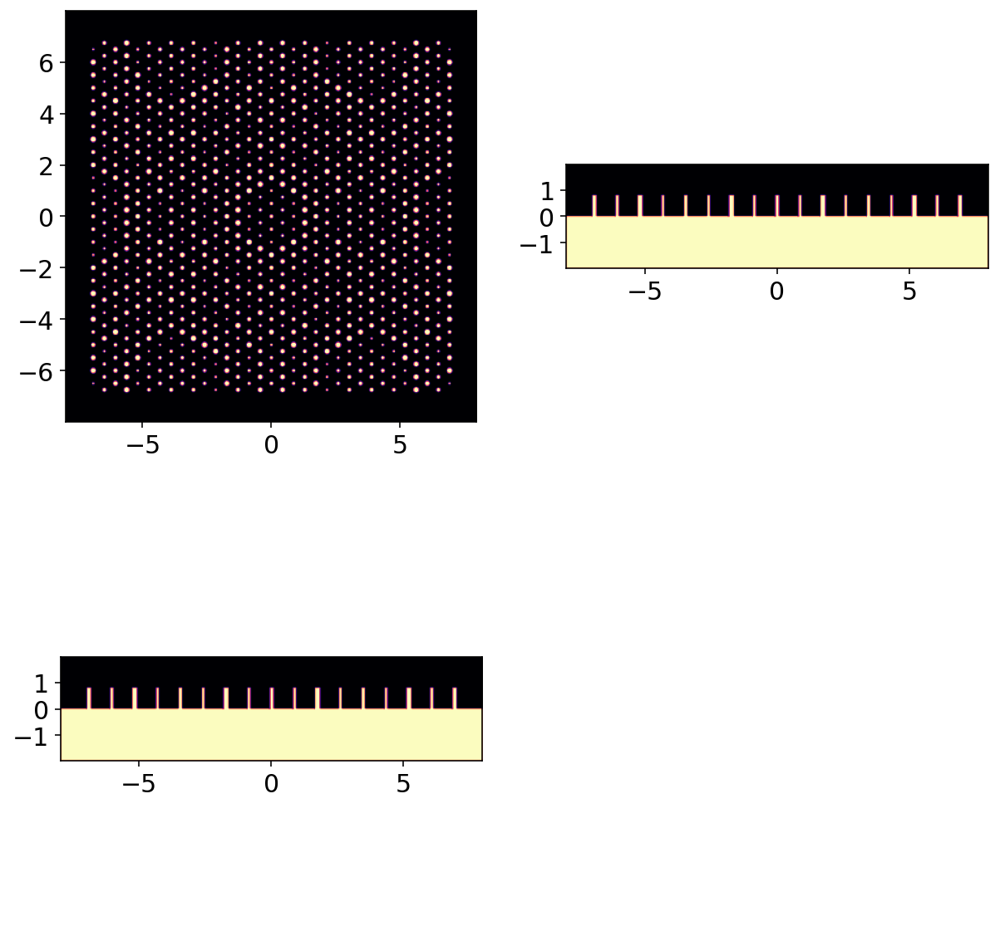

In [24]:
fig, ax = plt.subplots(nrows = 2, ncols = 2, figsize=(10,10))
ax[0,0].imshow(metalens['eps'][:,:,metalens['mid_post_idx']],
          extent=[metalens['x_coords'][0],
                 metalens['x_coords'][-1],
                 metalens['y_coords'][0],
                 metalens['y_coords'][-1]],
          origin='lower',
          cmap='magma')
ax[0,1].imshow(metalens['eps'][metalens['x=0_plane_idx'],:,:].T,
          extent=[metalens['y_coords'][0],
                 metalens['y_coords'][-1],
                 metalens['z_coords'][0],
                 metalens['z_coords'][-1]],
          origin='lower',
          cmap='magma')
ax[1,0].imshow(metalens['eps'][metalens['y=0_plane_idx'],:,:].T,
          extent=[metalens['x_coords'][0],
                 metalens['x_coords'][-1],
                 metalens['z_coords'][0],
                 metalens['z_coords'][-1]],
          origin='lower',
          cmap='magma')
ax[1,1].axis('off')
plt.show()

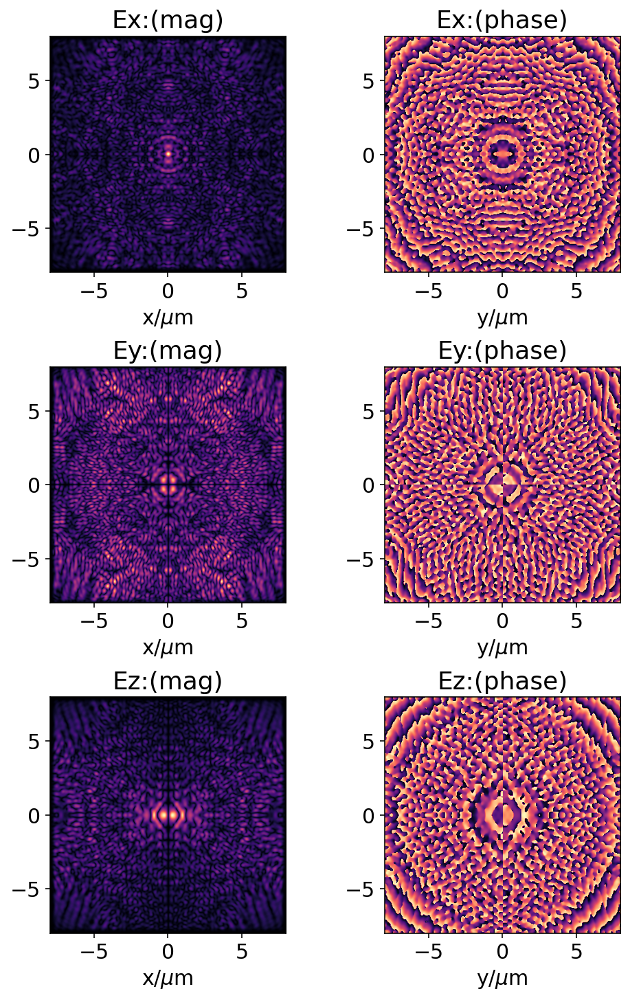

In [25]:
fig, ax = plt.subplots(nrows=3,
                       ncols=2,
                       figsize=(10*0.8,15*0.8))
for i in range(3):
    field = 'E'+['x','y','z'][i]
    extent = [metalens['x_coords'][0], metalens['x_coords'][-1],
             metalens['x_coords'][0], metalens['x_coords'][-1]]
    ax[i][0].imshow(np.abs(metalens['detector_fields'][field]),
            extent=extent,
            origin='lower',
            cmap='magma')
    ax[i][1].imshow(np.angle(metalens['detector_fields'][field]),
            extent=extent,
            origin='lower',
            cmap='magma')
    ax[i][0].set_xlabel('x/$\mu$m')
    ax[i][1].set_xlabel('y/$\mu$m')
    ax[i][0].set_title(field + ':(mag)')
    ax[i][1].set_title(field + ':(phase)')
plt.subplots_adjust(hspace=0.4)
plt.show()

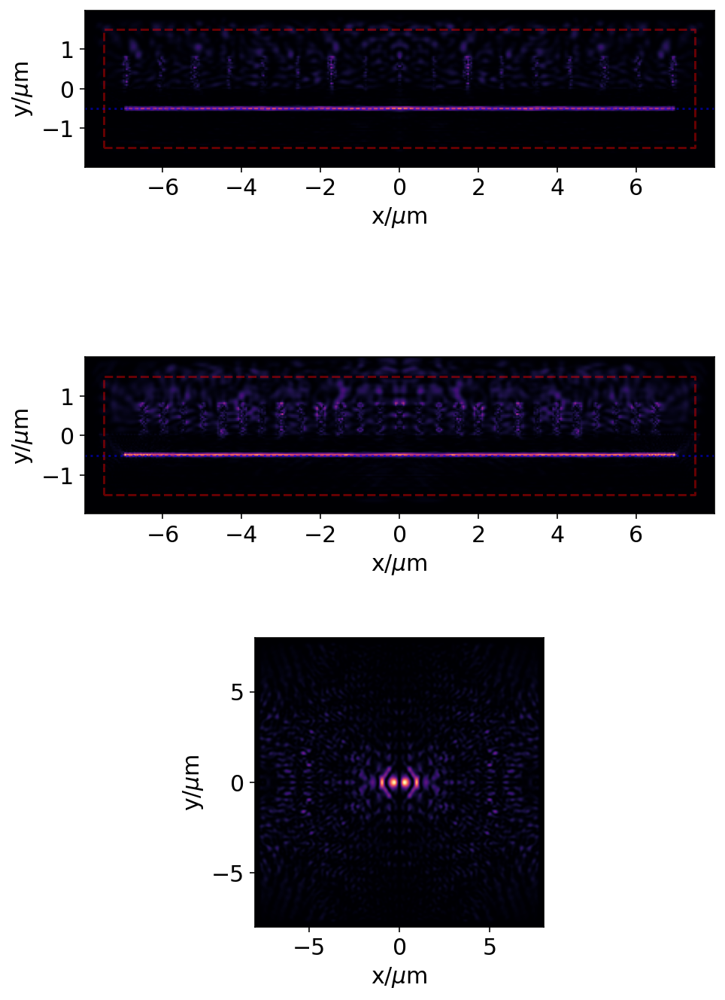

In [26]:
chosen_index_0 = int(metalens['computed_fields']['E2'].shape[0]/2)
vmin = np.percentile(metalens['computed_fields']['E2'].flatten(),1)
vmax = np.percentile(metalens['computed_fields']['E2'].flatten(),100)
fig,ax = plt.subplots(ncols=1,nrows=3,figsize=(5*1.5,6*2.0))

ax[0].imshow(metalens['computed_fields']['E2'][chosen_index_0,:,:].T,
          extent=[metalens['x_coords'][0],
                 metalens['x_coords'][-1],
                 metalens['z_coords'][0],
                 metalens['z_coords'][-1]],
          norm=Normalize(vmin=vmin,vmax=vmax),
          origin='lower',
          cmap='magma')

ax[1].imshow(metalens['computed_fields']['E2'][:,chosen_index_0,:].T,
          extent=[metalens['x_coords'][0],
                 metalens['x_coords'][-1],
                 metalens['z_coords'][0],
                 metalens['z_coords'][-1]],
          norm=Normalize(vmin=vmin,vmax=vmax),
          origin='lower',
          cmap='magma')

for axis in ax[:2]:
    axis.plot([-metalens['sim_cell_width']/2+metalens['PML_width'],
                metalens['sim_cell_width']/2-metalens['PML_width'],
                metalens['sim_cell_width']/2-metalens['PML_width'],
                -metalens['sim_cell_width']/2+metalens['PML_width'],
                -metalens['sim_cell_width']/2+metalens['PML_width']],
                [-metalens['sim_cell_height']/2+metalens['PML_width'],
                -metalens['sim_cell_height']/2+metalens['PML_width'],
                metalens['sim_cell_height']/2-metalens['PML_width'],
                metalens['sim_cell_height']/2-metalens['PML_width'],
                -metalens['sim_cell_height']/2+metalens['PML_width']],
                'r--',alpha=0.4)
    axis.plot([-metalens['sim_cell_width']/2,
              metalens['sim_cell_width']/2],
             [metalens['d']]*2,'m:',alpha=0.5)
    axis.plot([-metalens['sim_cell_width']/2,
              metalens['sim_cell_width']/2],
             [-metalens['s']]*2,'b:',alpha=0.5)
    axis.set_xlim(metalens['x_coords'][0], metalens['x_coords'][-1])
    axis.set_ylim(metalens['z_coords'][0], metalens['z_coords'][-1])
    if metalens['H'] <= metalens['sim_cell_height']/2:
        axis.plot([0],[-metalens['H']],'wx')

ax[2].imshow(metalens['computed_fields']['E2'][:,:,metalens['detector_index']].T,
          extent=[metalens['x_coords'][0],
                 metalens['x_coords'][-1],
                 metalens['x_coords'][0],
                 metalens['x_coords'][-1]],
          origin='lower',
          cmap='magma')
for axis in ax:
    axis.set_xlabel('x/$\mu$m')
    axis.set_ylabel('y/$\mu$m')
plt.show()

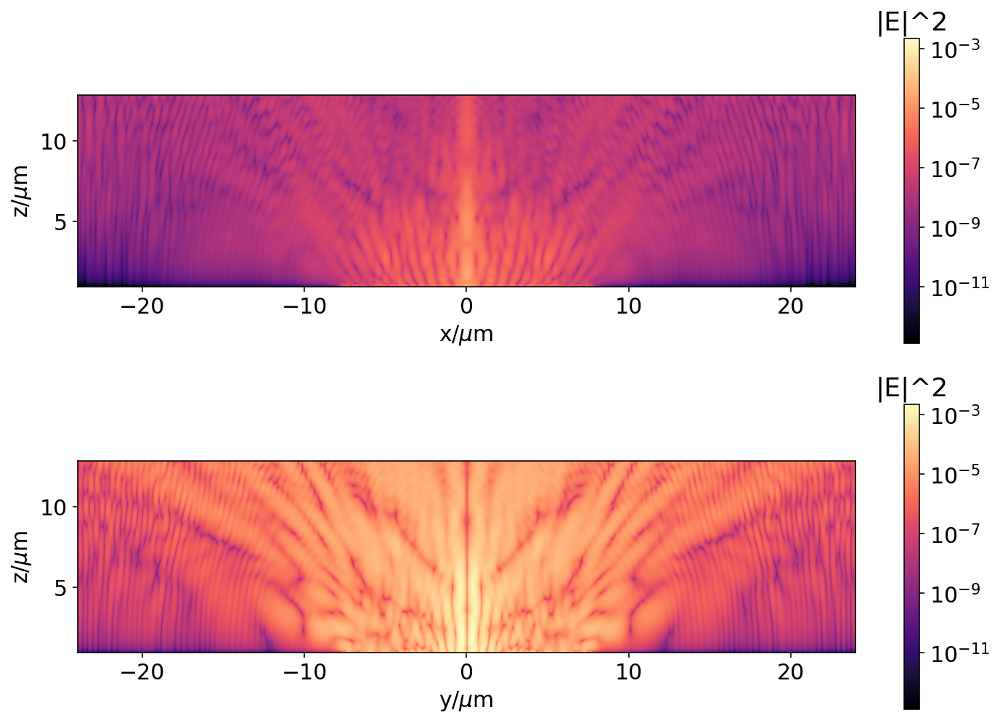

In [27]:
vmin = np.percentile(metalens['computed_fields']['E2'].flatten(),1)
vmax = np.percentile(metalens['computed_fields']['E2'].flatten(),95)
fig, ax = plt.subplots(ncols=1,nrows=2,figsize=(12,8.5))
normalizer = colors.LogNorm
dplot0 = ax[0].imshow(metalens['computed_farfields']['E2'][:,:,metalens['computed_farfields']['E2'].shape[1]//2],
         origin='lower',
         extent=[-3*metalens['sim_cell_width']/2,
                3*metalens['sim_cell_width']/2,
                farfield_axis[0],
                 farfield_axis[-1]],
            cmap='magma',norm=normalizer(vmin=vmin,vmax=vmax))
#             norm=normalizer(vmin=vmin,vmax=vmax))
dplot1 = ax[1].imshow(metalens['computed_farfields']['E2'][:,metalens['computed_farfields']['E2'].shape[1]//2,:],
         origin='lower',
         extent=[-3*metalens['sim_cell_width']/2,
                3*metalens['sim_cell_width']/2,
                farfield_axis[0],farfield_axis[-1]],
                cmap='magma', norm=normalizer(vmin=vmin,vmax=vmax))
#                 norm=normalizer(vmin=vmin,vmax=vmax))
for idx, axis in enumerate(ax):
    if idx == 0:
        axis.set_xlabel('x/$\mu$m')
    else:
        axis.set_xlabel('y/$\mu$m')
    axis.set_ylabel('z/$\mu$m')
cbar = fig.colorbar(dplot1, ax=ax[1])
cbar.ax.set_title('|E|^2')
cbar = fig.colorbar(dplot0, ax=ax[0])
cbar.ax.set_title('|E|^2')
plt.show()

In [30]:
metalens['Mvx'] = len(metalens['x_coords'])*len(metalens['y_coords'])*len(metalens['z_coords'])/1e6

In [31]:
pretty_table = []
for metakey in metalens.keys():
    metavalue = metalens[metakey]
    if type(metavalue) in [int,float,str]:
        pretty_table.append([metakey,metavalue])
    if type(metavalue) is dict:
        for dkey in metavalue:
            metatavalue = metavalue[dkey]
            if type(metatavalue) in [int,float,str]:
                pretty_table.append(['%s:%s' % (metakey, dkey),metatavalue]) 
print(tabulate(pretty_table, tablefmt='psql'))
pyperclip.copy(tabulate(pretty_table))

+----------------------------+--------------+
| resolution                 |  25          |
| epsilon_bottom             |   5.8418     |
| epsilon_top                |   1          |
| sim_cell_width             |  16          |
| sim_cell_height            |   4          |
| PML_width                  |   0.5        |
| wavelength                 |   0.6        |
| num_cores                  |   1          |
| source_width               |   0          |
| cell_width                 |   0.5        |
| post_height                |   0.8        |
| start_time                 |   1.6052e+09 |
| min_post_diameter          |   0.1        |
| metalens_id                |   1.6052e+09 |
| R                          |   7          |
| l                          |   0.5        |
| w                          |   1          |
| d                          |  10          |
| dip_dir:phi                |   1.5708     |
| dip_dir:theta              |   0          |
| nf                         |   1

In [19]:
print(z_index)
fig,ax = plt.subplots(figsize=(10,10), frameon=False)
ax.imshow(metalens['computed_farfields']['E2'][z_index], cmap='magma',
         extent=[metalens['x_coords'][0],metalens['x_coords'][-1],
               metalens['y_coords'][0],metalens['y_coords'][-1]])
ax.text(0.5,0.95,'z=%.1f $\mu$m' % metalens['farfield_axis'][z_index],
        va='center',
        ha='center',
        color='w',
       transform = ax.transAxes)
ax.set_axis_off()
ax.add_artist(plt.Circle((0,0),
              radius=metalens['w'],
              color='w',
              fill=False,
              alpha=0.2,linestyle='dashed'))
#plt.savefig('/Users/juan/Temp/forest/forest-%d.jpg' % z_index, bbox_inches='tight', pad_inches=0)
plt.show()

NameError: name 'z_index' is not defined

In [20]:
nets = []
for idx, start in enumerate(metalens['computed_farfields']['E2']):
    print(idx,end='|')
    far_x_coords = np.linspace(3*metalens['x_coords'][0],
                             3*metalens['x_coords'][-1],
                             start.shape[0])
    far_y_coords = np.linspace(3*metalens['y_coords'][0],
                             3*metalens['y_coords'][-1],
                             start.shape[1])
    far_x_coords_mesh, far_y_coords_mesh = np.meshgrid(far_x_coords,far_y_coords)
    rad_pow = []
    sides = np.linspace(0,3/2*metalens['sim_cell_width'],30)
    for side in sides:
        rad_pow.append(np.sum(start[(np.abs(far_x_coords_mesh)<side)&(np.abs(far_y_coords_mesh)<side)]))
    nets.append(rad_pow)
nets = np.array(nets)

0|1|2|3|4|5|6|7|8|9|10|11|12|13|14|15|16|17|18|19|20|21|22|23|24|25|26|27|28|29|30|31|32|33|34|35|36|37|38|39|40|41|42|43|44|45|46|47|48|49|50|51|52|53|54|55|56|57|58|59|60|61|62|63|64|65|66|67|68|69|70|71|72|73|74|75|76|77|78|79|80|81|82|83|84|85|86|87|88|89|90|91|92|93|94|95|96|97|98|99|100|101|102|103|104|105|106|107|108|109|110|111|112|113|114|115|116|117|118|119|120|121|122|123|124|125|126|127|128|129|130|131|132|133|134|135|136|137|138|139|140|141|142|143|144|145|146|147|148|149|150|151|152|153|154|155|156|157|158|159|160|161|162|163|164|165|166|167|168|169|170|171|172|173|174|175|176|

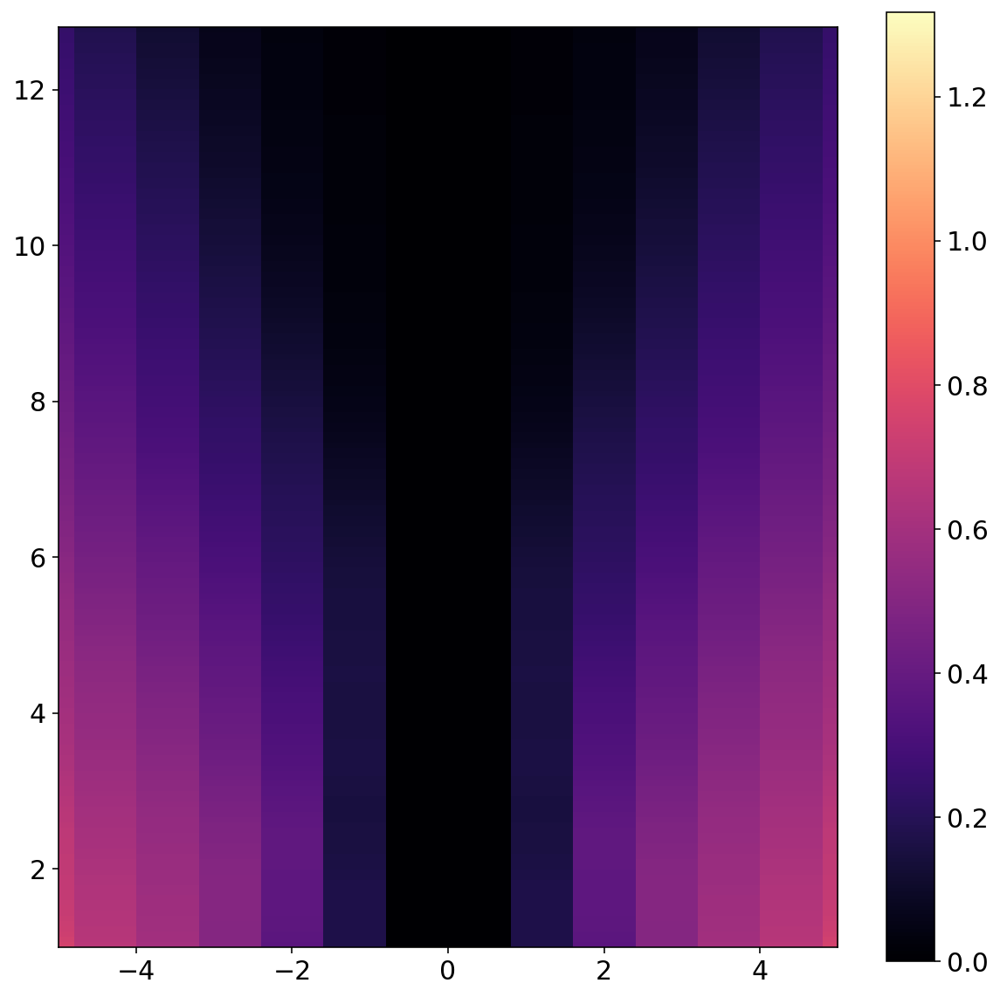

In [21]:
plt.figure(figsize=(10,10))
plt.imshow(np.concatenate((nets[:,-1::-1],nets),axis=1),
          extent=[-sides[-1],sides[-1],
                 metalens['farfield_axis'][0],
                 metalens['farfield_axis'][-1]],
          cmap='magma',
          origin='lower')
plt.colorbar()
plt.xlim(-5,5)
plt.show()

In [14]:
vmax = np.max(metalens['computed_farfields']['E2'][0])
for z_index in range(metalens['computed_farfields']['E2'].shape[0]):
    print(z_index,end='|')
    fig,ax = plt.subplots(figsize=(10,10), frameon=False)
    ax.imshow(metalens['computed_farfields']['E2'][z_index], cmap='magma',
             extent=[3*metalens['x_coords'][0],3*metalens['x_coords'][-1],
                   3*metalens['y_coords'][0],3*metalens['y_coords'][-1]])
    ax.text(0.5,0.95,'z=%.1f $\mu$m' % metalens['farfield_axis'][z_index],
            va='center',
            ha='center',
            color='w',
           transform = ax.transAxes)
    ax.set_axis_off()
    ax.add_artist(plt.Circle((0,0),
                  radius=metalens['w'],
                  color='w',
                  fill=False,
                  alpha=0.2,linestyle='dashed'))
    plt.savefig('/Users/juan/Temp/forest/forest-%d.jpg' % z_index, bbox_inches='tight', pad_inches=0)
    plt.close()

0|1|2|3|4|5|6|7|8|9|10|11|12|13|14|15|16|17|18|19|20|21|22|23|24|25|26|27|28|29|30|31|32|33|34|35|36|37|38|39|40|41|42|43|44|45|46|47|48|49|50|51|52|53|54|55|56|57|58|59|60|61|62|63|64|65|66|67|68|69|70|71|72|73|74|75|76|77|78|79|80|81|82|83|84|85|86|87|88|89|90|91|92|93|94|95|96|97|98|99|100|101|102|103|104|105|106|107|108|109|110|111|112|113|114|115|116|117|118|119|120|121|122|123|124|125|126|127|128|129|130|131|132|133|134|135|136|137|138|139|140|141|142|143|144|145|146|147|148|149|150|151|152|153|154|155|156|157|158|159|160|161|162|163|164|165|166|167|168|169|170|171|172|173|174|175|176|177|178|179|180|181|182|183|184|185|186|187|188|189|190|191|192|193|194|195|196|197|198|199|200|201|202|203|204|205|206|207|208|209|210|211|212|213|214|215|216|217|218|219|220|221|222|223|224|225|226|227|228|229|230|231|232|233|234|235|236|237|238|239|240|241|242|243|244|245|246|247|248|249|250|251|252|253|254|255|256|257|258|259|260|261|262|263|264|265|266|267|268|269|270|271|272|273|274|275|276|27

In [15]:
!pushover "finished"

In [562]:
h5_file = h5py.File('/Users/juan/Temp/forest.h5','w')
dset = h5_file.create_dataset('metaforest', data = metalens['computed_farfields']['E2'])
dset.attrs['comments'] = 'here be some comments'
h5_file.close()

In [529]:
!pushover "done"

## Evenly spaced cylinders of equal geometry on an evenly spaced grid

Calculating grid...
Plotting metasurface layout


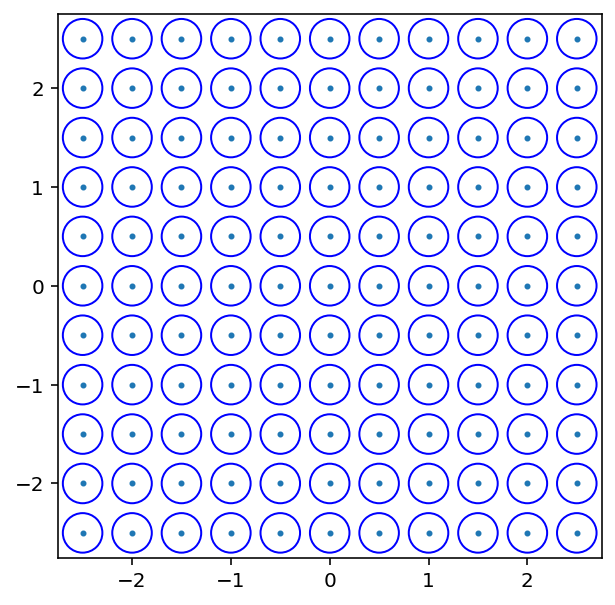

Plotting vertical cross section...


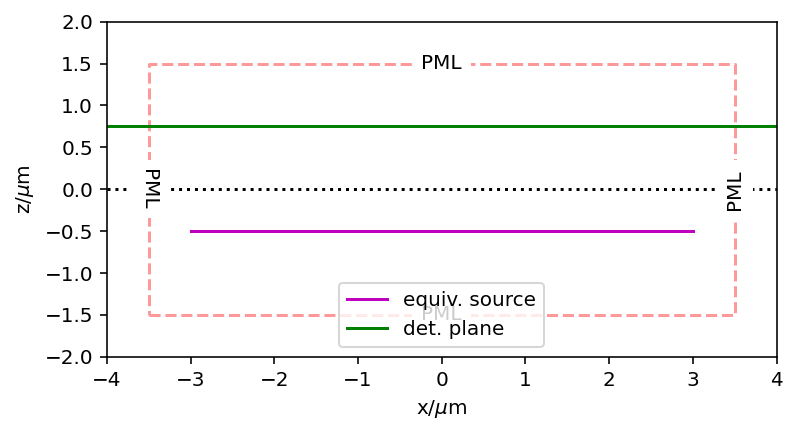

Plotting the bigger picture...


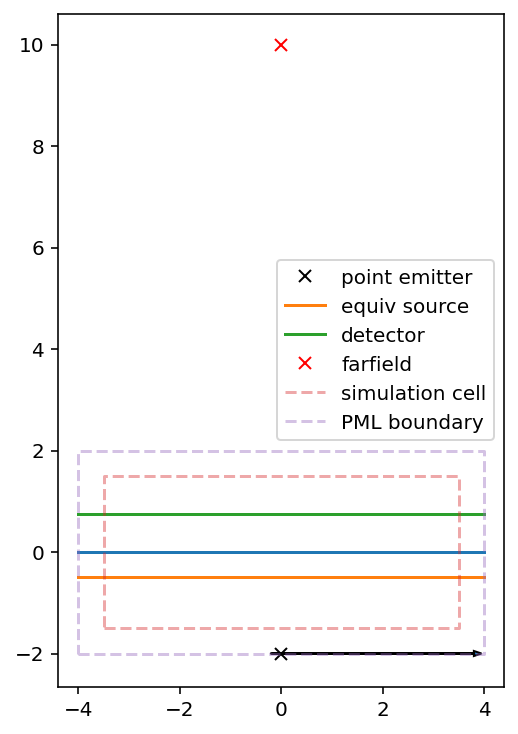

Setting up the simulation cell...
Setting up the equivalent currents...
Setting up the geometry...
-----------
Initializing structure...
time for choose_chunkdivision = 0.001369 s
Working in 3D dimensions.
Computational cell is 8 x 8 x 4 with resolution 40
     block, center = (0,0,-1)
          size (8,8,2)
          axes (1,0,0), (0,1,0), (0,0,1)
          dielectric constant epsilon diagonal = (2.25,2.25,2.25)
     block, center = (0,0,1)
          size (8,8,2)
          axes (1,0,0), (0,1,0), (0,0,1)
          dielectric constant epsilon diagonal = (1,1,1)
     cylinder, center = (-2.5,-2.5,0.25)
          radius 0.2, height 0.5, axis (0, 0, 1)
          dielectric constant epsilon diagonal = (2.25,2.25,2.25)
     cylinder, center = (-2.5,-2,0.25)
          radius 0.2, height 0.5, axis (0, 0, 1)
          dielectric constant epsilon diagonal = (2.25,2.25,2.25)
     cylinder, center = (-2.5,-1.5,0.25)
          radius 0.2, height 0.5, axis (0, 0, 1)
          dielectric constant eps

Meep progress: 3.6125000000000003/5.0 = 72.2% done in 235.1s, 90.3s to go
on time step 289 (time=3.6125), 0.752967 s/step
Meep progress: 3.6875/5.0 = 73.8% done in 239.6s, 85.3s to go
on time step 295 (time=3.6875), 0.74299 s/step
Meep progress: 3.7625/5.0 = 75.2% done in 244.0s, 80.3s to go
on time step 301 (time=3.7625), 0.743756 s/step
Meep progress: 3.8375000000000004/5.0 = 76.8% done in 248.5s, 75.3s to go
on time step 307 (time=3.8375), 0.750372 s/step
Meep progress: 3.9125/5.0 = 78.2% done in 253.1s, 70.3s to go
on time step 313 (time=3.9125), 0.753358 s/step
Meep progress: 3.9875000000000003/5.0 = 79.8% done in 257.5s, 65.4s to go
on time step 319 (time=3.9875), 0.737136 s/step
Meep progress: 4.0625/5.0 = 81.2% done in 262.0s, 60.5s to go
on time step 325 (time=4.0625), 0.745294 s/step
Meep progress: 4.1375/5.0 = 82.8% done in 266.5s, 55.5s to go
on time step 331 (time=4.1375), 0.75287 s/step
Meep progress: 4.2125/5.0 = 84.2% done in 271.0s, 50.7s to go
on time step 337 (time=4

In [182]:
resolution = 40
metalens = {'epsilon_bottom': 1.5**2,
            'epsilon_top': 1.0,
            'sim_cell_width': 8.,
            'sim_cell_height': 4.,
            'PML_width': 0.5,
            'wavelength': 0.5, # in vacuum
            'resolution': resolution,
            'symmetries': [],
            'complex_fields': True,
            'num_cores': 1,
            'quiet':False,
            'source_width':0,
            'grid_size': 0.5,
            'cylinder_radius': 0.2,
            'post_height': 0.5,
            'start_time': time(),
            'ff': 10,
            'l': 0.5,
            'dip_dir':{'phi':np.pi/2., 'theta':0.},
            'd': 0.75, # z coordinate where the field is collected
            'H': 2.0, # depth of dipole wrt to middle of sim volume
            's': 0.5} # depth of the equiv current plane wrt to z=0
metalens['n_bottom'] = np.sqrt(metalens['epsilon_bottom'])
metalens['n_top'] = np.sqrt(metalens['epsilon_top'])
metalens['wavelength_bottom'] = metalens['wavelength']/np.sqrt(metalens['epsilon_bottom'])
metalens['wavelength_top'] = metalens['wavelength']/np.sqrt(metalens['epsilon_top'])
metalens['sim_time'] = metalens['sim_cell_height']/2*(metalens['n_bottom']+metalens['n_top'])
metalens['source_coord'] = - metalens['H']
metalens['k_bottom'] = 2*np.pi/metalens['wavelength_bottom']
metalens['k_top'] = 2*np.pi/metalens['wavelength_top']
metalens['w'] = metalens['sim_cell_width']-2*metalens['PML_width'] -2*metalens['l'] #  the width of the equiv corruent plane

print("Calculating grid...")
grid_centers = []
left_margin = (-metalens['sim_cell_width']/2 + metalens['PML_width'] + metalens['grid_size'])
right_margin = (metalens['sim_cell_width']/2 - metalens['PML_width'] - metalens['grid_size'])
diameter = np.arange(-metalens['sim_cell_width']/2,metalens['sim_cell_width']/2,metalens['grid_size'])
diameter = diameter[(diameter < right_margin) & (diameter>left_margin)]
metalens['grid_centers'] = np.array([[x,y] for x in diameter for y in diameter])

print("Plotting metasurface layout")
fig, ax = plt.subplots(figsize=(5,5))
ax.plot(metalens['grid_centers'][:,0],
         metalens['grid_centers'][:,1],'o',ms=2)
for x,y in metalens['grid_centers']:
    ax.add_artist(plt.Circle((x,y),
                  radius=metalens['cylinder_radius'],
                  color='b',
                            fill=False))
ax.set_aspect('equal')
plt.show()

print("Plotting vertical cross section...")
fig, ax = plt.subplots(figsize=(6,4))
ax.plot([-metalens['sim_cell_width']/2+metalens['PML_width'],
               metalens['sim_cell_width']/2-metalens['PML_width'],
              metalens['sim_cell_width']/2-metalens['PML_width'],
              -metalens['sim_cell_width']/2+metalens['PML_width'],
              -metalens['sim_cell_width']/2+metalens['PML_width']],
             [-metalens['sim_cell_height']/2+metalens['PML_width'],
             -metalens['sim_cell_height']/2+metalens['PML_width'],
             metalens['sim_cell_height']/2-metalens['PML_width'],
             metalens['sim_cell_height']/2-metalens['PML_width'],
             -metalens['sim_cell_height']/2+metalens['PML_width']],
              'r--',alpha=0.4)
ax.text(0,metalens['sim_cell_height']/2-metalens['PML_width'],
        'PML',va='center',ha='center',backgroundcolor='white')
ax.text(0,-metalens['sim_cell_height']/2+metalens['PML_width'],
        'PML',va='center',ha='center',backgroundcolor='white')
ax.text(metalens['sim_cell_width']/2-metalens['PML_width'],0,
        'PML',va='center',ha='center',backgroundcolor='white',rotation=90)
ax.text(-metalens['sim_cell_width']/2+metalens['PML_width'],0,
        'PML',va='center',ha='center',backgroundcolor='white',rotation=-90)
ax.text(0,metalens['sim_cell_height']/2-metalens['PML_width'],
        'PML',va='center',ha='center',backgroundcolor='white')
ax.plot([-metalens['w']/2,metalens['w']/2],[-metalens['s']]*2,'m-',label='equiv. source')
ax.plot([-metalens['sim_cell_width']/2,metalens['sim_cell_width']/2],[metalens['d']]*2,'g-',label='det. plane')
ax.plot([-metalens['sim_cell_width']/2,metalens['sim_cell_width']/2],[0,0],'k:')
ax.set_aspect('equal')
ax.set_xlabel('x/$\mu$m')
ax.set_ylabel('z/$\mu$m')
ax.legend()
ax.set_xlim(-metalens['sim_cell_width']/2,metalens['sim_cell_width']/2)
ax.set_ylim(-metalens['sim_cell_height']/2,metalens['sim_cell_height']/2)
plt.show()

print("Plotting the bigger picture...")
fig, ax = plt.subplots(figsize=(4,4*(metalens['ff']+metalens['H'])))
ax.plot([-metalens['sim_cell_width']/2,metalens['sim_cell_width']/2],
        [0,0])
ax.plot([0],
        [-metalens['H']],'kx',label='point emitter')
ax.plot([-metalens['sim_cell_width']/2,metalens['sim_cell_width']/2],
        [-metalens['s'],-metalens['s']],label='equiv source')
ax.plot([-metalens['sim_cell_width']/2,metalens['sim_cell_width']/2],
        [metalens['d'],metalens['d']],label='detector')
ax.plot([0],
        [metalens['ff']],'rx',label='farfield')
ax.plot([-metalens['sim_cell_width']/2+metalens['PML_width'],
            metalens['sim_cell_width']/2-metalens['PML_width'],
            metalens['sim_cell_width']/2-metalens['PML_width'],
            -metalens['sim_cell_width']/2+metalens['PML_width'],
            -metalens['sim_cell_width']/2+metalens['PML_width']],
            [-metalens['sim_cell_height']/2+metalens['PML_width'],
            -metalens['sim_cell_height']/2+metalens['PML_width'],
            metalens['sim_cell_height']/2-metalens['PML_width'],
            metalens['sim_cell_height']/2-metalens['PML_width'],
            -metalens['sim_cell_height']/2+metalens['PML_width']],
            '--',alpha=0.4,label='simulation cell')
ax.plot([-metalens['sim_cell_width']/2,
            metalens['sim_cell_width']/2,
            metalens['sim_cell_width']/2,
            -metalens['sim_cell_width']/2,
            -metalens['sim_cell_width']/2],
            [-metalens['sim_cell_height']/2,
            -metalens['sim_cell_height']/2,
            metalens['sim_cell_height']/2,
            metalens['sim_cell_height']/2,
            -metalens['sim_cell_height']/2],
            '--',alpha=0.4,label='PML boundary')
ax.arrow(0-np.sin(metalens['dip_dir']['phi'])*metalens['H']*0.1,
         -metalens['H']-np.cos(metalens['dip_dir']['phi'])*metalens['H']*0.1,
       2*np.sin(metalens['dip_dir']['phi'])*metalens['H'],2*np.cos(metalens['dip_dir']['phi'])*metalens['H'],
         head_width=metalens['H']*0.05
       )
ax.set_aspect('equal')
ax.legend()
plt.show()

print("Setting up the simulation cell...")
sim_cell = mp.Vector3(metalens['sim_cell_width'],
                      metalens['sim_cell_width'],
                      metalens['sim_cell_height'])
pml_layers = [ mp.PML(metalens['PML_width']) ]
metalens['source_funcs'] = equiv_currents_bottom(metalens)

print("Setting up the equivalent currents...")
sources = []
for m_comp, m_comp_name in zip([mp.Ex,mp.Ey,mp.Ez,mp.Hx,mp.Hy,mp.Hz],
                                ['JEx','JEy','JEz','JHx','JHy','JHz']):
    this_source = mp.Source(src=mp.ContinuousSource(
                        wavelength=metalens['wavelength_bottom'],
                        width=metalens['source_width']),
                    component=m_comp,
                    amp_func = metalens['source_funcs'][m_comp_name],
                    center = mp.Vector3(0,0,-metalens['s']),
                    size = mp.Vector3(metalens['w'], metalens['w'], 0))
    sources.append(this_source)

print("Setting up the geometry...")
bottom_chunk = mp.Block(size = mp.Vector3(
                metalens['sim_cell_width'],
                metalens['sim_cell_width'],
                metalens['sim_cell_height']/2),
                center = mp.Vector3(0,0,-metalens['sim_cell_height']/4),
                material = mp.Medium(epsilon = metalens['epsilon_bottom']))
top_chunk = mp.Block(size = mp.Vector3(
                metalens['sim_cell_width'],
                metalens['sim_cell_width'],
                metalens['sim_cell_height']/2),
                center = mp.Vector3(0,0,metalens['sim_cell_height']/4),
                material = mp.Medium(epsilon = metalens['epsilon_top']))
cylinders = []
for x,y in metalens['grid_centers']:
    cylinder = mp.Cylinder(radius = metalens['cylinder_radius'],
               height = metalens['post_height'],
               axis = mp.Vector3(0,0,1),
               center = mp.Vector3(x,y,metalens['post_height']/2.),
               material = mp.Medium(epsilon = metalens['epsilon_bottom']))
    cylinders.append(cylinder)

metalens['geometry'] = [bottom_chunk,
                       top_chunk] + cylinders

sim = mp.Simulation(cell_size=sim_cell,
                boundary_layers=pml_layers,
                geometry=metalens['geometry'],
                force_complex_fields=metalens['complex_fields'],
                sources=sources,
                resolution=metalens['resolution'])
sim.init_sim()

metalens['x_coords'], metalens['y_coords'], metalens['z_coords'], _ = (
                list(map(np.array,sim.get_array_metadata())))
metalens['detector_index'] = np.argmin(np.abs(metalens['z_coords']
                                              - metalens['d']))
start_time = time()
print("Running the simulation...")
sim.run(until=metalens['sim_time'])
metalens['simulation_run_time_in_min'] = (time() - start_time)/60.
metalens['fields'] = {'Ex': sim.get_array(component=mp.Ex),
                    'Ey': sim.get_array(component=mp.Ey),
                    'Ez': sim.get_array(component=mp.Ez),
                    'Hx': sim.get_array(component=mp.Hx),
                    'Hy': sim.get_array(component=mp.Hy),
                    'Hz': sim.get_array(component=mp.Hz)}
metalens['computed_fields'] = {}
metalens['computed_fields']['E2'] = (np.abs(metalens['fields']['Ex'])**2 + 
                  np.abs(metalens['fields']['Ey'])**2 + 
                  np.abs(metalens['fields']['Ez'])**2)

print("Collecting fields at the detector plane...")
metalens['detector_fields'] = {}
for field_name in ['Ex','Ey','Ez','Hx','Hy','Hz']:
    metalens['detector_fields'][field_name] = metalens['fields'][field_name][:,:,metalens['detector_index']].T

print("Computing farfield...")
metalens['farfields'] = {}
farfield_axis = np.linspace(metalens['d'],
                metalens['ff'],
                int((metalens['ff']-metalens['d'])*metalens['resolution']))
metalens['farfield_axis'] = farfield_axis
one_field = metalens['detector_fields']['Ex']
idx_width = one_field.shape[0]
one_field = np.pad(one_field,(idx_width,idx_width))
metalens['kx_freqs'] = 2*np.pi*np.fft.fftfreq(
                            idx_width*3,
                            d=1./metalens['resolution'])
metalens['ky_freqs'] = 2*np.pi*np.fft.fftfreq(
                            idx_width*3,
                            d=1./metalens['resolution'])
(metalens['kx_freqs_v'], metalens['ky_freqs_v']) = np.meshgrid(metalens['kx_freqs'],metalens['ky_freqs'])
metalens['kz'] = np.sqrt(0.j+metalens['k_top']**2-metalens['kx_freqs_v']**2-metalens['ky_freqs_v']**2)
gator = np.exp(1.j*np.outer(farfield_axis-metalens['d'],
        metalens['kz']).reshape((*farfield_axis.shape,*metalens['kz'].shape)))
for field_label in ['Ex','Ey','Ez','Hx','Hy','Hz']:
    print('Computing the farfield for %s...' % field_label)
    one_field = metalens['detector_fields'][field_label]
    one_field = np.pad(one_field,(idx_width,idx_width))
    one_field = one_field[np.newaxis,:]
    nearfourier = (np.fft.fft2(one_field))
    farfourier = nearfourier*gator
    metalens['farfields'][field_label] = np.fft.ifft2(farfourier)
metalens['computed_farfields'] = {}
metalens['computed_farfields']['E2'] = np.abs(np.abs(metalens['farfields']['Ex'])**2+np.abs(metalens['farfields']['Ey'])**2+np.abs(metalens['farfields']['Ez'])**2)

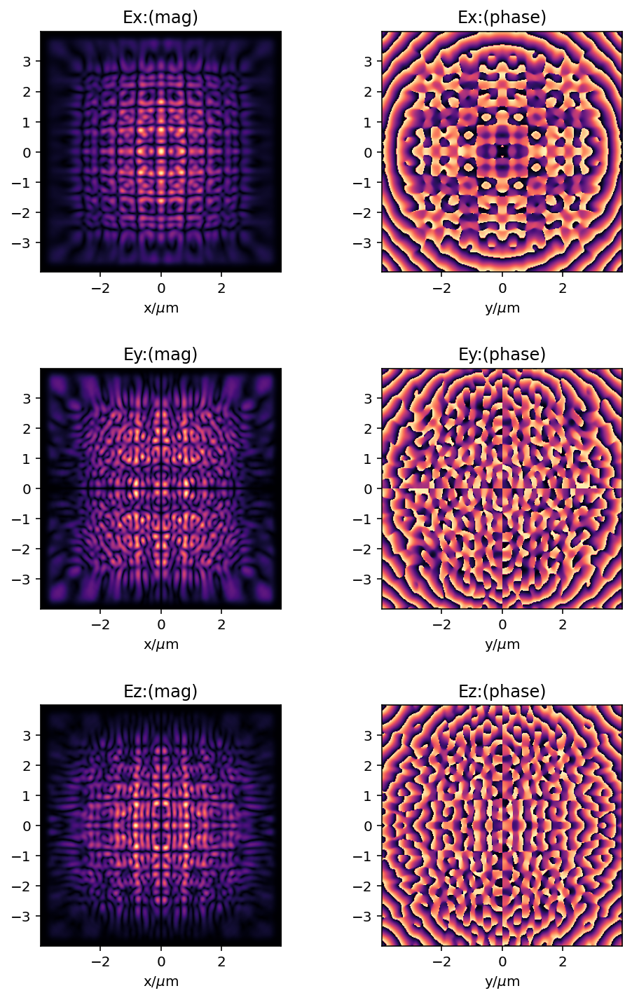

In [183]:
fig, ax = plt.subplots(nrows=3,
                       ncols=2,
                       figsize=(10*0.8,15*0.8))
for i in range(3):
    field = 'E'+['x','y','z'][i]
    extent = [metalens['x_coords'][0], metalens['x_coords'][-1],
             metalens['x_coords'][0], metalens['x_coords'][-1]]
    ax[i][0].imshow(np.abs(metalens['detector_fields'][field]),
            extent=extent,
            origin='lower',
            cmap='magma')
    ax[i][1].imshow(np.angle(metalens['detector_fields'][field]),
            extent=extent,
            origin='lower',
            cmap='magma')
    ax[i][0].set_xlabel('x/$\mu$m')
    ax[i][1].set_xlabel('y/$\mu$m')
    ax[i][0].set_title(field + ':(mag)')
    ax[i][1].set_title(field + ':(phase)')
plt.subplots_adjust(hspace=0.4)
plt.show()

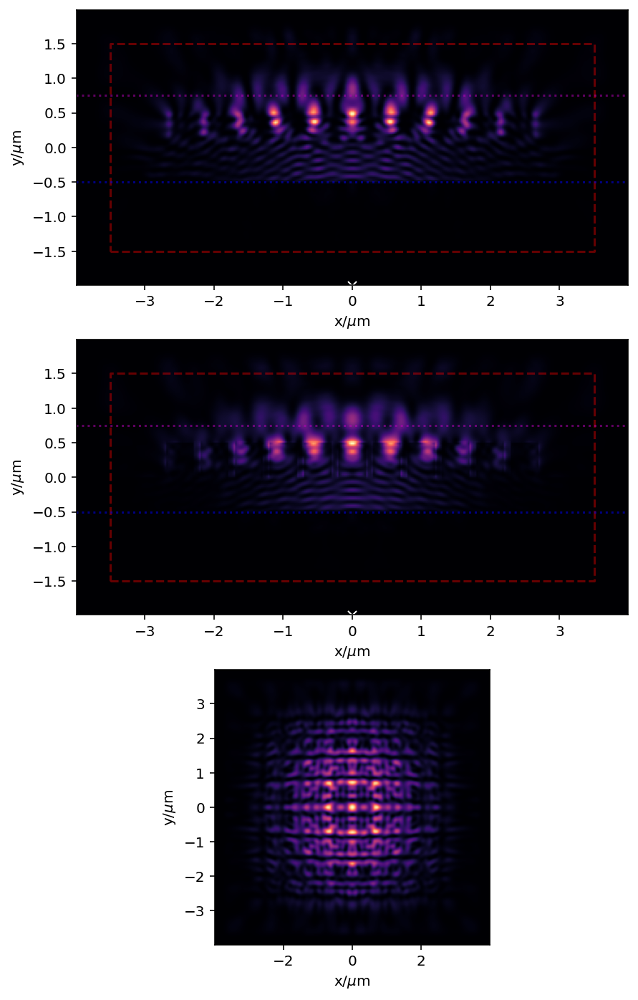

In [184]:
chosen_index_0 = int(metalens['computed_fields']['E2'].shape[0]/2)
vmin = np.percentile(metalens['computed_fields']['E2'].flatten(),1)
vmax = np.percentile(metalens['computed_fields']['E2'].flatten(),100)
fig,ax = plt.subplots(ncols=1,nrows=3,figsize=(5*1.5,6*2.0))

ax[0].imshow(metalens['computed_fields']['E2'][chosen_index_0,:,:].T,
          extent=[metalens['x_coords'][0],
                 metalens['x_coords'][-1],
                 metalens['z_coords'][0],
                 metalens['z_coords'][-1]],
          norm=Normalize(vmin=vmin,vmax=vmax),
          origin='lower',
          cmap='magma')

ax[1].imshow(metalens['computed_fields']['E2'][:,chosen_index_0,:].T,
          extent=[metalens['x_coords'][0],
                 metalens['x_coords'][-1],
                 metalens['z_coords'][0],
                 metalens['z_coords'][-1]],
          norm=Normalize(vmin=vmin,vmax=vmax),
          origin='lower',
          cmap='magma')

for axis in ax[:2]:
    axis.plot([-metalens['sim_cell_width']/2+metalens['PML_width'],
                metalens['sim_cell_width']/2-metalens['PML_width'],
                metalens['sim_cell_width']/2-metalens['PML_width'],
                -metalens['sim_cell_width']/2+metalens['PML_width'],
                -metalens['sim_cell_width']/2+metalens['PML_width']],
                [-metalens['sim_cell_height']/2+metalens['PML_width'],
                -metalens['sim_cell_height']/2+metalens['PML_width'],
                metalens['sim_cell_height']/2-metalens['PML_width'],
                metalens['sim_cell_height']/2-metalens['PML_width'],
                -metalens['sim_cell_height']/2+metalens['PML_width']],
                'r--',alpha=0.4)
    axis.plot([-metalens['sim_cell_width']/2,
              metalens['sim_cell_width']/2],
             [metalens['d']]*2,'m:',alpha=0.5)
    axis.plot([-metalens['sim_cell_width']/2,
              metalens['sim_cell_width']/2],
             [-metalens['s']]*2,'b:',alpha=0.5)
    axis.set_xlim(metalens['x_coords'][0], metalens['x_coords'][-1])
    axis.set_ylim(metalens['z_coords'][0], metalens['z_coords'][-1])
    if metalens['H'] <= metalens['sim_cell_height']/2:
        axis.plot([0],[-metalens['H']],'wx')

ax[2].imshow(metalens['computed_fields']['E2'][:,:,metalens['detector_index']].T,
          extent=[metalens['x_coords'][0],
                 metalens['x_coords'][-1],
                 metalens['x_coords'][0],
                 metalens['x_coords'][-1]],
          origin='lower',
          cmap='magma')
for axis in ax:
    axis.set_xlabel('x/$\mu$m')
    axis.set_ylabel('y/$\mu$m')
plt.show()

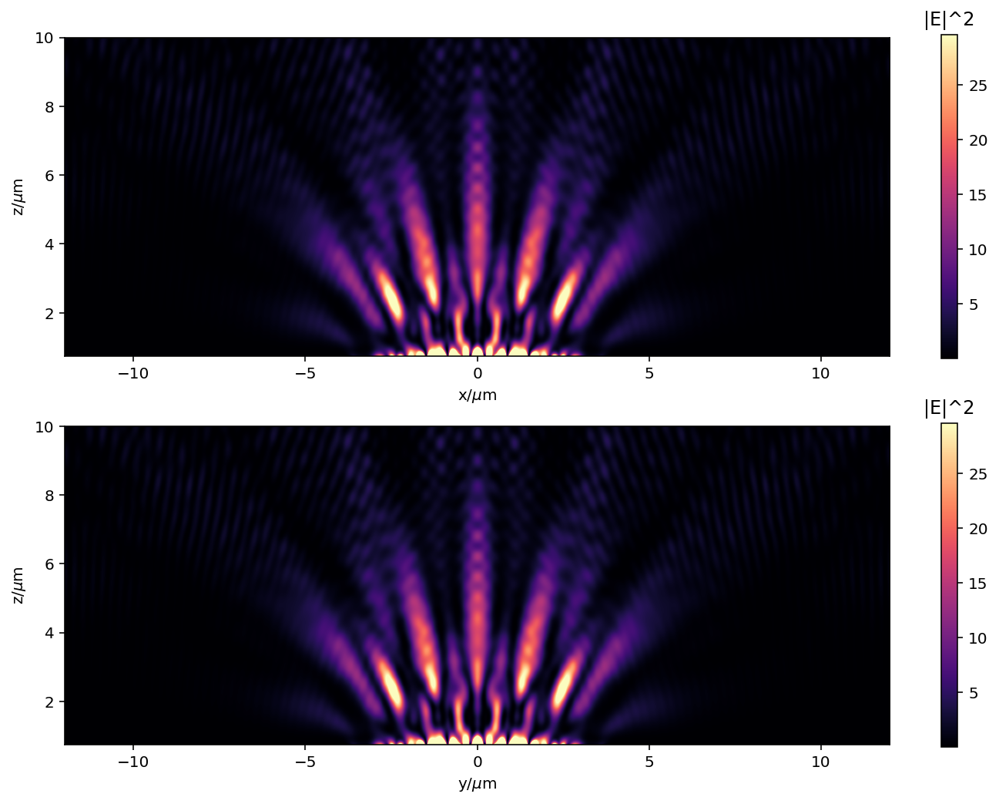

In [203]:
vmin = np.percentile(metalens['computed_fields']['E2'].flatten(),10)
vmax = np.percentile(metalens['computed_fields']['E2'].flatten(),95)
fig, ax = plt.subplots(ncols=1,nrows=2,figsize=(12,8.5))
normalizer = colors.Normalize
dplot0 = ax[0].imshow(metalens['computed_farfields']['E2'][:,:,metalens['computed_farfields']['E2'].shape[1]//2],
         origin='lower',
         extent=[-3*metalens['sim_cell_width']/2,
                3*metalens['sim_cell_width']/2,
                farfield_axis[0],
                 farfield_axis[-1]],
            cmap='magma',
            norm=normalizer(vmin=vmin,vmax=vmax))
dplot1 = ax[1].imshow(metalens['computed_farfields']['E2'][:,:,metalens['computed_farfields']['E2'].shape[1]//2],
         origin='lower',
         extent=[-3*metalens['sim_cell_width']/2,
                3*metalens['sim_cell_width']/2,
                farfield_axis[0],farfield_axis[-1]],
                cmap='magma',
                norm=normalizer(vmin=vmin,vmax=vmax))
for idx, axis in enumerate(ax):
    if idx == 0:
        axis.set_xlabel('x/$\mu$m')
    else:
        axis.set_xlabel('y/$\mu$m')
    axis.set_ylabel('z/$\mu$m')
cbar = fig.colorbar(dplot1, ax=ax[1])
cbar.ax.set_title('|E|^2')
cbar = fig.colorbar(dplot0, ax=ax[0])
cbar.ax.set_title('|E|^2')
plt.show()

In [206]:
metalens['Mvx'] = len(metalens['x_coords'])*len(metalens['y_coords'])*len(metalens['z_coords'])/1e6

In [209]:
pretty_table = []
for metakey in metalens.keys():
    metavalue = metalens[metakey]
    if type(metavalue) in [int,float,str]:
        pretty_table.append([metakey,metavalue])
    if type(metavalue) is dict:
        for dkey in metavalue:
            metatavalue = metavalue[dkey]
            if type(metatavalue) in [int,float,str]:
                pretty_table.append(['%s:%s' % (metakey, dkey),metatavalue]) 
print(tabulate(pretty_table))

--------------------------  ------------
epsilon_bottom               2.25
epsilon_top                  1
sim_cell_width               8
sim_cell_height              4
PML_width                    0.5
wavelength                   0.5
resolution                  40
num_cores                    1
source_width                 0
grid_size                    0.5
cylinder_radius              0.2
post_height                  0.5
start_time                   1.60271e+09
ff                          10
l                            0.5
dip_dir:phi                  1.5708
dip_dir:theta                0
d                            0.75
H                            2
s                            0.5
source_coord                -2
w                            6
simulation_run_time_in_min   5.30114
Mvx                         16.384
--------------------------  ------------


In [199]:
!mkdir 

In [202]:
for z_index in range(metalens['computed_farfields']['E2'].shape[0]):
    print(z_index)
    fig,ax = plt.subplots(figsize=(10,10), frameon=False)
    ax.imshow(metalens['computed_farfields']['E2'][z_index], cmap='magma')
    ax.set_axis_off()
    plt.savefig('/Users/juan/Temp/forest/forest-%d.jpg' % z_index, bbox_inches='tight', pad_inches=0)
    plt.close()

0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160
161
162
163
164
165
166
167
168
169
170
171
172
173
174
175
176
177
178
179
180
181
182
183
184
185
186
187
188
189
190
191
192
193
194
195
196
197
198
199
200
201
202
203
204
205
206
207
208
209
210
211
212
213
214
215
216
217
218
219
220
221
222
223
224
225
226
227
228
229
230
231
232
233
234
235
236
237
238
239
240
241
242
243
244
245
246
247
248
249
250
251
252
253
254
255
256
257
258
259
260
261
262
263
264
265
266
267
268
269
270
271
272
273
274
275
276
27

In [198]:
!open test.jpg

In [187]:
h5_file = h5py.File('/Users/juan/Temp/forest.h5','w')
dset = h5_file.create_dataset('metaforest', data = metalens['computed_farfields']['E2'])
dset.attrs['comments'] = 'here be some comments'
h5_file.close()

In [100]:
!pushover "done"

## Dipole RAD from glass to air

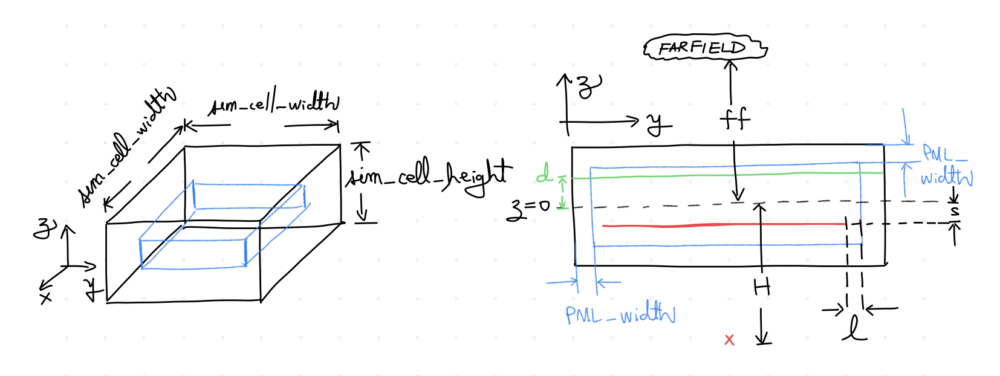

Plotting vertical cross section...


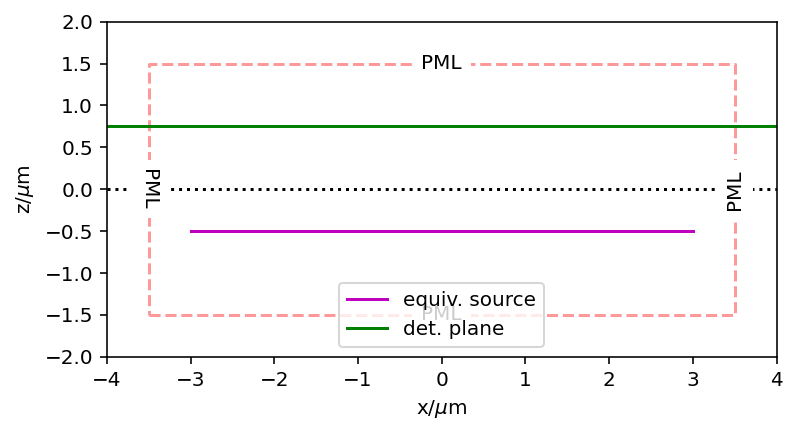

Plotting the bigger picture...


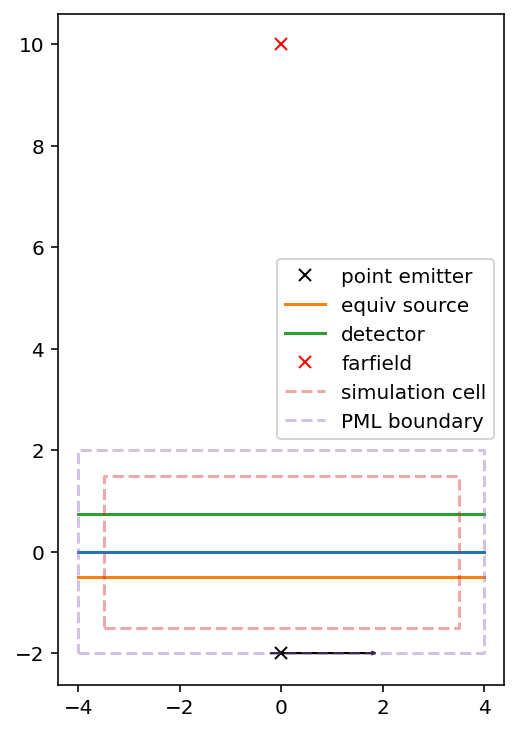

Setting up the simulation cell...
Setting up the equivalent currents...
Setting up the geometry...
-----------
Initializing structure...
time for choose_chunkdivision = 0.000638008 s
Working in 3D dimensions.
Computational cell is 8 x 8 x 4 with resolution 30
     block, center = (0,0,-1)
          size (8,8,2)
          axes (1,0,0), (0,1,0), (0,0,1)
          dielectric constant epsilon diagonal = (2.25,2.25,2.25)
     block, center = (0,0,1)
          size (8,8,2)
          axes (1,0,0), (0,1,0), (0,0,1)
          dielectric constant epsilon diagonal = (1,1,1)
time for set_epsilon = 22.0496 s
-----------
Meep: using complex fields.
Running the simulation...
Meep progress: 0.016666666666666666/5.0 = 0.3% done in 11.3s, 3364.7s to go
on time step 1 (time=0.0166667), 11.2533 s/step
Meep progress: 0.25/5.0 = 5.0% done in 15.5s, 294.7s to go
on time step 15 (time=0.25), 0.304125 s/step
Meep progress: 0.48333333333333334/5.0 = 9.7% done in 19.7s, 184.5s to go
on time step 29 (time=0.48333

In [90]:
resolution = 30
metalens = {'epsilon_bottom': 1.5**2,
            'epsilon_top': 1.0,
            'sim_cell_width': 8.,
            'sim_cell_height': 4.,
            'PML_width': 0.5,
            'wavelength': 0.5, # in vacuum
            'resolution': resolution,
            'symmetries': [],
            'complex_fields': True,
            'num_cores': 1,
            'quiet':False,
            'source_width':0,
            'ff': 10,
            'l': 0.5,
            'dip_dir':{'phi':np.pi/2., 'theta':0.},
            'd': 0.75, # z coordinate where the field is collected
            'H': 2.0, # depth of dipole wrt to middle of sim volume
            's': 0.5} # depth of the equiv current plane wrt to z=0
metalens['n_bottom'] = np.sqrt(metalens['epsilon_bottom'])
metalens['n_top'] = np.sqrt(metalens['epsilon_top'])
metalens['wavelength_bottom'] = metalens['wavelength']/np.sqrt(metalens['epsilon_bottom'])
metalens['wavelength_top'] = metalens['wavelength']/np.sqrt(metalens['epsilon_top'])
metalens['sim_time'] = metalens['sim_cell_height']/2*(metalens['n_bottom']+metalens['n_top'])
metalens['source_coord'] = - metalens['H']
metalens['k_bottom'] = 2*np.pi/metalens['wavelength_bottom']
metalens['k_top'] = 2*np.pi/metalens['wavelength_top']
metalens['w'] = metalens['sim_cell_width']-2*metalens['PML_width'] -2*metalens['l'] #  the width of the equiv corruent plane

print("Plotting vertical cross section...")
fig, ax = plt.subplots(figsize=(6,4))
ax.plot([-metalens['sim_cell_width']/2+metalens['PML_width'],
               metalens['sim_cell_width']/2-metalens['PML_width'],
              metalens['sim_cell_width']/2-metalens['PML_width'],
              -metalens['sim_cell_width']/2+metalens['PML_width'],
              -metalens['sim_cell_width']/2+metalens['PML_width']],
             [-metalens['sim_cell_height']/2+metalens['PML_width'],
             -metalens['sim_cell_height']/2+metalens['PML_width'],
             metalens['sim_cell_height']/2-metalens['PML_width'],
             metalens['sim_cell_height']/2-metalens['PML_width'],
             -metalens['sim_cell_height']/2+metalens['PML_width']],
              'r--',alpha=0.4)
ax.text(0,metalens['sim_cell_height']/2-metalens['PML_width'],
        'PML',va='center',ha='center',backgroundcolor='white')
ax.text(0,-metalens['sim_cell_height']/2+metalens['PML_width'],
        'PML',va='center',ha='center',backgroundcolor='white')
ax.text(metalens['sim_cell_width']/2-metalens['PML_width'],0,
        'PML',va='center',ha='center',backgroundcolor='white',rotation=90)
ax.text(-metalens['sim_cell_width']/2+metalens['PML_width'],0,
        'PML',va='center',ha='center',backgroundcolor='white',rotation=-90)
ax.text(0,metalens['sim_cell_height']/2-metalens['PML_width'],
        'PML',va='center',ha='center',backgroundcolor='white')
ax.plot([-metalens['w']/2,metalens['w']/2],[-metalens['s']]*2,'m-',label='equiv. source')
ax.plot([-metalens['sim_cell_width']/2,metalens['sim_cell_width']/2],[metalens['d']]*2,'g-',label='det. plane')
ax.plot([-metalens['sim_cell_width']/2,metalens['sim_cell_width']/2],[0,0],'k:')
ax.set_aspect('equal')
ax.set_xlabel('x/$\mu$m')
ax.set_ylabel('z/$\mu$m')
ax.legend()
ax.set_xlim(-metalens['sim_cell_width']/2,metalens['sim_cell_width']/2)
ax.set_ylim(-metalens['sim_cell_height']/2,metalens['sim_cell_height']/2)
plt.show()

print("Plotting the bigger picture...")
fig, ax = plt.subplots(figsize=(4,4*(metalens['ff']+metalens['H'])))
ax.plot([-metalens['sim_cell_width']/2,metalens['sim_cell_width']/2],
        [0,0])
ax.plot([0],
        [-metalens['H']],'kx',label='point emitter')
ax.plot([-metalens['sim_cell_width']/2,metalens['sim_cell_width']/2],
        [-metalens['s'],-metalens['s']],label='equiv source')
ax.plot([-metalens['sim_cell_width']/2,metalens['sim_cell_width']/2],
        [metalens['d'],metalens['d']],label='detector')
ax.plot([0],
        [metalens['ff']],'rx',label='farfield')
ax.plot([-metalens['sim_cell_width']/2+metalens['PML_width'],
            metalens['sim_cell_width']/2-metalens['PML_width'],
            metalens['sim_cell_width']/2-metalens['PML_width'],
            -metalens['sim_cell_width']/2+metalens['PML_width'],
            -metalens['sim_cell_width']/2+metalens['PML_width']],
            [-metalens['sim_cell_height']/2+metalens['PML_width'],
            -metalens['sim_cell_height']/2+metalens['PML_width'],
            metalens['sim_cell_height']/2-metalens['PML_width'],
            metalens['sim_cell_height']/2-metalens['PML_width'],
            -metalens['sim_cell_height']/2+metalens['PML_width']],
            '--',alpha=0.4,label='simulation cell')
ax.plot([-metalens['sim_cell_width']/2,
            metalens['sim_cell_width']/2,
            metalens['sim_cell_width']/2,
            -metalens['sim_cell_width']/2,
            -metalens['sim_cell_width']/2],
            [-metalens['sim_cell_height']/2,
            -metalens['sim_cell_height']/2,
            metalens['sim_cell_height']/2,
            metalens['sim_cell_height']/2,
            -metalens['sim_cell_height']/2],
            '--',alpha=0.4,label='PML boundary')
ax.arrow(0-np.sin(metalens['dip_dir']['phi'])*metalens['H']*0.1,
         -metalens['H']-np.cos(metalens['dip_dir']['phi'])*metalens['H']*0.1,
       2*np.sin(metalens['dip_dir']['phi'])*metalens['H'],2*np.cos(metalens['dip_dir']['phi'])*metalens['H'],
         head_width=metalens['H']*0.05
       )
ax.set_aspect('equal')
ax.legend()
plt.show()

print("Setting up the simulation cell...")
sim_cell = mp.Vector3(metalens['sim_cell_width'],
                      metalens['sim_cell_width'],
                      metalens['sim_cell_height'])
pml_layers = [ mp.PML(metalens['PML_width']) ]
metalens['source_funcs'] = equiv_currents_bottom(metalens)

print("Setting up the equivalent currents...")
sources = []
for m_comp, m_comp_name in zip([mp.Ex,mp.Ey,mp.Ez,mp.Hx,mp.Hy,mp.Hz],
                                ['JEx','JEy','JEz','JHx','JHy','JHz']):
    this_source = mp.Source(src=mp.ContinuousSource(
                        wavelength=metalens['wavelength_bottom'],
                        width=metalens['source_width']),
                    component=m_comp,
                    amp_func = metalens['source_funcs'][m_comp_name],
                    center = mp.Vector3(0,0,-metalens['s']),
                    size = mp.Vector3(metalens['w'], metalens['w'], 0))
    sources.append(this_source)

print("Setting up the geometry...")
metalens['bottom_chunk'] = mp.Block(size = mp.Vector3(
                metalens['sim_cell_width'],
                metalens['sim_cell_width'],
                metalens['sim_cell_height']/2),
                center = mp.Vector3(0,0,-metalens['sim_cell_height']/4),
                material = mp.Medium(epsilon = metalens['epsilon_bottom']))
metalens['top_chunk'] = mp.Block(size = mp.Vector3(
                metalens['sim_cell_width'],
                metalens['sim_cell_width'],
                metalens['sim_cell_height']/2),
                center = mp.Vector3(0,0,metalens['sim_cell_height']/4),
                material = mp.Medium(epsilon = metalens['epsilon_top']))

metalens['geometry'] = [metalens['bottom_chunk'],
                       metalens['top_chunk']]

sim = mp.Simulation(cell_size=sim_cell,
                boundary_layers=pml_layers,
                geometry=metalens['geometry'],
                force_complex_fields=metalens['complex_fields'],
                sources=sources,
                resolution=metalens['resolution'])
sim.init_sim()

metalens['x_coords'], metalens['y_coords'], metalens['z_coords'], _ = (
                list(map(np.array,sim.get_array_metadata())))
metalens['detector_index'] = np.argmin(np.abs(metalens['z_coords']
                                              - metalens['d']))

print("Running the simulation...")
sim.run(until=metalens['sim_time'])
metalens['fields'] = {'Ex': sim.get_array(component=mp.Ex),
                    'Ey': sim.get_array(component=mp.Ey),
                    'Ez': sim.get_array(component=mp.Ez),
                    'Hx': sim.get_array(component=mp.Hx),
                    'Hy': sim.get_array(component=mp.Hy),
                    'Hz': sim.get_array(component=mp.Hz)}
metalens['computed_fields'] = {}
metalens['computed_fields']['E2'] = (np.abs(metalens['fields']['Ex'])**2 + 
                  np.abs(metalens['fields']['Ey'])**2 + 
                  np.abs(metalens['fields']['Ez'])**2)

print("Collecting fields at the detector plane...")
metalens['detector_fields'] = {}
for field_name in ['Ex','Ey','Ez','Hx','Hy','Hz']:
    metalens['detector_fields'][field_name] = metalens['fields'][field_name][:,:,metalens['detector_index']].T

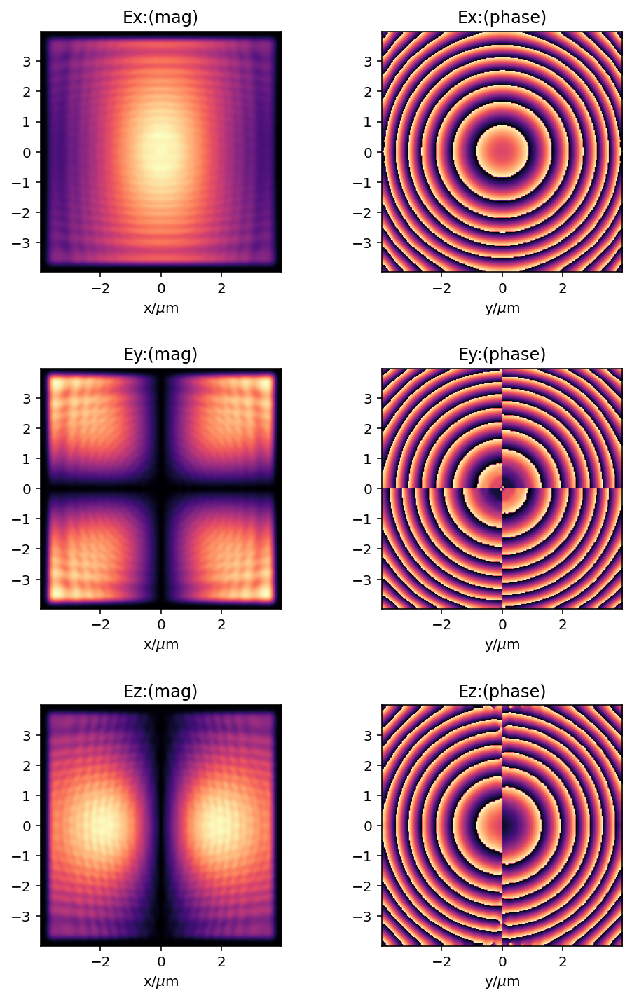

In [96]:
fig, ax = plt.subplots(nrows=3,
                       ncols=2,
                       figsize=(10*0.8,15*0.8))
for i in range(3):
    field = 'E'+['x','y','z'][i]
    extent = [metalens['x_coords'][0], metalens['x_coords'][-1],
             metalens['x_coords'][0], metalens['x_coords'][-1]]
    ax[i][0].imshow(np.abs(metalens['detector_fields'][field]),
            extent=extent,
            origin='lower',
            cmap='magma')
    ax[i][1].imshow(np.angle(metalens['detector_fields'][field]),
            extent=extent,
            origin='lower',
            cmap='magma')
    ax[i][0].set_xlabel('x/$\mu$m')
    ax[i][1].set_xlabel('y/$\mu$m')
    ax[i][0].set_title(field + ':(mag)')
    ax[i][1].set_title(field + ':(phase)')
plt.subplots_adjust(hspace=0.4)
plt.show()

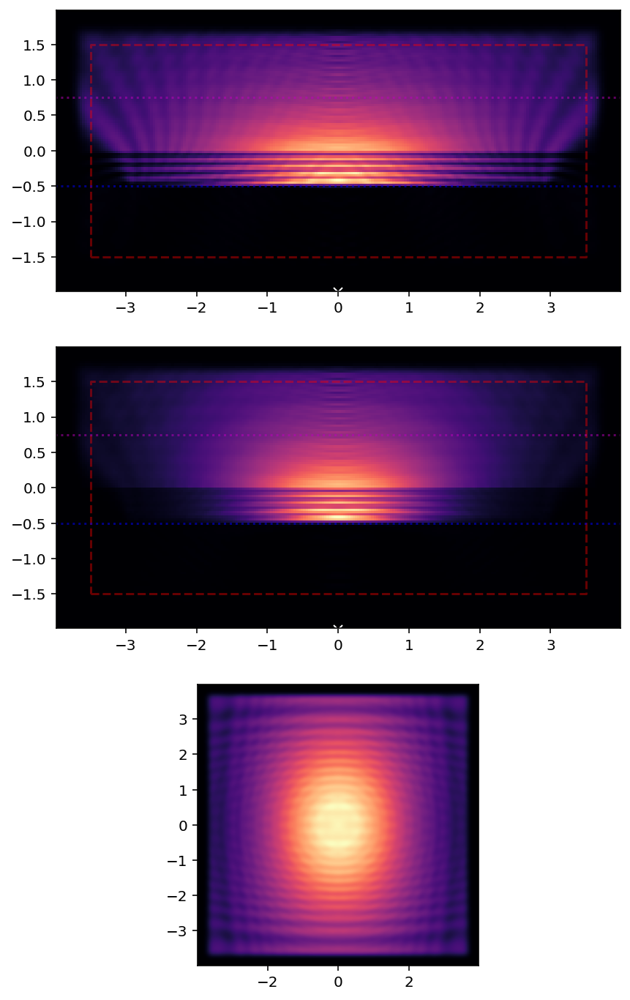

In [97]:
chosen_index_0 = int(metalens['computed_fields']['E2'].shape[0]/2)
vmin = np.percentile(metalens['computed_fields']['E2'].flatten(),1)
vmax = np.percentile(metalens['computed_fields']['E2'].flatten(),100)
fig,ax = plt.subplots(ncols=1,nrows=3,figsize=(5*1.5,6*2.0))

ax[0].imshow(metalens['computed_fields']['E2'][chosen_index_0,:,:].T,
          extent=[metalens['x_coords'][0],
                 metalens['x_coords'][-1],
                 metalens['z_coords'][0],
                 metalens['z_coords'][-1]],
          norm=Normalize(vmin=vmin,vmax=vmax),
          origin='lower',
          cmap='magma')

ax[1].imshow(metalens['computed_fields']['E2'][:,chosen_index_0,:].T,
          extent=[metalens['x_coords'][0],
                 metalens['x_coords'][-1],
                 metalens['z_coords'][0],
                 metalens['z_coords'][-1]],
          norm=Normalize(vmin=vmin,vmax=vmax),
          origin='lower',
          cmap='magma')

for axis in ax[:2]:
    axis.plot([-metalens['sim_cell_width']/2+metalens['PML_width'],
                metalens['sim_cell_width']/2-metalens['PML_width'],
                metalens['sim_cell_width']/2-metalens['PML_width'],
                -metalens['sim_cell_width']/2+metalens['PML_width'],
                -metalens['sim_cell_width']/2+metalens['PML_width']],
                [-metalens['sim_cell_height']/2+metalens['PML_width'],
                -metalens['sim_cell_height']/2+metalens['PML_width'],
                metalens['sim_cell_height']/2-metalens['PML_width'],
                metalens['sim_cell_height']/2-metalens['PML_width'],
                -metalens['sim_cell_height']/2+metalens['PML_width']],
                'r--',alpha=0.4)
    axis.plot([-metalens['sim_cell_width']/2,
              metalens['sim_cell_width']/2],
             [metalens['d']]*2,'m:',alpha=0.5)
    axis.plot([-metalens['sim_cell_width']/2,
              metalens['sim_cell_width']/2],
             [-metalens['s']]*2,'b:',alpha=0.5)
    axis.set_xlim(metalens['x_coords'][0], metalens['x_coords'][-1])
    axis.set_ylim(metalens['z_coords'][0], metalens['z_coords'][-1])
    if metalens['H'] <= metalens['sim_cell_height']/2:
        axis.plot([0],[-metalens['H']],'wx')

ax[2].imshow(metalens['computed_fields']['E2'][:,:,metalens['detector_index']].T,
          extent=[metalens['x_coords'][0],
                 metalens['x_coords'][-1],
                 metalens['x_coords'][0],
                 metalens['x_coords'][-1]],
          origin='lower',
          cmap='magma')
plt.show()

In [98]:
metalens['farfields'] = {}
farfield_axis = np.linspace(metalens['d'],
                metalens['ff'],
                int((metalens['ff']-metalens['d'])*metalens['resolution']))
metalens['farfield_axis'] = farfield_axis
one_field = metalens['detector_fields']['Ex']
idx_width = one_field.shape[0]
one_field = np.pad(one_field,(idx_width,idx_width))
metalens['kx_freqs'] = 2*np.pi*np.fft.fftfreq(
                            idx_width*3,
                            d=1./metalens['resolution'])
metalens['ky_freqs'] = 2*np.pi*np.fft.fftfreq(
                            idx_width*3,
                            d=1./metalens['resolution'])
(metalens['kx_freqs_v'], metalens['ky_freqs_v']) = np.meshgrid(metalens['kx_freqs'],metalens['ky_freqs'])
metalens['kz'] = np.sqrt(0.j+metalens['k_top']**2-metalens['kx_freqs_v']**2-metalens['ky_freqs_v']**2)
gator = np.exp(1.j*np.outer(farfield_axis-metalens['d'],
        metalens['kz']).reshape((*farfield_axis.shape,*metalens['kz'].shape)))
for field_label in ['Ex','Ey','Ez','Hx','Hy','Hz']:
    print('Computing the farfield for %s...' % field_label)
    one_field = metalens['detector_fields'][field_label]
    one_field = np.pad(one_field,(idx_width,idx_width))
    one_field = one_field[np.newaxis,:]
    nearfourier = (np.fft.fft2(one_field))
    farfourier = nearfourier*gator
    metalens['farfields'][field_label] = np.fft.ifft2(farfourier)
metalens['computed_farfields'] = {}
metalens['computed_farfields']['E2'] = np.abs(np.abs(metalens['farfields']['Ex'])**2+np.abs(metalens['farfields']['Ey'])**2+np.abs(metalens['farfields']['Ez'])**2)

Computing the farfield for Ex...
Computing the farfield for Ey...
Computing the farfield for Ez...
Computing the farfield for Hx...
Computing the farfield for Hy...
Computing the farfield for Hz...


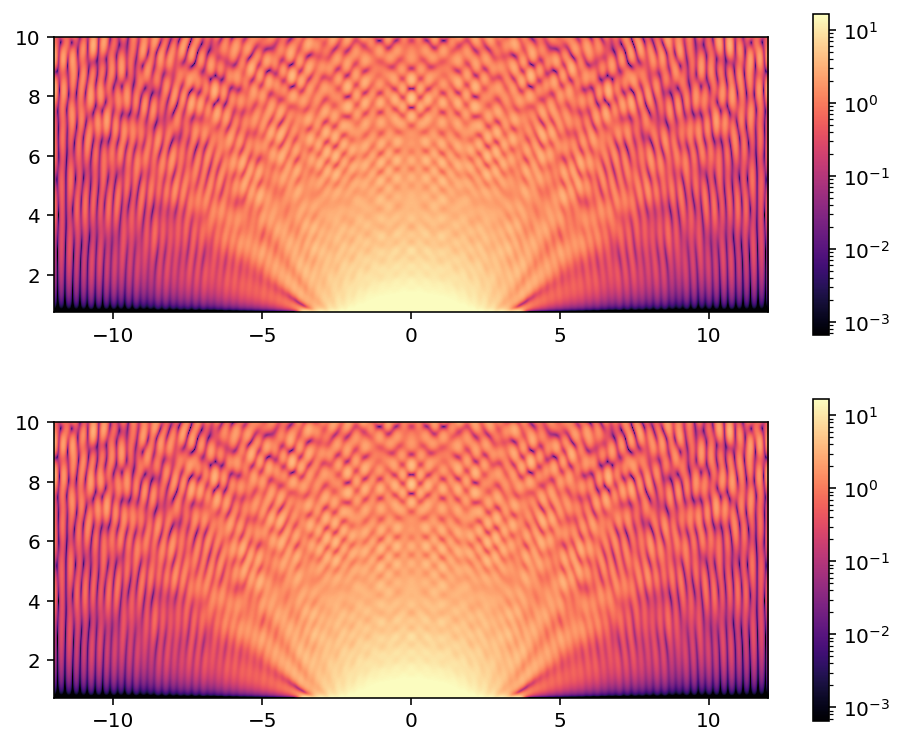

In [105]:
vmin = np.percentile(metalens['computed_fields']['E2'].flatten(),10)
vmax = np.percentile(metalens['computed_fields']['E2'].flatten(),90)
fig, ax = plt.subplots(ncols=1,nrows=2,figsize=(8,6.5))
normalizer = colors.LogNorm
dplot0 = ax[0].imshow(metalens['computed_farfields']['E2'][:,:,metalens['computed_farfields']['E2'].shape[1]//2],
         origin='lower',
         extent=[-3*metalens['sim_cell_width']/2,
                3*metalens['sim_cell_width']/2,
                farfield_axis[0],
                 farfield_axis[-1]],
            cmap='magma',
            norm=normalizer(vmin=vmin,vmax=vmax))
dplot1 = ax[1].imshow(metalens['computed_farfields']['E2'][:,:,metalens['computed_farfields']['E2'].shape[1]//2],
         origin='lower',
         extent=[-3*metalens['sim_cell_width']/2,
                3*metalens['sim_cell_width']/2,
                farfield_axis[0],farfield_axis[-1]],
                cmap='magma',
                norm=normalizer(vmin=vmin,vmax=vmax))
fig.colorbar(dplot1, ax=ax[1])
fig.colorbar(dplot0, ax=ax[0])
plt.show()

In [100]:
!pushover "done"

## Oreo to infinity and beyond!

In [667]:
resolution = 40
metalens = {'epsilon_bottom': 1.5**2,
            'epsilon_top': 1.0,
            'sim_cell_width': 8.,
            'sim_cell_height': 4.,
            'PML_width': 0.5,
            'wavelength': 0.5, # in vacuum
            'resolution': resolution,
            'symmetries': [],
            'complex_fields': True,
            'num_cores': 1,
            'quiet':False,
            'source_width':0,
            'z_max_farfield': 10,
            'dip_dir':{'phi':np.pi/2., 'theta':0.},
            'z_detector': 0.5, # z coordinate where the field is collected
            'H': 1.0, # depth of dipole wrt to middle of sim volume
            's': 0.5} # depth of the equiv current plane wrt to z=0
metalens['n_bottom'] = np.sqrt(metalens['epsilon_bottom'])
metalens['n_top'] = np.sqrt(metalens['epsilon_top'])
metalens['wavelength_bottom'] = metalens['wavelength']/np.sqrt(metalens['epsilon_bottom'])
metalens['wavelength_top'] = metalens['wavelength']/np.sqrt(metalens['epsilon_top'])
metalens['sim_time'] = metalens['sim_cell_height']/2*(metalens['n_bottom']+metalens['n_top'])
metalens['source_coord'] = - metalens['H']
metalens['k_bottom'] = 2*np.pi/metalens['wavelength_bottom']
metalens['k_top'] = 2*np.pi/metalens['wavelength_top']
metalens['w'] = metalens['sim_cell_width']-2*metalens['PML_width'] #  the width of the equiv corruent plane

sim_cell = mp.Vector3(metalens['sim_cell_width'],
                      metalens['sim_cell_width'],
                      metalens['sim_cell_height'])
pml_layers = [ mp.PML(metalens['PML_width']) ]
metalens['source_funcs'] = equiv_currents_bottom(metalens)
sources = []
for m_comp, m_comp_name in zip([mp.Ex,mp.Ey,mp.Ez,mp.Hx,mp.Hy,mp.Hz],
                                ['JEx','JEy','JEz','JHx','JHy','JHz']):
    this_source = mp.Source(src=mp.ContinuousSource(
                        wavelength=metalens['wavelength_bottom'],
                        width=metalens['source_width']),
                    component=m_comp,
                    amp_func = metalens['source_funcs'][m_comp_name],
                    center = mp.Vector3(0,0,-metalens['s']),
                    size = mp.Vector3(metalens['w'], metalens['w'], 0))
    sources.append(this_source)

metalens['bottom_chunk'] = mp.Block(size = mp.Vector3(
                metalens['sim_cell_width'],
                metalens['sim_cell_width'],
                metalens['sim_cell_height']/2),
                center = mp.Vector3(0,0,-metalens['sim_cell_height']/4),
                material = mp.Medium(epsilon = metalens['epsilon_bottom']))
metalens['top_chunk'] = mp.Block(size = mp.Vector3(
                metalens['sim_cell_width'],
                metalens['sim_cell_width'],
                metalens['sim_cell_height']/2),
                center = mp.Vector3(0,0,metalens['sim_cell_height']/4),
                material = mp.Medium(epsilon = metalens['epsilon_top']))
metalens['geometry'] = [metalens['bottom_chunk'],
                       metalens['top_chunk']]

sim = mp.Simulation(cell_size=sim_cell,
                boundary_layers=pml_layers,
                geometry=metalens['geometry'],
                force_complex_fields=metalens['complex_fields'],
                sources=sources,
                resolution=metalens['resolution'])
sim.init_sim()
sim.run(until=metalens['sim_time'])
metalens['fields'] = {'Ex': sim.get_array(component=mp.Ex),
                    'Ey': sim.get_array(component=mp.Ey),
                    'Ez': sim.get_array(component=mp.Ez),
                    'Hx': sim.get_array(component=mp.Hx),
                    'Hy': sim.get_array(component=mp.Hy),
                    'Hz': sim.get_array(component=mp.Hz)
                          }
E2 = (np.abs(metalens['fields']['Ex'])**2 + 
          np.abs(metalens['fields']['Ey'])**2 + 
          np.abs(metalens['fields']['Ez'])**2)


-----------
Initializing structure...
     block, center = (0,0,-1)
          size (8,8,2)
          axes (1,0,0), (0,1,0), (0,0,1)
     block, center = (0,0,1)
          size (8,8,2)
          axes (1,0,0), (0,1,0), (0,0,1)
Meep: using complex fields.
Meep progress: 0.0125/5.0 = 0.2% done in 20.9s, 8351.8s to go
Meep progress: 0.08750000000000001/5.0 = 1.8% done in 25.2s, 1413.1s to go
Meep progress: 0.1625/5.0 = 3.2% done in 29.4s, 874.1s to go
Meep progress: 0.23750000000000002/5.0 = 4.8% done in 33.6s, 673.3s to go
Meep progress: 0.3125/5.0 = 6.2% done in 37.7s, 566.2s to go
Meep progress: 0.3875/5.0 = 7.8% done in 41.9s, 499.3s to go
Meep progress: 0.4625/5.0 = 9.2% done in 46.2s, 452.8s to go
Meep progress: 0.5375/5.0 = 10.7% done in 50.4s, 418.4s to go
Meep progress: 0.6125/5.0 = 12.2% done in 54.6s, 391.4s to go
Meep progress: 0.6875/5.0 = 13.8% done in 58.9s, 369.3s to go
Meep progress: 0.7625000000000001/5.0 = 15.2% done in 63.1s, 350.5s to go
Meep progress: 0.8375/5.0 = 16.8

<IPython.core.display.Javascript object>


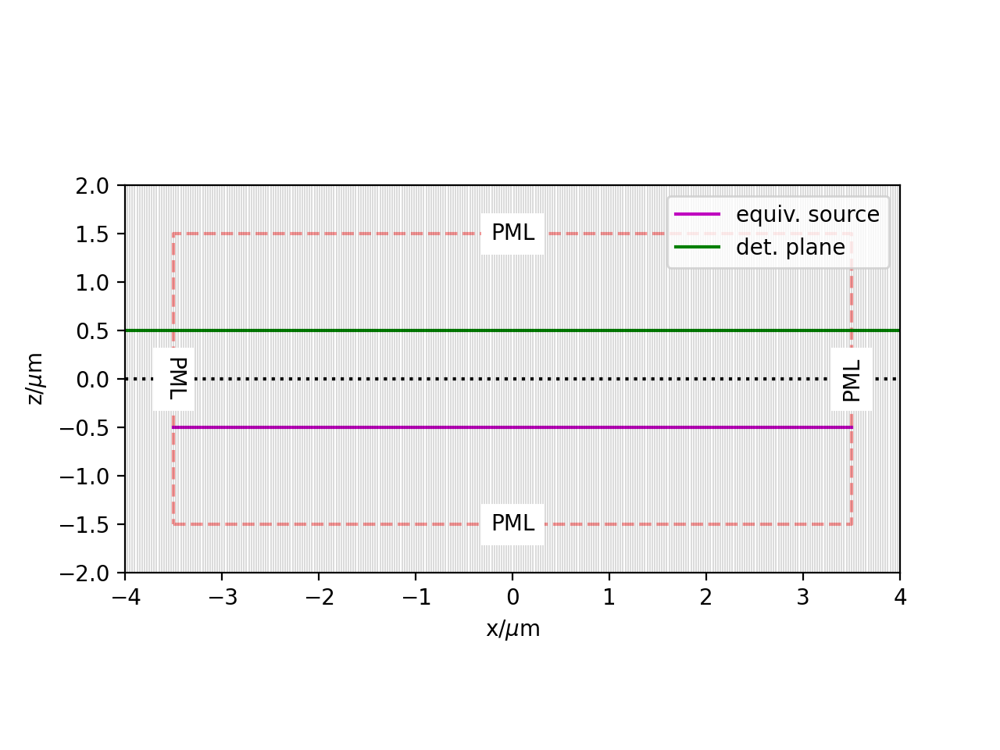

In [728]:
fig, ax = plt.subplots()
ax.plot([-metalens['sim_cell_width']/2+metalens['PML_width'],
               metalens['sim_cell_width']/2-metalens['PML_width'],
              metalens['sim_cell_width']/2-metalens['PML_width'],
              -metalens['sim_cell_width']/2+metalens['PML_width'],
              -metalens['sim_cell_width']/2+metalens['PML_width']],
             [-metalens['sim_cell_height']/2+metalens['PML_width'],
             -metalens['sim_cell_height']/2+metalens['PML_width'],
             metalens['sim_cell_height']/2-metalens['PML_width'],
             metalens['sim_cell_height']/2-metalens['PML_width'],
             -metalens['sim_cell_height']/2+metalens['PML_width']],
              'r--',alpha=0.4)
ax.text(0,metalens['sim_cell_height']/2-metalens['PML_width'],
        'PML',va='center',ha='center',backgroundcolor='white')
ax.text(0,-metalens['sim_cell_height']/2+metalens['PML_width'],
        'PML',va='center',ha='center',backgroundcolor='white')
ax.text(metalens['sim_cell_width']/2-metalens['PML_width'],0,
        'PML',va='center',ha='center',backgroundcolor='white',rotation=90)
ax.text(-metalens['sim_cell_width']/2+metalens['PML_width'],0,
        'PML',va='center',ha='center',backgroundcolor='white',rotation=-90)
ax.text(0,metalens['sim_cell_height']/2-metalens['PML_width'],
        'PML',va='center',ha='center',backgroundcolor='white')
ax.plot([-metalens['w']/2,metalens['w']/2],[-metalens['s']]*2,'m-',label='equiv. source')
ax.plot([-metalens['sim_cell_width']/2,metalens['sim_cell_width']/2],[metalens['z_detector']]*2,'g-',label='det. plane')
ax.plot([-metalens['sim_cell_width']/2,metalens['sim_cell_width']/2],[0,0],'k:')
for x in metalens['x_coords']:
    ax.plot([x,x],[-metalens['sim_cell_height']/2,metalens['sim_cell_height']/2],'k-',lw=0.1)
ax.set_xlim(-metalens['sim_cell_width']/2,metalens['sim_cell_width']/2)
ax.set_ylim(-metalens['sim_cell_height']/2,metalens['sim_cell_height']/2)
ax.set_aspect('equal')
ax.set_xlabel('x/$\mu$m')
ax.set_ylabel('z/$\mu$m')
ax.legend()
plt.show()

In [668]:
metalens['Nx'], metalens['Ny'], metalens['Nz']  = metalens['fields']['Ex'].shape
metalens['x_coords'] = np.linspace(-metalens['sim_cell_width']/2,
                                  metalens['sim_cell_width']/2,
                                  metalens['Nx'])
metalens['y_coords'] = np.linspace(-metalens['sim_cell_width']/2,
                                  metalens['sim_cell_width']/2,
                                  metalens['Ny'])
metalens['z_coords'] = np.linspace(-metalens['sim_cell_height']/2,
                                  metalens['sim_cell_height']/2,
                                  metalens['Nz'])
metalens['detector_index'] = np.argmin(np.abs(metalens['z_coords']
                                              - metalens['z_detector']))
metalens['detector_fields'] = {}
for field_name in ['Ex','Ey','Ez','Hx','Hy','Hz']:
    metalens['detector_fields'][field_name] = metalens['fields'][field_name][:,:,metalens['detector_index']].T

<IPython.core.display.Javascript object>


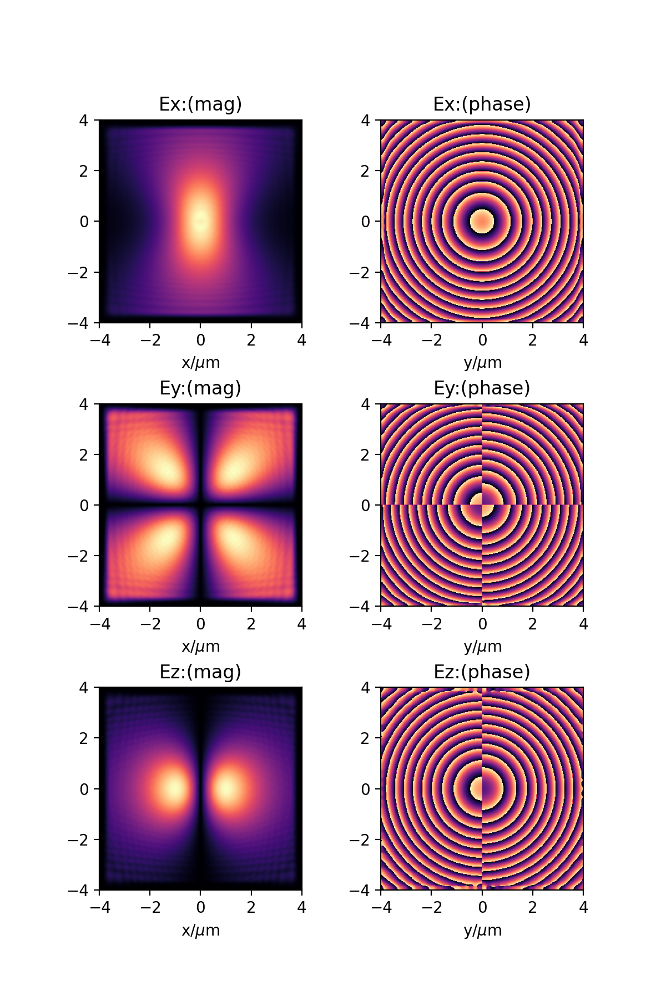

In [669]:
fig, ax = plt.subplots(nrows=3, ncols=2, figsize=(10*0.6,15*0.6))
for i in range(3):
    field = 'E'+['x','y','z'][i]
    extent = [-metalens['sim_cell_width']/2,
                     metalens['sim_cell_width']/2,
                     -metalens['sim_cell_width']/2,
                     metalens['sim_cell_width']/2]
    ax[i][0].imshow(np.abs(metalens['detector_fields'][field]),
              extent=extent,origin='lower',
              cmap='magma')
    ax[i][1].imshow(np.angle(metalens['detector_fields'][field]),
              extent=extent,
                origin='lower',
              cmap='magma')
    ax[i][0].set_xlabel('x/$\mu$m')
    ax[i][1].set_xlabel('y/$\mu$m')
    ax[i][0].set_title(field+':(mag)')
    ax[i][1].set_title(field+':(phase)')
plt.subplots_adjust(hspace=0.4)
plt.show()

<IPython.core.display.Javascript object>


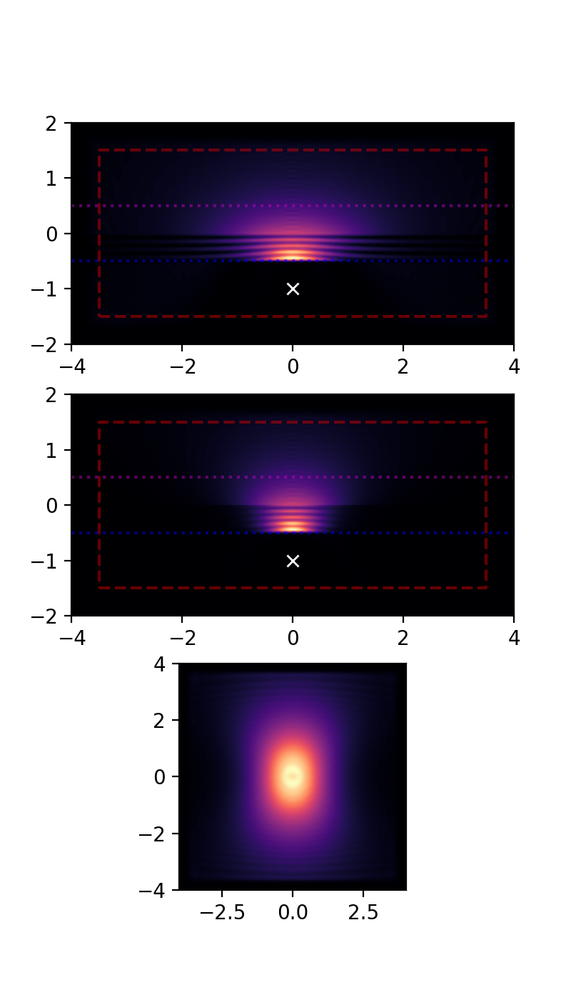

In [683]:
chosen_index_0 = int(E2.shape[0]/2)
vmin = np.percentile(E2.flatten(),1)
vmax = np.percentile(E2.flatten(),100)
fig,ax = plt.subplots(ncols=1,nrows=3,figsize=(4,7))

ax[0].imshow(E2[chosen_index_0,:,:].T,
          extent=[-metalens['sim_cell_width']/2,
                 metalens['sim_cell_width']/2,
                 -metalens['sim_cell_height']/2,
                 metalens['sim_cell_height']/2],
          norm=Normalize(vmin=vmin,vmax=vmax),
          origin='lower',
          cmap='magma')

ax[1].imshow(E2[:,chosen_index_0,:].T,
          extent=[-metalens['sim_cell_width']/2,
                 metalens['sim_cell_width']/2,
                 -metalens['sim_cell_height']/2,
                 metalens['sim_cell_height']/2],
          norm=Normalize(vmin=vmin,vmax=vmax),
          origin='lower',
          cmap='magma')

for axis in ax[:2]:
    axis.plot([-metalens['sim_cell_width']/2+metalens['PML_width'],
               metalens['sim_cell_width']/2-metalens['PML_width'],
              metalens['sim_cell_width']/2-metalens['PML_width'],
              -metalens['sim_cell_width']/2+metalens['PML_width'],
              -metalens['sim_cell_width']/2+metalens['PML_width']],
             [-metalens['sim_cell_height']/2+metalens['PML_width'],
             -metalens['sim_cell_height']/2+metalens['PML_width'],
             metalens['sim_cell_height']/2-metalens['PML_width'],
             metalens['sim_cell_height']/2-metalens['PML_width'],
             -metalens['sim_cell_height']/2+metalens['PML_width']],
              'r--',alpha=0.4)
    if metalens['H'] <= metalens['sim_cell_height']/2:
        axis.plot([0],[-metalens['H']],'wx')

for axis in ax[:2]:
    axis.plot([-metalens['sim_cell_width']/2,
              metalens['sim_cell_width']/2],
             [metalens['z_detector']]*2,'m:',alpha=0.5)
    axis.plot([-metalens['sim_cell_width']/2,
              metalens['sim_cell_width']/2],
             [-metalens['s']]*2,'b:',alpha=0.5)
    
ax[2].imshow(E2[:,:,metalens['detector_index']].T,
          extent=[-metalens['sim_cell_width']/2,
                 metalens['sim_cell_width']/2,
                 -metalens['sim_cell_width']/2,
                 metalens['sim_cell_width']/2],
#           norm=Normalize(vmin=vmin,vmax=vmax),
          origin='lower',
          cmap='magma')
plt.show()

In [671]:
farfields = {}
farfield_axis = np.linspace(metalens['z_detector'],
                metalens['z_max_farfield'],
                int((metalens['z_max_farfield']-metalens['z_detector'])*metalens['resolution']))
one_field = metalens['detector_fields']['Ex']
idx_width = one_field.shape[0]
one_field = np.pad(one_field,(idx_width,idx_width))
metalens['kx_freqs'] = 2*np.pi*np.fft.fftfreq(
                            idx_width*3,
                            d=1./metalens['resolution'])
metalens['ky_freqs'] = 2*np.pi*np.fft.fftfreq(
                            idx_width*3,
                            d=1./metalens['resolution'])
(metalens['kx_freqs_v'], metalens['ky_freqs_v']) = np.meshgrid(metalens['kx_freqs'],metalens['ky_freqs'])
metalens['kz'] = np.sqrt(0.j+metalens['k_top']**2-metalens['kx_freqs_v']**2-metalens['ky_freqs_v']**2)
gator = np.exp(1.j*np.outer(farfield_axis-metalens['z_detector'],
        metalens['kz']).reshape((*farfield_axis.shape,*metalens['kz'].shape)))
for field_label in ['Ex','Ey','Ez']:
    print(field_label)
    one_field = metalens['detector_fields'][field_label]
    one_field = np.pad(one_field,(idx_width,idx_width))
    one_field = one_field[np.newaxis,:]
    nearfourier = (np.fft.fft2(one_field))
    farfourier = nearfourier*gator
    farfields[field_label] = np.fft.ifft2(farfourier)#[:,idx_width:-idx_width,idx_width:-idx_width]
E2_far = np.abs(farfields['Ex']**2+farfields['Ey']**2+farfields['Ez']**2)

Ex
Ey
Ez


<IPython.core.display.Javascript object>


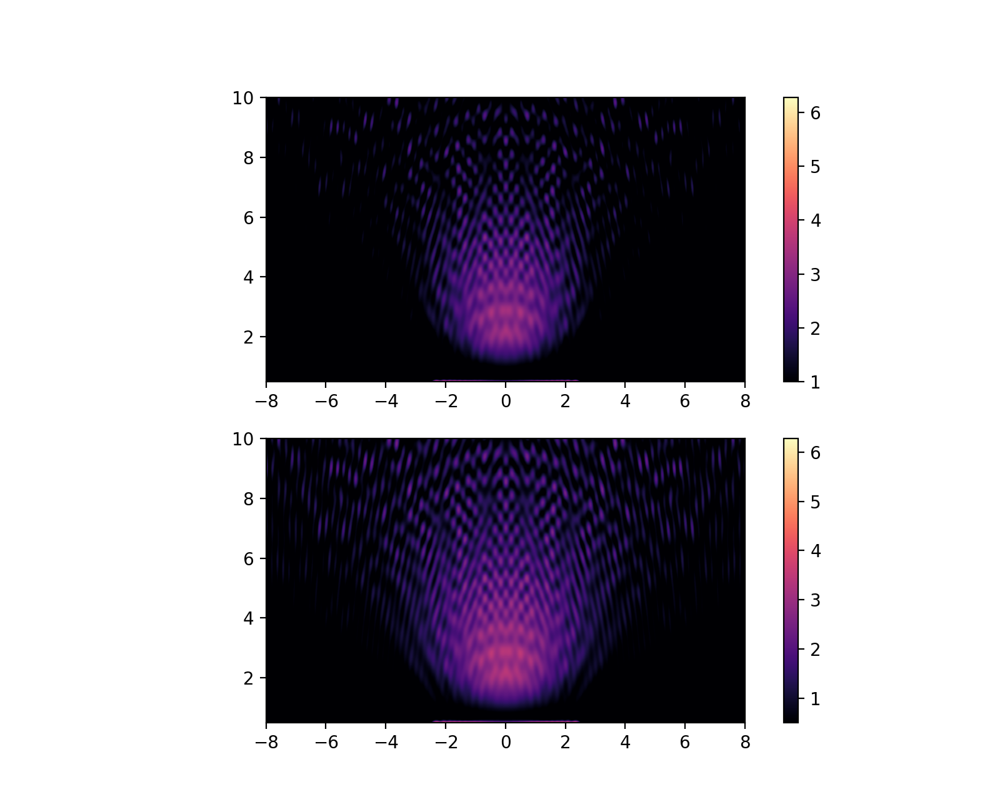

In [686]:
fig, ax = plt.subplots(ncols=1,nrows=2,figsize=(8,6.5))
normalizer = colors.Normalize
dplot0 = ax[0].imshow(E2_far[:,:,360],
         origin='lower',
         extent=[-2*metalens['sim_cell_width']/2,
                2*metalens['sim_cell_width']/2,
                farfield_axis[0],farfield_axis[-1]],
            cmap='magma',
            norm=normalizer(vmin=1))
dplot1 = ax[1].imshow(E2_far[:,:,360],
         origin='lower',
         extent=[-2*metalens['sim_cell_width']/2,
                2*metalens['sim_cell_width']/2,
                farfield_axis[0],farfield_axis[-1]],
                cmap='magma',
                norm=normalizer(vmin=0.5))
fig.colorbar(dplot1, ax=ax[1])
fig.colorbar(dplot0, ax=ax[0])
fig.show()

<IPython.core.display.Javascript object>


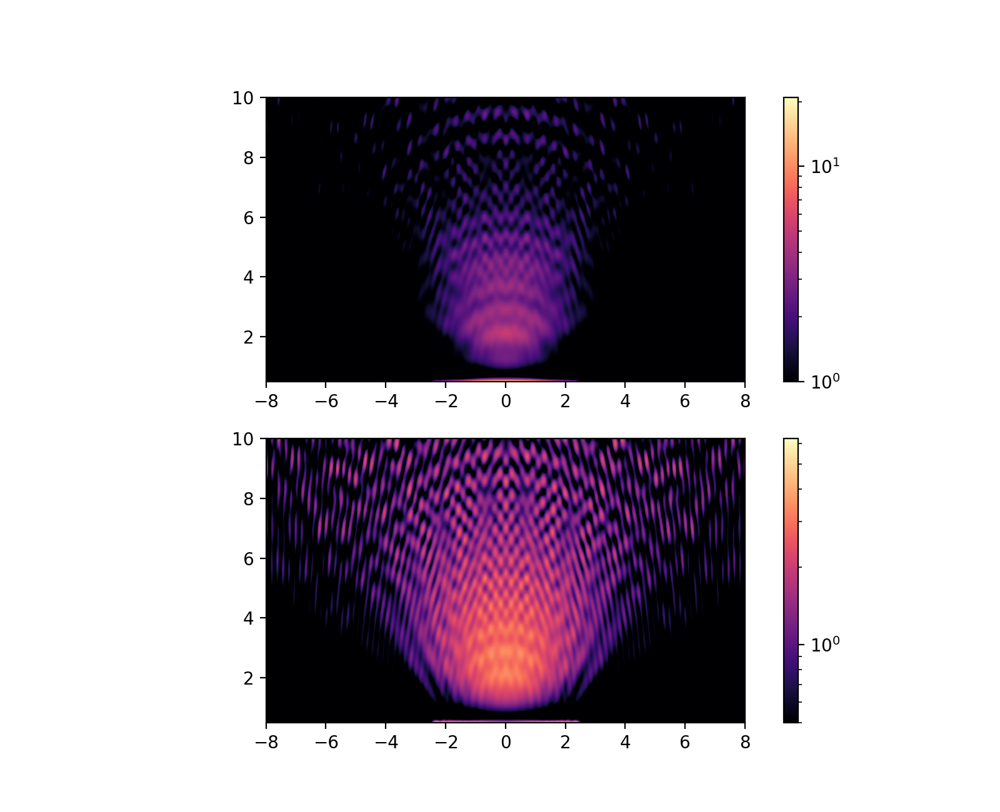

In [677]:
fig, ax = plt.subplots(ncols=1,nrows=2,figsize=(8,6.5))
dplot0 = ax[0].imshow(E2_far[:,360,:],
         origin='lower',
         extent=[-2*metalens['sim_cell_width']/2,
                2*metalens['sim_cell_width']/2,
                farfield_axis[0],farfield_axis[-1]],
                cmap='magma',
                norm=colors.LogNorm(vmin=1))
dplot1 = ax[1].imshow(E2_far[:,:,360],
         origin='lower',
         extent=[-2*metalens['sim_cell_width']/2,
                 2*metalens['sim_cell_width']/2,
                 farfield_axis[0],farfield_axis[-1]],cmap='magma',
                 norm=colors.LogNorm(vmin=0.5))
fig.colorbar(dplot1, ax=ax[1])
fig.colorbar(dplot0, ax=ax[0])
fig.show()

In [674]:
!pushover "done"

## Farfield Propagator

In [4]:
resolution = 30
metalens = {'epsilon': 1,
          'sim_cell_width': 8,
          'PML_width': 0.5,
          'wavelength': 0.5,
          'resolution': resolution,
          'symmetries': [],
          'sim_time': 10.,
          'complex_fields': True,
          'num_cores': 1,
          'quiet':False,
          'source_width':0,
          'dip_dir':{'phi':np.pi/2., 'theta':0.},
          'H': 2.0,
          's': 0.,
          'w':5.5,
          'h':3.}
metalens['source_coord'] = -metalens['H']
metalens['k'] = 2*np.pi/metalens['wavelength']
metalens['n'] = 1
metalens['ws'] = metalens['sim_cell_width']/2-metalens['PML_width']
cell = mp.Vector3(metalens['sim_cell_width'],
                      metalens['sim_cell_width'],
                      metalens['sim_cell_width'])
pml_layers = [ mp.PML(metalens['PML_width']) ]
sources = [mp.Source(src=mp.ContinuousSource(wavelength=metalens['wavelength'],
                                             width=metalens['source_width']),
                     component=mp.Ex,
      center=mp.Vector3(0, 0, metalens['source_coord']),
      size=mp.Vector3(0,0, 0)) ]
sim = mp.Simulation(cell_size=cell,
                boundary_layers=pml_layers,
                force_complex_fields=metalens['complex_fields'],
                sources=sources,
                resolution=metalens['resolution'])
sim.init_sim()
sim.run(until=metalens['sim_time'])
metalens['fields'] = {'Ex': sim.get_array(component=mp.Ex),
                    'Ey': sim.get_array(component=mp.Ey),
                    'Ez': sim.get_array(component=mp.Ez),
                    'Hx': sim.get_array(component=mp.Hx),
                    'Hy': sim.get_array(component=mp.Hy),
                    'Hz': sim.get_array(component=mp.Hz)
                          }

-----------
Initializing structure...
Meep: using complex fields.
Meep progress: 0.016666666666666666/10.0 = 0.2% done in 17.0s, 10194.1s to go
Meep progress: 0.16666666666666666/10.0 = 1.7% done in 21.5s, 1268.3s to go
Meep progress: 0.31666666666666665/10.0 = 3.2% done in 25.9s, 792.5s to go
Meep progress: 0.4666666666666667/10.0 = 4.7% done in 30.4s, 620.1s to go
Meep progress: 0.6166666666666667/10.0 = 6.2% done in 34.8s, 529.4s to go
Meep progress: 0.7666666666666666/10.0 = 7.7% done in 39.2s, 472.7s to go
Meep progress: 0.9166666666666666/10.0 = 9.2% done in 43.7s, 433.2s to go
Meep progress: 1.0666666666666667/10.0 = 10.7% done in 48.2s, 403.9s to go
Meep progress: 1.2166666666666666/10.0 = 12.2% done in 52.7s, 380.1s to go
Meep progress: 1.3666666666666667/10.0 = 13.7% done in 57.1s, 360.8s to go
Meep progress: 1.5/10.0 = 15.0% done in 61.1s, 346.3s to go
Meep progress: 1.65/10.0 = 16.5% done in 65.6s, 331.9s to go
Meep progress: 1.8/10.0 = 18.0% done in 70.1s, 319.3s to go
Mee

In [5]:
!pushover "yo, look at me!"

In [2]:
!say "beep, beep"

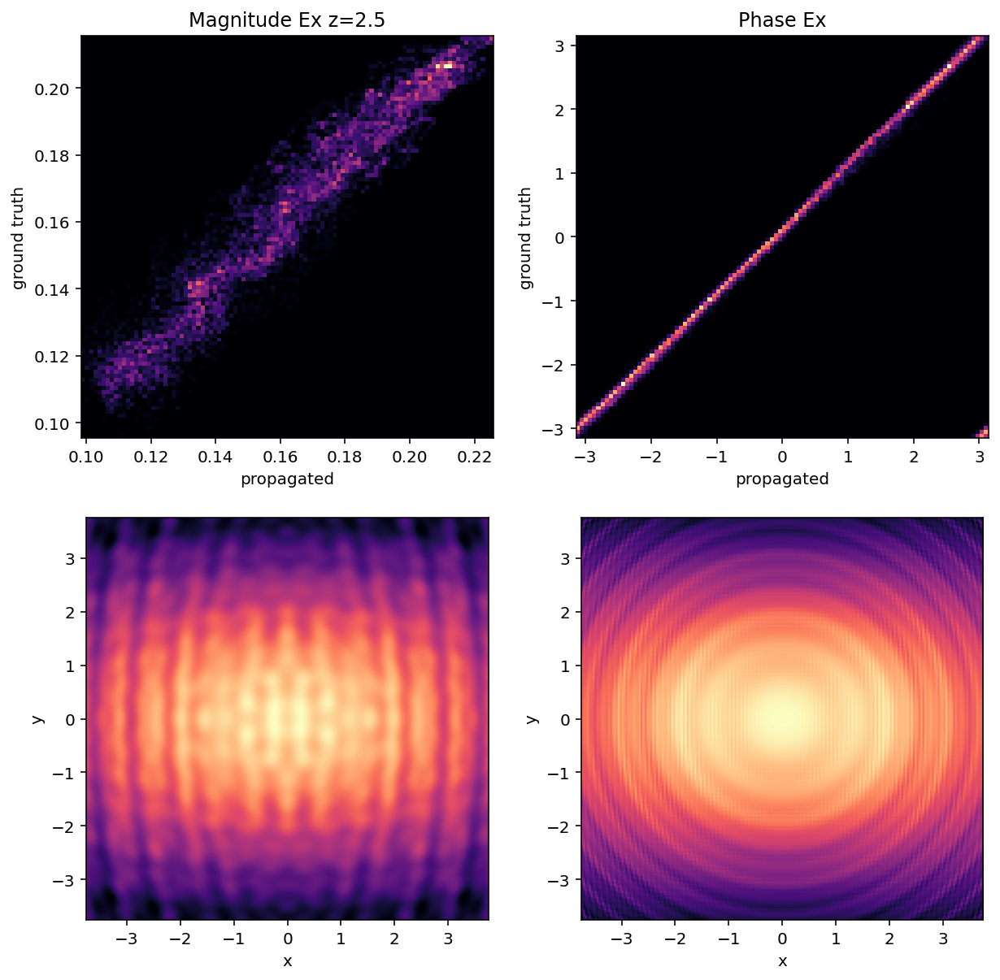

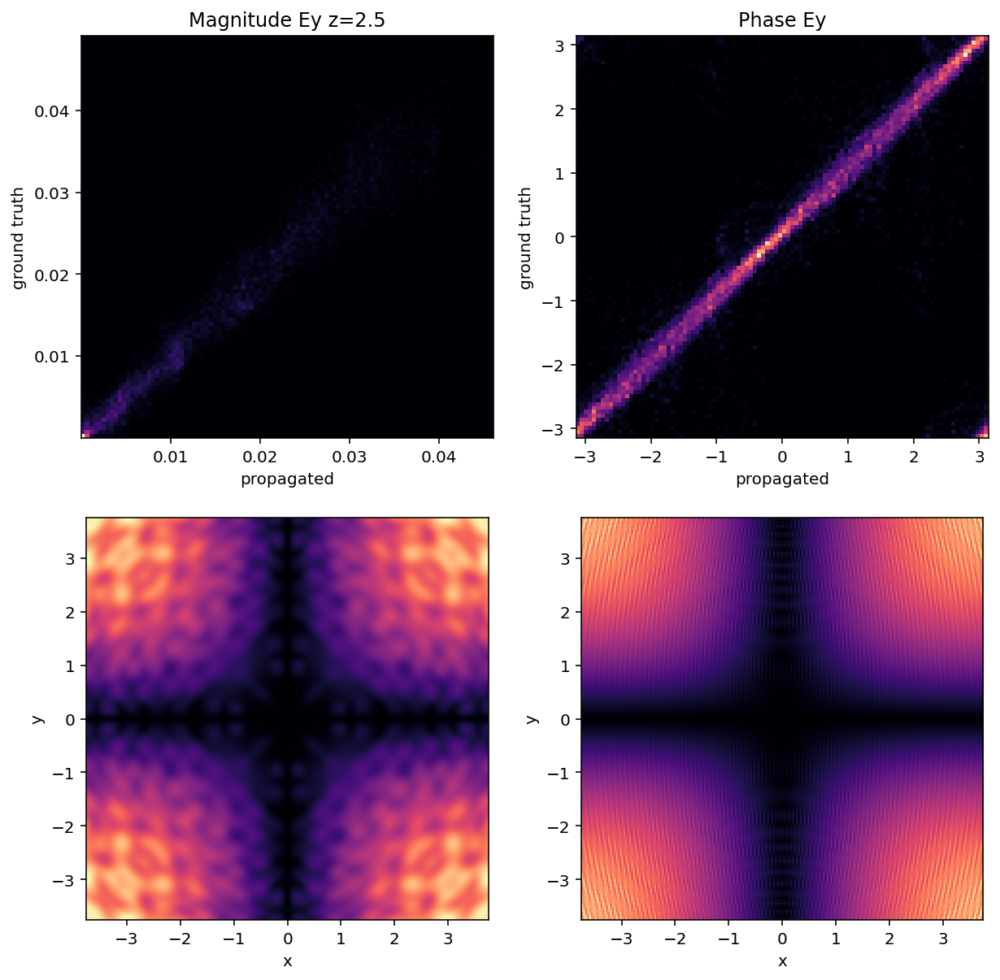

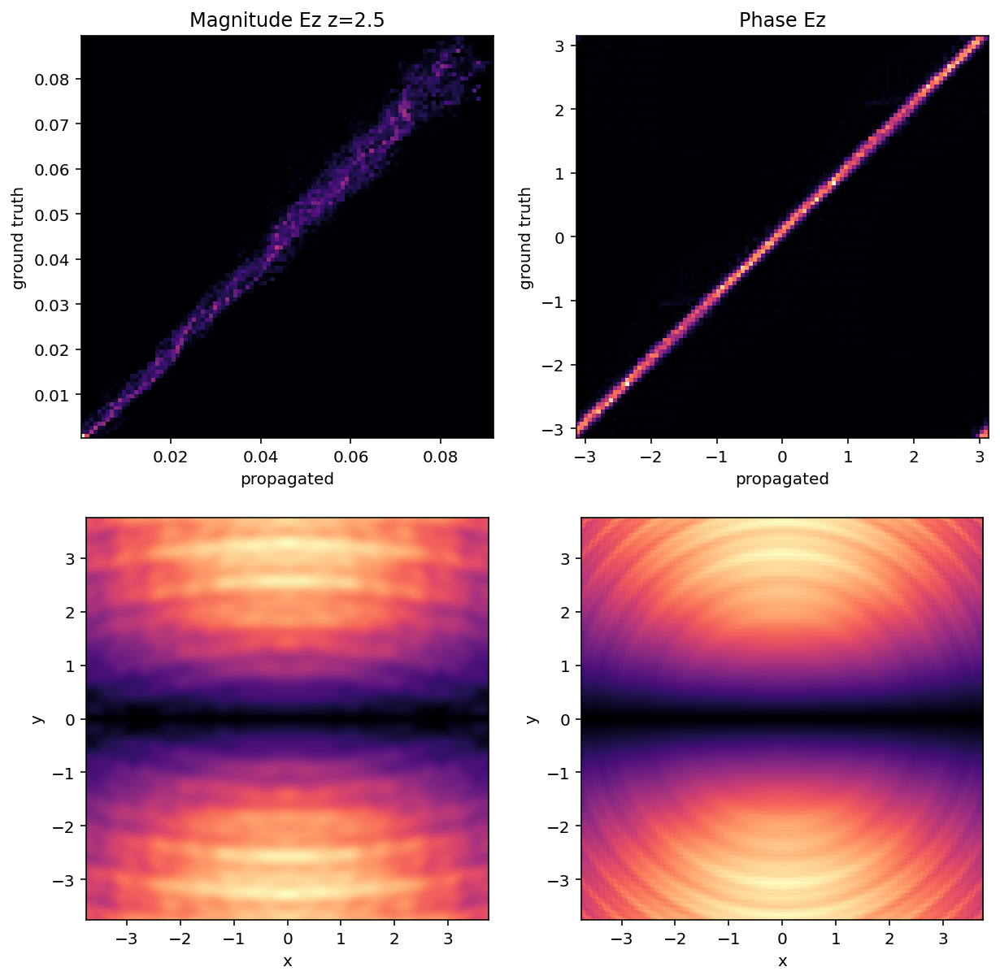

In [6]:
for one_field in ['Ex','Ey','Ez']:
    mid_index = int(metalens['fields'][one_field].shape[0]/2)
    PML_width = int(metalens['PML_width']*metalens['resolution'])
    F = metalens['fields'][one_field][:,:,mid_index]
    F = F[PML_width:-PML_width,PML_width:-PML_width]
    F = np.pad(F,(F.shape,F.shape))

    zi = 0
    zf = 2.5
    Fgt = metalens['fields'][one_field][:,:,mid_index+int(metalens['resolution']*(zf-zi))]
    Fgt = Fgt[PML_width:-PML_width,PML_width:-PML_width]
    Fgt = np.pad(Fgt,(Fgt.shape,Fgt.shape))

    Fft = np.fft.fftshift(np.fft.fft2(F))
    metalens['kx'] = 2*np.pi*(np.fft.fftfreq(
                    F.shape[0],
                    d=1./metalens['resolution']))
    metalens['ky'] = 2*np.pi*(np.fft.fftfreq(
                    F.shape[1],
                    d=1./metalens['resolution']))
    metalens['kx'] = np.fft.fftshift(metalens['kx'])
    metalens['ky'] = np.fft.fftshift(metalens['ky'])
    metalens['kx,ky'] = np.meshgrid(metalens['kx'],metalens['ky'])
    metalens['kz'] = np.sqrt(metalens['k']**2-(metalens['kx,ky'][0]**2+
                                               metalens['kx,ky'][1]**2+0j))
    propagator_forth = np.exp(1j*metalens['kz']*(zf-zi))
    Fft_far_forth = Fft * propagator_forth
    farfield_forth = np.fft.ifft2(np.fft.ifftshift(Fft_far_forth))
    farfield = farfield_forth
    # fig, ax = plt.subplots(figsize=(10,10),ncols=2)
    # ax[0].imshow(np.abs(farfield),
    #          extent=[-1/2*farfield.shape[0]/metalens['resolution'],
    #                 1/2*farfield.shape[0]/metalens['resolution'],
    #                  -1/2*farfield.shape[0]/metalens['resolution'],
    #                  1/2*farfield.shape[0]/metalens['resolution']
    #                 ])
    # ax[0].set_xlim(-1/2*metalens['sim_cell_width'],
    #                 1/2*metalens['sim_cell_width'])
    # ax[0].set_ylim(-1/2*metalens['sim_cell_width'],
    #                 1/2*metalens['sim_cell_width'])
    # ax[1].imshow(np.abs(Fgt),
    #          extent=[-1/2*farfield.shape[0]/metalens['resolution'],
    #                 1/2*farfield.shape[0]/metalens['resolution'],
    #                  -1/2*farfield.shape[0]/metalens['resolution'],
    #                  1/2*farfield.shape[0]/metalens['resolution']
    #                 ])
    # ax[1].set_xlim(-1/2*metalens['sim_cell_width'],
    #                 1/2*metalens['sim_cell_width'])
    # ax[1].set_ylim(-1/2*metalens['sim_cell_width'],
    #                 1/2*metalens['sim_cell_width'])
    # plt.show()

    original_width = mid_index*2
    expanded_pad = int((farfield.shape[0] - original_width)/2)
    good_farfield = farfield[expanded_pad:-expanded_pad,expanded_pad:-expanded_pad][PML_width:-PML_width,PML_width:-PML_width]
    farfield_gt = Fgt[expanded_pad:-expanded_pad,expanded_pad:-expanded_pad][PML_width:-PML_width,PML_width:-PML_width]

    v1 = np.abs(good_farfield.reshape(good_farfield.shape[0]*good_farfield.shape[1]))
    v2 = np.abs(farfield_gt.reshape(farfield_gt.shape[0]*farfield_gt.shape[1]))
    v3 = np.angle(good_farfield.reshape(good_farfield.shape[0]*good_farfield.shape[1]))
    v4 = np.angle(farfield_gt.reshape(farfield_gt.shape[0]*farfield_gt.shape[1]))
    good_indices = ((v1>0) & (v2>0))
    v1 = v1[good_indices]
    v2 = v2[good_indices]
    v3 = v3[good_indices]
    v4 = v4[good_indices]
    w = (metalens['sim_cell_width']-metalens['PML_width'])/2


    fig,ax = plt.subplots(ncols=2,nrows=2,figsize=(10,10))
    ax[0,0].hist2d(v1,v2,bins=100,cmap='magma')
    ax[0,0].set_title('Magnitude '+one_field+' z=%.1f'%zf)
    ax[0,0].set_xlabel('propagated')
    ax[0,0].set_ylabel('ground truth')
    ax[0,1].hist2d(v3,v4,bins=100,cmap='magma')
    ax[0,1].set_xlabel('propagated')
    ax[0,1].set_ylabel('ground truth')
    ax[0,1].set_title('Phase '+one_field)
    ax[1,0].imshow(np.abs(good_farfield),extent=[-w,w,-w,w],cmap='magma')
    ax[1,0].set_xlabel('x')
    ax[1,0].set_ylabel('y')
    ax[1,1].imshow(np.abs(farfield_gt),extent=[-w,w,-w,w],cmap='magma')
    ax[1,1].set_xlabel('x')
    ax[1,1].set_ylabel('y')
    plt.show()

In [7]:
np.corrcoef(v1,v2)

array([[1.        , 0.98927616],
       [0.98927616, 1.        ]])

In [8]:
from matplotlib.patches import Circle

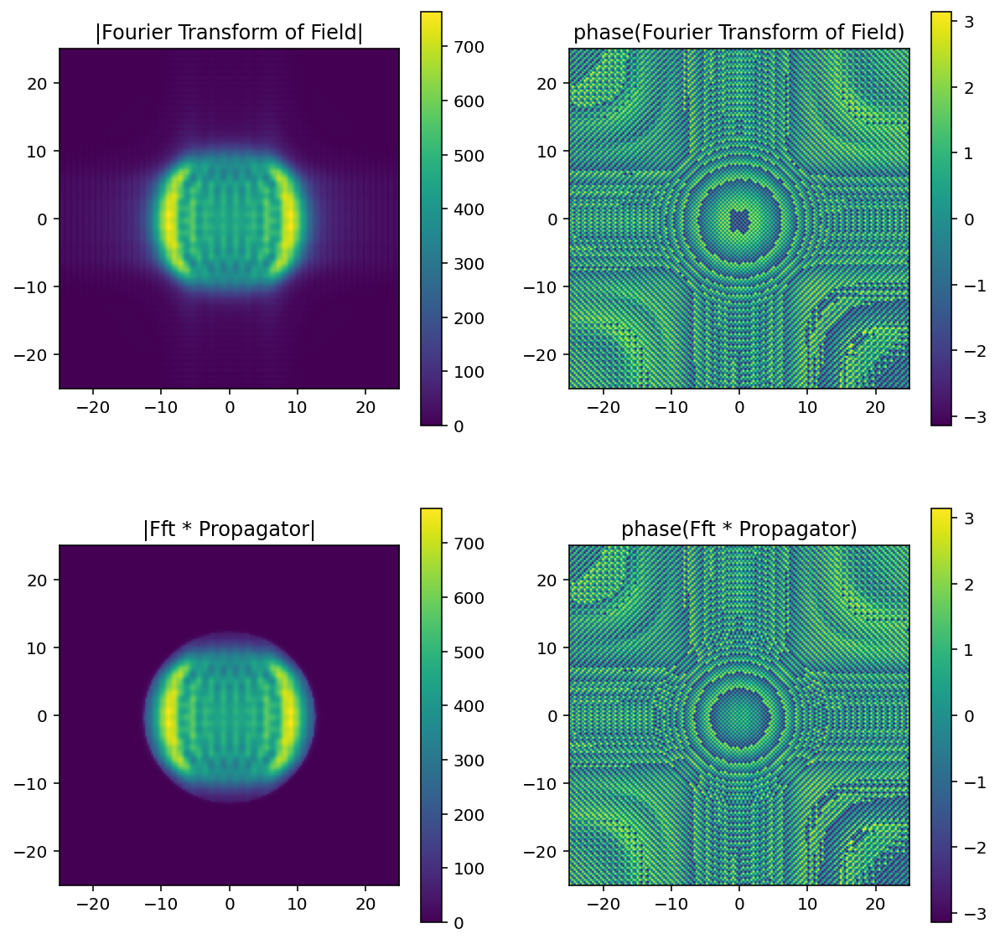

In [329]:
fig, ax = plt.subplots(figsize=(10,10),ncols=2,nrows=2)
extent = [np.min(metalens['kx']),
                     np.max(metalens['kx']),
                     np.min(metalens['ky']),
                     np.max(metalens['ky'])]
im1 = ax[0,0].imshow(np.abs(Fft),
              extent=extent)
ax[0,0].set_title('|Fourier Transform of Field|')
im2 = ax[0,1].imshow(np.angle(Fft),
              extent=extent)
ax[0,1].set_title('phase(Fourier Transform of Field)')
im3 = ax[1,0].imshow(np.abs(Fft*propagator),
              extent=extent)
ax[1,0].set_title('|Fft * Propagator|')
im4 = ax[1,1].imshow(np.angle(Fft*propagator),
              extent=extent)
ax[1,1].set_title('phase(Fft * Propagator)')
for axis in ax:
    for ux in axis:
        ux.set_xlim(-25,25)
        ux.set_ylim(-25,25)
fig.colorbar(im1, ax=ax[0,0])
fig.colorbar(im2, ax=ax[0,1])
fig.colorbar(im3, ax=ax[1,0])
fig.colorbar(im4, ax=ax[1,1])
plt.show()

## Testing Equivalent Currents (third try: full pillbox)

In vaccum, simulate a point dipole source, located along the axis, with a dipole making an angle phi with respect to the z-axis, and an angle theta wrt the x-axis. The source is 2.5 um below the z=0 plane, and must be recovered by equivalent currents at the plane z=0.

In [510]:
resolution = 40
metalens = {'epsilon': 1,
          'sim_cell_width': 8,
          'PML_width': 0.5,
          'wavelength': 0.5,
          'resolution': resolution,
          'symmetries': [],
          'sim_time': 10.,
          'complex_fields': True,
          'num_cores': 1,
          'quiet':False,
          'source_width':0,
          'dip_dir':{'phi':np.pi/2., 'theta':0.},
          'H': 2.0,
          's': 0.,
          'w':5.5,
          'h':3.}
metalens['source_coord'] = -metalens['H']
metalens['k'] = 2*np.pi/metalens['wavelength']
metalens['n'] = 1
metalens['ws'] = metalens['sim_cell_width']/2-metalens['PML_width']
cell = mp.Vector3(metalens['sim_cell_width'],
                      metalens['sim_cell_width'],
                      metalens['sim_cell_width'])
pml_layers = [ mp.PML(metalens['PML_width']) ]
sources = [mp.Source(src=mp.ContinuousSource(wavelength=metalens['wavelength'],
                                             width=metalens['source_width']),
                     component=mp.Ex,
      center=mp.Vector3(0, 0, metalens['source_coord']),
      size=mp.Vector3(0,0, 0)) ]
sim = mp.Simulation(cell_size=cell,
                boundary_layers=pml_layers,
                force_complex_fields=metalens['complex_fields'],
                sources=sources,
                resolution=metalens['resolution'])
sim.init_sim()
sim.run(until=metalens['sim_time'])
metalens['fields'] = {'Ex': sim.get_array(component=mp.Ex),
                    'Ey': sim.get_array(component=mp.Ey),
                    'Ez': sim.get_array(component=mp.Ez),
                    'Hx': sim.get_array(component=mp.Hx),
                    'Hy': sim.get_array(component=mp.Hy),
                    'Hz': sim.get_array(component=mp.Hz)
                          }
E2_point_src = (np.abs(metalens['fields']['Ex'])**2 + 
          np.abs(metalens['fields']['Ey'])**2 + 
          np.abs(metalens['fields']['Ez'])**2)

del(sim)

metalens = {'epsilon': 1,
          'sim_cell_width': 8,
          'PML_width': 0.5,
          'wavelength': 0.5,
          'resolution': resolution,
          'symmetries': [],
          'sim_time': 10.,
          'complex_fields': True,
          'num_cores': 1,
          'quiet':False,
          'source_width':0,
          'dip_dir':{'phi':np.pi/2., 'theta':0.},
          'H': 2.5,
          's': 0.,
          'w':5.5,
          'h':3.}
metalens['source_coord'] = -metalens['H']
metalens['k'] = 2*np.pi/metalens['wavelength']
metalens['n'] = 1
metalens['source_funcs'] = equiv_currents(metalens)
metalens['ws'] = metalens['sim_cell_width']/2-metalens['PML_width']
cell = mp.Vector3(metalens['sim_cell_width'],
                      metalens['sim_cell_width'],
                      metalens['sim_cell_width'])
pml_layers = [ mp.PML(metalens['PML_width']) ]

sizes = {
    "Top":mp.Vector3(metalens['w'],metalens['w'], 0),
    "Bottom":mp.Vector3(metalens['w'], metalens['w'], 0),
    "Left":mp.Vector3(metalens['h'],0,metalens['h']),
    "Right":mp.Vector3(metalens['h'],0,metalens['h']),
    "Front":mp.Vector3(0,metalens['h'],metalens['h']),
    "Back":mp.Vector3(0,metalens['h'],metalens['h'])
}
centers = {
    "Top":mp.Vector3(0,0,metalens['h']),
    "Bottom":mp.Vector3(0,0,0),
    "Left":mp.Vector3(0,-metalens['w']/2,metalens['h']/2),
    "Right":mp.Vector3(0,metalens['w']/2,metalens['h']/2),
    "Front":mp.Vector3(metalens['w']/2,0,metalens['h']/2),
    "Back":mp.Vector3(-metalens['w']/2,0,metalens['h']/2)
}

sources = []
# for plane in ["Top","Bottom","Left","Right","Front","Back"]:
sign = 1
for plane in ["Bottom"]:
    this_sources = [mp.Source(src=mp.ContinuousSource(wavelength=metalens['wavelength'],
                                                      width=metalens['source_width']),
                                                      component=m_component,
      amp_func=metalens['source_funcs'][plane][m_component_name],
      center=centers[plane],
      size=sizes[plane]) for m_component, m_component_name in zip([mp.Ex,mp.Ey,mp.Ez,mp.Hx,mp.Hy,mp.Hz],['JEx','JEy','JEz','JHx','JHy','JHz'])]
    sources.extend(this_sources)

sim = mp.Simulation(cell_size=cell,
                boundary_layers=pml_layers,
                force_complex_fields=metalens['complex_fields'],
                sources=sources,
                resolution=metalens['resolution'])
sim.init_sim()
sim.run(until=metalens['sim_time'])
metalens['fields'] = {'Ex': sim.get_array(component=mp.Ex),
                    'Ey': sim.get_array(component=mp.Ey),
                    'Ez': sim.get_array(component=mp.Ez),
                    'Hx': sim.get_array(component=mp.Hx),
                    'Hy': sim.get_array(component=mp.Hy),
                    'Hz': sim.get_array(component=mp.Hz)
                          }
E2_equiv_src = (np.abs(metalens['fields']['Ex'])**2 + 
          np.abs(metalens['fields']['Ey'])**2 + 
          np.abs(metalens['fields']['Ez'])**2)

pickle.dump({'point': E2_point_src,'equiv':E2_equiv_src},open('equiv-3.pkl','wb'))

-----------
Initializing structure...
Meep: using complex fields.
Meep progress: 0.0125/10.0 = 0.1% done in 33.7s, 26921.2s to go
Meep progress: 0.0625/10.0 = 0.6% done in 38.4s, 6102.0s to go
Meep progress: 0.1125/10.0 = 1.1% done in 43.0s, 3781.1s to go
Meep progress: 0.1625/10.0 = 1.6% done in 47.6s, 2881.2s to go
Meep progress: 0.21250000000000002/10.0 = 2.1% done in 52.2s, 2402.4s to go
Meep progress: 0.2625/10.0 = 2.6% done in 56.7s, 2104.3s to go
Meep progress: 0.3125/10.0 = 3.1% done in 61.4s, 1902.3s to go
Meep progress: 0.36250000000000004/10.0 = 3.6% done in 66.1s, 1756.6s to go
Meep progress: 0.41250000000000003/10.0 = 4.1% done in 70.7s, 1642.6s to go
Meep progress: 0.4625/10.0 = 4.6% done in 75.3s, 1552.1s to go
Meep progress: 0.5125000000000001/10.0 = 5.1% done in 79.9s, 1479.2s to go
Meep progress: 0.5625/10.0 = 5.6% done in 84.5s, 1417.7s to go
Meep progress: 0.6125/10.0 = 6.1% done in 89.0s, 1364.8s to go
Meep progress: 0.6625000000000001/10.0 = 6.6% done in 93.6s, 13

Meep progress: 6.0625/10.0 = 60.6% done in 588.5s, 382.2s to go
Meep progress: 6.112500000000001/10.0 = 61.1% done in 593.1s, 377.2s to go
Meep progress: 6.1625000000000005/10.0 = 61.6% done in 597.7s, 372.2s to go
Meep progress: 6.2125/10.0 = 62.1% done in 602.3s, 367.2s to go
Meep progress: 6.2625/10.0 = 62.6% done in 606.9s, 362.2s to go
Meep progress: 6.3125/10.0 = 63.1% done in 611.4s, 357.2s to go
Meep progress: 6.362500000000001/10.0 = 63.6% done in 616.0s, 352.2s to go
Meep progress: 6.4125000000000005/10.0 = 64.1% done in 620.6s, 347.2s to go
Meep progress: 6.4625/10.0 = 64.6% done in 625.3s, 342.3s to go
Meep progress: 6.5125/10.0 = 65.1% done in 629.9s, 337.3s to go
Meep progress: 6.5625/10.0 = 65.6% done in 634.5s, 332.3s to go
Meep progress: 6.612500000000001/10.0 = 66.1% done in 639.0s, 327.4s to go
Meep progress: 6.6625000000000005/10.0 = 66.6% done in 643.6s, 322.4s to go
Meep progress: 6.7125/10.0 = 67.1% done in 648.2s, 317.5s to go
Meep progress: 6.7625/10.0 = 67.6% 

Meep progress: 2.0625/10.0 = 20.6% done in 221.5s, 852.4s to go
Meep progress: 2.1125000000000003/10.0 = 21.1% done in 226.1s, 844.4s to go
Meep progress: 2.1625/10.0 = 21.6% done in 230.8s, 836.5s to go
Meep progress: 2.2125/10.0 = 22.1% done in 235.5s, 828.8s to go
Meep progress: 2.2625/10.0 = 22.6% done in 240.1s, 821.1s to go
Meep progress: 2.3125/10.0 = 23.1% done in 244.8s, 813.7s to go
Meep progress: 2.3625000000000003/10.0 = 23.6% done in 249.3s, 806.1s to go
Meep progress: 2.4125/10.0 = 24.1% done in 254.0s, 798.8s to go
Meep progress: 2.4625000000000004/10.0 = 24.6% done in 258.6s, 791.6s to go
Meep progress: 2.5125/10.0 = 25.1% done in 263.3s, 784.7s to go
Meep progress: 2.5625/10.0 = 25.6% done in 268.0s, 777.8s to go
Meep progress: 2.6125000000000003/10.0 = 26.1% done in 272.6s, 770.9s to go
Meep progress: 2.6625/10.0 = 26.6% done in 277.3s, 764.1s to go
Meep progress: 2.7125000000000004/10.0 = 27.1% done in 281.9s, 757.2s to go
Meep progress: 2.7625/10.0 = 27.6% done in 2

Meep progress: 8.1125/10.0 = 81.1% done in 782.7s, 182.1s to go
Meep progress: 8.1625/10.0 = 81.6% done in 787.3s, 177.2s to go
Meep progress: 8.2125/10.0 = 82.1% done in 791.9s, 172.4s to go
Meep progress: 8.262500000000001/10.0 = 82.6% done in 796.5s, 167.5s to go
Meep progress: 8.3125/10.0 = 83.1% done in 801.1s, 162.6s to go
Meep progress: 8.3625/10.0 = 83.6% done in 805.7s, 157.8s to go
Meep progress: 8.4125/10.0 = 84.1% done in 810.3s, 152.9s to go
Meep progress: 8.4625/10.0 = 84.6% done in 814.8s, 148.0s to go
Meep progress: 8.512500000000001/10.0 = 85.1% done in 819.4s, 143.2s to go
Meep progress: 8.5625/10.0 = 85.6% done in 824.1s, 138.3s to go
Meep progress: 8.6125/10.0 = 86.1% done in 828.7s, 133.5s to go
Meep progress: 8.6625/10.0 = 86.6% done in 833.2s, 128.6s to go
Meep progress: 8.7125/10.0 = 87.1% done in 837.8s, 123.8s to go
Meep progress: 8.762500000000001/10.0 = 87.6% done in 842.4s, 119.0s to go
Meep progress: 8.8125/10.0 = 88.1% done in 847.1s, 114.1s to go
Meep pr

(320, 320, 140)


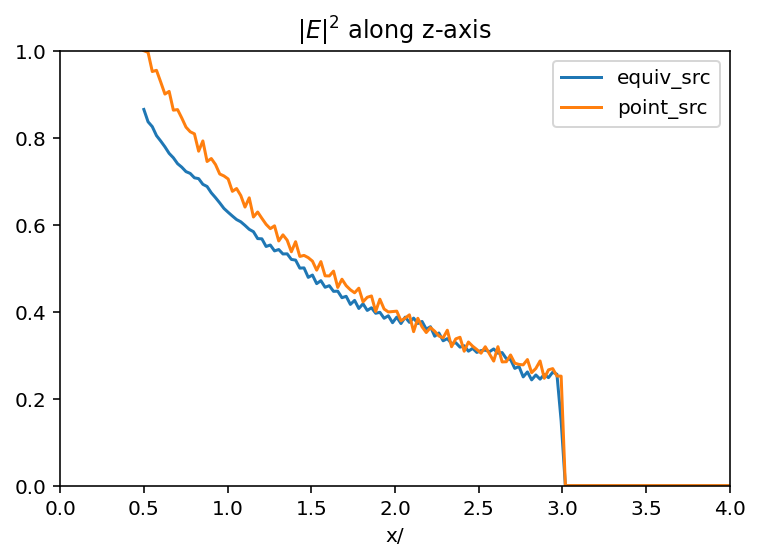

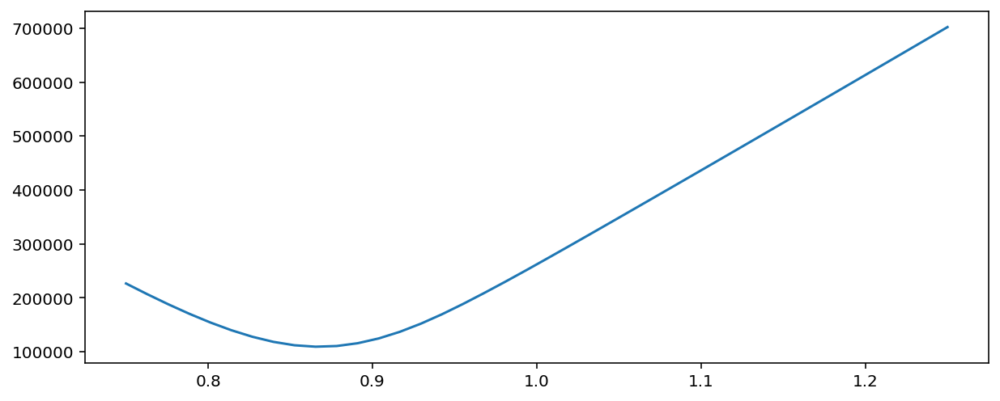

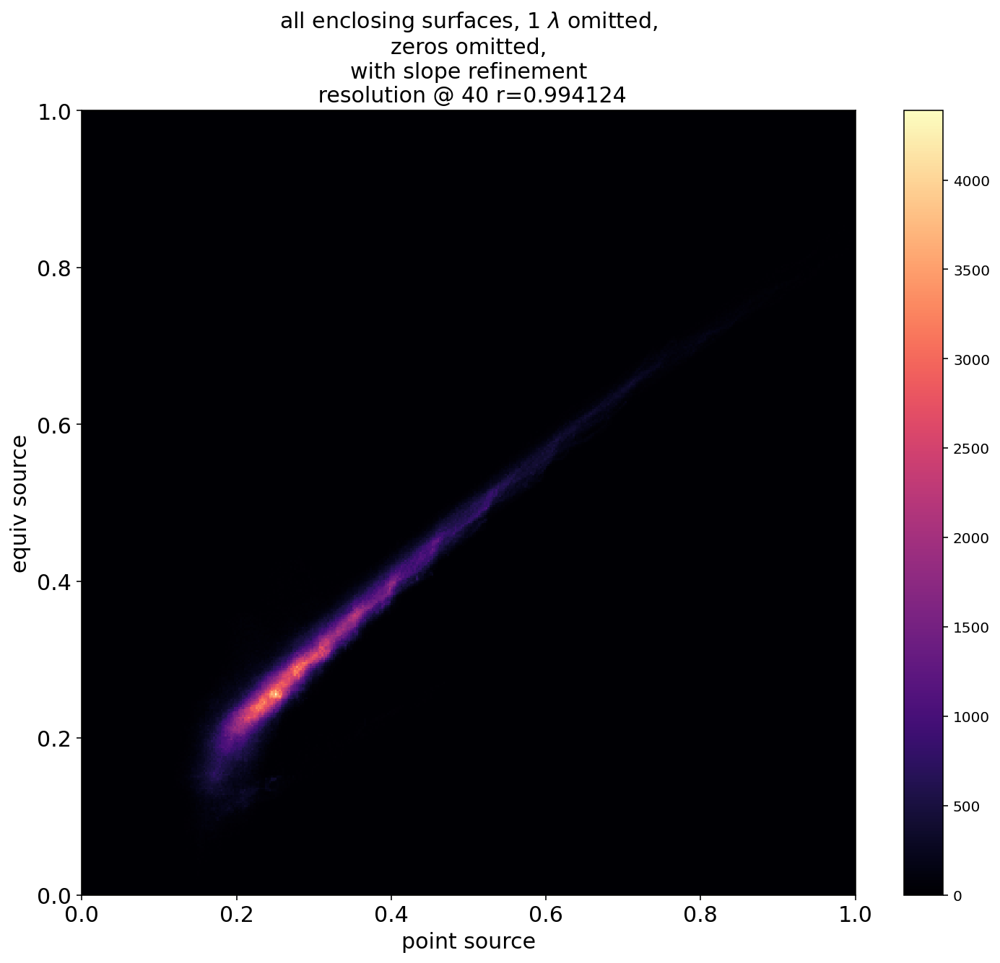

(320, 320, 140)


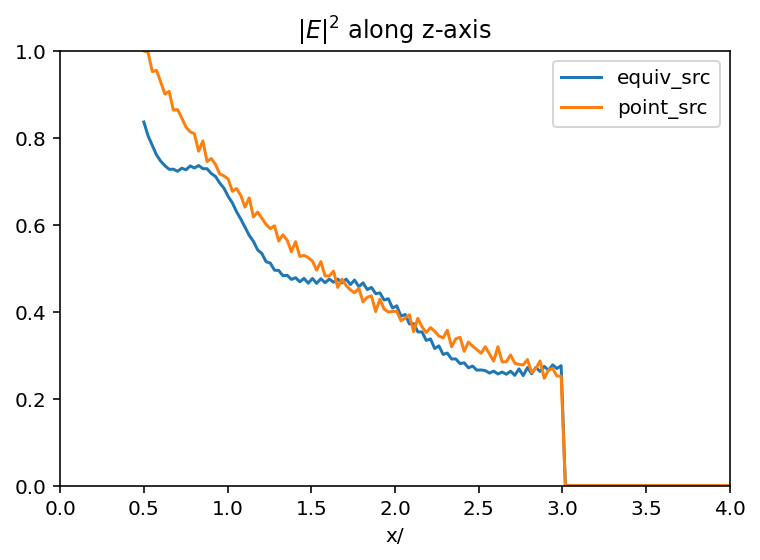

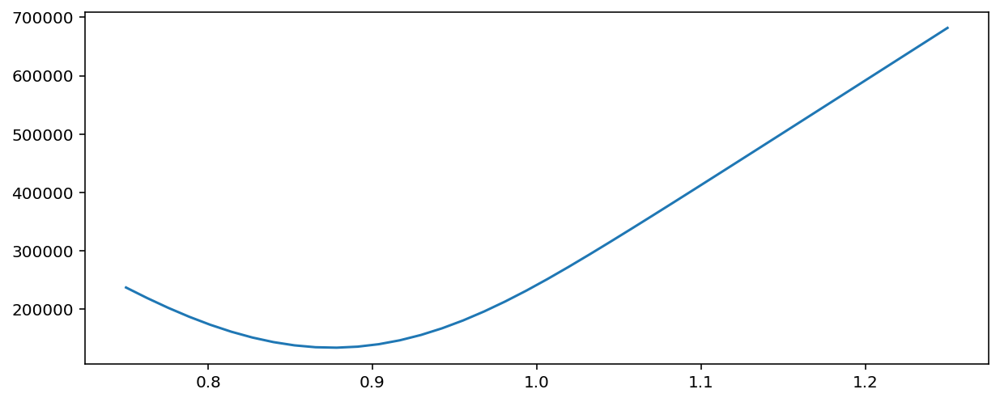

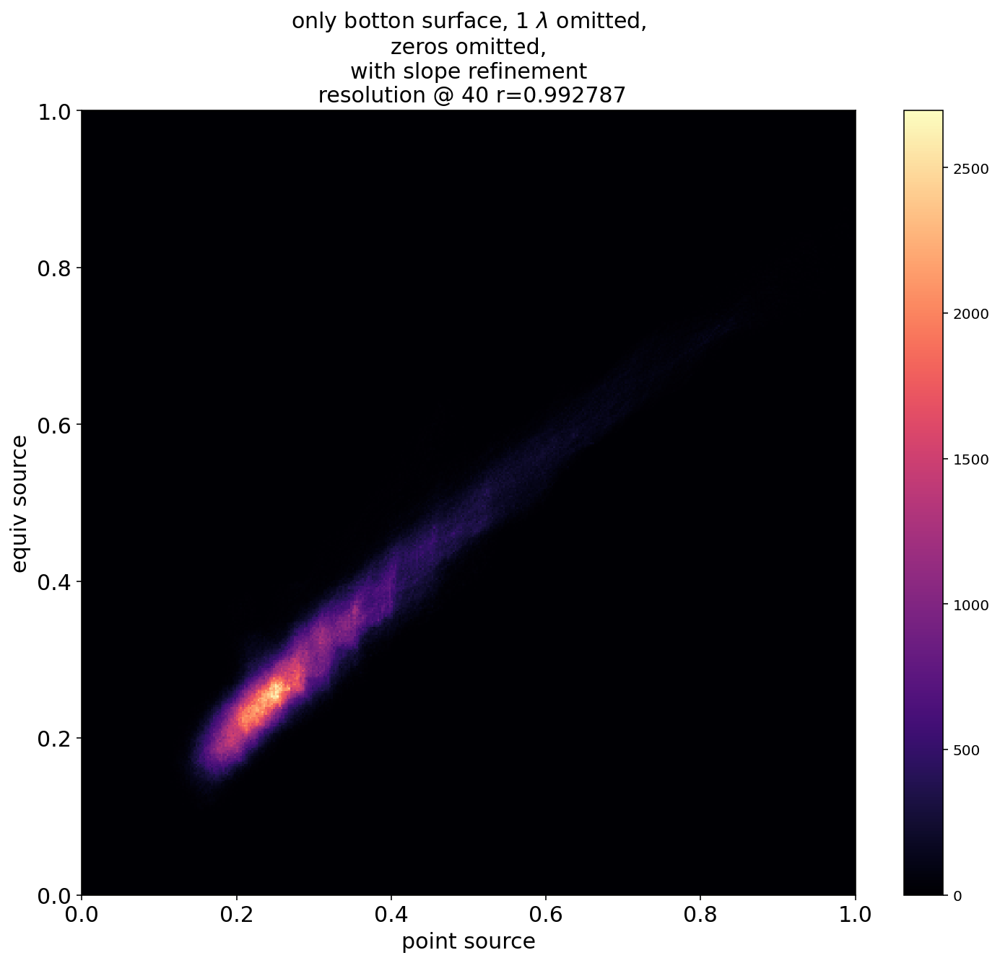

In [660]:
pad_index_h = int((metalens['sim_cell_width'] 
                   - metalens['w'])/2*metalens['resolution'])
pad_index_v = int((metalens['sim_cell_width']/2 
                   - metalens['h'])*metalens['resolution'])
slice_index = (int(metalens['resolution']*metalens['sim_cell_width']/2)
               + int(metalens['wavelength']*metalens['resolution']))
mid_index=int(metalens['resolution']*metalens['sim_cell_width']/2)
rs = np.linspace(0.75,1.25,40)
for filename, title_txt in zip(['equiv-full.pkl','equiv-bottom.pkl'],
                               ["all enclosing surfaces, 1 $\lambda$ omitted,\nzeros omitted,\nwith slope refinement\n resolution @ %d" % metalens['resolution'],
                                "only botton surface, 1 $\lambda$ omitted,\nzeros omitted,\nwith slope refinement\n resolution @ %d" % metalens['resolution']]):
    E2_point_src = pickle.load(open(filename,'rb'))['point'][:,:,slice_index:]
    E2_equiv_src = pickle.load(open(filename,'rb'))['equiv'][:,:,slice_index:]
    print(E2_point_src.shape)
    # zap to zero the points that are outside the equiv box
    E2_point_src[:pad_index_h,:,:] = 0.
    E2_point_src[-pad_index_h:,:,:] = 0.
    E2_point_src[:,:pad_index_h,:] = 0.
    E2_point_src[:,-pad_index_h:,:] = 0.
    E2_point_src[:,:,-pad_index_v:] = 0.
    E2_equiv_src[:pad_index_h,:,:] = 0.
    E2_equiv_src[-pad_index_h:,:,:] = 0.
    E2_equiv_src[:,:pad_index_h,:] = 0.
    E2_equiv_src[:,-pad_index_h:,:] = 0.
    E2_equiv_src[:,:,-pad_index_v:] = 0.
    shapes = E2_equiv_src.shape
    # bring to common normalization
    E2_point_src = E2_point_src/np.max(E2_point_src)
    E2_equiv_src = E2_equiv_src/np.max(E2_equiv_src)
    diffs= np.array([np.sum(np.abs(E2_point_src-r*E2_equiv_src)) for r in rs])
    r_opt = rs[np.argmin(diffs)]
    E2_equiv_src = r_opt*E2_equiv_src

    y_equiv = E2_equiv_src[mid_index,mid_index,:]
    y_point = E2_point_src[mid_index,mid_index,:]
    z_axis = np.linspace(metalens['wavelength'],
                        metalens['sim_cell_width']/2,len(y_equiv))
    plt.figure()
    plt.plot(z_axis,y_equiv,label='equiv_src')
    plt.plot(z_axis,y_point,label='point_src')
    plt.legend()
    plt.xlim(0,4)
    plt.ylim(0,1)
    plt.xlabel('x/')
    plt.title('$|E|^2$ along z-axis')
    plt.show()
    # flatten the 3d arrays to 1d arrays
    E2_point_src = E2_point_src.reshape(shapes[0]*shapes[1]*(shapes[2]-slice_index))
    E2_equiv_src = E2_equiv_src.reshape(shapes[0]*shapes[1]*(shapes[2]-slice_index))
    corr = np.corrcoef(E2_equiv_src,E2_point_src)[0,1]

    skip = 1
    v1 = E2_point_src[::skip]
    v2 = E2_equiv_src[::skip]
    good_indices = v1 > 0
    v1 = v1[good_indices]
    v2 = v2[good_indices]
    
    plt.figure(figsize=(10,4))
    plt.plot(rs, diffs)
    plt.show()

    fig, ax = plt.subplots(figsize=(12,10))
    im = ax.hist2d(v1,v2,
               bins=400,
               cmap='magma',
               range=([0,1],[0,1]))
    for label in (ax.get_xticklabels() + ax.get_yticklabels()):
        label.set_fontsize(15)
    ax.set_xlabel('point source',size=15)
    ax.set_ylabel('equiv source',size=15)
    fig.colorbar(im[3], ax=ax)
    ax.set_title(title_txt + (' r=%f' % corr),size=15)
    plt.show()


0.9734353469312297


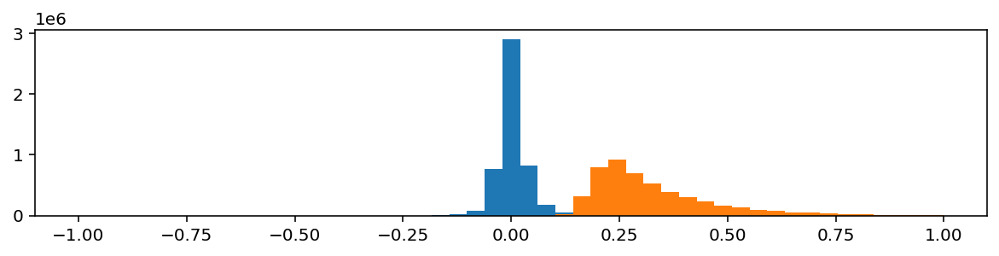

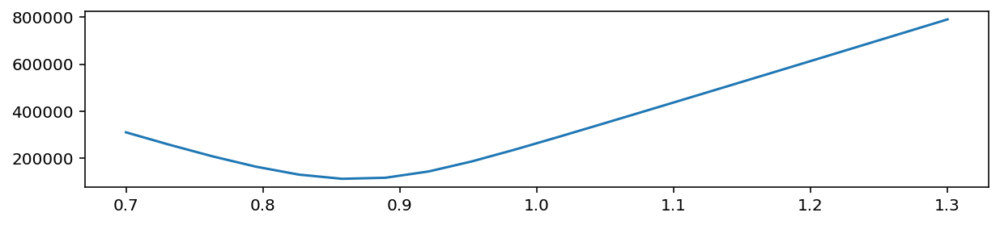

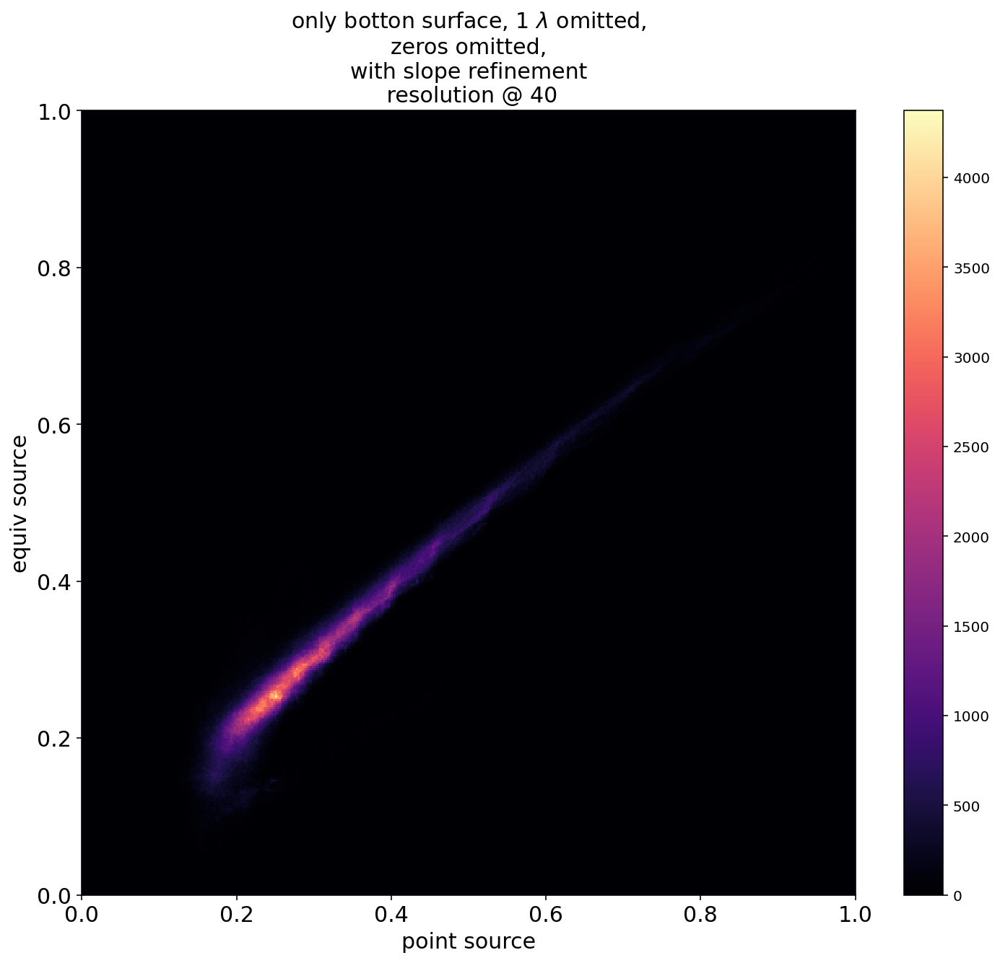

In [596]:
pad_index_h = int((metalens['sim_cell_width'] 
                   - metalens['w'])/2*metalens['resolution'])
pad_index_v = int((metalens['sim_cell_width']/2 
                   - metalens['h'])*metalens['resolution'])
slice_index = (int(metalens['resolution']*metalens['sim_cell_width']/2)
               + int(metalens['wavelength']*metalens['resolution']))
E2_point_src = pickle.load(open('equiv-2.pkl','rb'))['point'][:,:,slice_index:]
E2_equiv_src = pickle.load(open('equiv-2.pkl','rb'))['equiv'][:,:,slice_index:]
E2_point_src[:pad_index_h,:,:] = 0.
E2_point_src[-pad_index_h:,:,:] = 0.
E2_point_src[:,:pad_index_h,:] = 0.
E2_point_src[:,-pad_index_h:,:] = 0.
E2_point_src[:,:,-pad_index_v:] = 0.
shapes = E2_equiv_src.shape

E2_point_src = E2_point_src.reshape(shapes[0]*shapes[1]*(shapes[2]-slice_index))
E2_equiv_src = E2_equiv_src.reshape(shapes[0]*shapes[1]*(shapes[2]-slice_index))
E2_point_src = E2_point_src/np.sqrt(np.sum(E2_point_src**2))
E2_equiv_src = E2_equiv_src/np.sqrt(np.sum(E2_equiv_src**2))
good_indices = E2_point_src > 0
E2_equiv_src = E2_equiv_src[good_indices]
E2_point_src = E2_point_src[good_indices]
corr = np.corrcoef(E2_equiv_src,E2_point_src)[0,1]
print(corr)

skip = 1
v1 = E2_point_src[::skip]
v2 = E2_equiv_src[::skip]
v1 = v1/np.sqrt(np.sum(v1**2))
v2 = v2/np.sqrt(np.sum(v2**2))
v1 = v1/max(v1)
v2 = v2/max(v2)
good_indices = v1 > 0
v1 = v1[good_indices]
v2 = v2[good_indices]
rs = np.linspace(0.7,1.3,20)
diffs= np.array([np.sum(np.abs(v1-r*v2)) for r in rs])
r_opt = rs[np.argmin(diffs)]
v2 = v2*r_opt
plt.figure(figsize=(10,2))
plt.hist((v1-v2),bins=np.linspace(-1,1,50))
plt.hist((v1),bins=np.linspace(-1,1,50))
plt.show()
plt.figure(figsize=(10,2))
plt.plot(rs, diffs)
plt.show()

fig, ax = plt.subplots(figsize=(12,10))
im = ax.hist2d(v1,v2,
           bins=400,
           cmap='magma',
           range=([0,1],[0,1]))
for label in (ax.get_xticklabels() + ax.get_yticklabels()):
    label.set_fontsize(15)
ax.set_xlabel('point source',size=15)
ax.set_ylabel('equiv source',size=15)
fig.colorbar(im[3], ax=ax)
ax.set_title("only botton surface, 1 $\lambda$ omitted,\nzeros omitted,\nwith slope refinement\n resolution @ %d" % metalens['resolution'],size=15)
plt.show()

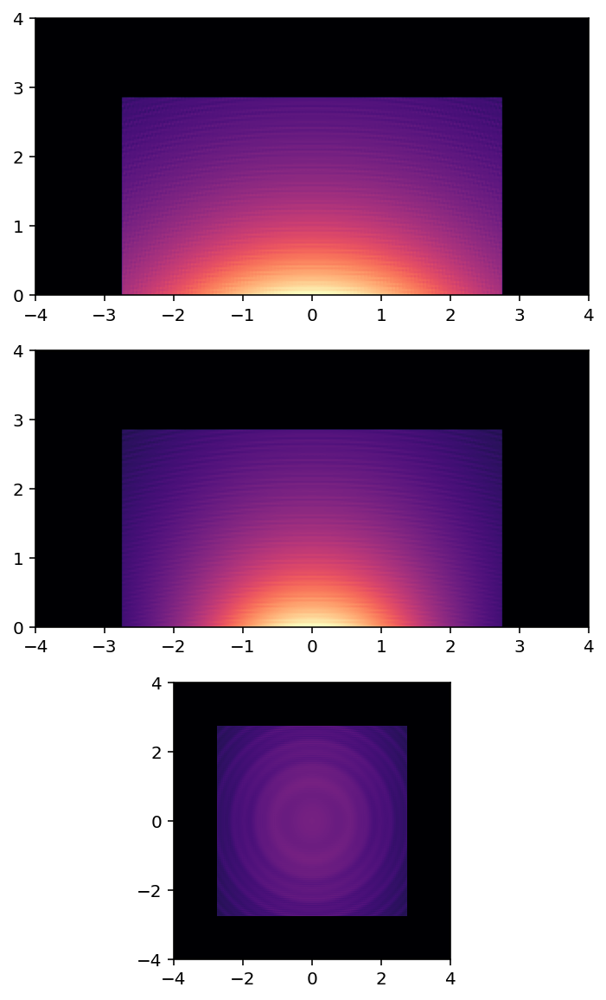

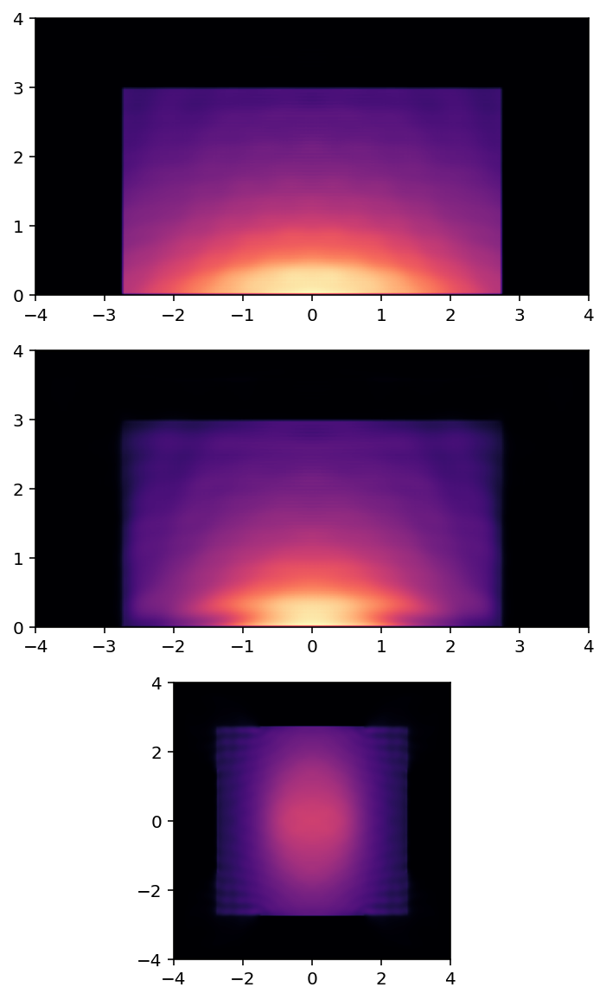

In [456]:
E2 = pickle.load(open('equiv-2.pkl','rb'))['point'][:,:,slice_index:]
E2[:pad_index_h,:,:] = 0.
E2[-pad_index_h:,:,:] = 0.
E2[:,:pad_index_h,:] = 0.
E2[:,-pad_index_h:,:] = 0.
E2[:,:,-pad_index_v:] = 0.

chosen_index_0 = int(E2.shape[0]/2)
chosen_index_1 = int(E2.shape[2]/2)
vmin = np.percentile(E2.flatten(),0)
vmax = np.percentile(E2.flatten(),100)
fig,ax = plt.subplots(ncols=1,nrows=3,figsize=(10,10))
radii = 0.25+np.arange(60)*metalens['wavelength']/2
angles = np.linspace(0,2*np.pi,100)
xr = np.cos(angles)
yr = np.sin(angles)
ax[0].imshow(E2[chosen_index_0,:,:].T,
          extent=[-metalens['sim_cell_width']/2,
                 metalens['sim_cell_width']/2,
                 0,
                 metalens['sim_cell_width']/2],
          norm=Normalize(vmin=vmin,vmax=vmax),
          origin='lower',
          cmap='magma')
# for r in radii:
#     ax[0][0].plot(r*xr,r*yr-metalens['H'],'w--',alpha=0.2)
ax[0].set_ylim(0,
                 metalens['sim_cell_width']/2)
ax[0].set_xlim(-metalens['sim_cell_width']/2,
                 metalens['sim_cell_width']/2)
ax[1].imshow(E2[:,chosen_index_0,:].T,
          extent=[-metalens['sim_cell_width']/2,
                 metalens['sim_cell_width']/2,
                 0,
                 metalens['sim_cell_width']/2],
          norm=Normalize(vmin=vmin,vmax=vmax),
          origin='lower',
          cmap='magma')
# for r in radii:
#     ax[0][1].plot(r*xr,r*yr-metalens['H'],'w--',alpha=0.2)
ax[1].set_ylim(0,
                 metalens['sim_cell_width']/2)
ax[1].set_xlim(-metalens['sim_cell_width']/2,
                 metalens['sim_cell_width']/2)
ax[2].imshow(E2[:,:,chosen_index_1].T,
          extent=[-metalens['sim_cell_width']/2,
                 metalens['sim_cell_width']/2,
                 -metalens['sim_cell_width']/2,
                 metalens['sim_cell_width']/2],
          norm=Normalize(vmin=vmin,vmax=vmax),
          origin='lower',
          cmap='magma')
plt.show()

E2 = pickle.load(open('equiv-2.pkl','rb'))['equiv']
chosen_index_0 = int(E2.shape[0]/2)
chosen_index_1 = int(E2.shape[2]/2)
vmin = np.percentile(E2.flatten(),0)
vmax = np.percentile(E2.flatten(),100)
fig,ax = plt.subplots(ncols=1, nrows=3, figsize=(10,10))
radii = 0.25+np.arange(60)*metalens['wavelength']/2
angles = np.linspace(0,2*np.pi,100)
xr = np.cos(angles)
yr = np.sin(angles)
ax[0].imshow(E2[chosen_index_0,:,:].T,
          extent=[-metalens['sim_cell_width']/2,
                 metalens['sim_cell_width']/2,
                 -metalens['sim_cell_width']/2,
                 metalens['sim_cell_width']/2],
          norm=Normalize(vmin=vmin,vmax=vmax),
          origin='lower',
          cmap='magma')
ax[0].set_ylim(0,#-metalens['sim_cell_width']/2,
                 metalens['sim_cell_width']/2)
ax[0].set_xlim(-metalens['sim_cell_width']/2,
                 metalens['sim_cell_width']/2)
ax[1].imshow(E2[:,chosen_index_0,:].T,
          extent=[-metalens['sim_cell_width']/2,
                 metalens['sim_cell_width']/2,
                 -metalens['sim_cell_width']/2,
                 metalens['sim_cell_width']/2],
          norm=Normalize(vmin=vmin,vmax=vmax),
          origin='lower',
          cmap='magma')
# for r in radii:
#     ax[0][1].plot(r*xr,r*yr-metalens['H'],'w--',alpha=0.2)
ax[1].set_ylim(0,#-metalens['sim_cell_width']/2,
                 metalens['sim_cell_width']/2)
ax[1].set_xlim(-metalens['sim_cell_width']/2,
                 metalens['sim_cell_width']/2)
ax[2].imshow(E2[:,:,chosen_index_1].T,
          extent=[-metalens['sim_cell_width']/2,
                 metalens['sim_cell_width']/2,
                 -metalens['sim_cell_width']/2,
                 metalens['sim_cell_width']/2],
          norm=Normalize(vmin=vmin,vmax=vmax),
          origin='lower',
          cmap='magma')
#ax[1][1].axis('off')
plt.show()

## Testing Equivalent Currents (second try)

In vaccum, simulate a point dipole source, located along the axis, with a dipole making an angle phi with respect to the z-axis, and an angle theta wrt the x-axis. The source is 2.5 um below the z=0 plane, and must be recovered by equivalent currents at the plane z=0.

In [219]:
resolution = 35
metalens = {'epsilon': 1,
          'sim_cell_width': 8,
          'PML_width': 0.5,
          'wavelength': 0.5,
          'resolution': resolution,
          'symmetries': [],
          'sim_time': 10.,
          'complex_fields': True,
          'num_cores': 1,
          'quiet':False,
          'source_width':0,
          'dip_dir':{'phi':np.pi/2., 'theta':0.},
          'H': 2.5,
          's': 0}
metalens['source_coord'] = -metalens['H']
metalens['k'] = 2*np.pi/metalens['wavelength']
metalens['n'] = 1
metalens['source_funcs'] = dip_equiv_currents(metalens)
metalens['ws'] = metalens['sim_cell_width']/2-metalens['PML_width']
cell = mp.Vector3(metalens['sim_cell_width'],
                      metalens['sim_cell_width'],
                      metalens['sim_cell_width'])
pml_layers = [ mp.PML(metalens['PML_width']) ]
sources = [mp.Source(src=mp.ContinuousSource(wavelength=metalens['wavelength'],
                                             width=metalens['source_width']),
                     component=mp.Ex,
      center=mp.Vector3(0, 0, metalens['source_coord']),
      size=mp.Vector3(0,0, 0)) ]
sim = mp.Simulation(cell_size=cell,
                boundary_layers=pml_layers,
                force_complex_fields=metalens['complex_fields'],
                sources=sources,
                resolution=metalens['resolution'])
sim.init_sim()
sim.run(until=metalens['sim_time'])
metalens['fields'] = {'Ex': sim.get_array(component=mp.Ex),
                    'Ey': sim.get_array(component=mp.Ey),
                    'Ez': sim.get_array(component=mp.Ez),
                    'Hx': sim.get_array(component=mp.Hx),
                    'Hy': sim.get_array(component=mp.Hy),
                    'Hz': sim.get_array(component=mp.Hz)
                          }
E2_point_src = (np.abs(metalens['fields']['Ex'])**2 + 
          np.abs(metalens['fields']['Ey'])**2 + 
          np.abs(metalens['fields']['Ez'])**2)

del(sim)

metalens = {'epsilon': 1,
          'sim_cell_width': 8,
          'PML_width': 0.5,
          'wavelength': 0.5,
          'resolution': resolution,
          'symmetries': [],
          'sim_time': 10.,
          'complex_fields': True,
          'num_cores': 1,
          'quiet':False,
          'source_width':0,
          'dip_dir':{'phi':np.pi/2., 'theta':0.},
          'H': 2.5,
          's': 0}
metalens['source_coord'] = -metalens['H']
metalens['k'] = 2*np.pi/metalens['wavelength']
metalens['n'] = 1
metalens['source_funcs'] = dip_equiv_currents(metalens)
metalens['ws'] = metalens['sim_cell_width']/2-metalens['PML_width']
cell = mp.Vector3(metalens['sim_cell_width'],
                      metalens['sim_cell_width'],
                      metalens['sim_cell_width'])
pml_layers = [ mp.PML(metalens['PML_width']) ]
sources = [mp.Source(src=mp.ContinuousSource(wavelength=metalens['wavelength'],width=metalens['source_width']),component=m_component,
      amp_func=metalens['source_funcs'][m_component_name],
      center=mp.Vector3(0, 0, 0),
      size=mp.Vector3(2 * metalens['ws'], 2 * metalens['ws'], 0)) for m_component, m_component_name in zip([mp.Ex,mp.Ey,mp.Ez,mp.Hx,mp.Hy,mp.Hz],['JEx','JEy','JEz','JHx','JHy','JHz'])]

sim = mp.Simulation(cell_size=cell,
                boundary_layers=pml_layers,
                force_complex_fields=metalens['complex_fields'],
                sources=sources,
                resolution=metalens['resolution'])
sim.init_sim()
sim.run(until=metalens['sim_time'])
metalens['fields'] = {'Ex': sim.get_array(component=mp.Ex),
                    'Ey': sim.get_array(component=mp.Ey),
                    'Ez': sim.get_array(component=mp.Ez),
                    'Hx': sim.get_array(component=mp.Hx),
                    'Hy': sim.get_array(component=mp.Hy),
                    'Hz': sim.get_array(component=mp.Hz)
                          }
E2_equiv_src = (np.abs(metalens['fields']['Ex'])**2 + 
          np.abs(metalens['fields']['Ey'])**2 + 
          np.abs(metalens['fields']['Ez'])**2)

pickle.dump({'point': E2_point_src,'equiv':E2_equiv_src},open('equiv-2.pkl','wb'))

-----------
Initializing structure...
Meep: using complex fields.
Meep progress: 0.014285714285714285/10.0 = 0.1% done in 24.4s, 17041.9s to go
Meep progress: 0.09999999999999999/10.0 = 1.0% done in 29.1s, 2881.1s to go
Meep progress: 0.18571428571428572/10.0 = 1.9% done in 33.7s, 1781.8s to go
Meep progress: 0.2714285714285714/10.0 = 2.7% done in 38.3s, 1373.8s to go
Meep progress: 0.35714285714285715/10.0 = 3.6% done in 43.1s, 1163.4s to go
Meep progress: 0.44285714285714284/10.0 = 4.4% done in 47.8s, 1031.0s to go
Meep progress: 0.5285714285714286/10.0 = 5.3% done in 52.4s, 939.5s to go
Meep progress: 0.6142857142857142/10.0 = 6.1% done in 57.1s, 872.0s to go
Meep progress: 0.7/10.0 = 7.0% done in 61.7s, 820.3s to go
Meep progress: 0.7857142857142857/10.0 = 7.9% done in 66.5s, 779.5s to go
Meep progress: 0.8714285714285714/10.0 = 8.7% done in 71.2s, 746.2s to go
Meep progress: 0.9571428571428571/10.0 = 9.6% done in 75.9s, 717.4s to go
Meep progress: 1.042857142857143/10.0 = 10.4% do

Meep progress: 9.528571428571428/10.0 = 95.3% done in 541.0s, 26.8s to go
Meep progress: 9.614285714285714/10.0 = 96.1% done in 545.6s, 21.9s to go
Meep progress: 9.7/10.0 = 97.0% done in 550.2s, 17.0s to go
Meep progress: 9.785714285714285/10.0 = 97.9% done in 554.9s, 12.2s to go
Meep progress: 9.871428571428572/10.0 = 98.7% done in 559.6s, 7.3s to go
Meep progress: 9.957142857142857/10.0 = 99.6% done in 564.2s, 2.4s to go
run 0 finished at t = 10.0 (700 timesteps)
-----------
Initializing structure...
Meep: using complex fields.
Meep progress: 0.014285714285714285/10.0 = 0.1% done in 23.3s, 16308.6s to go
Meep progress: 0.09999999999999999/10.0 = 1.0% done in 28.1s, 2784.7s to go
Meep progress: 0.18571428571428572/10.0 = 1.9% done in 32.9s, 1736.1s to go
Meep progress: 0.2714285714285714/10.0 = 2.7% done in 37.6s, 1346.3s to go
Meep progress: 0.35714285714285715/10.0 = 3.6% done in 42.3s, 1142.6s to go
Meep progress: 0.44285714285714284/10.0 = 4.4% done in 47.1s, 1015.7s to go
Meep p

Meep progress: 8.785714285714285/10.0 = 87.9% done in 511.0s, 70.6s to go
Meep progress: 8.857142857142858/10.0 = 88.6% done in 515.1s, 66.5s to go
Meep progress: 8.942857142857143/10.0 = 89.4% done in 519.9s, 61.5s to go
Meep progress: 9.028571428571428/10.0 = 90.3% done in 524.5s, 56.4s to go
Meep progress: 9.114285714285714/10.0 = 91.1% done in 529.3s, 51.4s to go
Meep progress: 9.2/10.0 = 92.0% done in 534.1s, 46.4s to go
Meep progress: 9.27142857142857/10.0 = 92.7% done in 538.1s, 42.3s to go
Meep progress: 9.357142857142858/10.0 = 93.6% done in 542.9s, 37.3s to go
Meep progress: 9.442857142857143/10.0 = 94.4% done in 547.6s, 32.3s to go
Meep progress: 9.528571428571428/10.0 = 95.3% done in 552.4s, 27.3s to go
Meep progress: 9.6/10.0 = 96.0% done in 556.5s, 23.2s to go
Meep progress: 9.685714285714285/10.0 = 96.9% done in 561.3s, 18.2s to go
Meep progress: 9.77142857142857/10.0 = 97.7% done in 566.0s, 13.2s to go
Meep progress: 9.842857142857143/10.0 = 98.4% done in 570.1s, 9.1s t

In [220]:
shapes = E2_equiv_src.shape

In [221]:
# pickle.dump({'point': E2_point_src,'equiv':E2_equiv},open('equiv.pkl','wb'))
slice_index = int(shapes[0]/2) + int(metalens['wavelength']*metalens['resolution'])
E2_point_src = pickle.load(open('equiv-2.pkl','rb'))['point'][:,:,slice_index:]
E2_equiv_src = pickle.load(open('equiv-2.pkl','rb'))['equiv'][:,:,slice_index:]
E2_point_src = E2_point_src.reshape(shapes[0]*shapes[1]*(shapes[2]-slice_index))
E2_equiv_src = E2_equiv_src.reshape(shapes[0]*shapes[1]*(shapes[2]-slice_index))
E2_point_src = E2_point_src/np.sqrt(np.sum(E2_point_src**2))
E2_equiv_src = E2_equiv_src/np.sqrt(np.sum(E2_equiv_src**2))
np.correlate(E2_equiv_src,E2_point_src)[0]

0.9975962665514069

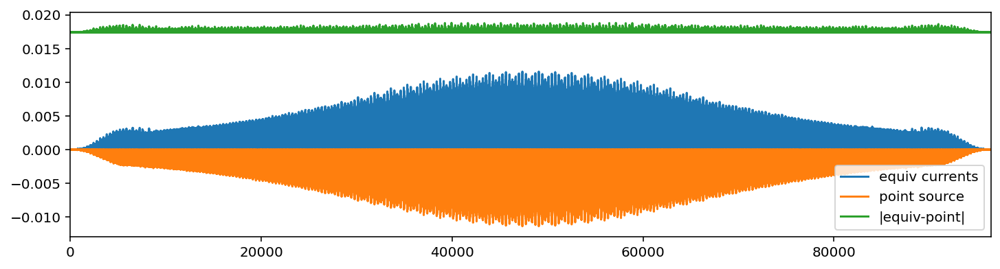

In [222]:
skip = 100
v1=E2_equiv_src[::skip]
v2=E2_point_src[::skip]
v1=v1/np.sqrt(np.sum(v1**2))
v2=v2/np.sqrt(np.sum(v2**2))
plt.figure(figsize=(12,3))
plt.plot(v1,label='equiv currents')
plt.plot(-v2,label='point source')
plt.plot(np.abs(v1-v2)+1.5*max(v1),label='|equiv-point|')
plt.xlim(0,len(v1))
plt.legend()
plt.show()

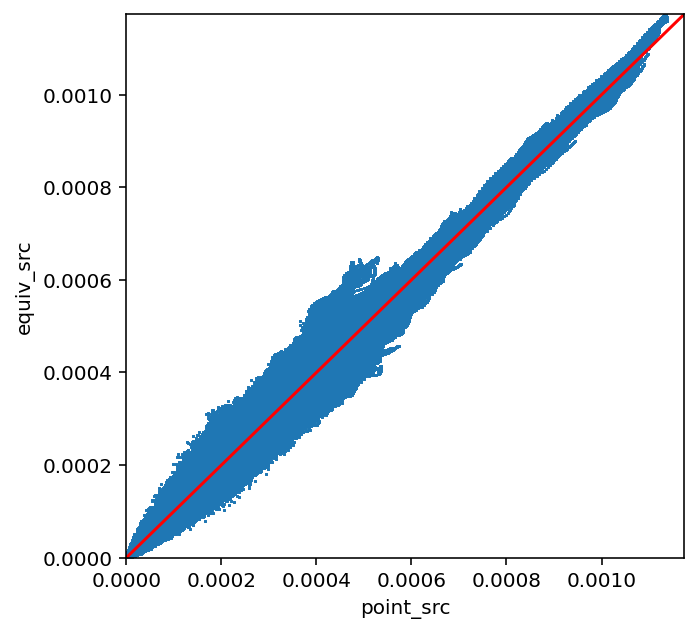

In [223]:
skip = 1
v1=E2_point_src[::skip]
v2=E2_equiv_src[::skip]
v1=v1/np.sqrt(np.sum(v1**2))
v2=v2/np.sqrt(np.sum(v2**2))
plt.figure(figsize=(5,5))
plt.plot(v1,v2,'o',ms=0.5)
maxmax=max(max(v1),max(v2))
plt.plot([0,maxmax],[0,maxmax],'r-')
plt.xlim(0,max(max(v1),max(v2)))
plt.ylim(0,maxmax)
plt.ylabel('equiv_src')
plt.xlabel('point_src')
plt.show()

In [224]:
!say "beep, beep"

## Testing Equivalent Currents (first try)

In vaccum, simulate a point dipole source, located along the axis, with a dipole making an angle phi with respect to the z-axis, and an angle theta wrt the x-axis. The source is 2.5 um below the z=0 plane, and must be recovered by equivalent currents at the plane z=0.

In [16]:
metalens = {'epsilon': 1,
          'sim_cell_width': 8,
          'PML_width': 0.5,
          'wavelength': 0.5,
          'resolution': 20,
          'symmetries': [],
          'sim_time': 10.,
          'complex_fields': True,
          'num_cores': 1,
          'quiet':False,
          'source_width':0,
          'dip_dir':{'phi':np.pi/2., 'theta':0.},
          'H': 2.5,
          's': 0}
metalens['source_coord'] = -metalens['H']
metalens['k'] = 2*np.pi/metalens['wavelength']
metalens['n'] = 1
metalens['source_funcs'] = dip_equiv_currents(metalens)
metalens['ws'] = metalens['sim_cell_width']/2-metalens['PML_width']
cell = mp.Vector3(metalens['sim_cell_width'],
                      metalens['sim_cell_width'],
                      metalens['sim_cell_width'])
pml_layers = [ mp.PML(metalens['PML_width']) ]
sources = [mp.Source(src=mp.ContinuousSource(wavelength=metalens['wavelength'],width=metalens['source_width']),component=m_component,
      amp_func=metalens['source_funcs'][m_component_name],
      center=mp.Vector3(0, 0, 0),
      size=mp.Vector3(2 * metalens['ws'], 2 * metalens['ws'], 0)) for m_component, m_component_name in zip([mp.Ex,mp.Ey,mp.Ez,mp.Hx,mp.Hy,mp.Hz],['JEx','JEy','JEz','JHx','JHy','JHz'])]
sources = [mp.Source(src=mp.ContinuousSource(wavelength=metalens['wavelength'],
                                             width=metalens['source_width']),
                     component=mp.Ex,
      center=mp.Vector3(0, 0, metalens['source_coord']),
      size=mp.Vector3(0,0, 0)) ]
sim = mp.Simulation(cell_size=cell,
                boundary_layers=pml_layers,
                force_complex_fields=metalens['complex_fields'],
                sources=sources,
                resolution=metalens['resolution'])

In [17]:
sim.init_sim()

-----------
Initializing structure...
Meep: using complex fields.


In [18]:
sim.run(until=metalens['sim_time'])

Meep progress: 0.025/10.0 = 0.2% done in 7.2s, 2881.3s to go
Meep progress: 0.675/10.0 = 6.8% done in 11.3s, 155.7s to go
Meep progress: 1.35/10.0 = 13.5% done in 15.4s, 98.8s to go
Meep progress: 2.025/10.0 = 20.2% done in 19.5s, 76.9s to go
Meep progress: 2.7/10.0 = 27.0% done in 23.6s, 63.8s to go
Meep progress: 3.375/10.0 = 33.8% done in 27.7s, 54.3s to go
Meep progress: 4.05/10.0 = 40.5% done in 31.8s, 46.7s to go
Meep progress: 4.7250000000000005/10.0 = 47.2% done in 35.9s, 40.1s to go
Meep progress: 5.4/10.0 = 54.0% done in 40.0s, 34.1s to go
Meep progress: 6.075/10.0 = 60.8% done in 44.1s, 28.5s to go
Meep progress: 6.75/10.0 = 67.5% done in 48.1s, 23.2s to go
Meep progress: 7.425000000000001/10.0 = 74.2% done in 52.1s, 18.1s to go
Meep progress: 8.1/10.0 = 81.0% done in 56.2s, 13.2s to go
Meep progress: 8.775/10.0 = 87.8% done in 60.2s, 8.4s to go
Meep progress: 9.450000000000001/10.0 = 94.5% done in 64.3s, 3.7s to go
run 0 finished at t = 10.0 (400 timesteps)


In [19]:
metalens['fields'] = {'Ex': sim.get_array(component=mp.Ex),
                    'Ey': sim.get_array(component=mp.Ey),
                    'Ez': sim.get_array(component=mp.Ez),
                    'Hx': sim.get_array(component=mp.Hx),
                    'Hy': sim.get_array(component=mp.Hy),
                    'Hz': sim.get_array(component=mp.Hz)
                          }

In [20]:
E2 = (np.abs(metalens['fields']['Ex'])**2 + 
          np.abs(metalens['fields']['Ey'])**2 + 
          np.abs(metalens['fields']['Ez'])**2)

In [22]:
# E2_point_src = E2.copy()
# E2_point_src[:,:,:int(E2_point_src.shape[0]/2)] = 0

In [130]:
E2_point_src.shape

(4096000,)

In [166]:
# pickle.dump({'point': E2_point_src,'equiv':E2_equiv},open('equiv.pkl','wb'))
E2_point_src = pickle.load(open('equiv.pkl','rb'))['point'][:,:,90:]
E2_equiv_src = pickle.load(open('equiv.pkl','rb'))['equiv'][:,:,90:]
E2_point_src = E2_point_src.reshape((160*160*70))
E2_equiv_src = E2_equiv_src.reshape((160*160*70))
E2_point_src = E2_point_src/np.sqrt(np.sum(E2_point_src**2))
E2_equiv_src = E2_equiv_src/np.sqrt(np.sum(E2_equiv_src**2))

In [167]:
s=np.sum(E2_equiv_src*E2_point_src)
s=s/np.sqrt(np.sum(E2_equiv_src**2))
s=s/np.sqrt(np.sum(E2_point_src**2))
s

0.9970728348484575

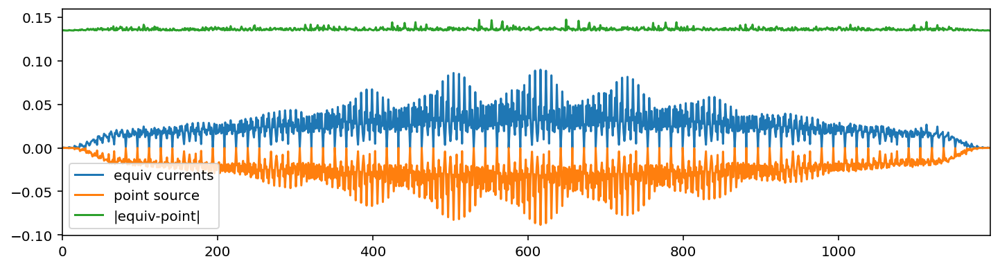

In [168]:
skip = 1500
v1=E2_equiv_src[::skip]
v2=E2_point_src[::skip]
v1=v1/np.sqrt(np.sum(v1**2))
v2=v2/np.sqrt(np.sum(v2**2))
plt.figure(figsize=(12,3))
plt.plot(v1,label='equiv currents')
plt.plot(-v2,label='point source')
plt.plot(np.abs(v1-v2)+1.5*max(v1),label='|equiv-point|')
plt.xlim(0,len(v1))
plt.legend()
plt.show()

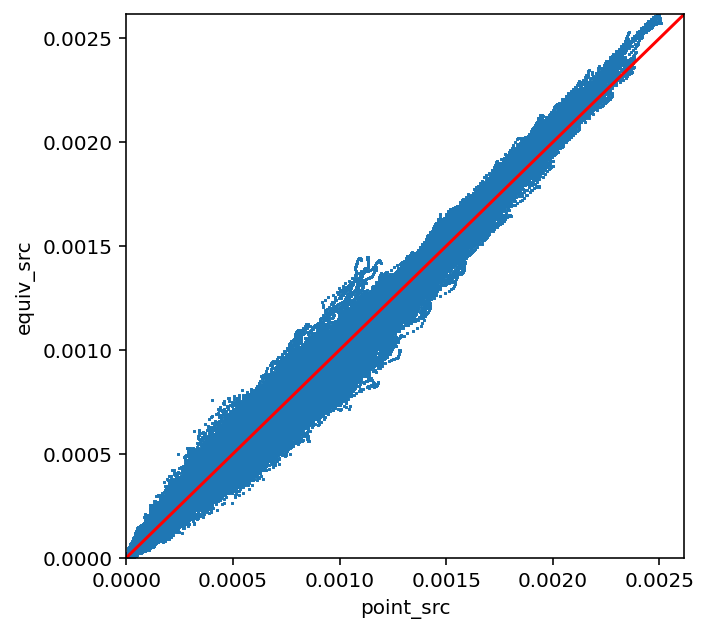

In [169]:
skip = 1
v1=E2_point_src[::skip]
v2=E2_equiv_src[::skip]
v1=v1/np.sqrt(np.sum(v1**2))
v2=v2/np.sqrt(np.sum(v2**2))
plt.figure(figsize=(5,5))
plt.plot(v1,v2,'o',ms=0.5)
maxmax=max(max(v1),max(v2))
plt.plot([0,maxmax],[0,maxmax],'r-')
plt.xlim(0,max(max(v1),max(v2)))
plt.ylim(0,maxmax)
plt.ylabel('equiv_src')
plt.xlabel('point_src')
plt.show()

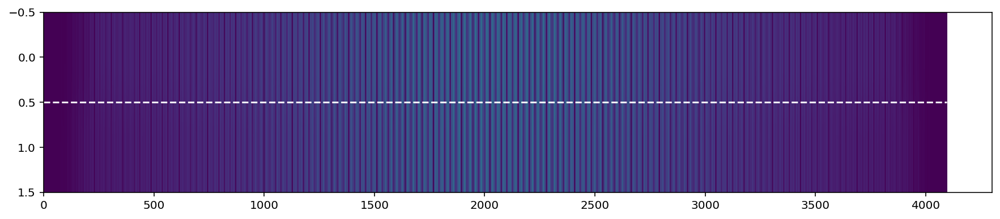

In [109]:
skip = 1000
v1=E2_equiv_src.reshape((160*160*160))[::skip]
v2=E2_point_src.reshape((160*160*160))[::skip]
v1=v1/np.sqrt(np.sum(v1**2))
v2=v2/np.sqrt(np.sum(v2**2))
plt.figure(figsize=(15,3))
plt.imshow([v1,v2],label='equiv currents',aspect=len(v1)/10)
plt.plot([0,len(v1)],[0.5,0.5],'w--')
#plt.imshow([v1],label='equiv currents',aspect=1000)
# plt.plot(v2,label='point source')
# plt.plot(np.abs(v1-v2)+1.5*max(v1),label='|equiv-point|')
# plt.xlim(0,len(v1))
# plt.legend()
plt.show()

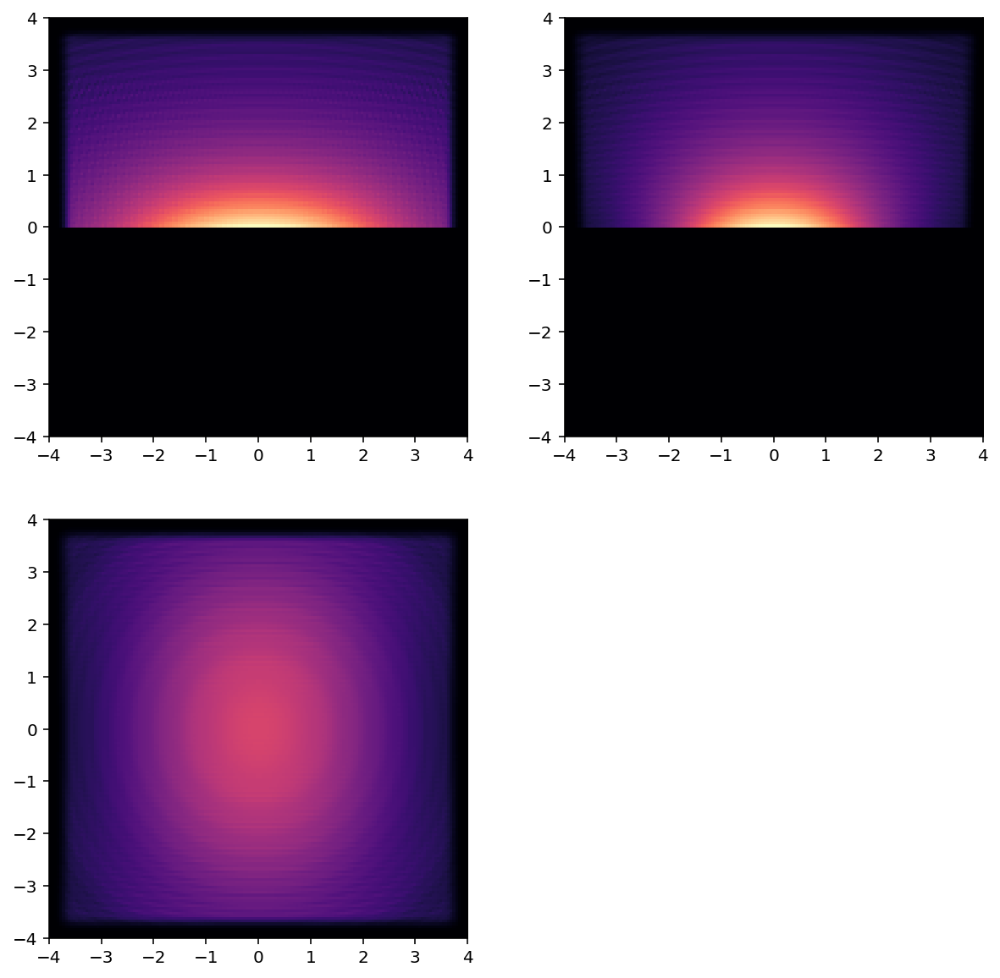

In [33]:
chosen_index_0 = int(E2.shape[0]/2)
chosen_index_1 = int(3*E2.shape[0]/5)
vmin = np.percentile(E2.flatten(),0)
vmax = np.percentile(E2.flatten(),100)
fig,ax = plt.subplots(ncols=2,nrows=2,figsize=(10,10))
radii = 0.25+np.arange(60)*metalens['wavelength']/2
angles = np.linspace(0,2*np.pi,100)
xr = np.cos(angles)
yr = np.sin(angles)
ax[0][0].imshow(E2[chosen_index_0,:,:].T,
          extent=[-metalens['sim_cell_width']/2,
                 metalens['sim_cell_width']/2,
                 -metalens['sim_cell_width']/2,
                 metalens['sim_cell_width']/2],
          norm=Normalize(vmin=vmin,vmax=vmax),
          origin='lower',
          cmap='magma')
# for r in radii:
#     ax[0][0].plot(r*xr,r*yr-metalens['H'],'w--',alpha=0.2)
ax[0][0].set_ylim(-metalens['sim_cell_width']/2,
                 metalens['sim_cell_width']/2)
ax[0][0].set_xlim(-metalens['sim_cell_width']/2,
                 metalens['sim_cell_width']/2)
ax[0][1].imshow(E2[:,chosen_index_0,:].T,
          extent=[-metalens['sim_cell_width']/2,
                 metalens['sim_cell_width']/2,
                 -metalens['sim_cell_width']/2,
                 metalens['sim_cell_width']/2],
          norm=Normalize(vmin=vmin,vmax=vmax),
          origin='lower',
          cmap='magma')
# for r in radii:
#     ax[0][1].plot(r*xr,r*yr-metalens['H'],'w--',alpha=0.2)
ax[0][1].set_ylim(-metalens['sim_cell_width']/2,
                 metalens['sim_cell_width']/2)
ax[0][1].set_xlim(-metalens['sim_cell_width']/2,
                 metalens['sim_cell_width']/2)
ax[1][0].imshow(E2[:,:,chosen_index_1].T,
          extent=[-metalens['sim_cell_width']/2,
                 metalens['sim_cell_width']/2,
                 -metalens['sim_cell_width']/2,
                 metalens['sim_cell_width']/2],
          norm=Normalize(vmin=vmin,vmax=vmax),
          origin='lower',
          cmap='magma')
ax[1][1].axis('off')
plt.show()

In [11]:
!say "beep, beep"

## Standard Candle (after CCV fixes)

In [82]:
metalens = {'epsilon': 5.8418,
          'pillar_radius': 0.25,
          'pillar_height' : 0.5,
          'pillar_separation': 1,
          'sim_cell_width': 8,
          'PML_width': 0.5,
          'wavelength': 0.5,
          'resolution': 20,
          'symmetries': [],
          'sim_time': 10.,
          'complex_fields': True,
          'num_cores': 1,
          'quiet':False}

In [83]:
metalens = standard(metalens) 

-----------
Initializing structure...
     block, center = (0,0,-2)
          size (8,8,4)
          axes (1,0,0), (0,1,0), (0,0,1)
     cylinder, center = (-1,-1,0)
          radius 0.25, height 0.5, axis (0, 0, 1)
     cylinder, center = (-1,1,0)
          radius 0.25, height 0.5, axis (0, 0, 1)
     cylinder, center = (1,-1,0)
          radius 0.25, height 0.5, axis (0, 0, 1)
     cylinder, center = (1,1,0)
          radius 0.25, height 0.5, axis (0, 0, 1)
     cylinder, center = (0,0,0)
          radius 0.25, height 0.5, axis (0, 0, 1)
Meep: using complex fields.
Meep progress: 0.025/10.0 = 0.2% done in 7.2s, 2889.6s to go
Meep progress: 0.6000000000000001/10.0 = 6.0% done in 11.3s, 177.1s to go
Meep progress: 1.175/10.0 = 11.8% done in 15.3s, 115.2s to go
Meep progress: 1.75/10.0 = 17.5% done in 19.4s, 91.4s to go
Meep progress: 2.325/10.0 = 23.2% done in 23.4s, 77.3s to go
Meep progress: 2.9000000000000004/10.0 = 29.0% done in 27.4s, 67.1s to go
Meep progress: 3.475/10.0 = 34.8% 

In [84]:
h5_filenames = [fn for fn in os.listdir() if (str(metalens['run_date']) in fn) and '.h5' in fn]
metalens['h5_files'] = {}
metalens['h5_files']['e'] = [fn for fn in h5_filenames if '-e-' in fn][0]
metalens['h5_files']['h'] = [fn for fn in h5_filenames if '-h-' in fn][0]

In [85]:
metalens['fields'] = {}
for field in ['e','h']:
    h5_file = h5py.File(metalens['h5_files'][field],'r')
    for field_component in [field+'x',field+'y',field+'z']:
        metalens['fields'][field_component] = np.array(h5_file[field_component+'.r']) + 1j*np.array(h5_file[field_component+'.i'])
    h5_file.close()
E2 = (np.abs(metalens['fields']['ex'])**2 + 
          np.abs(metalens['fields']['ey'])**2 + 
          np.abs(metalens['fields']['ez'])**2)

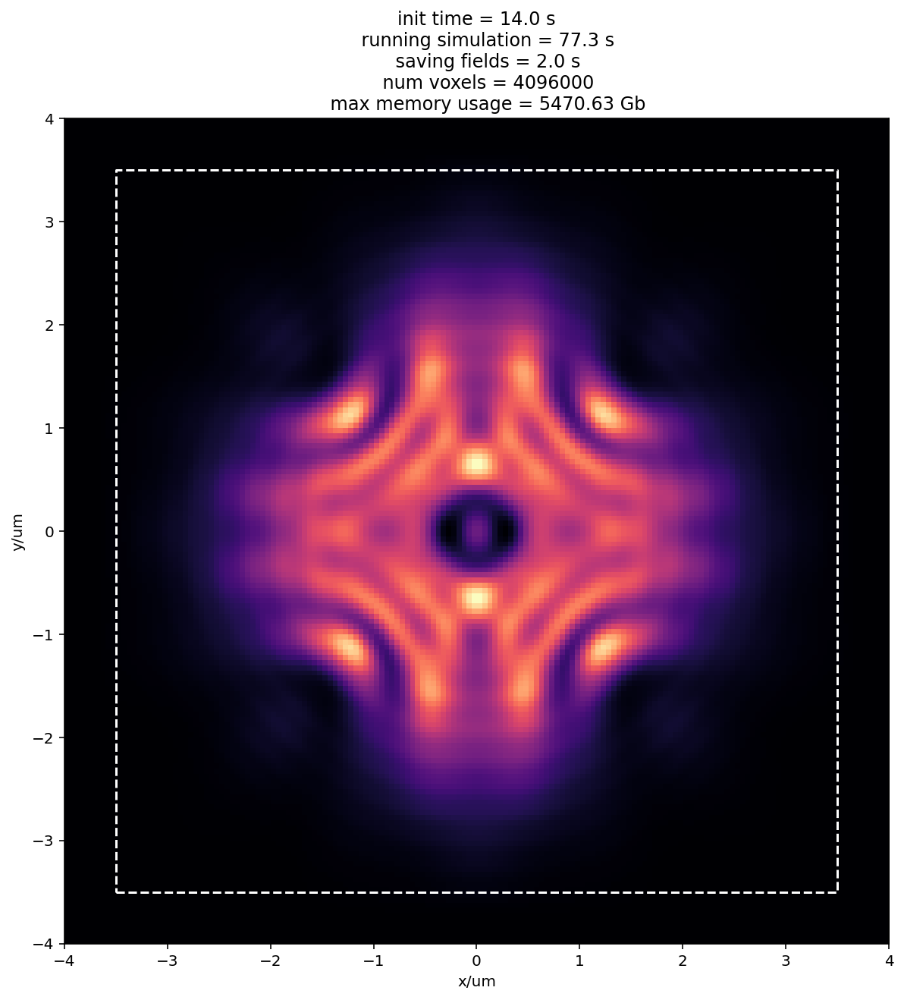

In [86]:
metalens['above_pillar_index'] = int(E2.shape[0]/2+metalens['pillar_height']*metalens['resolution']*1.5)
plt.figure(figsize=(10,10))
plt.imshow(E2[:,:,metalens['above_pillar_index']],
          extent=[-metalens['sim_cell_width']/2,
                 metalens['sim_cell_width']/2,
                 -metalens['sim_cell_width']/2,
                 metalens['sim_cell_width']/2],
          origin='lower',
          cmap='magma')
plt.plot([-metalens['sim_cell_width']/2+metalens['PML_width'],
         metalens['sim_cell_width']/2-metalens['PML_width'],
         metalens['sim_cell_width']/2-metalens['PML_width'],
         -metalens['sim_cell_width']/2+metalens['PML_width'],
         -metalens['sim_cell_width']/2+metalens['PML_width']],
        [-metalens['sim_cell_width']/2+metalens['PML_width'],
         -metalens['sim_cell_width']/2+metalens['PML_width'],
         metalens['sim_cell_width']/2-metalens['PML_width'],
         metalens['sim_cell_width']/2-metalens['PML_width'],
         -metalens['sim_cell_width']/2+metalens['PML_width']],'w--')
plt.xlabel('x/um')
plt.title(metalens['summary'])
plt.ylabel('y/um')
plt.show()

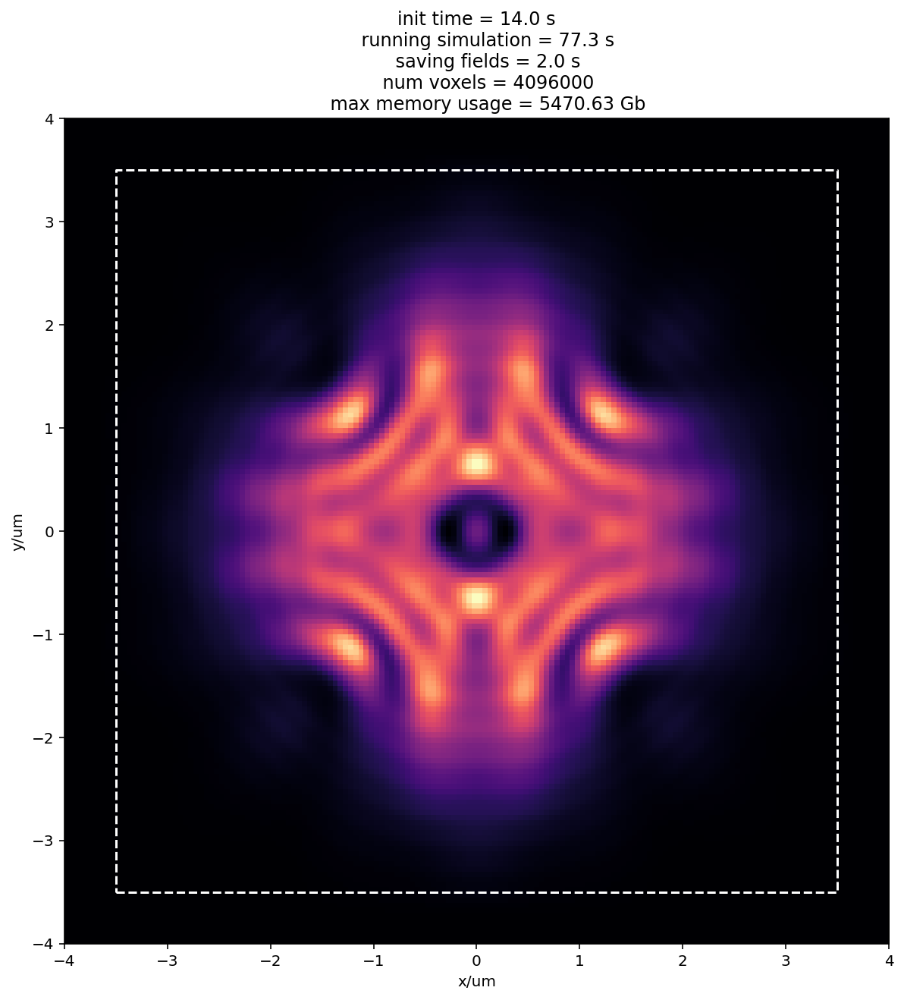

In [90]:
metalens['above_pillar_index'] = int(E2.shape[0]/2+metalens['pillar_height']*metalens['resolution']*1.5)
chosen_index = int(E2.shape[0]/3)
chosen_index = metalens['above_pillar_index']
plt.figure(figsize=(10,10))
plt.imshow(E2[:,:,chosen_index],
          extent=[-metalens['sim_cell_width']/2,
                 metalens['sim_cell_width']/2,
                 -metalens['sim_cell_width']/2,
                 metalens['sim_cell_width']/2],
          origin='lower',
          cmap='magma')
plt.plot([-metalens['sim_cell_width']/2+metalens['PML_width'],
         metalens['sim_cell_width']/2-metalens['PML_width'],
         metalens['sim_cell_width']/2-metalens['PML_width'],
         -metalens['sim_cell_width']/2+metalens['PML_width'],
         -metalens['sim_cell_width']/2+metalens['PML_width']],
        [-metalens['sim_cell_width']/2+metalens['PML_width'],
         -metalens['sim_cell_width']/2+metalens['PML_width'],
         metalens['sim_cell_width']/2-metalens['PML_width'],
         metalens['sim_cell_width']/2-metalens['PML_width'],
         -metalens['sim_cell_width']/2+metalens['PML_width']],'w--')
plt.xlabel('x/um')
plt.title(metalens['summary'])
plt.ylabel('y/um')
plt.show()

In [71]:
!say "beep, beep, beep"

## Standard Candle (scripted and recovered)

In [96]:
metalens = pickle.load(open('/Users/david/Temp/cem/candle-1589837179.pkl','rb'))

In [97]:
if metalens['save_fields_to_h5']:
    h5_file = h5py.File(os.path.join('/Users/david/Temp/cem/',metalens['h5_fname']),'r')
    fields = h5_file['fields']
    E2 = np.abs(np.array(fields['Ex']))**2
    E2 = E2 + np.abs(np.array(fields['Ey']))**2
    E2 = E2 + np.abs(np.array(fields['Ez']))**2
    h5_file.close()
else:
    E2 = (np.abs(metalens['fields']['Ex'])**2 + 
          np.abs(metalens['fields']['Ey'])**2 + 
          np.abs(metalens['fields']['Ez'])**2)

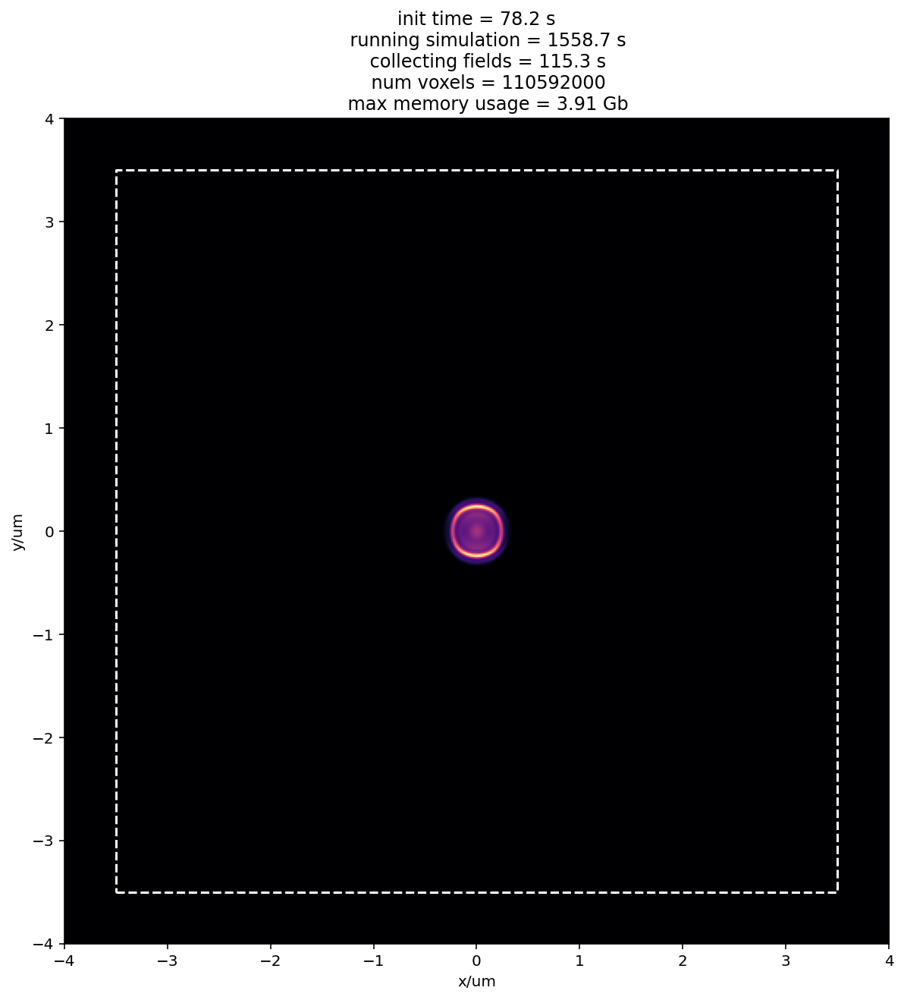

In [105]:
plt.figure(figsize=(10,10))
plt.imshow(E2[metalens['above_pillar_index']-150],
          extent=[-metalens['sim_cell_width']/2,
                 metalens['sim_cell_width']/2,
                 -metalens['sim_cell_width']/2,
                 metalens['sim_cell_width']/2],
          origin='lower',
          cmap='magma')
plt.plot([-metalens['sim_cell_width']/2+metalens['PML_width'],
         metalens['sim_cell_width']/2-metalens['PML_width'],
         metalens['sim_cell_width']/2-metalens['PML_width'],
         -metalens['sim_cell_width']/2+metalens['PML_width'],
         -metalens['sim_cell_width']/2+metalens['PML_width']],
        [-metalens['sim_cell_width']/2+metalens['PML_width'],
         -metalens['sim_cell_width']/2+metalens['PML_width'],
         metalens['sim_cell_width']/2-metalens['PML_width'],
         metalens['sim_cell_width']/2-metalens['PML_width'],
         -metalens['sim_cell_width']/2+metalens['PML_width']],'w--')
plt.xlabel('x/um')
plt.title(metalens['summary'])
plt.ylabel('y/um')
plt.show()

## Standard Candle (scripted)

In [72]:
metalens = {'epsilon': 5.8418,
          'pillar_radius': 0.25,
          'pillar_height' : 0.5,
          'pillar_separation': 1,
          'sim_cell_width': 8,
          'PML_width': 0.5,
          'wavelength': 0.5,
          'resolution': 10,
          'symmetries': [],
          'sim_time': 10.,
          'complex_fields': True,
          'num_cores': 1,
          'save_fields_to_h5': True,
          'quiet':False}

In [73]:
metalens = standard(metalens) 

-----------
Initializing structure...
     block, center = (0,0,-2)
          size (8,8,4)
          axes (1,0,0), (0,1,0), (0,0,1)
     cylinder, center = (-1,-1,0)
          radius 0.25, height 0.5, axis (0, 0, 1)
     cylinder, center = (-1,1,0)
          radius 0.25, height 0.5, axis (0, 0, 1)
     cylinder, center = (1,-1,0)
          radius 0.25, height 0.5, axis (0, 0, 1)
     cylinder, center = (1,1,0)
          radius 0.25, height 0.5, axis (0, 0, 1)
     cylinder, center = (0,0,0)
          radius 0.25, height 0.5, axis (0, 0, 1)
Meep: using complex fields.
Meep progress: 4.45/10.0 = 44.5% done in 4.0s, 5.0s to go
run 0 finished at t = 10.0 (200 timesteps)


In [76]:
if metalens['save_fields_to_h5']:
    h5_file = h5py.File(metalens['h5_fname'],'r')
    fields = h5_file['fields']
    E2 = np.abs(np.array(fields['Ex']))**2
    E2 = E2 + np.abs(np.array(fields['Ey']))**2
    E2 = E2 + np.abs(np.array(fields['Ez']))**2
    h5_file.close()
else:
    E2 = (np.abs(metalens['fields']['Ex'])**2 + 
          np.abs(metalens['fields']['Ey'])**2 + 
          np.abs(metalens['fields']['Ez'])**2)

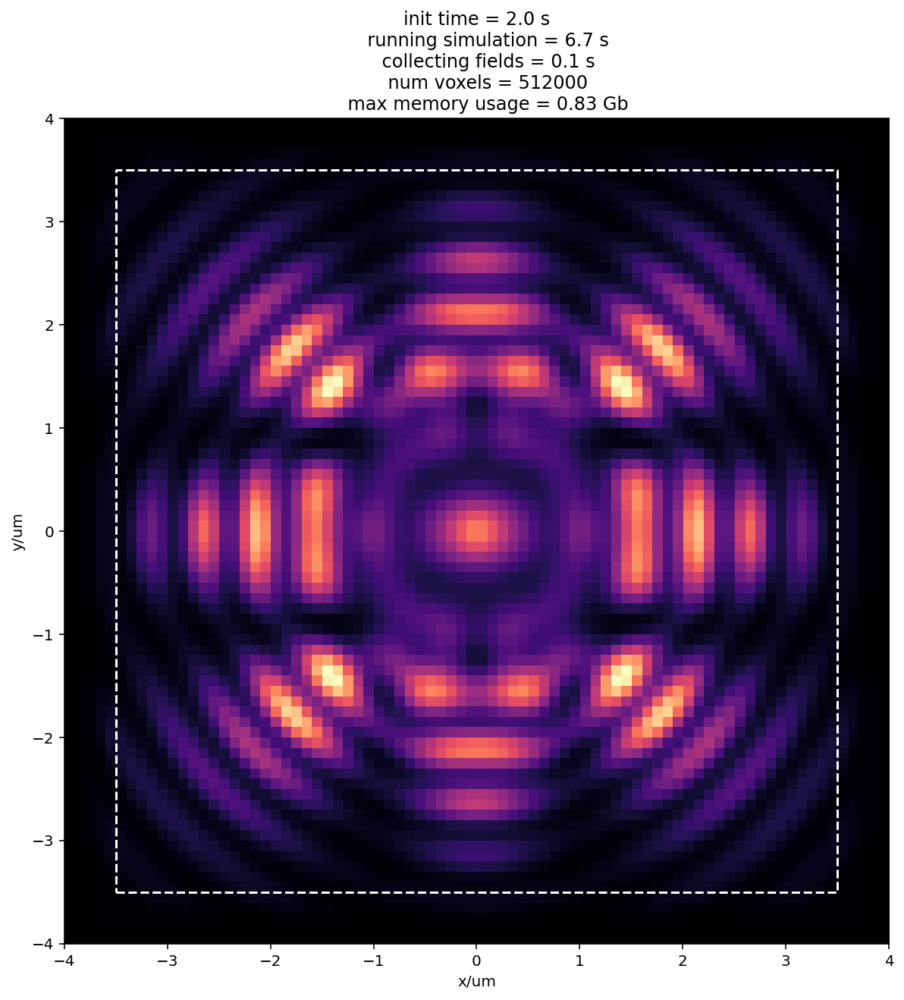

In [71]:
# not from h5
plt.figure(figsize=(10,10))
plt.imshow(E2[metalens['above_pillar_index']],
          extent=[-metalens['sim_cell_width']/2,
                 metalens['sim_cell_width']/2,
                 -metalens['sim_cell_width']/2,
                 metalens['sim_cell_width']/2],
          origin='lower',
          cmap='magma')
plt.plot([-metalens['sim_cell_width']/2+metalens['PML_width'],
         metalens['sim_cell_width']/2-metalens['PML_width'],
         metalens['sim_cell_width']/2-metalens['PML_width'],
         -metalens['sim_cell_width']/2+metalens['PML_width'],
         -metalens['sim_cell_width']/2+metalens['PML_width']],
        [-metalens['sim_cell_width']/2+metalens['PML_width'],
         -metalens['sim_cell_width']/2+metalens['PML_width'],
         metalens['sim_cell_width']/2-metalens['PML_width'],
         metalens['sim_cell_width']/2-metalens['PML_width'],
         -metalens['sim_cell_width']/2+metalens['PML_width']],'w--')
plt.xlabel('x/um')
plt.title(metalens['summary'])
plt.ylabel('y/um')
plt.show()

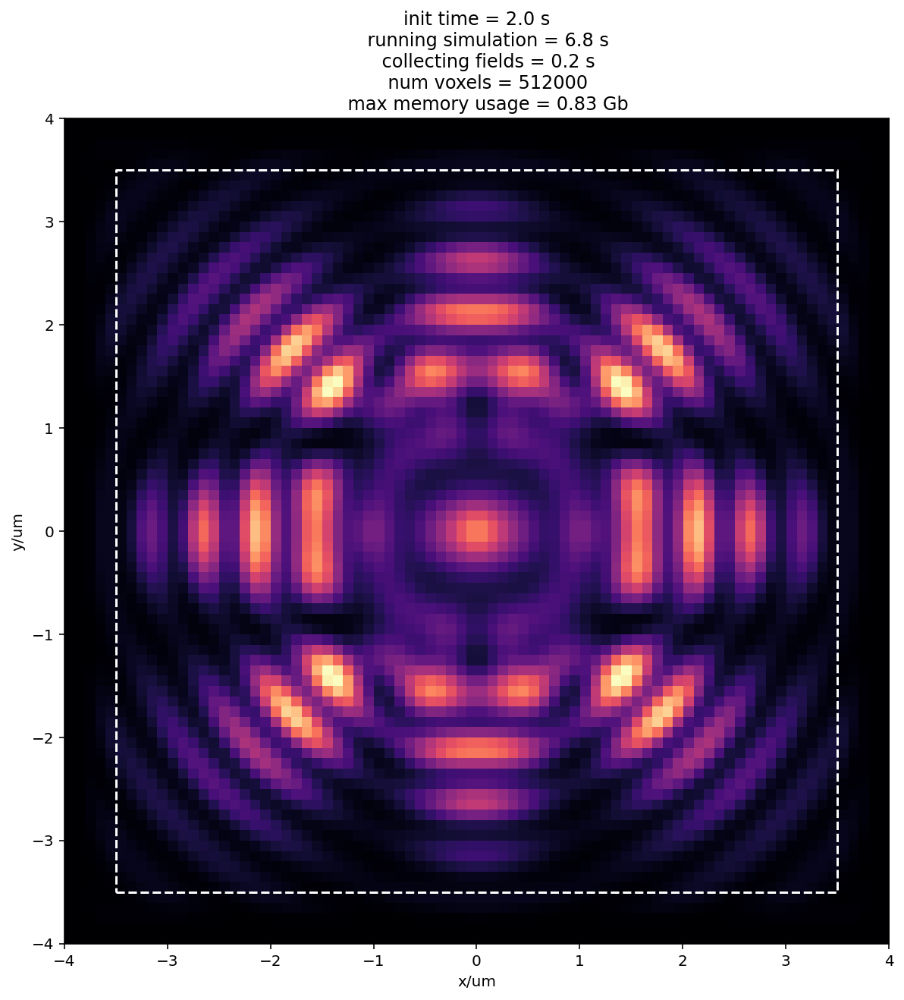

In [77]:
#from h5
plt.figure(figsize=(10,10))
plt.imshow(E2[metalens['above_pillar_index']],
          extent=[-metalens['sim_cell_width']/2,
                 metalens['sim_cell_width']/2,
                 -metalens['sim_cell_width']/2,
                 metalens['sim_cell_width']/2],
          origin='lower',
          cmap='magma')
plt.plot([-metalens['sim_cell_width']/2+metalens['PML_width'],
         metalens['sim_cell_width']/2-metalens['PML_width'],
         metalens['sim_cell_width']/2-metalens['PML_width'],
         -metalens['sim_cell_width']/2+metalens['PML_width'],
         -metalens['sim_cell_width']/2+metalens['PML_width']],
        [-metalens['sim_cell_width']/2+metalens['PML_width'],
         -metalens['sim_cell_width']/2+metalens['PML_width'],
         metalens['sim_cell_width']/2-metalens['PML_width'],
         metalens['sim_cell_width']/2-metalens['PML_width'],
         -metalens['sim_cell_width']/2+metalens['PML_width']],'w--')
plt.xlabel('x/um')
plt.title(metalens['summary'])
plt.ylabel('y/um')
plt.show()

## Standard Candle (scratchpad)

In [30]:
import meep as mp
import numpy as np
from itertools import product
from time import time, sleep
import resource
from matplotlib import pyplot as plt
import h5py
import os
import psutil
process = psutil.Process(os.getpid())

In [31]:
def get_mem():
    return process.memory_info().rss

In [32]:
def standard(params):
    start_mem = get_mem()
    params['run_date'] = time()
    matter = mp.Medium(epsilon=params['epsilon'])

    pillar_locs = list(product([-params['pillar_separation'],params['pillar_separation']],
                      [-params['pillar_separation'],params['pillar_separation']]))
    pillar_locs.append((0,0))

    pillars = [mp.Cylinder(radius=params['pillar_radius'],
                             height=params['pillar_height'],
                             center=mp.Vector3(x,y,0),
                             material=matter) for x,y in pillar_locs]

    substrate = [mp.Block(size=mp.Vector3(params['sim_cell_width'],params['sim_cell_width'],params['sim_cell_width']/2),
                          center=mp.Vector3(0,0,-params['sim_cell_width']/4),
                          material=matter)]
    geometry = substrate + pillars
    cell = mp.Vector3(params['sim_cell_width'],
                      params['sim_cell_width'],
                      params['sim_cell_width'])
    pml = [mp.PML(params['PML_width'])]
    source = [mp.Source(src=mp.ContinuousSource(
                        wavelength=params['wavelength']),
                        component=mp.Ex,
                        center=mp.Vector3(0, 0, -params['sim_cell_width']/4),
                        size=mp.Vector3(0,0,0))]
    symmetries = []
    for symmetry in params['symmetries']:
        if symmetry == 'x':
            symmetries.append(mp.Mirror(mp.X))
        if symmetry == 'y':
            symmetries.append(mp.Mirror(mp.Y))
    sim = mp.Simulation(cell_size=cell,
                       boundary_layers = pml,
                       geometry=geometry,
                       force_complex_fields = params['complex_fields'],
                       symmetries=symmetries,
                       sources=source,
                       resolution=params['resolution'])
    start_time = time()
    mp.quiet(params['quiet'])
    sim.init_sim()
    params['time_for_init'] = (time() - start_time)
    start_time = time()
    sim.run(until=params['sim_time'])
    params['time_for_running'] = time() - start_time
    start_time = time()
    params['fields'] = {'Ex': np.transpose(sim.get_array(component=mp.Ex),(2,1,0)),
                              'Ey': np.transpose(sim.get_array(component=mp.Ey),(2,1,0)),
                              'Ez': np.transpose(sim.get_array(component=mp.Ey),(2,1,0)),
                              'Hx': np.transpose(sim.get_array(component=mp.Hx),(2,1,0)),
                              'Hy': np.transpose(sim.get_array(component=mp.Hy),(2,1,0)),
                              'Hz': np.transpose(sim.get_array(component=mp.Hz),(2,1,0))
                              }
    params['time_for_collecting_fields'] = time() - start_time
    params['voxels'] = params['fields']['Ex'].shape[0]**3
    params['above_pillar_index'] = int(params['fields']['Ex'].shape[0]/2. + 3*params['pillar_height']*params['resolution']/2)
    params['max_mem_usage_in_Gb'] = resource.getrusage(resource.RUSAGE_SELF).ru_maxrss/1E9
    params['excess_mem_in_Gb'] = (get_mem() - start_mem)/1e9
    params['fields']['E2'] = np.abs(params['fields']['Ex'])**2 + np.abs(params['fields']['Ey'])**2 + np.abs(params['fields']['Ez'])**2;
    return params

In [33]:
params = {'epsilon': 5.8418,
                  'pillar_radius': 0.25,
                  'pillar_height' : 0.5,
                  'pillar_separation': 1,
                  'sim_cell_width': 8,
                  'PML_width': 0.5,
                  'wavelength': 0.5,
                  'resolution': 5.,
                  'symmetries': [],
                  'sim_time': 10.,
                  'complex_fields': True,
                 'quiet':False}
# params = standard(params)

In [34]:
start_mem = get_mem()
params['run_date'] = time()
matter = mp.Medium(epsilon=params['epsilon'])

pillar_locs = list(product([-params['pillar_separation'],params['pillar_separation']],
                  [-params['pillar_separation'],params['pillar_separation']]))
pillar_locs.append((0,0))

pillars = [mp.Cylinder(radius=params['pillar_radius'],
                         height=params['pillar_height'],
                         center=mp.Vector3(x,y,0),
                         material=matter) for x,y in pillar_locs]

substrate = [mp.Block(size=mp.Vector3(params['sim_cell_width'],params['sim_cell_width'],params['sim_cell_width']/2),
                      center=mp.Vector3(0,0,-params['sim_cell_width']/4),
                      material=matter)]
geometry = substrate + pillars
cell = mp.Vector3(params['sim_cell_width'],
                  params['sim_cell_width'],
                  params['sim_cell_width'])
pml = [mp.PML(params['PML_width'])]
source = [mp.Source(src=mp.ContinuousSource(
                    wavelength=params['wavelength']),
                    component=mp.Ex,
                    center=mp.Vector3(0, 0, -params['sim_cell_width']/4),
                    size=mp.Vector3(0,0,0))]
symmetries = []
for symmetry in params['symmetries']:
    if symmetry == 'x':
        symmetries.append(mp.Mirror(mp.X))
    if symmetry == 'y':
        symmetries.append(mp.Mirror(mp.Y))
sim = mp.Simulation(cell_size=cell,
                   boundary_layers = pml,
                   geometry=geometry,
                   force_complex_fields = params['complex_fields'],
                   symmetries=symmetries,
                   sources=source,
                   resolution=params['resolution'])
start_time = time()
mp.quiet(params['quiet'])
sim.init_sim()
params['time_for_init'] = (time() - start_time)
start_time = time()
sim.run(until=params['sim_time'])
params['time_for_running'] = time() - start_time
start_time = time()
params['fields'] = {'Ex': np.transpose(sim.get_array(component=mp.Ex),(2,1,0)),
                          'Ey': np.transpose(sim.get_array(component=mp.Ey),(2,1,0)),
                          'Ez': np.transpose(sim.get_array(component=mp.Ey),(2,1,0)),
                          'Hx': np.transpose(sim.get_array(component=mp.Hx),(2,1,0)),
                          'Hy': np.transpose(sim.get_array(component=mp.Hy),(2,1,0)),
                          'Hz': np.transpose(sim.get_array(component=mp.Hz),(2,1,0))
                          }
params['time_for_collecting_fields'] = time() - start_time
params['voxels'] = params['fields']['Ex'].shape[0]**3
params['above_pillar_index'] = int(params['fields']['Ex'].shape[0]/2. + 3*params['pillar_height']*params['resolution']/2)
params['max_mem_usage_in_Gb'] = resource.getrusage(resource.RUSAGE_SELF).ru_maxrss/1E9
params['excess_mem_in_Gb'] = (get_mem() - start_mem)/1e9
params['fields']['E2'] = np.abs(params['fields']['Ex'])**2 + np.abs(params['fields']['Ey'])**2 + np.abs(params['fields']['Ez'])**2;

-----------
Initializing structure...
     block, center = (0,0,-2)
          size (8,8,4)
          axes (1,0,0), (0,1,0), (0,0,1)
     cylinder, center = (-1,-1,0)
          radius 0.25, height 0.5, axis (0, 0, 1)
     cylinder, center = (-1,1,0)
          radius 0.25, height 0.5, axis (0, 0, 1)
     cylinder, center = (1,-1,0)
          radius 0.25, height 0.5, axis (0, 0, 1)
     cylinder, center = (1,1,0)
          radius 0.25, height 0.5, axis (0, 0, 1)
     cylinder, center = (0,0,0)
          radius 0.25, height 0.5, axis (0, 0, 1)
Meep: using complex fields.
run 0 finished at t = 10.0 (100 timesteps)


In [39]:
mp.__version__

'1.12.0'

In [38]:
sim.get_array_metadata()

RuntimeError: meep: weird yee shift for component none

In [73]:
maxMem = 8
maxResolutions = {}
maxResolutions['from_Mem'] = round((maxMem/params['excess_mem_in_Gb']*params['resolution']**3)**(1/3))
maxTime = 60*30
maxResolutions['from_Time'] = round(maxTime/params['time_for_running']*params['resolution'])
limitResolution = min(maxResolutions.values())
estimated_mem = None
estimated_time = None
if limitResolution == maxResolutions['from_Mem']:
    type_limit = "mem"
    estimated_time = params['resolution']*params['time_for_running']/limitResolution
if limitResolution == maxResolutions['from_Time']:
    type_limit = "time"
    estimated_mem = params['resolution']*(limitResolution/params['resolution'])
synopsis = ['Target Mem = {maxMem} Gb',
'Target Time = {maxTime} s',
'Limit Resolution = {limitResolution} ({type_limit}-limited)']
if type_limit == "mem":
    synopsis.append('estimated run time = {estimated_time} s')
if type_limit == "time":
    synopsis.append('estimated excess mem = {estimated_mem} Gb')
synopsis='\n'.join(synopsis).format(estimated_time=estimated_time,estimated_mem=estimated_mem,maxMem=maxMem,maxTime=maxTime,limitResolution=limitResolution,type_limit=type_limit)
print(synopsis)

Target Mem = 8 Gb
Target Time = 1800 s
Limit Resolution = 36 (mem-limited)
estimated run time = 67.94940237204234 s


In [44]:
maxMem = 2
maxResolutions = {}
maxResolutions['from_Mem'] = (maxMem/params['excess_mem_in_Gb']*params['resolution']**3)**(1/3)
maxTime = 60
maxResolutions['from_Time'] = maxTime/params['time_for_running']*params['resolution']
limitResolution = round(min(maxResolutions.values()))
limitResolution

22

In [75]:
param_strings_and_nums = ["{one}, {two}".format(one=k,two=params[k]) for k in params if type(params[k]) in [str,float]]

In [ ]:
print('\n'.join(param_strings_and_nums))

In [ ]:
!say "yo"

In [76]:
print('\n'.join(param_strings_and_nums))

epsilon, 5.8418
pillar_radius, 0.25
pillar_height, 0.5
PML_width, 0.5
wavelength, 0.5
resolution, 36.0
sim_time, 10.0
run_date, 1589486968.7030652
time_for_init, 77.5257260799408
time_for_running, 728.227961063385
time_for_collecting_fields, 5.87165904045105
max_mem_usage_in_Gb, 10.007625728
excess_mem_in_Gb, 3.34675968


In [78]:
0.8144619464874268/5**3*30**3

175.92378044128418

In [80]:
summary = '''init time = {time_for_init:.1f} s
running simulation = {time_for_running:.1f} s
collecting fields = {time_for_collecting_fields:.1f} s
num voxels = {voxels}
max memory usage = {max_mem_usage_in_Gb:.2f} Gb'''.format(**params);

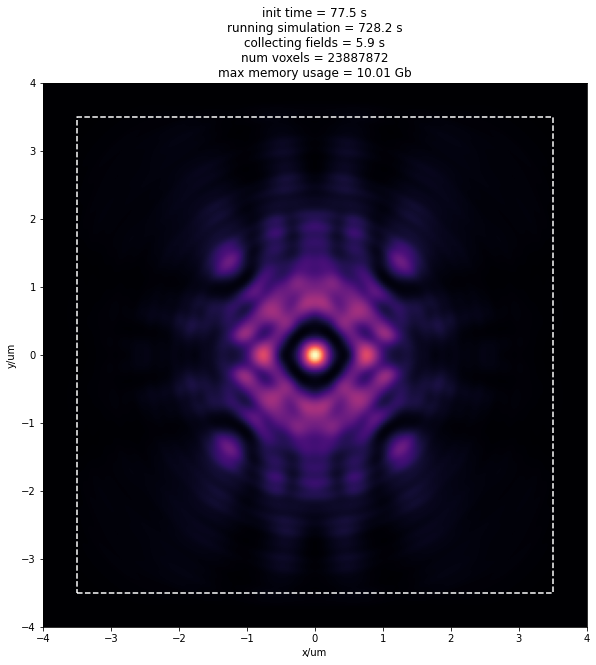

In [81]:
plt.figure(figsize=(10,10))
plt.imshow(E2[params['above_pillar_index']],
          extent=[-params['sim_cell_width']/2,
                 params['sim_cell_width']/2,
                 -params['sim_cell_width']/2,
                 params['sim_cell_width']/2],
          origin='lower',
          cmap='magma')
plt.plot([-params['sim_cell_width']/2+params['PML_width'],
         params['sim_cell_width']/2-params['PML_width'],
         params['sim_cell_width']/2-params['PML_width'],
         -params['sim_cell_width']/2+params['PML_width'],
         -params['sim_cell_width']/2+params['PML_width']],
        [-params['sim_cell_width']/2+params['PML_width'],
         -params['sim_cell_width']/2+params['PML_width'],
         params['sim_cell_width']/2-params['PML_width'],
         params['sim_cell_width']/2-params['PML_width'],
         -params['sim_cell_width']/2+params['PML_width']],'w--')
plt.xlabel('x/um')
plt.title(summary)
plt.ylabel('y/um')
plt.show()

In [83]:
h5_file = h5py.File('candleHD.h5','w')
dset = h5_file.create_dataset('E2', data = E2)
dset.attrs['summary'] = summary
h5_file.close()

## x-dipole

In [84]:
simulation_parameters = {
                        'wavelength': 0.400,
                        'post_width': 0.075,
                        'post_height': 0.800,
                        'cell_width': 0.25,
                        'epsilon': 5.8418,
                        'num_G' : 70,
                        'x_coord': 0,
                        'y_coord': 0,
                        'sim_id' : str(int(time.time())),
                        'pol': 's'}
simulation_parameters = expand_sim_params(simulation_parameters)

post_diameters = np.linspace(0.05,0.2,20)
phases = []
simulation_parameters['field_height'] = simulation_parameters['post_height']
for p_width in post_diameters:
    simulation_parameters['post_width'] = p_width
    simulation_parameters = expand_sim_params(simulation_parameters)
    results = post_field(simulation_parameters)
    Exr, Eyr, Ezr, Exi, Eyi, Ezi = results 
    if simulation_parameters['pol'] == 's':
        phases.append(np.arctan2(Eyi, Eyr))
    else:
        phases.append(np.arctan2(Exi, Exr))
phases = np.array(phases)
phases = np.unwrap(phases)
phases = phases - phases[0]
critical_width = np.interp(2*np.pi*1.01,phases,post_diameters)
phases_s = (phases / (2*np.pi))

In [96]:
np.ceil(0.1)

1.0

In [102]:
hex_lattice(simulation_parameters)

1.0

## S4 - 3D

In [5]:
simulation_parameters = {
                        'wavelength': 0.400,
                        'post_diameter': 0.075,
                        'post_height': 0.800,
                        'cell_width': 0.25,
                        'epsilon': 5.8418,
                        'num_G' : 70,
                        'x_coord': 0,
                        'y_coord': 0,
                        'sim_id' : str(int(time.time())),
                        'pol': 's'}
simulation_parameters = expand_sim_params(simulation_parameters)

post_diameters = np.linspace(0.05,0.2,20)
phases = []
simulation_parameters['field_height'] = simulation_parameters['post_height']
for p_diameter in post_diameters:
    simulation_parameters['post_diameter'] = p_diameter
    simulation_parameters = expand_sim_params(simulation_parameters)
    results = post_field(simulation_parameters)
    Exr, Eyr, Ezr, Exi, Eyi, Ezi = results 
    if simulation_parameters['pol'] == 's':
        phases.append(np.arctan2(Eyi, Eyr))
    else:
        phases.append(np.arctan2(Exi, Exr))
phases = np.array(phases)
phases = np.unwrap(phases)
phases = phases - phases[0]
critical_width = np.interp(2*np.pi*1.01,phases,post_diameters)
phases_s = (phases / (2*np.pi))

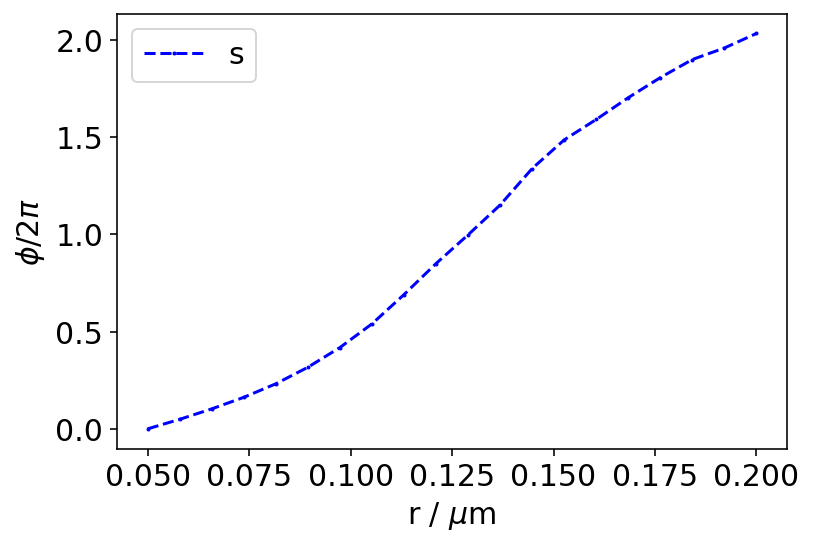

In [6]:
plt.rcParams.update({'font.size': 15})
plt.figure()
plt.plot(post_diameters, phases_s,'bo--',ms=1.,label='s')
plt.xlabel('r / $\mu$m')
plt.ylabel('$\phi/2\pi$')
plt.legend()
plt.show()

In [10]:
print(simulation_parameters['sim_id'])
pickle.dump({'post_diameters':post_diameters,'phases': phases,
             'simulation_parameters': simulation_parameters},
            open('carbon-phases-%s.pkl' % simulation_parameters['sim_id'],'wb'))

1589235448


### MEEP - run

In [11]:
sim_fname =  '/Users/david/Google Drive/Zia Lab/CEM/MEEP/carbon-phases-%s.pkl' % simulation_parameters['sim_id']
post_diameters = pickle.load(open(sim_fname,'rb'))['post_diameters']
phases = pickle.load(open(sim_fname,'rb'))['phases']
simulation_parameters = pickle.load(open(sim_fname,'rb'))['simulation_parameters']

In [12]:
metalens = {
    'post_height': simulation_parameters['post_height'],
    'R': 2.,  # radius of metalens
    'd': 20., # distance between interface and target surface
    's': 0.0, # padding-related
    'H': 20,  # depth of emitter
    'gap_h': 0., # padding-related
    'gap_v': 0.,  # padding-related
    'b': 2.0, # distance between source and interface
    'w': 2., # radius of target surface
    'unit_cell_size': simulation_parameters['cell_width'],
    'epsilon': simulation_parameters['epsilon'],
    'phases': phases,
    'widths': post_diameters,
    'wavelength': simulation_parameters['wavelength'],
    'min_width': 0.05,
    'pml_width': 1.0,
    'resolution': 40.,
    'sim_id': str(int(time.time())), #simulation_parameters['sim_id'],
    'simulation_parameters' : simulation_parameters,
    'complex_fields' : True,
    'save_output': False,
    'x_mirror_symmetry': False,
    'quiet': False,
    'freq_multiplier': 3, # must be an odd integer
    'log_to_pkl': [False,''],
    'beta': 0.
    }

metalens = aux_params(metalens)
metalens = make_metalens_geometry(metalens)
# metalens['incident_flux'] = get_flux_on_metalens(metalens)
metalens = simulate_metalens(metalens)

-----------
Initializing structure...
     block, center = (0,0,-1.9)
          size (6.002,6.002,1)
          axes (1,0,0), (0,1,0), (0,0,1)
     cylinder, center = (-1.5,1.29904,-1)
          radius 0.0515153, height 0.8, axis (0, 0, 1)
     cylinder, center = (-1.625,1.08253,-1)
          radius 0.0545464, height 0.8, axis (0, 0, 1)
     cylinder, center = (-1.75,0.866025,-1)
          radius 0.0545464, height 0.8, axis (0, 0, 1)
     cylinder, center = (-1.875,0.649519,-1)
          radius 0.0515153, height 0.8, axis (0, 0, 1)
     cylinder, center = (-1,1.73205,-1)
          radius 0.05, height 0.8, axis (0, 0, 1)
     cylinder, center = (-1.125,1.51554,-1)
          radius 0.0603693, height 0.8, axis (0, 0, 1)
     cylinder, center = (-1.25,1.29904,-1)
          radius 0.0671382, height 0.8, axis (0, 0, 1)
     cylinder, center = (-1.375,1.08253,-1)
          radius 0.0708926, height 0.8, axis (0, 0, 1)
     cylinder, center = (-1.5,0.866025,-1)
          radius 0.0721442, height

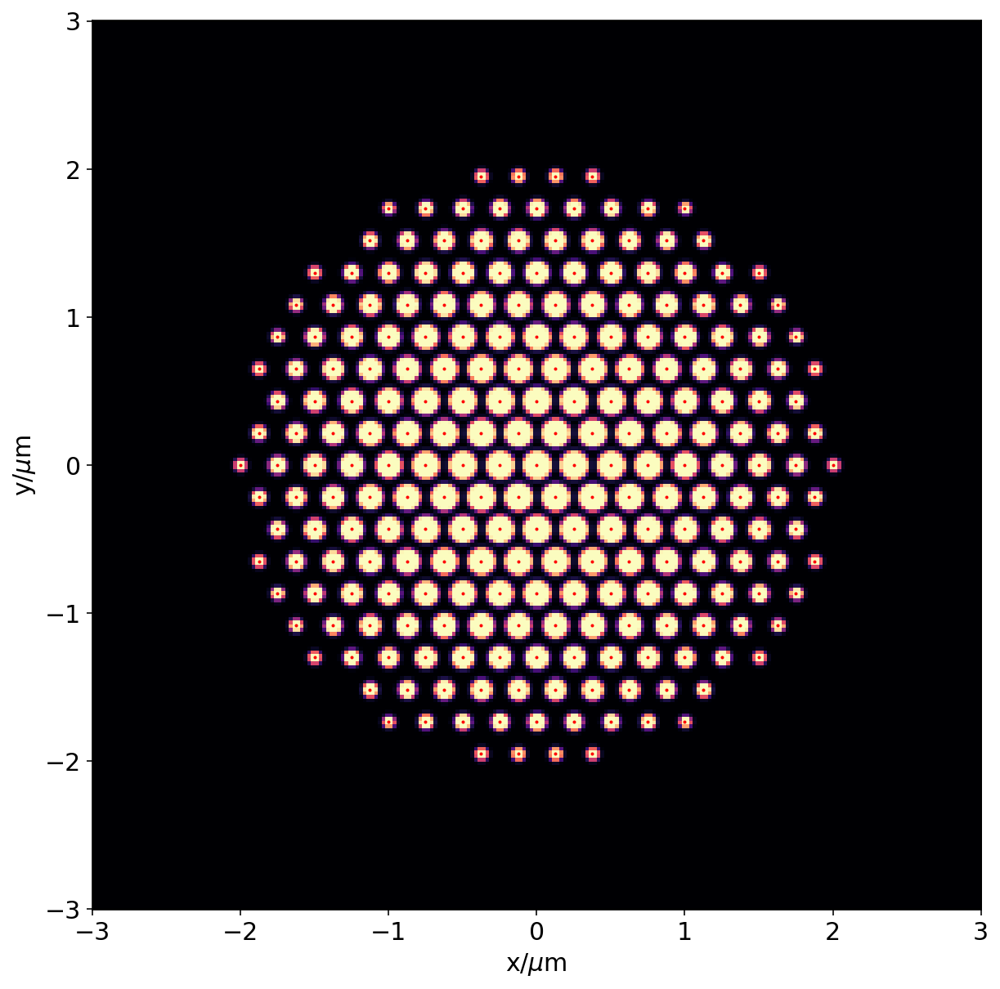

In [39]:
post_index = np.argmin(
    np.abs(
        np.linspace(-metalens['sim_cell_height']/2,
            metalens['sim_cell_height']/2,
            metalens['eps'].shape[0])
    -(metalens['interface_coord']+0.5*metalens['post_height'])))
plt.figure(figsize=(10,10))
plt.imshow(metalens['eps'][post_index],
          origin='lower',
          cmap='magma',
          extent=[-metalens['sim_cell_width']/2,
                 metalens['sim_cell_width']/2,
                 -metalens['sim_cell_width']/2,
                 metalens['sim_cell_width']/2])
plt.plot(metalens['post_centers'][:,0],
        metalens['post_centers'][:,1],'ro',ms=1)
plt.xlabel('x/$\mu$m')
plt.ylabel('y/$\mu$m')
plt.show()

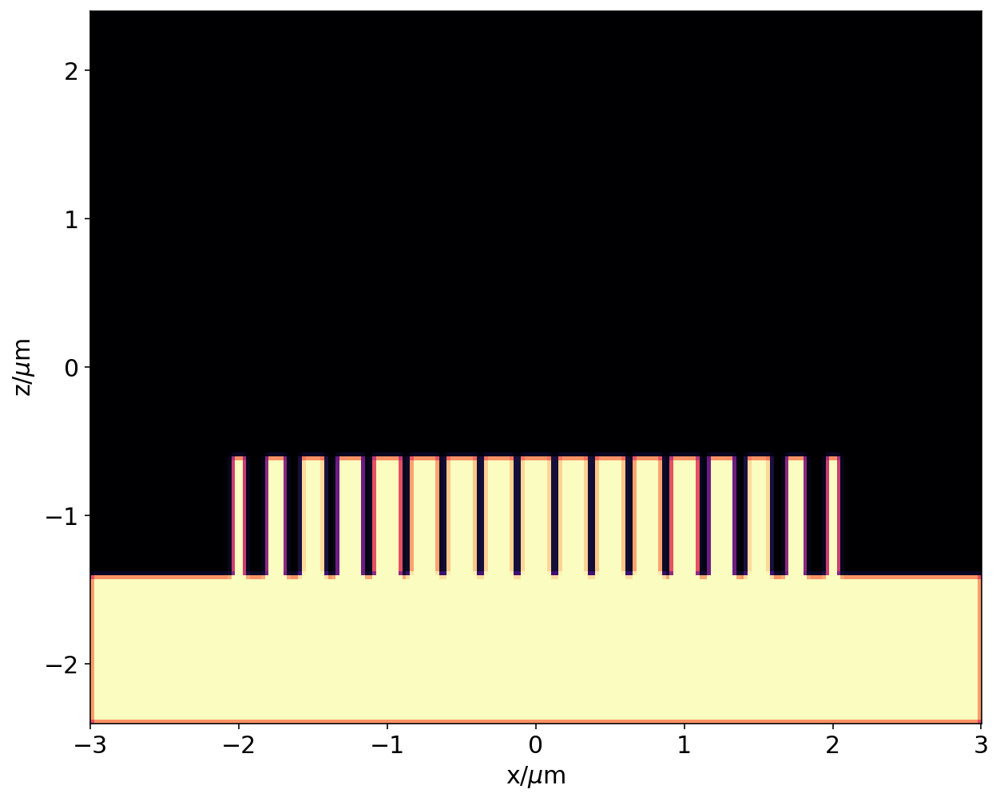

In [40]:
plt.figure(figsize=(10,10))
plt.imshow(metalens['eps'][:,int(metalens['eps'].shape[1]/2)],
          origin='lower',
          cmap='magma',
          extent=[-metalens['sim_cell_width']/2,
                 metalens['sim_cell_width']/2,
                 -metalens['sim_cell_height']/2,
                 metalens['sim_cell_height']/2])
plt.xlabel('x/$\mu$m')
plt.ylabel('z/$\mu$m')
# plt.colorbar()
plt.show()

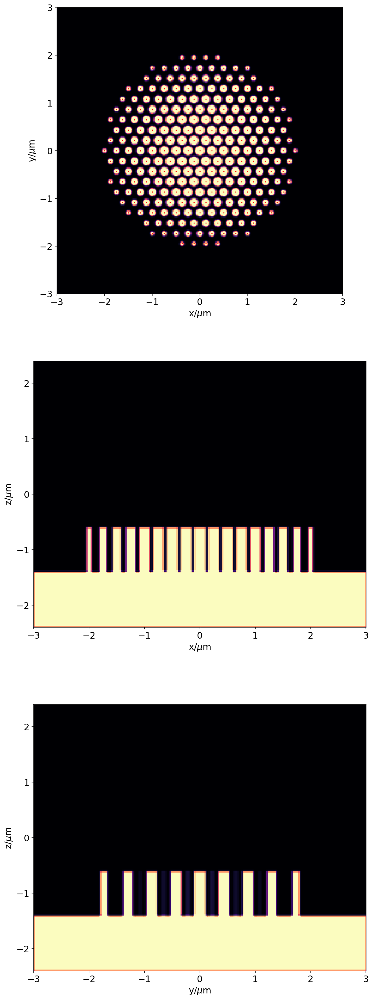

In [47]:
post_index = np.argmin(
    np.abs(
        np.linspace(-metalens['sim_cell_height']/2,
            metalens['sim_cell_height']/2,
            metalens['eps'].shape[0])
    -(metalens['interface_coord']+0.5*metalens['post_height'])))
fig, axes = plt.subplots(nrows=3,
                         figsize=(10,3*10))
axes[0].imshow(metalens['eps'][post_index],
          origin='lower',
          cmap='magma',
          extent=[-metalens['sim_cell_width']/2,
                 metalens['sim_cell_width']/2,
                 -metalens['sim_cell_width']/2,
                 metalens['sim_cell_width']/2])
axes[0].plot(metalens['post_centers'][:,0],
        metalens['post_centers'][:,1],'ro',ms=1)
axes[0].set_xlabel('x/$\mu$m')
axes[0].set_ylabel('y/$\mu$m')
axes[1].imshow(metalens['eps'][:,int(metalens['eps'].shape[1]/2)],
          origin='lower',
          cmap='magma',
          extent=[-metalens['sim_cell_width']/2,
                 metalens['sim_cell_width']/2,
                 -metalens['sim_cell_height']/2,
                 metalens['sim_cell_height']/2])
axes[1].set_xlabel('x/$\mu$m')
axes[1].set_ylabel('z/$\mu$m')
axes[2].imshow(metalens['eps'][:,:,int(metalens['eps'].shape[1]/2)],
          origin='lower',
          cmap='magma',
          extent=[-metalens['sim_cell_width']/2,
                 metalens['sim_cell_width']/2,
                 -metalens['sim_cell_height']/2,
                 metalens['sim_cell_height']/2])
axes[2].set_xlabel('y/$\mu$m')
axes[2].set_ylabel('z/$\mu$m')
plt.show()

In [15]:
!say "ding"

In [180]:
metalens = simulate_metalens(metalens)

-----------
Initializing structure...
     block, center = (0,0,-1.9)
          size (29.5203,29.5203,1)
          axes (1,0,0), (0,1,0), (0,0,1)
     cylinder, center = (-9.75,8.22724,-1)
          radius 0.05, height 0.8, axis (0, 0, 1)
     cylinder, center = (-9.875,8.01073,-1)
          radius 0.0809155, height 0.8, axis (0, 0, 1)
     cylinder, center = (-10,7.79423,-1)
          radius 0.0978401, height 0.8, axis (0, 0, 1)
     cylinder, center = (-10.125,7.57772,-1)
          radius 0.108347, height 0.8, axis (0, 0, 1)
     cylinder, center = (-10.25,7.36122,-1)
          radius 0.115873, height 0.8, axis (0, 0, 1)
     cylinder, center = (-10.375,7.14471,-1)
          radius 0.121878, height 0.8, axis (0, 0, 1)
     cylinder, center = (-10.5,6.9282,-1)
          radius 0.126881, height 0.8, axis (0, 0, 1)
     cylinder, center = (-10.625,6.7117,-1)
          radius 0.0540106, height 0.8, axis (0, 0, 1)
     cylinder, center = (-10.75,6.49519,-1)
          radius 0.0602474, hei

RuntimeError: meep: weird yee shift for component none

In [133]:
l_vecs = metalens['post_centers']

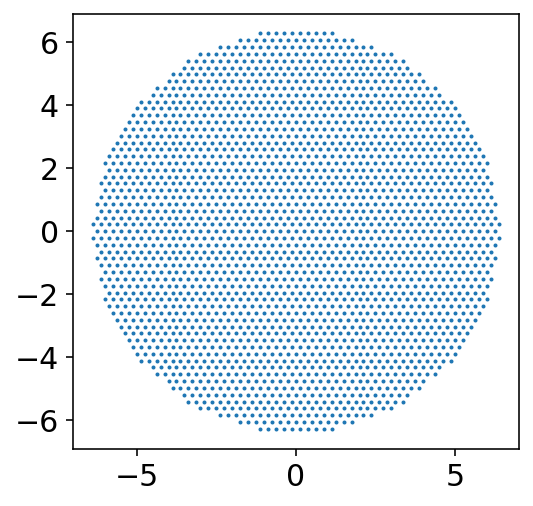

In [134]:
plt.figure(figsize=(4,4))
plt.plot(l_vecs[:,0],l_vecs[:,1],'o',ms=1)
plt.show()

In [92]:
metalens = compute_post_simulation_params(metalens)

Computing the farfield for Ex...
Computing the farfield for Ey...
Computing the farfield for Hz...
Patching the entire field for Ex...
Patching the entire field for Ey...
Patching the entire field for Hz...
Patching the entire field for rho_em...


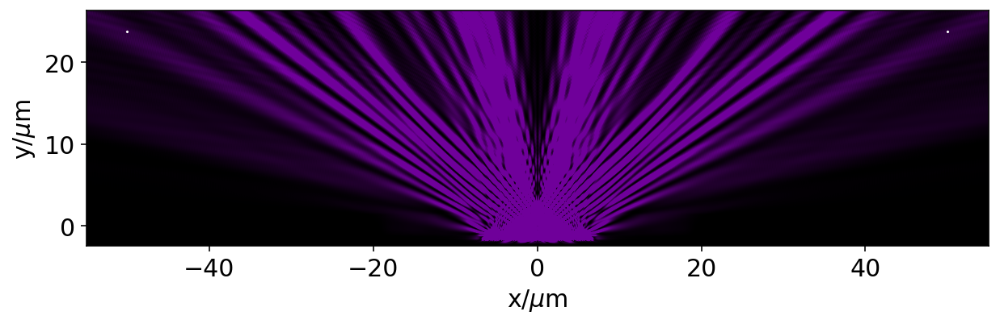

In [94]:
this_field = np.abs(metalens['farfields']['rho_em'])
vmin = np.percentile(this_field.flatten(),5)
vmax = np.percentile(this_field.flatten(),95)
plt.figure(figsize=(10,10))
plt.imshow(this_field,
          cmap=metalens['cmap'],
          origin='lower',
          vmin=vmin,
          vmax=vmax,
          extent=metalens['full_extent'])
plt.plot([-metalens['w'], metalens['w']],
         [metalens['detector_plane_coord']]*2,
         'wx',
         ms=1)
plt.xlim(-1.1*metalens['w'],1.1*metalens['w'])
plt.xlabel('x/$\mu$m')
plt.ylabel('y/$\mu$m')
plt.show()

In [95]:
print_params(metalens)

-----------------------------  -----------------------
post_height                    0.80
R                              6.38
d                              25.18
s                              0.00
H                              10
gap_h                          1.00
gap_v                          0.00
b                              2.00
w                              50.00
unit_cell_size                 0.25
epsilon                        5.84
wavelength                     0.40
min_width                      0.05
pml_width                      1.00
resolution                     40.00
sim_id                         1589225652
complex_fields                 True
save_output                    False
x_mirror_symmetry              True
quiet                          True
freq_multiplier                3
NAf                            0.50
beta                           0.00
n                              2.42
Ω                              0.54
zeta                           0.52
aper

## lots

In [141]:
Hs = np.linspace(5,50,36)
betas = np.linspace(0,np.pi,36)
whole = []
for Hindex, H in enumerate(Hs):
    row = []
    for betaindex, beta in enumerate(betas):
        good_bits = pickle.load(open('/Users/juan/Temp/oblique/metalens-analysis-%d-%d.pkl' % (Hindex, betaindex),'rb'))
        row.append(good_bits['tf/ff'])
    whole.append(row)
whole = np.array(whole)

In [144]:
np.savetxt("density.csv",whole,delimiter=',')

In [146]:
!open .

In [126]:
list(betas*180/np.pi)

[0.0,
 5.142857142857143,
 10.285714285714286,
 15.428571428571429,
 20.571428571428573,
 25.714285714285715,
 30.857142857142858,
 36.0,
 41.142857142857146,
 46.285714285714285,
 51.42857142857143,
 56.57142857142858,
 61.714285714285715,
 66.85714285714285,
 72.0,
 77.14285714285715,
 82.28571428571429,
 87.42857142857143,
 92.57142857142857,
 97.71428571428572,
 102.85714285714286,
 108.0,
 113.14285714285715,
 118.28571428571429,
 123.42857142857143,
 128.57142857142856,
 133.7142857142857,
 138.85714285714286,
 144.0,
 149.14285714285714,
 154.2857142857143,
 159.42857142857144,
 164.57142857142858,
 169.71428571428572,
 174.85714285714286,
 180.0]

In [147]:
dH=Hs[1]-Hs[0]
dbeta=betas[1]-betas[0]
#duble = np.concatenate((whole,whole[:,1:]),axis=1)

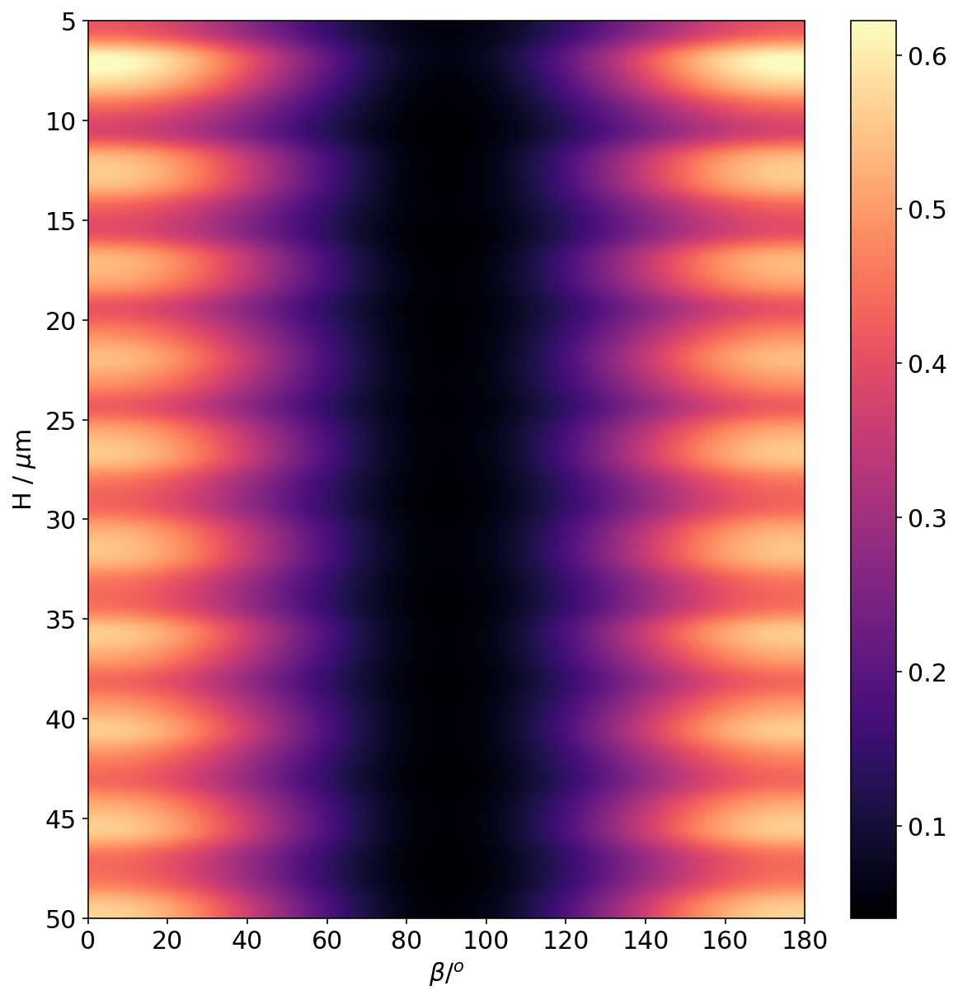

In [154]:
plt.figure(figsize=(10,10))
plt.imshow(whole,
          origin='upper',
          cmap='magma',
          extent=[0,180,50,5],
          aspect=5,interpolation='catrom')
plt.xlabel(r'$\beta / {}^o$')
plt.ylabel(r'H / $\mu$m')
plt.colorbar()
plt.show()

In [80]:
from scipy.signal import find_peaks

In [105]:
from scipy.interpolate import interp1d

In [109]:
interpfun = interp1d(Hs, whole[:,0], kind='cubic')
H_fine = np.linspace(5,50,200)
whole_fine = interpfun(H_fine)

In [112]:
peak_indices = np.array(list((map(lambda x: x in find_peaks(whole_fine)[0],
                        range(len(whole_fine))))))

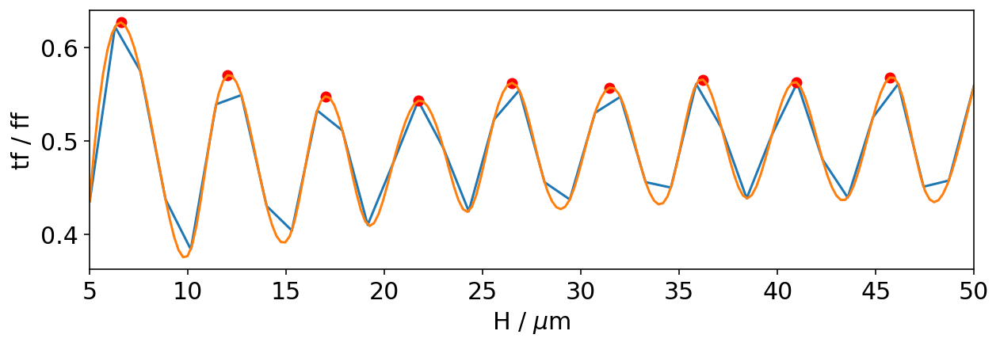

In [156]:
plt.figure(figsize=(10,3))
plt.plot(Hs,whole[:,0])
plt.plot(H_fine[peak_indices],whole_fine[peak_indices],'ro')
plt.plot(H_fine, whole_fine)
plt.xlabel('H / $\mu$m')
plt.ylabel('tf / ff')
plt.xlim(5,50)
plt.show()

In [120]:
np.diff(H_fine[peak_indices])

array([5.42713568, 4.97487437, 4.74874372, 4.74874372, 4.97487437,
       4.74874372, 4.74874372, 4.74874372])

## test run

In [8]:
metalens = pickle.load(open('/Users/juan/Google Drive/Zia Lab/Log/Data/metalens-1587047691.pkl','rb'))

In [20]:
metalens = pickle.load(open('/Users/juan/Temp/Data/metalens-metalens-5-0.pkl','rb'))

In [21]:
metalens = compute_post_simulation_params(metalens)

Computing the farfield for Ex...
Computing the farfield for Ey...
Computing the farfield for Hz...
Patching the entire field for Ex...
Patching the entire field for Ey...
Patching the entire field for Hz...
Patching the entire field for rho_em...


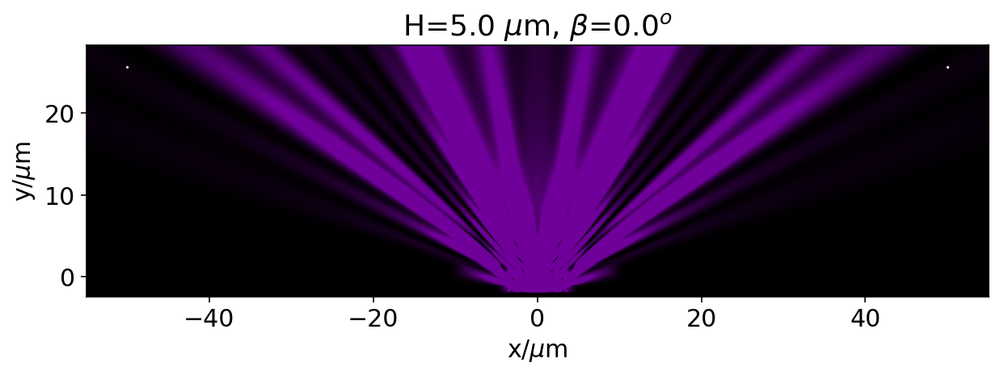

In [139]:
this_field = np.abs(metalens['farfields']['rho_em'])
vmin = np.percentile(this_field.flatten(),5)
vmax = np.percentile(this_field.flatten(),95)
plt.figure(figsize=(10,10))
plt.imshow(this_field,
          cmap=metalens['cmap'],
          origin='lower',
          vmin=vmin,
          vmax=vmax,
          extent=metalens['full_extent'])
plt.plot([-metalens['w'], metalens['w']],
         [metalens['detector_plane_coord']]*2,
         'wx',
         ms=1)
plt.xlim(-1.1*metalens['w'],1.1*metalens['w'])
plt.xlabel('x/$\mu$m')
plt.ylabel('y/$\mu$m')
plt.title(r'H={H:.1f} $\mu$m, $\beta$={beta:.1f}$^o$'.format(H=metalens['H'], beta=metalens['beta']))
plt.show()

## Parallelize farfield calcs

Using a pool with multiprocessing didn't help, the overheads are greater than the benefits.

### S4 - bootstrap

In [11]:
simulation_parameters = {
                        'wavelength': 0.400,
                        'post_width': 0.075,
                        'post_height': 0.800,
                        'cell_width': 0.25,
                        'epsilon': 5.8418,
                        'num_G' : 70,
                        'x_coord': 0,
                        'y_coord': 0,
                        'sim_id' : str(int(time.time())),
                        's_amp': 1, 'p_amp': 0}
simulation_parameters = expand_sim_params(simulation_parameters)

In [12]:
results = post_phase(simulation_parameters)

In [13]:
post_diameters = np.linspace(0.05,0.2,20)
phases = []
simulation_parameters['field_height'] = simulation_parameters['post_height']
for p_width in post_diameters:
    simulation_parameters['post_width'] = p_width
    simulation_parameters = expand_sim_params(simulation_parameters)
    results = post_phase(simulation_parameters)
    Exr = results[0]
    Eyr = results[1]
    Ezr = results[2]
    Exi = results[3]
    Eyi = results[4]
    Ezi = results[5] 
    phases.append(np.arctan2(Eyi, Eyr))
phases = np.array(phases)
phases = np.unwrap(phases)
phases = phases - phases[0]
critical_width = np.interp(2*np.pi*1.01,phases,post_diameters)
print(critical_width)

0.13839353236616211


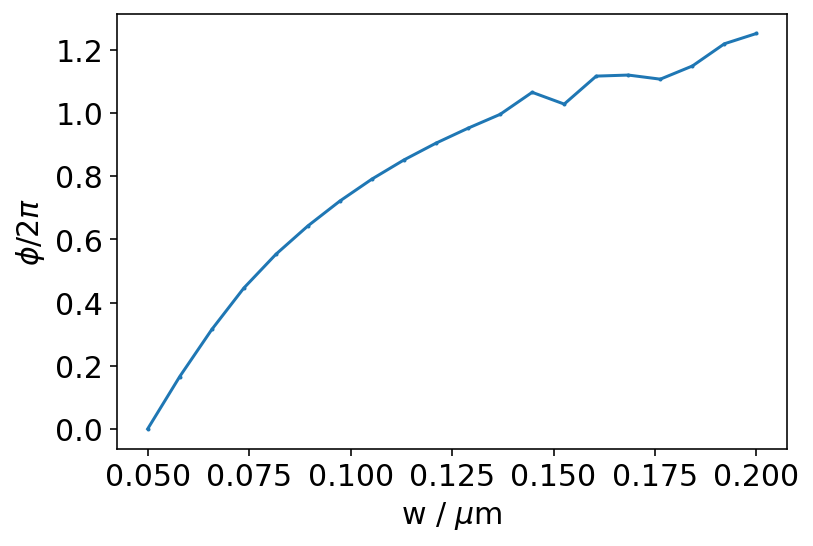

In [14]:
plt.rcParams.update({'font.size': 15})
plt.figure()
plt.plot(post_diameters,phases / (2*np.pi),'o-',ms=1.)
plt.xlabel('w / $\mu$m')
plt.ylabel('$\phi/2\pi$')
plt.show()

In [15]:
print(simulation_parameters['sim_id'])
pickle.dump({'post_diameters':post_diameters,'phases': phases,
             'simulation_parameters': simulation_parameters},
            open('carbon-phases-%s.pkl' % simulation_parameters['sim_id'],'wb'))

1587076910


In [16]:
sim_fname =  '/Users/juan/Google Drive/Zia Lab/CEM/MEEP/carbon-phases-%s.pkl' % simulation_parameters['sim_id']
post_diameters = pickle.load(open(sim_fname,'rb'))['post_diameters']
phases = pickle.load(open(sim_fname,'rb'))['phases']
simulation_parameters = pickle.load(open(sim_fname,'rb'))['simulation_parameters']

In [18]:
metalens = {
    'post_height':simulation_parameters['post_height'],
    'R': 25,
    'd': 50.,
    's': 0.0,
    'H': 10., # depth of emitter
    'gap_h': 1.0,
    'gap_v': 0.,
    'b': 2.0, # distance between source and interface
    'w': 50.,
    'unit_cell_size': simulation_parameters['cell_width'],
    'epsilon': simulation_parameters['epsilon'],
    'phases': phases,
    'widths': post_diameters,
    'wavelength': simulation_parameters['wavelength'],
    'min_width': 0.05,
    'pml_width': 1.0,
    'resolution': 40.,
    'sim_id': str(int(time.time())), #simulation_parameters['sim_id'],
    'simulation_parameters' : simulation_parameters,
    'complex_fields' : True,
    'save_output': False,
    'x_mirror_symmetry': False,
    'quiet': True,
    'freq_multiplier': 3, # must be an odd integer
    'log_to_pkl': [True,''],
    'NAf': 0.5,
    'beta': 0.
    }

In [19]:
pickle.dump(metalens,open('/Users/juan/Temp/protometalens.pkl','wb'))

In [17]:
metalens = {
    'post_height':simulation_parameters['post_height'],
    'R': 25,
    'd': 50.,
    's': 0.0,
    'H': 10., # depth of emitter
    'gap_h': 1.0,
    'gap_v': 0.,
    'b': 2.0, # distance between source and interface
    'w': 50.,
    'unit_cell_size': simulation_parameters['cell_width'],
    'epsilon': simulation_parameters['epsilon'],
    'phases': phases,
    'widths': post_diameters,
    'wavelength': simulation_parameters['wavelength'],
    'min_width': 0.05,
    'pml_width': 1.0,
    'resolution': 40.,
    'sim_id': str(int(time.time())), #simulation_parameters['sim_id'],
    'simulation_parameters' : simulation_parameters,
    'complex_fields' : True,
    'save_output': False,
    'x_mirror_symmetry': False,
    'quiet': True,
    'freq_multiplier': 3, # must be an odd integer
    'log_to_pkl': [True,''],
    'NAf': 0.5,
    'beta': 0.
    }
if 'NAf' in metalens.keys():
    metalens['n'] = np.sqrt(metalens['epsilon'])
    metalens['Ω'] = (metalens['wavelength']/2/metalens['unit_cell_size']
                     + metalens['NAf']) / metalens['n']
    metalens['R'] = metalens['H']*metalens['Ω']/np.sqrt(1-metalens['Ω']**2)
    metalens['zeta'] = np.arcsin(metalens['NAf'])
    metalens['d'] = np.tan(metalens['zeta']) * (metalens['w']-metalens['R'])
metalens = aux_params(metalens)
metalens = make_metalens_geometry(metalens)
metalens['incident_flux'] = get_flux_on_metalens(metalens)
metalens = simulate_metalens(metalens)

KeyboardInterrupt: 

In [ ]:
%load_ext line_profiler

In [29]:
%lprun -f compute_post_simulation_params compute_post_simulation_params(metalens)

Computing the farfield for Ex...
Computing the farfield for Ey...
Computing the farfield for Hz...
Computing the farfield for rho_em...
Patching the entire field for Ex...
Patching the entire field for Ey...
Patching the entire field for Hz...
Patching the entire field for rho_em...


In [26]:
metalens = compute_post_simulation_params(metalens)

Computing the farfield for Ex...
Computing the farfield for Ey...
Computing the farfield for Hz...
Computing the farfield for rho_em...
Patching the entire field for Ex...
Patching the entire field for Ey...
Patching the entire field for Hz...
Patching the entire field for rho_em...


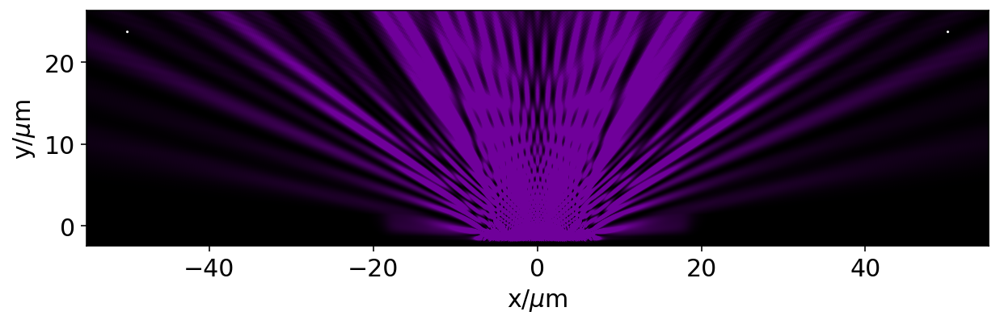

In [25]:
this_field = np.abs(metalens['farfields']['rho_em'])
vmin = np.percentile(this_field.flatten(),5)
vmax = np.percentile(this_field.flatten(),95)
plt.figure(figsize=(10,3))
plt.imshow(this_field,
          cmap=metalens['cmap'],
          origin='lower',
          vmin=vmin,
          vmax=vmax,
          extent=metalens['full_extent'])
plt.plot([-metalens['w'], metalens['w']],
         [metalens['detector_plane_coord']]*2,
         'wx',
         ms=1)
plt.xlim(-1.1*metalens['w'],1.1*metalens['w'])
plt.xlabel('x/$\mu$m')
plt.ylabel('y/$\mu$m')
# #plt.savefig('/Users/juan/Temp/oblique-norm2-%d.png' % index,
#            dpi=200)
plt.show()

## rotator-dipole

### S4 - bootstrap

In [223]:
simulation_parameters = {
                        'wavelength': 0.400,
                        'post_width': 0.075,
                        'post_height': 0.800,
                        'cell_width': 0.25,
                        'epsilon': 5.8418,
                        'num_G' : 70,
                        'x_coord': 0,
                        'y_coord': 0,
                        'sim_id' : str(int(time())),
                        's_amp': 1, 'p_amp': 0}
simulation_parameters = expand_sim_params(simulation_parameters)

KeyError: 'post_diameter'

In [193]:
results = post_phase(simulation_parameters)

In [194]:
post_diameters = np.linspace(0.05,0.2,20)
phases = []
simulation_parameters['field_height'] = simulation_parameters['post_height']
for p_width in post_diameters:
    simulation_parameters['post_width'] = p_width
    simulation_parameters = expand_sim_params(simulation_parameters)
    results = post_phase(simulation_parameters)
    Exr = results[0]
    Eyr = results[1]
    Ezr = results[2]
    Exi = results[3]
    Eyi = results[4]
    Ezi = results[5] 
    phases.append(np.arctan2(Eyi, Eyr))
phases = np.array(phases)
phases = np.unwrap(phases)
phases = phases - phases[0]
critical_width = np.interp(2*np.pi*1.01,phases,post_diameters)
print(critical_width)

0.13839353236616211


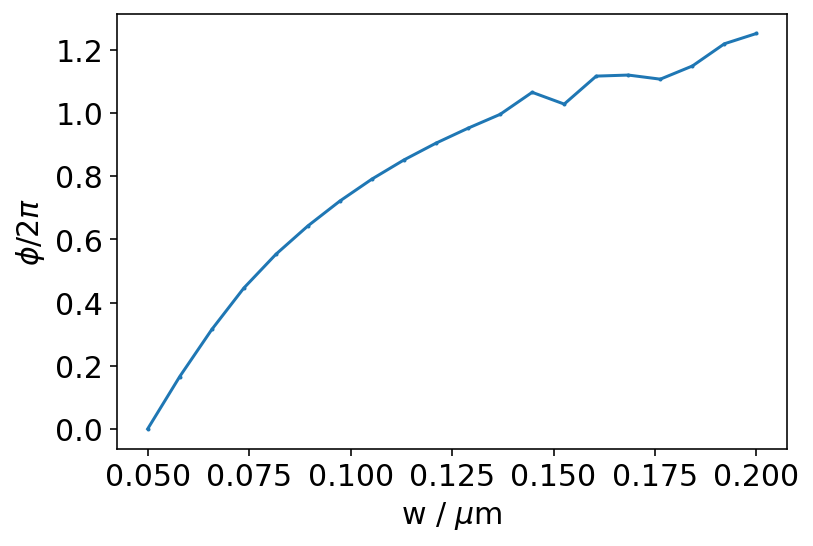

In [195]:
plt.rcParams.update({'font.size': 15})
plt.figure()
plt.plot(post_diameters,phases / (2*np.pi),'o-',ms=1.)
plt.xlabel('w / $\mu$m')
plt.ylabel('$\phi/2\pi$')
plt.show()

In [196]:
print(simulation_parameters['sim_id'])
pickle.dump({'post_diameters':post_diameters,'phases': phases,
             'simulation_parameters': simulation_parameters},
            open('carbon-phases-%s.pkl' % simulation_parameters['sim_id'],'wb'))

1586985664


### MEEP - run

In [197]:
sim_fname =  '/Users/juan/Google Drive/Zia Lab/CEM/MEEP/carbon-phases-%s.pkl' % simulation_parameters['sim_id']
post_diameters = pickle.load(open(sim_fname,'rb'))['post_diameters']
phases = pickle.load(open(sim_fname,'rb'))['phases']
simulation_parameters = pickle.load(open(sim_fname,'rb'))['simulation_parameters']

In [201]:
betas = np.linspace(0,np.pi,36)
metalenses = {}
s_time = int(time.time())
for beta_index, beta in enumerate(betas):
    print('%d - %f min' % (beta_index, int(time.time()-s_time)/60.))
    metalens = {
        'post_height':simulation_parameters['post_height'],
        'R': 25,
        'd': 50.,
        's': 0.0,
        'H': 10., # depth of emitter
        'gap_h': 1.0,
        'gap_v': 0.,
        'b': 2.0, # distance between source and interface
        'w': 50.,
        'unit cell size': simulation_parameters['cell_width'],
        'epsilon': simulation_parameters['epsilon'],
        'phases': phases,
        'widths': post_diameters,
        'wavelength': simulation_parameters['wavelength'],
        'min_width': 0.05,
        'pml_width': 1.0,
        'resolution': 40.,
        'sim_id': str(int(time.time())), #simulation_parameters['sim_id'],
        'simulation_parameters' : simulation_parameters,
        'complex_fields' : True,
        'save_output': False,
        'x_mirror_symmetry': False,
        'quiet': True,
        'freq_multiplier': 3, # must be an odd integer
        'log_to_pkl': [True,''],
        'NAf': 0.5,
        'beta': beta
        }
    if 'NAf' in metalens.keys():
        metalens['n'] = np.sqrt(metalens['epsilon'])
        metalens['Ω'] = (metalens['wavelength']/2/metalens['unit cell size']
                         + metalens['NAf']) / metalens['n']
        metalens['R'] = metalens['H']*metalens['Ω']/np.sqrt(1-metalens['Ω']**2)
        metalens['zeta'] = np.arcsin(metalens['NAf'])
        metalens['d'] = np.tan(metalens['zeta']) * (metalens['w']-metalens['R'])
    metalens = aux_params(metalens)
    metalens = make_metalens_geometry(metalens)
    metalens['incident_flux'] = get_flux_on_metalens(metalens)
    metalens = simulate_metalens(metalens)
    metalenses[beta] = metalens

0 - 0.000000 min
/Users/juan/Google Drive/Zia Lab/Log/Data/metalens-1586986169.pkl
1 - 0.800000 min
/Users/juan/Google Drive/Zia Lab/Log/Data/metalens-1586986217.pkl
2 - 1.633333 min
/Users/juan/Google Drive/Zia Lab/Log/Data/metalens-1586986267.pkl
3 - 2.433333 min
/Users/juan/Google Drive/Zia Lab/Log/Data/metalens-1586986315.pkl
4 - 3.233333 min
/Users/juan/Google Drive/Zia Lab/Log/Data/metalens-1586986363.pkl
5 - 4.050000 min
/Users/juan/Google Drive/Zia Lab/Log/Data/metalens-1586986412.pkl
6 - 4.833333 min
/Users/juan/Google Drive/Zia Lab/Log/Data/metalens-1586986459.pkl
7 - 5.666667 min
/Users/juan/Google Drive/Zia Lab/Log/Data/metalens-1586986509.pkl
8 - 6.466667 min
/Users/juan/Google Drive/Zia Lab/Log/Data/metalens-1586986557.pkl
9 - 7.266667 min
/Users/juan/Google Drive/Zia Lab/Log/Data/metalens-1586986605.pkl
10 - 8.066667 min
/Users/juan/Google Drive/Zia Lab/Log/Data/metalens-1586986653.pkl
11 - 8.883333 min
/Users/juan/Google Drive/Zia Lab/Log/Data/metalens-1586986702.pkl
12

In [211]:
# pickle.dump(ids,open('/Users/juan/Google Drive/Zia Lab/Log/Data/metalens-oblique-ids.pkl','wb'))
# pickle.dump(metalenses,open('/Users/juan/Google Drive/Zia Lab/Log/Data/metalens-oblique.pkl','wb'))

In [212]:
# ids = [metalenses[metalens_id]['sim_id'] for metalens_id in metalenses]

In [2]:
metalens_ids = pickle.load(open('/Users/juan/Google Drive/Zia Lab/Log/Data/metalens-oblique-ids.pkl','rb'))

In [4]:
good_bits = {}
for metalens_id in metalens_ids:
    print(metalens_id)
    metalens = pickle.load(open('/Users/juan/Google Drive/Zia Lab/Log/Data/metalens-%s.pkl' % metalens_id,'rb'))
    metalens = compute_post_simulation_params(metalens)
    print_out_lines = {}
    non_printable = [list, np.ndarray, dict]
    for k in metalens:
        thing = metalens[k]
        thing_type = type(thing)
        if thing_type in non_printable:
            continue
        if thing_type in [int, np.int64]:
            thing_parsed = "%d" % thing
        if thing_type == bool:
            thing_parsed = "%s" % thing
        if thing_type in [float, np.float64]:
            thing_parsed = "%.2f" % thing
        if thing_type == str:
            thing_parsed = thing
        print_out_lines[k] = thing_parsed
    good_bits[metalens_id] = print_out_lines

1586986169
Computing the farfield for Ex...
Computing the farfield for Ey...
Computing the farfield for Hz...
Patching the entire field for Ex...
Patching the entire field for Ey...
Patching the entire field for Hz...
Patching the entire field for rho_em...
1586986217
Computing the farfield for Ex...
Computing the farfield for Ey...
Computing the farfield for Hz...
Patching the entire field for Ex...
Patching the entire field for Ey...
Patching the entire field for Hz...
Patching the entire field for rho_em...
1586986267
Computing the farfield for Ex...
Computing the farfield for Ey...
Computing the farfield for Hz...
Patching the entire field for Ex...
Patching the entire field for Ey...
Patching the entire field for Hz...
Patching the entire field for rho_em...
1586986315
Computing the farfield for Ex...
Computing the farfield for Ey...
Computing the farfield for Hz...
Patching the entire field for Ex...
Patching the entire field for Ey...
Patching the entire field for Hz...
Patching

1586987748
Computing the farfield for Ex...
Computing the farfield for Ey...
Computing the farfield for Hz...
Patching the entire field for Ex...
Patching the entire field for Ey...
Patching the entire field for Hz...
Patching the entire field for rho_em...
1586987798
Computing the farfield for Ex...
Computing the farfield for Ey...
Computing the farfield for Hz...
Patching the entire field for Ex...
Patching the entire field for Ey...
Patching the entire field for Hz...
Patching the entire field for rho_em...
1586987846
Computing the farfield for Ex...
Computing the farfield for Ey...
Computing the farfield for Hz...
Patching the entire field for Ex...
Patching the entire field for Ey...
Patching the entire field for Hz...
Patching the entire field for rho_em...
1586987895
Computing the farfield for Ex...
Computing the farfield for Ey...
Computing the farfield for Hz...
Patching the entire field for Ex...
Patching the entire field for Ey...
Patching the entire field for Hz...
Patching

In [44]:
angles = [float(good_bits[thing_id]['beta']) for thing_id in good_bits]
tflux = [float(good_bits[thing_id]['flux_through_target']) for thing_id in good_bits]
iflux = [float(good_bits[thing_id]['incident_flux']) for thing_id in good_bits]
fflux = [float(good_bits[thing_id]['full_flux']) for thing_id in good_bits]
chi = [float(good_bits[thing_id]['chi']) for thing_id in good_bits][0]
angles = np.array(angles)
efficiencies = np.array(efficiencies)

In [55]:
from scipy.optimize import curve_fit

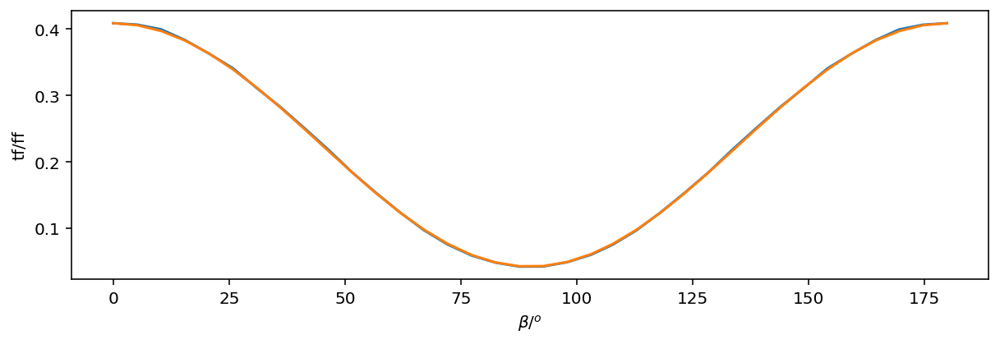

In [63]:
full_flux = iflux/(2*(chi+np.cos(2*angles)*np.cos(chi)*np.sin(chi))/np.pi)
plt.figure(figsize=(10,3))
t0 = (tflux/full_flux)[0]
th = (tflux/full_flux)[np.argmin(np.abs(angles-np.pi/2))]
plt.plot(angles*180/np.pi, tflux/full_flux)
plt.plot(angles*180/np.pi, th+(t0-th)*np.cos(angles)**2)
# plt.plot(angles*180/np.pi, iflux)
#plt.plot(angles*180/np.pi, fflux)
# plt.plot(angles*180/np.pi, )
plt.xlabel(r'$\beta/{}^o$')
plt.ylabel('tf/ff')
plt.show()

In [72]:
angles

array([0.  , 0.09, 0.18, 0.27, 0.36, 0.45, 0.54, 0.63, 0.72, 0.81, 0.9 ,
       0.99, 1.08, 1.17, 1.26, 1.35, 1.44, 1.53, 1.62, 1.71, 1.8 , 1.88,
       1.97, 2.06, 2.15, 2.24, 2.33, 2.42, 2.51, 2.6 , 2.69, 2.78, 2.87,
       2.96, 3.05, 3.14])

In [71]:
t0-th

0.366609292578102

In [75]:
vmin = None
vmax = None
for index, metalens_id in enumerate(metalens_ids):
    print(metalens_id)
    metalens = pickle.load(open('/Users/juan/Google Drive/Zia Lab/Log/Data/metalens-%s.pkl' % metalens_id,'rb'))
    metalens = compute_post_simulation_params(metalens)
    this_field = np.abs(metalens['farfields']['rho_em'])
    if vmin == None:
        vmin = np.percentile(this_field.flatten(),5)
        vmax = np.percentile(this_field.flatten(),95)
    plt.figure(figsize=(10,3))
    plt.imshow(this_field,
              cmap=metalens['cmap'],
              origin='lower',
              vmin=vmin,
              vmax=vmax,
              extent=metalens['full_extent'])
    plt.plot([-metalens['w'], metalens['w']],
             [metalens['detector_plane_coordinate']]*2,
             'wx',
             ms=1)
    plt.xlim(-1.1*metalens['w'],1.1*metalens['w'])
    plt.xlabel('x/$\mu$m')
    plt.ylabel('y/$\mu$m')
    plt.savefig('/Users/juan/Temp/oblique-norm2-%d.png' % index,
               dpi=200)
    plt.close()

1586986169
Computing the farfield for Ex...
Computing the farfield for Ey...
Computing the farfield for Hz...
Patching the entire field for Ex...
Patching the entire field for Ey...
Patching the entire field for Hz...
Patching the entire field for rho_em...
1586986217
Computing the farfield for Ex...
Computing the farfield for Ey...
Computing the farfield for Hz...
Patching the entire field for Ex...
Patching the entire field for Ey...
Patching the entire field for Hz...
Patching the entire field for rho_em...
1586986267
Computing the farfield for Ex...
Computing the farfield for Ey...
Computing the farfield for Hz...
Patching the entire field for Ex...
Patching the entire field for Ey...
Patching the entire field for Hz...
Patching the entire field for rho_em...
1586986315
Computing the farfield for Ex...
Computing the farfield for Ey...
Computing the farfield for Hz...
Patching the entire field for Ex...
Patching the entire field for Ey...
Patching the entire field for Hz...
Patching

1586987748
Computing the farfield for Ex...
Computing the farfield for Ey...
Computing the farfield for Hz...
Patching the entire field for Ex...
Patching the entire field for Ey...
Patching the entire field for Hz...
Patching the entire field for rho_em...
1586987798
Computing the farfield for Ex...
Computing the farfield for Ey...
Computing the farfield for Hz...
Patching the entire field for Ex...
Patching the entire field for Ey...
Patching the entire field for Hz...
Patching the entire field for rho_em...
1586987846
Computing the farfield for Ex...
Computing the farfield for Ey...
Computing the farfield for Hz...
Patching the entire field for Ex...
Patching the entire field for Ey...
Patching the entire field for Hz...
Patching the entire field for rho_em...
1586987895
Computing the farfield for Ex...
Computing the farfield for Ey...
Computing the farfield for Hz...
Patching the entire field for Ex...
Patching the entire field for Ey...
Patching the entire field for Hz...
Patching

Computing the farfield for Ex...
Computing the farfield for Ey...
Computing the farfield for Hz...
Patching the entire field for Ex...
Patching the entire field for Ey...
Patching the entire field for Hz...
Patching the entire field for rho_em...


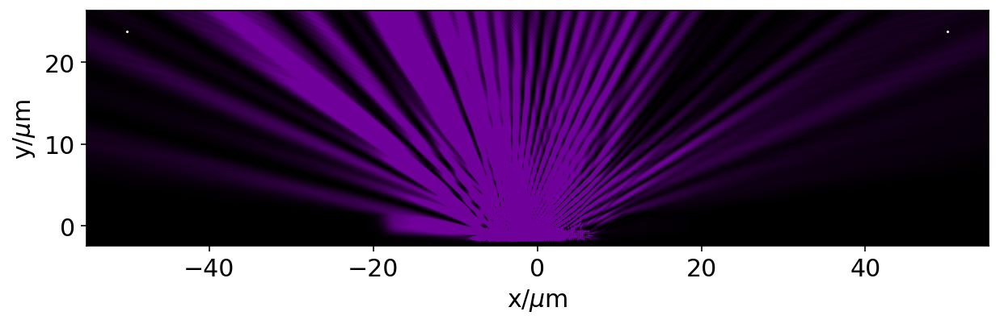

In [217]:
metalens = metalenses[list(metalenses.keys())[10]]
metalens = compute_post_simulation_params(metalens)
this_field = np.abs(metalens['farfields']['rho_em'])
vmin = np.percentile(this_field.flatten(),5)
vmax = np.percentile(this_field.flatten(),95)
plt.figure(figsize=(10,10))
plt.imshow(this_field,
          cmap=metalens['cmap'],
          origin='lower',
          vmin=vmin,
          vmax=vmax,
          extent=metalens['full_extent'])
plt.plot([-metalens['w'], metalens['w']],
         [metalens['detector_plane_coordinate']]*2,
         'wx',
         ms=1)
plt.xlim(-1.1*metalens['w'],1.1*metalens['w'])
plt.xlabel('x/$\mu$m')
plt.ylabel('y/$\mu$m')
plt.show()

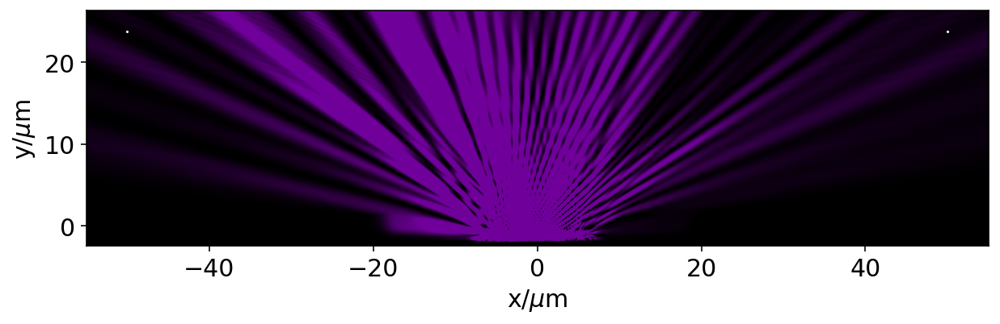

In [190]:
this_field = np.abs(metalens['farfields']['rho_em'])
vmin = np.percentile(this_field.flatten(),5)
vmax = np.percentile(this_field.flatten(),95)
plt.figure(figsize=(10,10))
plt.imshow(this_field,
          cmap=metalens['cmap'],
          origin='lower',
          vmin=vmin,
          vmax=vmax,
          extent=metalens['full_extent'])
plt.plot([-metalens['w'], metalens['w']],
         [metalens['detector_plane_coordinate']]*2,
         'wx',
         ms=1)
plt.xlim(-1.1*metalens['w'],1.1*metalens['w'])
plt.xlabel('x/$\mu$m')
plt.ylabel('y/$\mu$m')
plt.show()

In [191]:
print_params(metalens)

-----------------------------  -----------------------
post_height                    0.80
R                              6.38
d                              25.18
s                              0.00
H                              10.00
gap_h                          1.00
gap_v                          0.00
b                              2.00
w                              50.00
unit cell size                 0.25
epsilon                        5.84
wavelength                     0.40
min_width                      0.05
pml_width                      1.00
resolution                     40.00
sim_id                         1586985544
complex_fields                 True
save_output                    False
x_mirror_symmetry              False
quiet                          True
freq_multiplier                3
NAf                            0.50
beta                           0.79
n                              2.42
Ω                              0.54
zeta                           1.14


## y-dipole

### S4 - bootstrap

In [172]:
simulation_parameters = {
                        'wavelength': 0.400,
                        'post_width': 0.075,
                        'post_height': 0.800,
                        'cell_width': 0.25,
                        'epsilon': 5.8418,
                        'num_G' : 70,
                        'x_coord': 0,
                        'y_coord': 0,
                        'sim_id' : str(int(time.time())),
                        's_amp': 1, 'p_amp': 0}
simulation_parameters = expand_sim_params(simulation_parameters)

In [173]:
results = post_phase(simulation_parameters)

In [174]:
post_diameters = np.linspace(0.05,0.2,20)
phases = []
simulation_parameters['field_height'] = simulation_parameters['post_height']
for p_width in post_diameters:
    simulation_parameters['post_width'] = p_width
    simulation_parameters = expand_sim_params(simulation_parameters)
    results = post_phase(simulation_parameters)
    Exr = results[0]
    Eyr = results[1]
    Ezr = results[2]
    Exi = results[3]
    Eyi = results[4]
    Ezi = results[5] 
    phases.append(np.arctan2(Eyi, Eyr))
phases = np.array(phases)
phases = np.unwrap(phases)
phases = phases - phases[0]
critical_width = np.interp(2*np.pi*1.01,phases,post_diameters)
print(critical_width)

0.13839353236616211


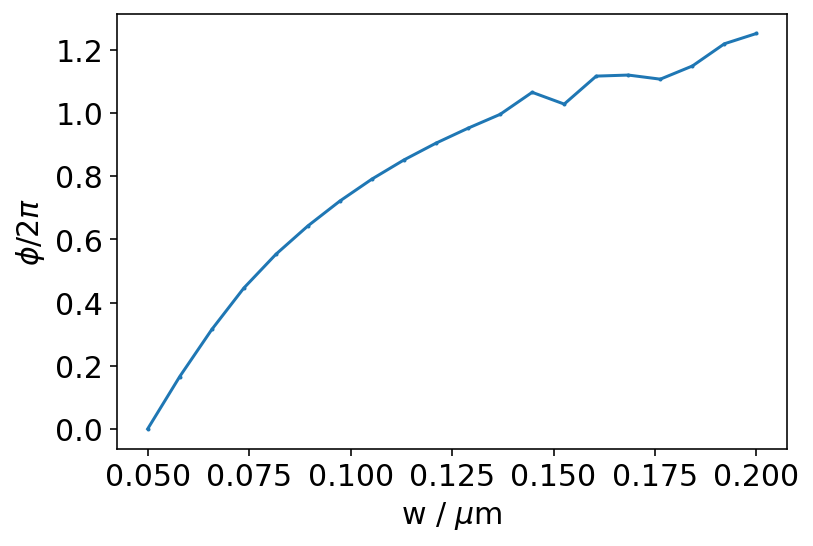

In [175]:
plt.rcParams.update({'font.size': 15})
plt.figure()
plt.plot(post_diameters,phases / (2*np.pi),'o-',ms=1.)
plt.xlabel('w / $\mu$m')
plt.ylabel('$\phi/2\pi$')
plt.show()

In [176]:
print(simulation_parameters['sim_id'])
pickle.dump({'post_diameters':post_diameters,'phases': phases,
             'simulation_parameters': simulation_parameters},
            open('carbon-phases-%s.pkl' % simulation_parameters['sim_id'],'wb'))

1586985326


### MEEP - run

In [177]:
sim_fname =  '/Users/juan/Google Drive/Zia Lab/CEM/MEEP/carbon-phases-%s.pkl' % simulation_parameters['sim_id']
post_diameters = pickle.load(open(sim_fname,'rb'))['post_diameters']
phases = pickle.load(open(sim_fname,'rb'))['phases']
simulation_parameters = pickle.load(open(sim_fname,'rb'))['simulation_parameters']

In [178]:
metalens = {
    'post_height':simulation_parameters['post_height'],
    'R': 25,
    'd': 50.,
    's': 0.0,
    'H': 10., # depth of emitter
    'gap_h': 1.0,
    'gap_v': 0.,
    'b': 2.0, # distance between source and interface
    'w': 50.,
    'unit cell size': simulation_parameters['cell_width'],
    'epsilon': simulation_parameters['epsilon'],
    'phases': phases,
    'widths': post_diameters,
    'wavelength': simulation_parameters['wavelength'],
    'min_width': 0.05,
    'pml_width': 1.0,
    'resolution': 40.,
    'sim_id': str(int(time.time())), #simulation_parameters['sim_id'],
    'simulation_parameters' : simulation_parameters,
    'complex_fields' : True,
    'save_output': False,
    'x_mirror_symmetry': True,
    'quiet': True,
    'freq_multiplier': 3, # must be an odd integer
    'log_to_pkl': [True,''],
    'NAf': 0.5,
    'beta': np.pi/2
    }
if 'NAf' in metalens.keys():
    metalens['n'] = np.sqrt(metalens['epsilon'])
    metalens['Ω'] = (metalens['wavelength']/2/metalens['unit cell size']
                     + metalens['NAf']) / metalens['n']
    metalens['R'] = metalens['H']*metalens['Ω']/np.sqrt(1-metalens['Ω']**2)
    metalens['zeta'] = np.arcsin(metalens['NAf'])
    metalens['d'] = np.tan(metalens['zeta']) * (metalens['w']-metalens['R'])
metalens = aux_params(metalens)
metalens = make_metalens_geometry(metalens)
metalens['incident_flux'] = get_flux_on_metalens(metalens)
metalens = simulate_metalens(metalens)

/Users/juan/Google Drive/Zia Lab/Log/Data/metalens-1586985334.pkl


In [179]:
metalens = compute_post_simulation_params(metalens)

Computing the farfield for Ex...
Computing the farfield for Ey...
Computing the farfield for Hz...
Patching the entire field for Ex...
Patching the entire field for Ey...
Patching the entire field for Hz...
Patching the entire field for rho_em...


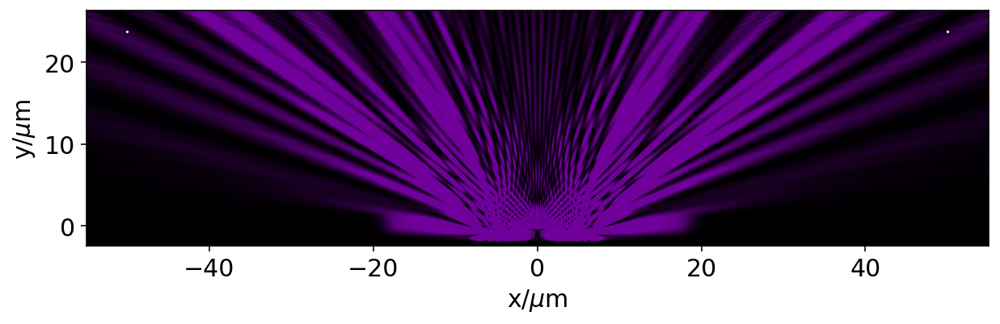

In [180]:
this_field = np.abs(metalens['farfields']['rho_em'])
vmin = np.percentile(this_field.flatten(),5)
vmax = np.percentile(this_field.flatten(),95)
plt.figure(figsize=(10,10))
plt.imshow(this_field,
          cmap=metalens['cmap'],
          origin='lower',
          vmin=vmin,
          vmax=vmax,
          extent=metalens['full_extent'])
plt.plot([-metalens['w'], metalens['w']],
         [metalens['detector_plane_coordinate']]*2,
         'wx',
         ms=1)
plt.xlim(-1.1*metalens['w'],1.1*metalens['w'])
plt.xlabel('x/$\mu$m')
plt.ylabel('y/$\mu$m')
plt.show()

In [181]:
print_params(metalens)

-----------------------------  -----------------------
post_height                    0.80
R                              6.38
d                              25.18
s                              0.00
H                              10.00
gap_h                          1.00
gap_v                          0.00
b                              2.00
w                              50.00
unit cell size                 0.25
epsilon                        5.84
wavelength                     0.40
min_width                      0.05
pml_width                      1.00
resolution                     40.00
sim_id                         1586985334
complex_fields                 True
save_output                    False
x_mirror_symmetry              True
quiet                          True
freq_multiplier                3
NAf                            0.50
beta                           1.57
n                              2.42
Ω                              0.54
zeta                           1.14
a

## x-dipole

### S4 - bootstrap

In [162]:
simulation_parameters = {
                        'wavelength': 0.400,
                        'post_width': 0.075,
                        'post_height': 0.800,
                        'cell_width': 0.25,
                        'epsilon': 5.8418,
                        'num_G' : 70,
                        'x_coord': 0,
                        'y_coord': 0,
                        'sim_id' : str(int(time.time())),
                        's_amp': 1, 'p_amp': 0}
simulation_parameters = expand_sim_params(simulation_parameters)

In [163]:
results = post_phase(simulation_parameters)

In [164]:
post_diameters = np.linspace(0.05,0.2,20)
phases = []
simulation_parameters['field_height'] = simulation_parameters['post_height']
for p_width in post_diameters:
    simulation_parameters['post_width'] = p_width
    simulation_parameters = expand_sim_params(simulation_parameters)
    results = post_phase(simulation_parameters)
    Exr = results[0]
    Eyr = results[1]
    Ezr = results[2]
    Exi = results[3]
    Eyi = results[4]
    Ezi = results[5] 
    phases.append(np.arctan2(Eyi, Eyr))
phases = np.array(phases)
phases = np.unwrap(phases)
phases = phases - phases[0]
critical_width = np.interp(2*np.pi*1.01,phases,post_diameters)
print(critical_width)

0.13839353236616211


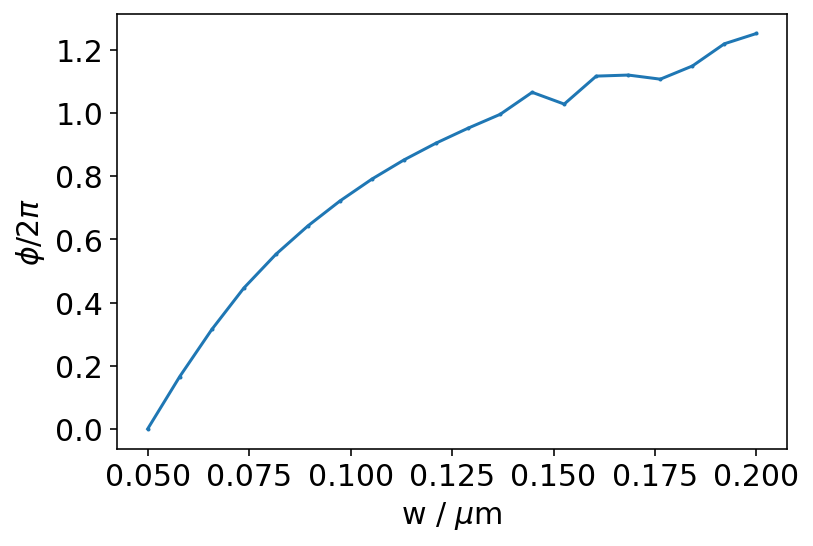

In [165]:
plt.rcParams.update({'font.size': 15})
plt.figure()
plt.plot(post_diameters,phases / (2*np.pi),'o-',ms=1.)
plt.xlabel('w / $\mu$m')
plt.ylabel('$\phi/2\pi$')
plt.show()

In [166]:
print(simulation_parameters['sim_id'])
pickle.dump({'post_diameters':post_diameters,'phases': phases,
             'simulation_parameters': simulation_parameters},
            open('carbon-phases-%s.pkl' % simulation_parameters['sim_id'],'wb'))

1586983539


### MEEP - run

In [167]:
sim_fname =  '/Users/juan/Google Drive/Zia Lab/CEM/MEEP/carbon-phases-%s.pkl' % simulation_parameters['sim_id']
post_diameters = pickle.load(open(sim_fname,'rb'))['post_diameters']
phases = pickle.load(open(sim_fname,'rb'))['phases']
simulation_parameters = pickle.load(open(sim_fname,'rb'))['simulation_parameters']

In [168]:
metalens = {
    'post_height':simulation_parameters['post_height'],
    'R': 25,
    'd': 50.,
    's': 0.0,
    'H': 10, # depth of emitter
    'gap_h': 1.0,
    'gap_v': 0.,
    'b': 2.0, # distance between source and interface
    'w': 50.,
    'unit cell size': simulation_parameters['cell_width'],
    'epsilon': simulation_parameters['epsilon'],
    'phases': phases,
    'widths': post_diameters,
    'wavelength': simulation_parameters['wavelength'],
    'min_width': 0.05,
    'pml_width': 1.0,
    'resolution': 40.,
    'sim_id': str(int(time.time())), #simulation_parameters['sim_id'],
    'simulation_parameters' : simulation_parameters,
    'complex_fields' : True,
    'save_output': False,
    'x_mirror_symmetry': True,
    'quiet': True,
    'freq_multiplier': 3, # must be an odd integer
    'log_to_pkl': [True,''],
    'NAf': 0.5,
    'beta': 0.
    }
if 'NAf' in metalens.keys():
    metalens['n'] = np.sqrt(metalens['epsilon'])
    metalens['Ω'] = (metalens['wavelength']/2/metalens['unit cell size']
                     + metalens['NAf']) / metalens['n']
    metalens['R'] = metalens['H']*metalens['Ω']/np.sqrt(1-metalens['Ω']**2)
    metalens['zeta'] = np.arcsin(metalens['NAf'])
    metalens['d'] = np.tan(metalens['zeta']) * (metalens['w']-metalens['R'])
metalens = aux_params(metalens)
metalens = make_metalens_geometry(metalens)
metalens['incident_flux'] = get_flux_on_metalens(metalens)
metalens = simulate_metalens(metalens)

/Users/juan/Google Drive/Zia Lab/Log/Data/metalens-1586983548.pkl


In [169]:
metalens = compute_post_simulation_params(metalens)

Computing the farfield for Ex...
Computing the farfield for Ey...
Computing the farfield for Hz...
Patching the entire field for Ex...
Patching the entire field for Ey...
Patching the entire field for Hz...
Patching the entire field for rho_em...


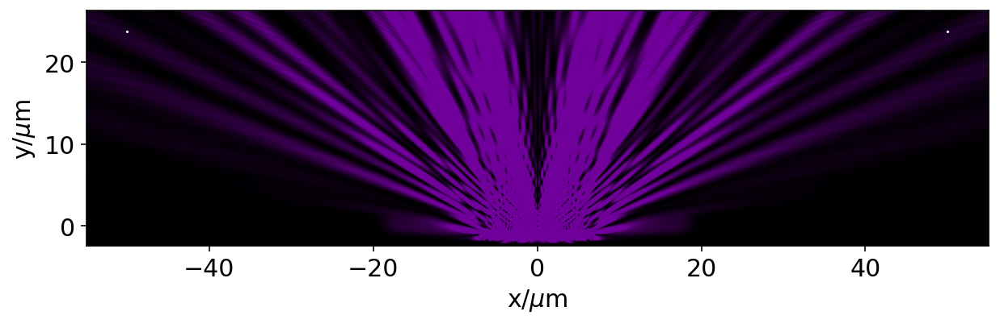

In [170]:
this_field = np.abs(metalens['farfields']['rho_em'])
vmin = np.percentile(this_field.flatten(),5)
vmax = np.percentile(this_field.flatten(),95)
plt.figure(figsize=(10,10))
plt.imshow(this_field,
          cmap=metalens['cmap'],
          origin='lower',
          vmin=vmin,
          vmax=vmax,
          extent=metalens['full_extent'])
plt.plot([-metalens['w'], metalens['w']],
         [metalens['detector_plane_coordinate']]*2,
         'wx',
         ms=1)
plt.xlim(-1.1*metalens['w'],1.1*metalens['w'])
plt.xlabel('x/$\mu$m')
plt.ylabel('y/$\mu$m')
plt.show()

In [171]:
print_params(metalens)

-----------------------------  -----------------------
post_height                    0.80
R                              6.38
d                              25.18
s                              0.00
H                              10
gap_h                          1.00
gap_v                          0.00
b                              2.00
w                              50.00
unit cell size                 0.25
epsilon                        5.84
wavelength                     0.40
min_width                      0.05
pml_width                      1.00
resolution                     40.00
sim_id                         1586983548
complex_fields                 True
save_output                    False
x_mirror_symmetry              True
quiet                          True
freq_multiplier                3
NAf                            0.50
beta                           0.00
n                              2.42
Ω                              0.54
zeta                           1.14
aper

# 2D dipoles equivalent currents

## In-plane dipole, the right way

In [5]:
def in_plane_dip_amp_func_Ex(metalens):
    '''
    returns the required amplitude function necessary to the z
    component of the electric current necessary to produce the fields
    of an in-plane dipole at an angle beta with respect to the
    x-axis
    '''
    def far_JEx(mpvec):
        '''
        remember that the vectors
        that MEEP will provide here
        are relative to the center of the source
        '''
        x = mpvec.x
        H, k, n = metalens['H'], metalens['k'], metalens['n']
        bet = metalens['beta']
        return k*n*(H*np.cos(bet) - x*np.sin(bet))*(2*k*np.sqrt(H**2 + x**2) - 1j)*np.exp(1j*k*np.sqrt(H**2 + x**2))/(2*(k*np.sqrt(H**2 + x**2))**(5/2))
    return far_JEx
def in_plane_dip_amp_func_Hz(metalens):
    '''
    returns the required amplitude function necessary to the z
    component of the magnetic current necessary to produce the fields
    of an in-plane dipole at an angle beta with respect to the
    x-axis
    '''
    def far_JHz(mpvec):
        '''
        remember that the vectors
        that MEEP will provide here
        are relative to the center of the source
        '''
        x = mpvec.x
        H, k, n = metalens['H'], metalens['k'], metalens['n']
        bet = metalens['beta']
        return -H*(H*np.cos(bet) - x*np.sin(bet))*np.exp(1j*k*np.sqrt(H**2 + x**2))/(np.sqrt(k*np.sqrt(H**2 + x**2))*(H**2 + x**2))
    return far_JHz

In [65]:
metalens = {
    'sim_cell_width': 30,
    'wavelength': 1.0,
    'sim_cell_height': 30,
    'pml_width': 1.,
    'source_width': 0.,
    'epsilon': 2.0,
    'complex_fields': True,
    'resolution': 30.,
    'quiet': False,
    'eta': 0.,
    'H': 3.,
    's': 0,
    'ws': 5,
    'beta': np.pi/2.
}
metalens['n'] = np.sqrt(metalens['epsilon'])
metalens['k'] = metalens['n']*2*np.pi/metalens['wavelength']
metalens['simulation_time'] = metalens['sim_cell_height']*metalens['n']/2*np.sqrt(2)
metalens['geometry'] = (
    [mp.Block(size = mp.Vector3(metalens['sim_cell_width'],
                                metalens['sim_cell_height']),
              center = mp.Vector3(0,0),
              material = mp.Medium(epsilon = metalens['epsilon']))])
# Setup the MEEP objects
cell = mp.Vector3(metalens['sim_cell_width'], metalens['sim_cell_height'])
# All around the simulation cell
pml_layers = [ mp.PML(metalens['pml_width']) ]
# Set up the sources
sources = [mp.Source(src=mp.ContinuousSource(
                     wavelength=metalens['wavelength'],
                     width=metalens['source_width']
                    ),
              component=mp.Ex,
              amp_func=in_plane_dip_amp_func_Ex(metalens),
              center=mp.Vector3(0, 0.),
              size=mp.Vector3(metalens['sim_cell_width'], 0)),
           mp.Source(src=mp.ContinuousSource(
                     wavelength=metalens['wavelength'],
                     width=metalens['source_width']
                    ),
              component=mp.Hz,
              amp_func=in_plane_dip_amp_func_Hz(metalens),
              center=mp.Vector3(0, 0.),
              size=mp.Vector3(metalens['sim_cell_width'], 0))
          ]
# Set up the symmetries
syms = []
sim = mp.Simulation(cell_size=cell,
            boundary_layers=pml_layers,
            geometry=metalens['geometry'],
            force_complex_fields=metalens['complex_fields'],
            symmetries=syms,
            sources=sources,
            resolution=metalens['resolution'])
start_time = time.time()
metalens['run_date'] = (datetime.
                        datetime.
                        now().
                        strftime("%b %d %Y at %H:%M:%S"))
mp.quiet(metalens['quiet'])
sim.init_sim()

# Branch if saving for making an animation
sim.run(until=metalens['simulation_time']) 

# Compute the clock run time and grab the fields
metalens['array_metadata'] = sim.get_array_metadata()
metalens['x_axis'] = np.array(metalens['array_metadata'][0])
metalens['y_axis'] = np.array(metalens['array_metadata'][1])
metalens['run_time_in_s'] = time.time() - start_time
metalens['fields'] = {'Ex': sim.get_array(component=mp.Ex).transpose(),
                      'Ey': sim.get_array(component=mp.Ey).transpose(),
                      'Ez': sim.get_array(component=mp.Ez).transpose(),
                      'Hx': sim.get_array(component=mp.Hx).transpose(),
                      'Hy': sim.get_array(component=mp.Hy).transpose(),
                      'Hz': sim.get_array(component=mp.Hz).transpose()
                      }
metalens['eps'] = sim.get_epsilon().transpose()
metalens['fields']['Sx'] = np.real(np.conjugate(metalens['fields']['Ey'])
                            * metalens['fields']['Hz']
                            - np.conjugate(metalens['fields']['Ez'])
                            * metalens['fields']['Hx'])
metalens['fields']['Sy'] = np.real(np.conjugate(metalens['fields']['Ez'])
                      * metalens['fields']['Hx']
                      -np.conjugate(metalens['fields']['Ex'])
                      * metalens['fields']['Hz'])
metalens['fields']['Sr'] = np.sqrt(metalens['fields']['Sx']**2+
                                  metalens['fields']['Sy']**2)
metalens['extent'] = [min(metalens['x_axis']),
                max(metalens['x_axis']),
                min(metalens['y_axis']),
                max(metalens['y_axis'])]

-----------
Initializing structure...
     block, center = (0,0,0)
          size (30,30,0)
          axes (1,0,0), (0,1,0), (0,0,1)
Meep: using complex fields.
Meep progress: 5.983333333333333/30.000000000000004 = 19.9% done in 4.0s, 16.1s to go
Meep progress: 10.816666666666666/30.000000000000004 = 36.1% done in 8.0s, 14.2s to go
Meep progress: 16.9/30.000000000000004 = 56.3% done in 12.0s, 9.3s to go
Meep progress: 22.966666666666665/30.000000000000004 = 76.6% done in 16.0s, 4.9s to go
Meep progress: 29.03333333333333/30.000000000000004 = 96.8% done in 20.0s, 0.7s to go
run 0 finished at t = 30.016666666666666 (1801 timesteps)


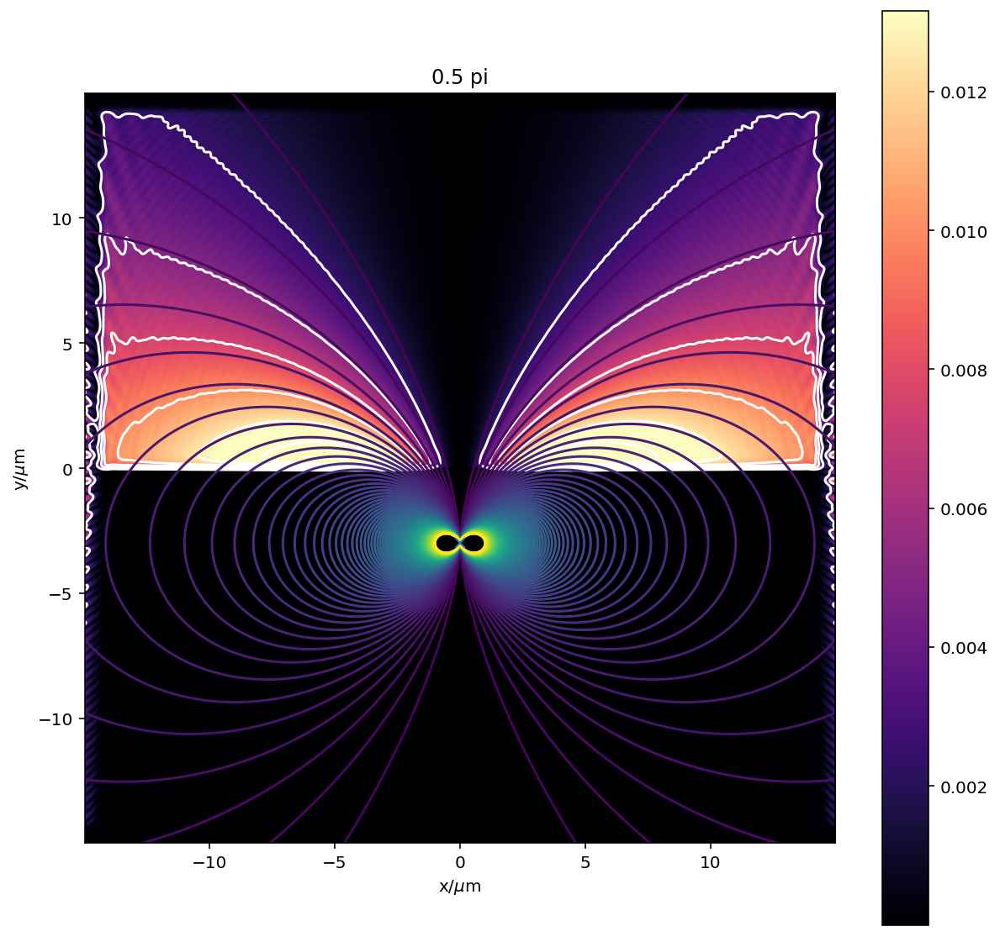

In [66]:
fig, ax = plt.subplots(figsize=(10,10))
this_field = np.real(np.copy(metalens['fields']['Sr']))
X, Y = np.meshgrid(metalens['x_axis'], metalens['y_axis'])
R = np.sqrt(X**2+(Y+metalens['H'])**2)
theta = np.arctan2(Y+metalens['H'],X)
dipole = np.sin(theta-metalens['beta'])**2/R
# dipole[Y<0] = np.nan

vmin = np.percentile(this_field.flatten(),5)
vmax = np.percentile(this_field.flatten(),98)
im = ax.imshow(this_field,
          origin='lower',
          cmap='magma',
          norm=Normalize(vmin=vmin, vmax=vmax),
         extent=metalens['extent'])
ax.contour(gaussian_filter(this_field,3),
           extent=metalens['extent'],
           levels=np.linspace(0,0.25,100),
           colors='white'
          )
ax.contour(dipole,
           extent=metalens['extent'],
           levels=np.linspace(0,1,100)
          )
ax.set_xlabel('x/$\mu$m')
ax.set_ylabel('y/$\mu$m')
# ax.plot([*metalens['extent'][:2]],[metalens['H']]*2,'w--')
ax.plot([0],[-metalens['H']],'x')
fig.colorbar(im)
ax.set_title('{beta} pi'.format(beta=metalens['beta']/np.pi))
plt.show()

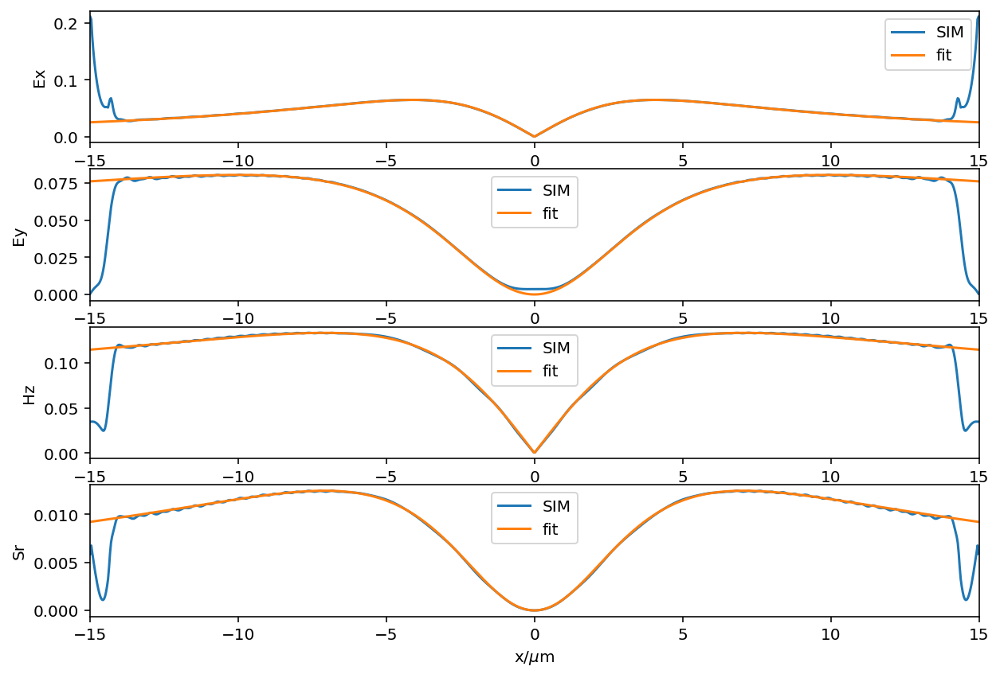

In [67]:
s = 2
middle_index = np.argmin(np.abs(metalens['y_axis']-s))
r = np.sqrt((metalens['H']+s)**2 + metalens['x_axis']**2)
angs = np.arctan2(metalens['H']+s,metalens['x_axis'])

fields = ['Ex','Ey','Hz','Sr']
fig, axes = plt.subplots(nrows=len(fields),figsize=(10,7))
powwow = 0.5

for field, axis in zip(fields, axes):
    simField = np.abs(metalens['fields'][field][middle_index])
    axis.plot(metalens['x_axis'],
              simField,
              label='SIM')
    powwow = 0.5
    if field == 'Hz':
        Hprime = metalens['k']*metalens['x_axis']*(2*metalens['k']*np.sqrt(metalens['x_axis']**2 + (metalens['H'] + s)**2) - 1j)/(2*(metalens['k']*np.sqrt(metalens['x_axis']**2 + (metalens['H'] + s)**2))**(5/2))
        Hprime = np.abs(Hprime)
        c_factors = np.linspace(0,10,1000)
        diffs = [np.sum(np.abs(c*Hprime-simField)) for c in c_factors]
        diffs = np.array(diffs)
        c_opt = c_factors[np.argmin(diffs)]
        axis.plot(metalens['x_axis'],
                  Hprime*c_opt,
                  label='fit')
    elif field == 'Ex':
        Hprime = metalens['x_axis']*(metalens['H'] + s)/(np.sqrt(metalens['k']*np.sqrt(metalens['x_axis']**2 + (metalens['H'] + s)**2))*(metalens['x_axis']**2 + (metalens['H'] + s)**2))
        Hprime = np.abs(Hprime)
        c_factors = np.linspace(0,10,1000)
        diffs = [np.sum(np.abs(c*Hprime-simField)) for c in c_factors]
        diffs = np.array(diffs)
        c_opt = c_factors[np.argmin(diffs)]
        axis.plot(metalens['x_axis'],
                  Hprime*c_opt,
                  label='fit')
    elif field == 'Ey':
        Hprime = metalens['x_axis']**2/(np.sqrt(metalens['k']*np.sqrt(metalens['x_axis']**2 + (metalens['H'] + s)**2))*(metalens['x_axis']**2 + (metalens['H'] + s)**2))
        Hprime = np.abs(Hprime)
        c_factors = np.linspace(0,10,1000)
        diffs = [np.sum(np.abs(c*Hprime-simField)) for c in c_factors]
        diffs = np.array(diffs)
        c_opt = c_factors[np.argmin(diffs)]
        axis.plot(metalens['x_axis'],
                  Hprime*c_opt,
                  label='fit')
    elif field == 'Sr':
        powwow = 1
        Hprime = np.abs(1 / r**powwow * np.sin(angs-metalens['beta'])**2)
        Hprime = Hprime/max(Hprime)
        axis.plot(metalens['x_axis'],
                  Hprime*max(simField),
                  label='fit')
    axis.set_xlim(-metalens['sim_cell_width']/2,metalens['sim_cell_width']/2)
    axis.legend()
    if field == fields[-1]:
        axis.set_xlabel('x/$\mu$m')
    axis.set_ylabel(field)
plt.show()

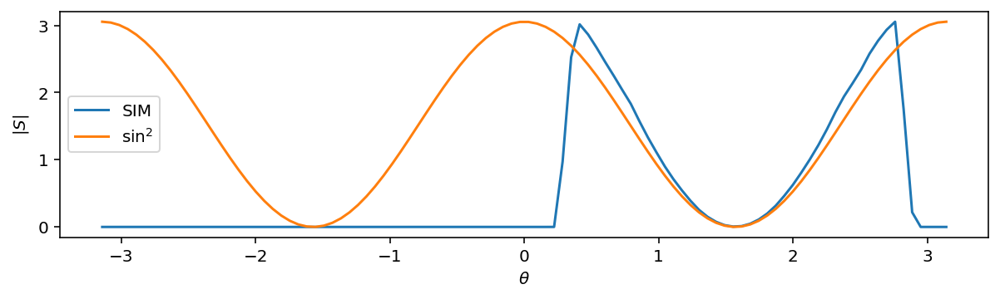

In [68]:
ring_width = 0.1
radius = 10.0
num_angle_slices = 100
this_field = np.copy(metalens['fields']['Sr'])
this_field[~(np.abs(R-radius)<=ring_width)] = np.nan
angles = np.linspace(-np.pi,np.pi,num_angle_slices)
ringo = [np.nansum(this_field[np.abs(theta-th)<=(angles[1]-angles[0])]) for th in angles]
fig, ax = plt.subplots(figsize=(10,2.5))
ax.plot(angles,ringo,label='SIM')
ax.plot(angles,max(ringo)*np.sin(angles-metalens['beta'])**2,
       label='$\sin^2$')
ax.set_xlabel('$\\theta$')
ax.set_ylabel('$|S|$')
#plt.xlim(0,np.pi)
ax.legend()
plt.show()

In [30]:
#this_field = np.real(np.copy(metalens['fields']['Sr']))
this_field = np.copy(metalens['fields']['Sr'])
this_field[~(np.abs(R-radius)<=ring_width)] = np.nan
X, Y = np.meshgrid(metalens['x_axis'], metalens['y_axis'])
R = np.sqrt(X**2+(Y+metalens['H'])**2)
theta = np.arctan2(Y+metalens['H'],X)
dipole = np.sin(theta-metalens['beta'])**2/R
# dipole[Y<0] = np.nan

vmin = np.percentile(this_field.flatten(),5)
vmax = np.percentile(this_field.flatten(),98)
im = ax.imshow(this_field,
          origin='lower',
          cmap='magma',
          norm=Normalize(vmin=vmin, vmax=vmax),
         extent=metalens['extent'])

ax.set_xlabel('x/$\mu$m')
ax.set_ylabel('y/$\mu$m')
# ax.plot([*metalens['extent'][:2]],[metalens['H']]*2,'w--')
ax.plot([0],[-metalens['H']],'x')
fig.colorbar(im)
ax.set_title('{beta} pi'.format(beta=metalens['beta']/np.pi))
plt.show()

## Ez dipole, the right way

In [62]:
def plane_wave_amp_func_Ez(metalens):
    '''
    returns the required amplitude
    function necessary to simulate
    an isotropic point source
    '''
    def far_JEz(mpvec):
        '''
        remember that the vectors
        that MEEP will provide here
        are relative to the center of the source
        '''
        r = np.sqrt(metalens['H']**2+mpvec.x**2)
        return -((np.exp(1j*metalens['k']*r) * metalens['H']
                *(4*metalens['n']*np.pi*r+1j*metalens['wavelength']))
               /(4*np.pi*r**2.5))
    return far_JEz
def plane_wave_amp_func_Hx(metalens):
    '''
    returns the required amplitude
    function necessary to simulate
    an isotropic point source
    '''
    def far_JBx(mpvec):
        '''
        remember that the vectors
        that MEEP will provide here
        are relative to the center of the source
        '''
        r = np.sqrt(metalens['H']**2+mpvec.x**2)
        return -((np.exp(1j*metalens['k']*r))/(r**0.5))
    return far_JBx

In [63]:
metalens = {
    'sim_cell_width': 20,
    'wavelength': 1.0,
    'sim_cell_height': 20,
    'pml_width': 1.,
    'source_width': 0.,
    'epsilon': 2.5*2.5,
    'complex_fields': True,
    'resolution': 30.,
    'quiet': False,
    'eta': 0.,
    'H': 3.0,
    's': 0,
    'ws': 5
}
metalens['n'] = np.sqrt(metalens['epsilon'])
metalens['k'] = metalens['n']*2*np.pi/metalens['wavelength']
metalens['simulation_time'] = metalens['sim_cell_height']*metalens['n']/2*np.sqrt(2)
metalens['geometry'] = (
    [mp.Block(size = mp.Vector3(metalens['sim_cell_width'],
                                metalens['sim_cell_height']),
              center = mp.Vector3(0,0),
              material = mp.Medium(epsilon = metalens['epsilon']))])
# Setup the MEEP objects
cell = mp.Vector3(metalens['sim_cell_width'], metalens['sim_cell_height'])
# All around the simulation cell
pml_layers = [ mp.PML(metalens['pml_width']) ]
# Set up the sources
sources = [mp.Source(src=mp.ContinuousSource(
                     wavelength=metalens['wavelength'],
                     width=metalens['source_width']
                    ),
              component=mp.Ez,
              amp_func=plane_wave_amp_func_Ez(metalens),
              center=mp.Vector3(0, 0.),
              size=mp.Vector3(metalens['sim_cell_width'], 0)),
          mp.Source(src=mp.ContinuousSource(
                     wavelength=metalens['wavelength'],
                     width=metalens['source_width']
                    ),
              component=mp.Hx,
              amp_func=plane_wave_amp_func_Hx(metalens),      
              center=mp.Vector3(0, 0),
              size=mp.Vector3(metalens['sim_cell_width'], 0))
          ]
# Set up the symmetries
syms = []
sim = mp.Simulation(cell_size=cell,
            boundary_layers=pml_layers,
            geometry=metalens['geometry'],
            force_complex_fields=metalens['complex_fields'],
            symmetries=syms,
            sources=sources,
            resolution=metalens['resolution'])
start_time = time.time()
metalens['run_date'] = (datetime.
                        datetime.
                        now().
                        strftime("%b %d %Y at %H:%M:%S"))
mp.quiet(metalens['quiet'])
sim.init_sim()

# Branch if saving for making an animation
sim.run(until=metalens['simulation_time']) 

# Compute the clock run time and grab the fields
metalens['array_metadata'] = sim.get_array_metadata()
metalens['x_axis'] = np.array(metalens['array_metadata'][0])
metalens['y_axis'] = np.array(metalens['array_metadata'][1])
metalens['run_time_in_s'] = time.time() - start_time
metalens['fields'] = {'Ex': sim.get_array(component=mp.Ex).transpose(),
                      'Ey': sim.get_array(component=mp.Ey).transpose(),
                      'Ez': sim.get_array(component=mp.Ez).transpose(),
                      'Hx': sim.get_array(component=mp.Hx).transpose(),
                      'Hy': sim.get_array(component=mp.Hy).transpose(),
                      'Hz': sim.get_array(component=mp.Hz).transpose()
                      }
metalens['eps'] = sim.get_epsilon().transpose()
metalens['fields']['Sx'] = np.real(np.conjugate(metalens['fields']['Ey'])
                            * metalens['fields']['Hz']
                            - np.conjugate(metalens['fields']['Ez'])
                            * metalens['fields']['Hx'])
metalens['fields']['Sy'] = np.real(np.conjugate(metalens['fields']['Ez'])
                      * metalens['fields']['Hx']
                      -np.conjugate(metalens['fields']['Ex'])
                      * metalens['fields']['Hz'])
metalens['fields']['Sr'] = np.sqrt(metalens['fields']['Sx']**2+
                                  metalens['fields']['Sy']**2)
metalens['extent'] = [min(metalens['x_axis']),
                max(metalens['x_axis']),
                min(metalens['y_axis']),
                max(metalens['y_axis'])]

-----------
Initializing structure...
     block, center = (0,0,0)
          size (20,20,0)
          axes (1,0,0), (0,1,0), (0,0,1)
Meep: using complex fields.
Meep progress: 13.7/35.35533905932738 = 38.7% done in 4.0s, 6.3s to go
Meep progress: 30.633333333333333/35.35533905932738 = 86.6% done in 8.0s, 1.2s to go
run 0 finished at t = 35.36666666666667 (2122 timesteps)


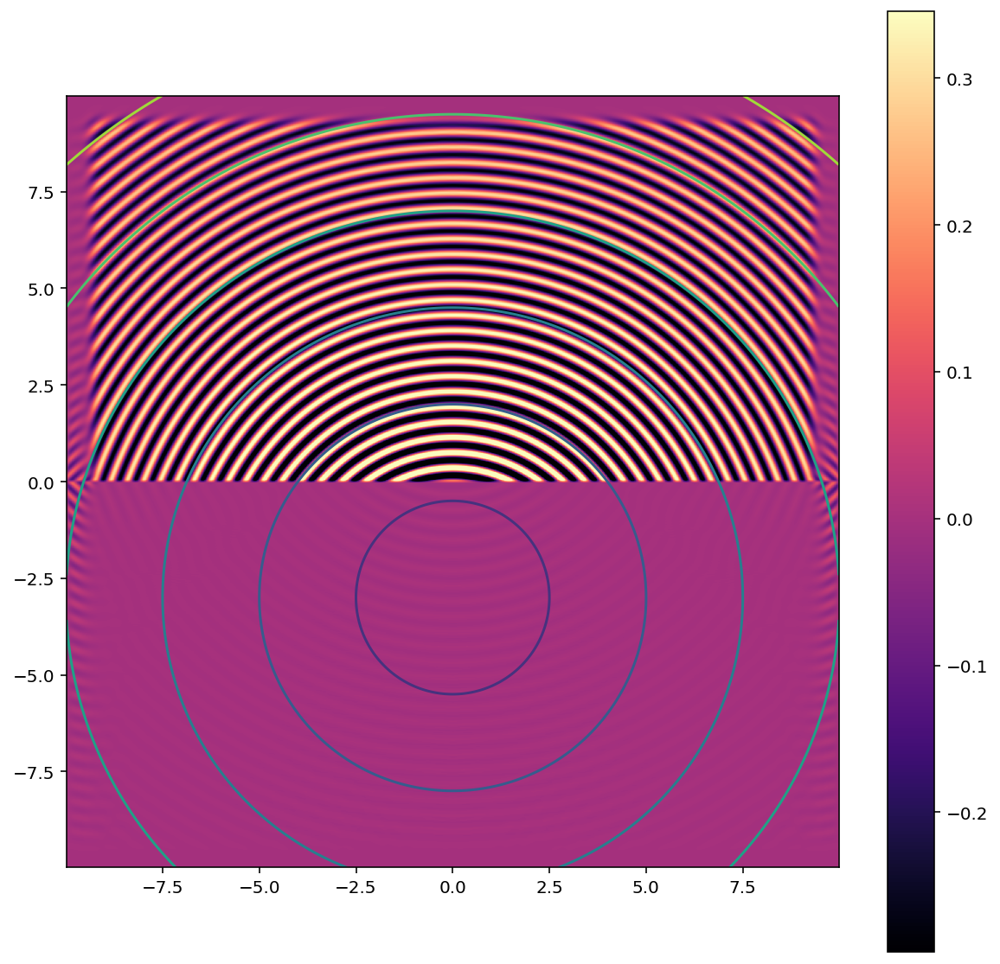

In [65]:
fig, ax = plt.subplots(figsize=(10,10))
this_field = np.real(np.copy(metalens['fields']['Ez']))
X, Y = np.meshgrid(metalens['x_axis'], metalens['y_axis'])
R = np.sqrt(X**2+(Y+metalens['H'])**2)
theta = np.arctan2(Y,X)
vmin = np.percentile(this_field.flatten(),5)
vmax = np.percentile(this_field.flatten(),98)
im = ax.imshow(this_field,
          origin='lower',
          cmap='magma',
          norm=Normalize(vmin=vmin, vmax=vmax),
         extent=metalens['extent'])
ax.contour(R,extent=metalens['extent'])
# ax.plot([*metalens['extent'][:2]],[metalens['H']]*2,'w--')
# ax.plot([-metalens['ws'],metalens['ws']],[metalens['H']]*2,'xw')
fig.colorbar(im)
plt.show()

## Plane waves, the right way

In [86]:
def plane_wave_amp_func_Ez(metalens):
    '''
    returns the required amplitude
    function necessary to simulate
    an isotropic point source
    '''
    def far_JEz(mpvec):
        '''
        remember that the vectors
        that MEEP will provide here
        are relative to the center of the source
        '''
        return -metalens['n']
    return far_JEz
def plane_wave_amp_func_Hx(metalens):
    '''
    returns the required amplitude
    function necessary to simulate
    an isotropic point source
    '''
    def far_JBx(mpvec):
        '''
        remember that the vectors
        that MEEP will provide here
        are relative to the center of the source
        '''
        return -1.
    return far_JBx

In [89]:
metalens = {
    'sim_cell_width': 20,
    'wavelength': 1.0,
    'sim_cell_height': 20,
    'pml_width': 1.,
    'source_width': 0.,
    'epsilon': 2.5*2.5,
    'complex_fields': True,
    'resolution': 30.,
    'quiet': False,
    'eta': 0.,
    'H': 3.0,
    's': 0,
    'ws': 5
}
metalens['n'] = np.sqrt(metalens['epsilon'])
metalens['k'] = metalens['n']*2*np.pi/metalens['wavelength']
metalens['simulation_time'] = metalens['sim_cell_height']*metalens['n']/2*np.sqrt(2)
metalens['geometry'] = (
    [mp.Block(size = mp.Vector3(metalens['sim_cell_width'],
                                metalens['sim_cell_height']),
              center = mp.Vector3(0,0),
              material = mp.Medium(epsilon = metalens['epsilon']))])
# Setup the MEEP objects
cell = mp.Vector3(metalens['sim_cell_width'], metalens['sim_cell_height'])
# All around the simulation cell
pml_layers = [ mp.PML(metalens['pml_width']) ]
# Set up the sources
sources = [mp.Source(src=mp.ContinuousSource(
                     wavelength=metalens['wavelength'],
                     width=metalens['source_width']
                    ),
              component=mp.Ez,
              amplitude=2.5,
              center=mp.Vector3(0, -metalens['H']),
              size=mp.Vector3(metalens['sim_cell_width'], 0)),
          mp.Source(src=mp.ContinuousSource(
                     wavelength=metalens['wavelength'],
                     width=metalens['source_width']
                    ),
              component=mp.Hx,
              amplitude=1.,
              center=mp.Vector3(0, -metalens['H']),
              size=mp.Vector3(metalens['sim_cell_width'], 0))
          ]
# Set up the symmetries
syms = []
sim = mp.Simulation(cell_size=cell,
            boundary_layers=pml_layers,
            geometry=metalens['geometry'],
            force_complex_fields=metalens['complex_fields'],
            symmetries=syms,
            sources=sources,
            resolution=metalens['resolution'])
start_time = time.time()
metalens['run_date'] = (datetime.
                        datetime.
                        now().
                        strftime("%b %d %Y at %H:%M:%S"))
mp.quiet(metalens['quiet'])
sim.init_sim()

# Branch if saving for making an animation
sim.run(until=metalens['simulation_time']) 

# Compute the clock run time and grab the fields
metalens['array_metadata'] = sim.get_array_metadata()
metalens['x_axis'] = np.array(metalens['array_metadata'][0])
metalens['y_axis'] = np.array(metalens['array_metadata'][1])
metalens['run_time_in_s'] = time.time() - start_time
metalens['fields'] = {'Ex': sim.get_array(component=mp.Ex).transpose(),
                      'Ey': sim.get_array(component=mp.Ey).transpose(),
                      'Ez': sim.get_array(component=mp.Ez).transpose(),
                      'Hx': sim.get_array(component=mp.Hx).transpose(),
                      'Hy': sim.get_array(component=mp.Hy).transpose(),
                      'Hz': sim.get_array(component=mp.Hz).transpose()
                      }
metalens['eps'] = sim.get_epsilon().transpose()
metalens['fields']['Sx'] = np.real(np.conjugate(metalens['fields']['Ey'])
                            * metalens['fields']['Hz']
                            - np.conjugate(metalens['fields']['Ez'])
                            * metalens['fields']['Hx'])
metalens['fields']['Sy'] = np.real(np.conjugate(metalens['fields']['Ez'])
                      * metalens['fields']['Hx']
                      -np.conjugate(metalens['fields']['Ex'])
                      * metalens['fields']['Hz'])
metalens['fields']['Sr'] = np.sqrt(metalens['fields']['Sx']**2+
                                  metalens['fields']['Sy']**2)
metalens['extent'] = [min(metalens['x_axis']),
                max(metalens['x_axis']),
                min(metalens['y_axis']),
                max(metalens['y_axis'])]

-----------
Initializing structure...
     block, center = (0,0,0)
          size (20,20,0)
          axes (1,0,0), (0,1,0), (0,0,1)
Meep: using complex fields.
Meep progress: 15.366666666666667/35.35533905932738 = 43.5% done in 4.0s, 5.2s to go
Meep progress: 33.9/35.35533905932738 = 95.9% done in 8.0s, 0.3s to go
run 0 finished at t = 35.36666666666667 (2122 timesteps)


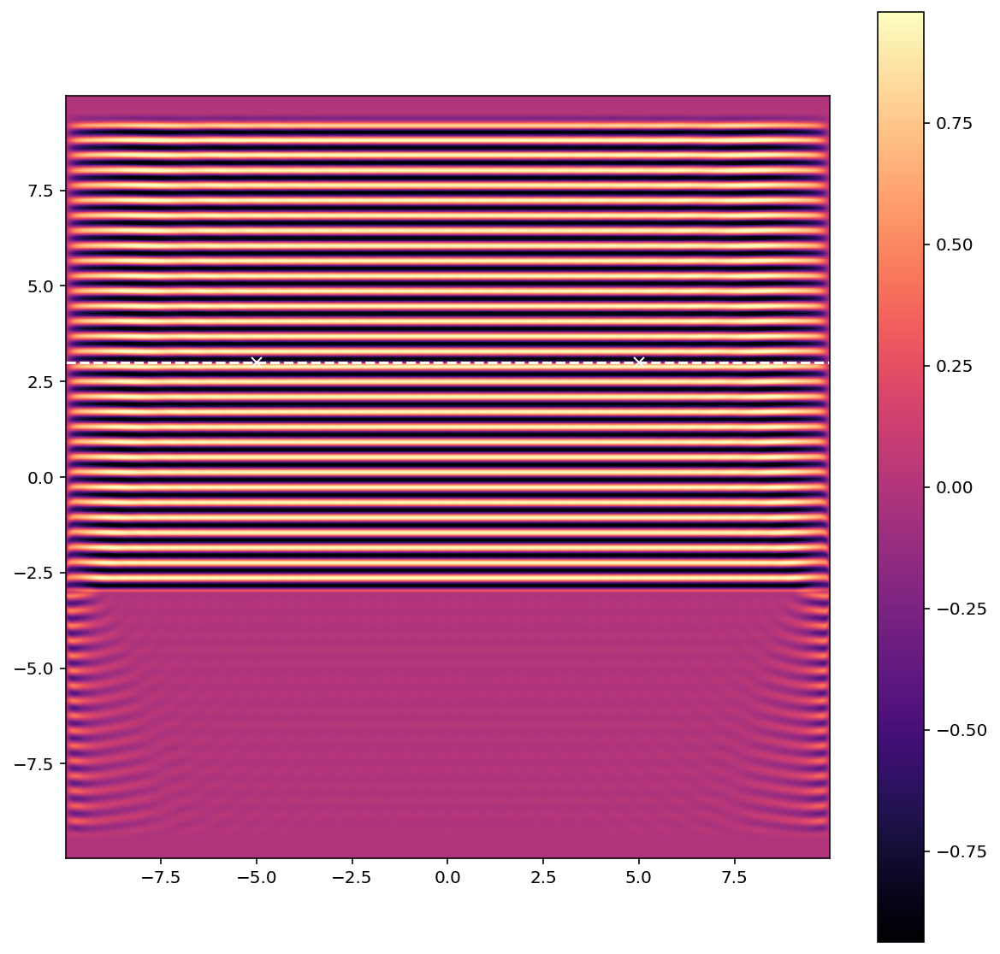

In [90]:
fig, ax = plt.subplots(figsize=(10,10))
this_field = np.real(np.copy(metalens['fields']['Ez']))
vmin = np.percentile(this_field.flatten(),5)
vmax = np.percentile(this_field.flatten(),98)
im = ax.imshow(this_field,
          origin='lower',
          cmap='magma',
          norm=Normalize(vmin=vmin, vmax=vmax),
         extent=metalens['extent'])
ax.plot([*metalens['extent'][:2]],[metalens['H']]*2,'w--')
ax.plot([-metalens['ws'],metalens['ws']],[metalens['H']]*2,'xw')
fig.colorbar(im)
plt.show()

## Ex

In [242]:
metalens = {
    'sim_cell_width': 20,
    'wavelength': 0.49,
    'sim_cell_height': 20,
    'pml_width': 1.,
    'source_width': 0.,
    'epsilon': 1,
    'complex_fields': True,
    'resolution': 20.,
    'quiet': False,
    'eta': 0.,
    'H': 5.0,
    's': 0,
    'ws': 5
}
metalens['n'] = np.sqrt(metalens['epsilon'])
metalens['k'] = metalens['n']*2*np.pi/metalens['wavelength']
metalens['simulation_time'] = metalens['sim_cell_height']*metalens['n']/2*np.sqrt(2)
metalens['geometry'] = (
    [mp.Block(size = mp.Vector3(metalens['sim_cell_width'],
                                metalens['sim_cell_height']),
              center = mp.Vector3(0,0),
              material = mp.Medium(epsilon = metalens['epsilon']))])
# Setup the MEEP objects
cell = mp.Vector3(metalens['sim_cell_width'], metalens['sim_cell_height'])
# All around the simulation cell
pml_layers = [ mp.PML(metalens['pml_width']) ]
# Set up the sources
sources = [mp.Source(src=mp.ContinuousSource(
                     wavelength=metalens['wavelength'],
                     width=metalens['source_width']
                    ),
          component=mp.Ex,
          amplitude=np.cos(metalens['eta']),
          center=mp.Vector3(0, 0),
          size=mp.Vector3(0, 0)),
#           mp.Source(src=mp.ContinuousSource(
#                      wavelength=metalens['wavelength'],
#                      width=metalens['source_width']
#                     ),
#           component=mp.Ey,
#           amplitude=np.sin(metalens['eta']),
#           center=mp.Vector3(0, 0),
#           size=mp.Vector3(0, 0))
          ]
# Set up the symmetries
syms = []
sim = mp.Simulation(cell_size=cell,
            boundary_layers=pml_layers,
            geometry=metalens['geometry'],
            force_complex_fields=metalens['complex_fields'],
            symmetries=syms,
            sources=sources,
            resolution=metalens['resolution'])
start_time = time.time()
metalens['run_date'] = (datetime.
                        datetime.
                        now().
                        strftime("%b %d %Y at %H:%M:%S"))
mp.quiet(metalens['quiet'])
sim.init_sim()

# Branch if saving for making an animation
sim.run(until=metalens['simulation_time']) 

# Compute the clock run time and grab the fields
metalens['array_metadata'] = sim.get_array_metadata()
metalens['x_axis'] = np.array(metalens['array_metadata'][0])
metalens['y_axis'] = np.array(metalens['array_metadata'][1])
metalens['run_time_in_s'] = time.time() - start_time
metalens['fields'] = {'Ex': sim.get_array(component=mp.Ex).transpose(),
                      'Ey': sim.get_array(component=mp.Ey).transpose(),
                      'Hz': sim.get_array(component=mp.Hz).transpose()
                      }
metalens['eps'] = sim.get_epsilon().transpose()
metalens['fields']['Sx'] = np.real(np.conjugate(metalens['fields']['Ey'])
                            * metalens['fields']['Hz'])
metalens['fields']['Sy'] = np.real(-np.conjugate(metalens['fields']['Ex'])
                      * metalens['fields']['Hz'])
metalens['fields']['Sr'] = np.sqrt(metalens['fields']['Sx']**2+
                                  metalens['fields']['Sy']**2)
metalens['extent'] = [min(metalens['x_axis']),
                max(metalens['x_axis']),
                min(metalens['y_axis']),
                max(metalens['y_axis'])]

-----------
Initializing structure...
     block, center = (0,0,0)
          size (20,20,0)
          axes (1,0,0), (0,1,0), (0,0,1)
Meep: using complex fields.
run 0 finished at t = 14.15 (566 timesteps)


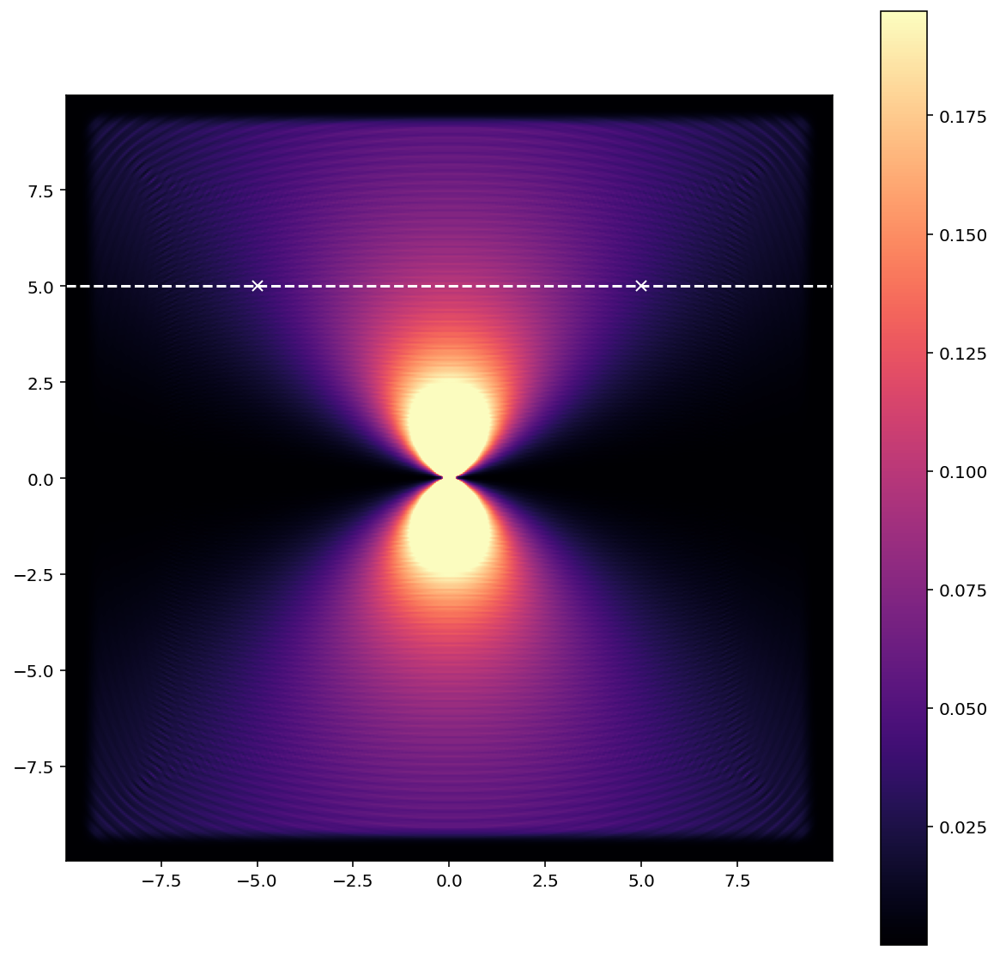

In [243]:
X, Y = np.meshgrid(metalens['x_axis'], metalens['y_axis'])
R = np.sqrt(X**2+Y**2)
theta = np.arctan2(Y,X)
fig, ax = plt.subplots(figsize=(10,10))
this_field = np.copy(metalens['fields']['Sr'])
vmin = np.percentile(this_field.flatten(),5)
vmax = np.percentile(this_field.flatten(),98)
im = ax.imshow(this_field,
          origin='lower',
          cmap='magma',
          norm=Normalize(vmin=vmin, vmax=vmax),
         extent=metalens['extent'])
ax.plot([*metalens['extent'][:2]],[metalens['H']]*2,'w--')
ax.plot([-metalens['ws'],metalens['ws']],[metalens['H']]*2,'xw')
fig.colorbar(im)
plt.show()

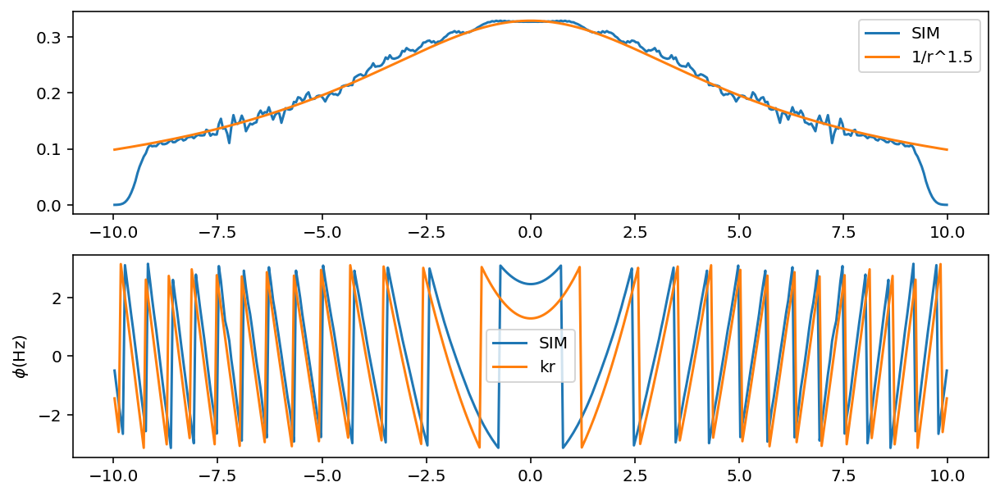

In [244]:
this_field = np.copy(metalens['fields']['Hz'])
H_index = np.argmin(np.abs(metalens['y_axis']-metalens['H']))
fig, axes = plt.subplots(nrows=2,figsize=(10,5))
r = np.sqrt(metalens['H']**2+metalens['x_axis']**2)
powwow = 1.5
rpow = 1/r**powwow
rpow = rpow/max(rpow)
x_angle = np.arctan2(metalens['H'],metalens['x_axis'])
axes[0].plot(metalens['x_axis'], np.abs(this_field[H_index]),
        label='SIM')
axes[0].plot(metalens['x_axis'],np.max(np.abs(this_field[H_index]))*rpow, label='1/r^%.1f' % powwow)
axes[0].legend()
axes[1].plot(metalens['x_axis'], np.angle(this_field[H_index]),
        label='SIM')
axes[1].plot(metalens['x_axis'],np.angle(np.exp(1j*metalens['k']*r)), label='kr')
axes[1].legend()
axes[1].set_ylabel('$\phi$(Hz)')
plt.show()

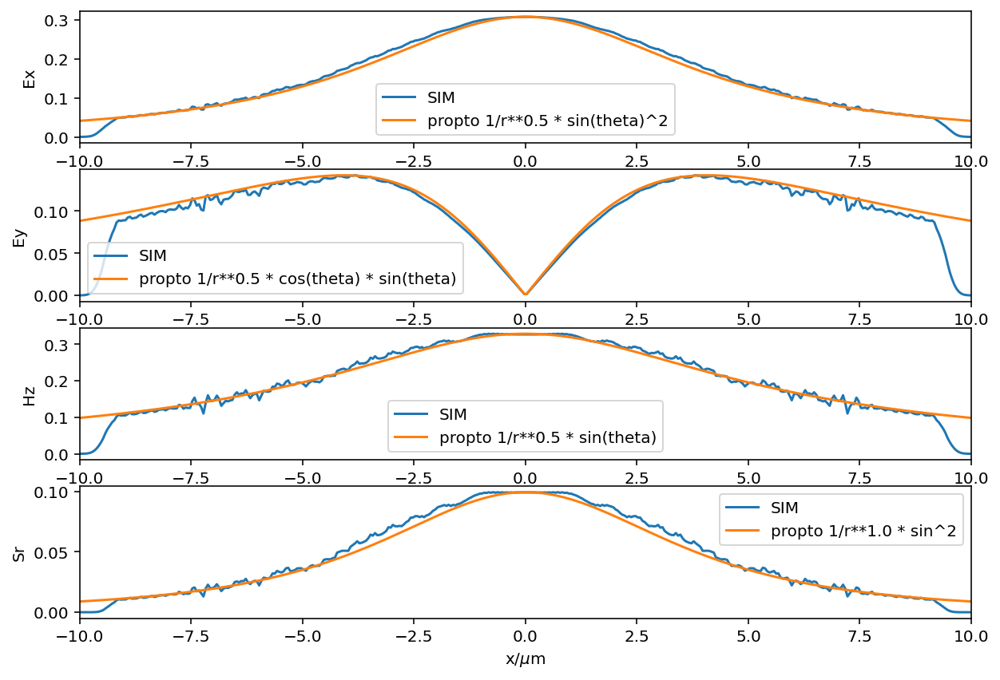

In [245]:
middle_index = np.argmin(np.abs(metalens['y_axis']-metalens['H']))
r = np.sqrt(metalens['H']**2 + metalens['x_axis']**2)
angs = np.arctan2(metalens['H'],metalens['x_axis'])

fields = ['Ex','Ey','Hz','Sr']
fig, axes = plt.subplots(nrows=len(fields),figsize=(10,7))
powwow = 0.5

for field, axis in zip(fields, axes):
    simField = np.abs(metalens['fields'][field][middle_index])
    axis.plot(metalens['x_axis'],
              simField,
              label='SIM')
    powwow = 0.5
    if field == 'Hz':
        Hprime = 1 / r**powwow * np.sin(angs)
        Hprime = Hprime/max(Hprime)
        axis.plot(metalens['x_axis'],
                  Hprime*max(simField),
                  label='propto 1/r**%.1f * sin(theta)'%powwow)
    elif field == 'Ex':
        Hprime = 1 / r**powwow * np.sin(angs)**2
        Hprime = Hprime/max(Hprime)
        axis.plot(metalens['x_axis'],
                  Hprime*max(simField),
                  label='propto 1/r**%.1f * sin(theta)^2'%powwow)
    elif field == 'Ey':
        Hprime = np.abs(1 / r**powwow * np.cos(angs) * np.sin(angs))
        Hprime = Hprime/max(Hprime)
        axis.plot(metalens['x_axis'],
                  Hprime*max(simField),
                  label='propto 1/r**%.1f * cos(theta) * sin(theta)'%powwow)
    elif field == 'Sr':
        powwow = 1
        Hprime = np.abs(1 / r**powwow * np.sin(angs)**2)
        Hprime = Hprime/max(Hprime)
        axis.plot(metalens['x_axis'],
                  Hprime*max(simField),
                  label='propto 1/r**%.1f * sin^2'%powwow)
    axis.set_xlim(-metalens['sim_cell_width']/2,metalens['sim_cell_width']/2)
    axis.legend()
    if field == fields[-1]:
        axis.set_xlabel('x/$\mu$m')
    axis.set_ylabel(field)
plt.show()

/Users/juan/opt/anaconda3/envs/pmeep/lib/python3.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: invalid value encountered in sqrt
  This is separate from the ipykernel package so we can avoid doing imports until


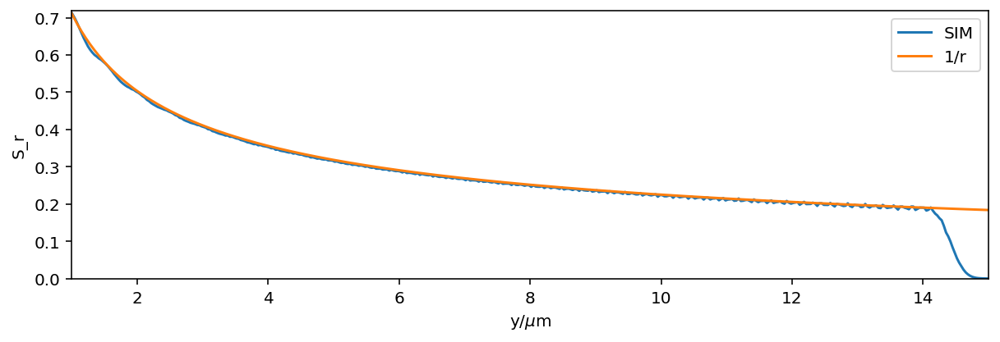

In [218]:
pivot = 1
pivot_index = np.argmin(np.abs(metalens['y_axis']-pivot))
fit = 1/metalens['y_axis']**0.5
fig, ax = plt.subplots(figsize=(10,3))
yslice = metalens['fields']['Ex'][:,int(len(metalens['x_axis'])/2)]
yslice = np.abs(yslice)
ax.plot(metalens['y_axis'],
        yslice,label='SIM')
ax.set_xlabel('y/$\mu$m')
ax.set_ylabel('S_r')
ax.plot(metalens['y_axis'],
        fit/fit[pivot_index]*yslice[pivot_index],
       label='1/r')
ax.legend()
plt.xlim(pivot,metalens['sim_cell_height']/2)
plt.ylim(0,yslice[pivot_index])
plt.show()

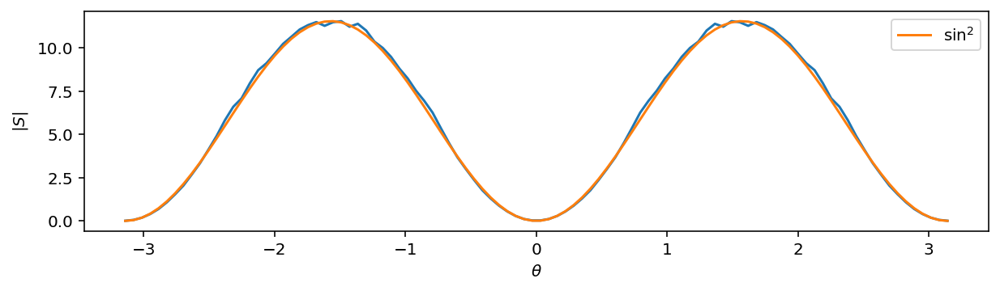

In [219]:
ring_width = 0.1
radius = 5.0
num_angle_slices = 100
this_field = np.copy(metalens['fields']['Sr'])
this_field[~(np.abs(R-radius)<=ring_width)] = np.nan
angles = np.linspace(-np.pi,np.pi,num_angle_slices)
ringo = [np.nansum(this_field[np.abs(theta-th)<=(angles[1]-angles[0])]) for th in angles]
fig, ax = plt.subplots(figsize=(10,2.5))
ax.plot(angles,ringo)
ax.plot(angles,max(ringo)*np.sin(angles-metalens['eta'])**2,
       label='$\sin^2$')
ax.set_xlabel('$\\theta$')
ax.set_ylabel('$|S|$')
ax.legend()
plt.show()

In [233]:
def far_ex_source_amp_func_x(metalens):
    '''
    returns the required amplitude
    function necessary to simulate
    an isotropic point source
    '''
    def far_exx(mpvec):
        '''
        remember that the vectors
        that MEEP will provide here
        are relative to the center of the source
        '''
        r = np.sqrt(mpvec.x**2 + (metalens['H'] - metalens['s'])**2)
        angle = np.arctan2((metalens['H'] - metalens['s']), mpvec.x)
        ph = np.exp(1j * metalens['k'] * r)
        am = np.sin(angle)**2/r**1.5
        return am * ph
    return far_exx
def far_ex_source_amp_func_y(metalens):
    '''
    returns the required amplitude
    function necessary to simulate
    an isotropic point source
    '''
    def far_exy(mpvec):
        '''
        remember that the vectors
        that MEEP will provide here
        are relative to the center of the source
        '''
        r = np.sqrt(mpvec.x**2 + (metalens['H'] - metalens['s'])**2)
        angle = np.arctan2((metalens['H'] - metalens['s']), mpvec.x)
        ph = np.exp(1j * metalens['k'] * r)
        am = -np.cos(angle)*np.sin(angle)/r**1.5
        return 0.
        return am * ph
    return far_exy

In [234]:
# Set up the sources
sources = [mp.Source(src=mp.ContinuousSource(
                     wavelength=metalens['wavelength'],
                     width=metalens['source_width']
                    ),
          component=mp.Ex,
          center=mp.Vector3(0, 0),
          size=mp.Vector3(2*metalens['ws'], 0),
          amp_func = far_ex_source_amp_func_x(metalens)
                    ),
          mp.Source(src=mp.ContinuousSource(
                     wavelength=metalens['wavelength'],
                     width=metalens['source_width']
                    ),
          component=mp.Ey,
          center=mp.Vector3(0, 0),
          size=mp.Vector3(2*metalens['ws'], 0),
          amp_func = far_ex_source_amp_func_y(metalens)
                    )
          ]
sim = mp.Simulation(cell_size=cell,
            boundary_layers=pml_layers,
            geometry=metalens['geometry'],
            force_complex_fields=metalens['complex_fields'],
            symmetries=[],
            sources=sources,
            resolution=metalens['resolution'])
start_time = time.time()
metalens['run_date'] = (datetime.
                        datetime.
                        now().
                        strftime("%b %d %Y at %H:%M:%S"))
mp.quiet(metalens['quiet'])
sim.init_sim()

# Branch if saving for making an animation
sim.run(until=metalens['simulation_time']) 

# Compute the clock run time and grab the fields
metalens['array_metadata'] = sim.get_array_metadata()
metalens['x_axis'] = np.array(metalens['array_metadata'][0])
metalens['y_axis'] = np.array(metalens['array_metadata'][1])
metalens['run_time_in_s'] = time.time() - start_time
metalens['fields'] = {'Ex': sim.get_array(component=mp.Ex).transpose(),
                      'Ey': sim.get_array(component=mp.Ey).transpose(),
                      'Hz': sim.get_array(component=mp.Hz).transpose()
                      }
metalens['eps'] = sim.get_epsilon().transpose()
metalens['fields']['Sx'] = np.real(np.conjugate(metalens['fields']['Ey'])
                            * metalens['fields']['Hz'])
metalens['fields']['Sy'] = np.real(-np.conjugate(metalens['fields']['Ex'])
                      * metalens['fields']['Hz'])
metalens['fields']['Sr'] = np.sqrt(metalens['fields']['Sx']**2+
                                  metalens['fields']['Sy']**2)
metalens['extent'] = [min(metalens['x_axis']),
                max(metalens['x_axis']),
                min(metalens['y_axis']),
                max(metalens['y_axis'])]

-----------
Initializing structure...
     block, center = (0,0,0)
          size (30,30,0)
          axes (1,0,0), (0,1,0), (0,0,1)
Meep: using complex fields.
Meep progress: 6.983333333333333/21.213203435596427 = 32.9% done in 4.0s, 8.2s to go
Meep progress: 13.95/21.213203435596427 = 65.8% done in 8.0s, 4.2s to go
Meep progress: 20.916666666666668/21.213203435596427 = 98.6% done in 12.0s, 0.2s to go
run 0 finished at t = 21.216666666666665 (1273 timesteps)


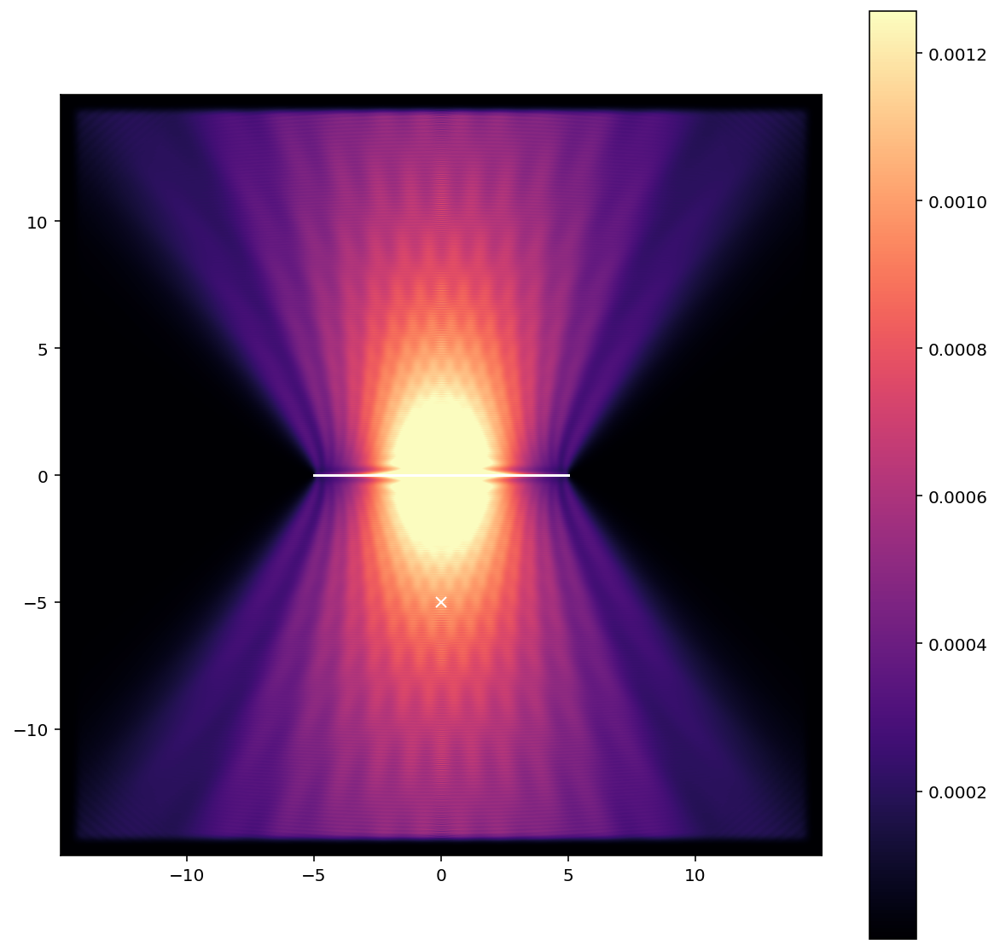

In [235]:
X, Y = np.meshgrid(metalens['x_axis'], metalens['y_axis'])
R = np.sqrt(X**2+(Y+metalens['H'])**2)
theta = np.arctan2(Y,X)
fig, ax = plt.subplots(figsize=(10,10))
this_field = np.copy(metalens['fields']['Sr'])
vmin = np.percentile(this_field.flatten(),5)
vmax = np.percentile(this_field.flatten(),98)
im = ax.imshow(this_field,
          origin='lower',
          cmap='magma',
          norm=Normalize(vmin=vmin, vmax=vmax),
         extent=metalens['extent'])
ax.plot([-metalens['ws'],metalens['ws']],[0,0],'w-')
ax.plot([0],[-metalens['H']],'wx')
fig.colorbar(im)
plt.show()

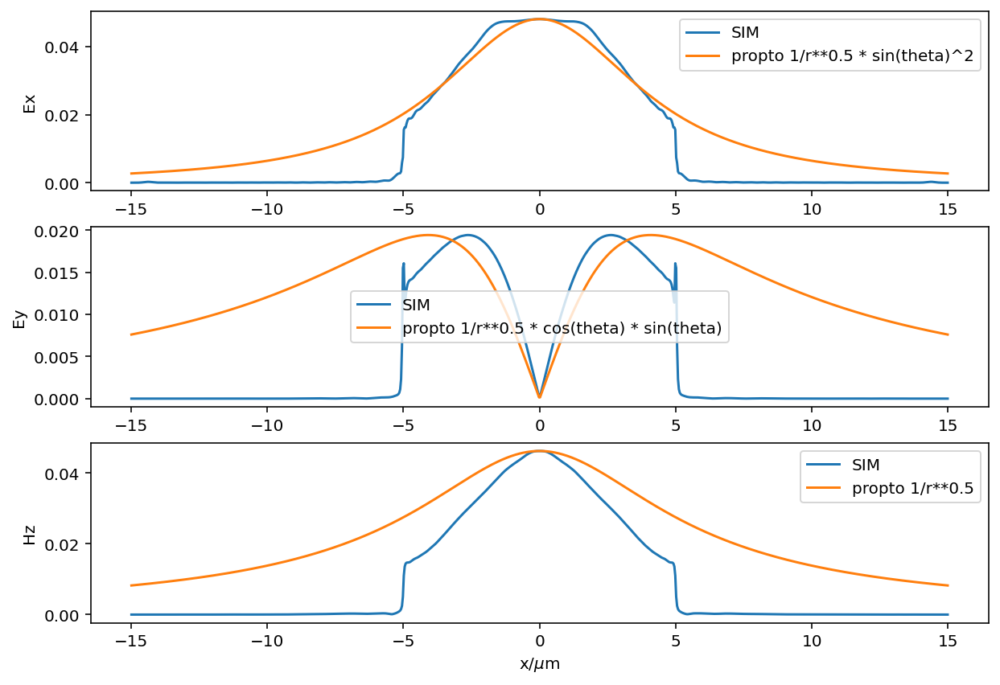

In [236]:
middle_index = np.argmin(np.abs(metalens['y_axis']))
r = np.sqrt(metalens['H']**2 + metalens['x_axis']**2)
angs = np.arctan2(metalens['H'],metalens['x_axis'])
fields = ['Ex','Ey','Hz']
powwow = 0.5

fig, axes = plt.subplots(nrows=len(fields),figsize=(10,7))
for field, axis in zip(fields, axes):
    simField = np.abs(metalens['fields'][field][middle_index])
    axis.plot(metalens['x_axis'],
              simField,
              label='SIM')
    if field == 'Ex':
        Hprime = 1 / r**powwow * np.sin(angs)**2
        Hprime = Hprime/max(Hprime)
        axis.plot(metalens['x_axis'],
                  Hprime*max(simField),
                  label='propto 1/r**%.1f * sin(theta)^2'%powwow)
    elif field == 'Ey':
        Hprime = np.abs(1 / r**powwow * np.cos(angs) * np.sin(angs))
        Hprime = Hprime/max(Hprime)
        axis.plot(metalens['x_axis'],
                  Hprime*max(simField),
                  label='propto 1/r**%.1f * cos(theta) * sin(theta)'%powwow)
    elif field == 'Hz':
        Hprime = 1 / r**powwow * np.sin(angs)
        Hprime = Hprime/max(Hprime)
        axis.plot(metalens['x_axis'],
                  Hprime*max(simField),
                  label='propto 1/r**%.1f'%powwow)
    axis.legend()
    if field == fields[-1]:
        axis.set_xlabel('x/$\mu$m')
    axis.set_ylabel(field)
plt.show()

### MEEP - eating a fiber bundle

In [ ]:
sim_fname = '/Users/juan/Google Drive/Zia Lab/CEM/MEEP/carbon-phases-%s.pkl' % simulation_parameters['sim_id']
post_diameters = pickle.load(open(sim_fname,'rb'))['post_diameters']
phases = pickle.load(open(sim_fname,'rb'))['phases']
simulation_parameters = pickle.load(open(sim_fname,'rb'))['simulation_parameters']

In [ ]:
depths = np.linspace(5,50,10)
metalenses = []
for depth in depths:
    metalens_pair = {}
    metalens = {
        'post_height':simulation_parameters['post_height'],
        'R': 25,
        'd': 50.,
        's': 0.0,
        'H': depth, # depth of emitter
        'gap_h': 1.0,
        'gap_v': 0.,
        'b': 2.0, # distance between source and interface
        'w': 100.,
        'unit cell size': simulation_parameters['cell_width'],
        'epsilon': simulation_parameters['epsilon'],
        'phases': phases,
        'widths': post_diameters,
        'wavelength': simulation_parameters['wavelength'],
        'min_width': 0.05,
        'pml_width': 1.0,
        'resolution': 40.,
        'sim_id': str(int(time.time())), #simulation_parameters['sim_id'],
        'simulation_parameters' : simulation_parameters,
        'complex_fields' : True,
        'save_output': False,
        'x_mirror_symmetry': True,
        'quiet': False,
        'freq_multiplier': 3, # must be an odd integer
        'log_to_pkl': [True,''],
        'NAf': 0.5
        }
    if 'NAf' in metalens.keys():
        metalens['n'] = np.sqrt(metalens['epsilon'])
        metalens['Ω'] = (metalens['wavelength']/2/metalens['unit cell size']
                         + metalens['NAf']) / metalens['n']
        metalens['R'] = metalens['H']*metalens['Ω']/np.sqrt(1-metalens['Ω']**2)
        metalens['zeta'] = np.arcsin(metalens['NAf'])
        metalens['d'] = np.tan(metalens['zeta']) * (metalens['w']-metalens['R'])
    metalens = aux_params(metalens)
    metalens = make_metalens_geometry(metalens)
    metalens['incident_flux'] = get_flux_on_metalens(metalens)
    metalens = simulate_metalens(metalens)
    metalens_pair['shiny'] = metalens['sim_id']
    metalens = {
        'post_height':simulation_parameters['post_height'],
        'R': 25,
        'd': 50.,
        's': 0.0,
        'H': depth, # depth of emitter
        'gap_h': 1.0,
        'gap_v': 0.,
        'b': 2.0, # distance between source and interface
        'w': 100.,
        'unit cell size': simulation_parameters['cell_width'],
        'epsilon': simulation_parameters['epsilon'],
        'phases': phases,
        'widths': post_diameters,
        'wavelength': simulation_parameters['wavelength'],
        'min_width': 0.05,
        'pml_width': 1.0,
        'resolution': 40.,
        'sim_id': str(int(time.time())), #simulation_parameters['sim_id'],
        'simulation_parameters' : simulation_parameters,
        'complex_fields' : True,
        'save_output': False,
        'x_mirror_symmetry': True,
        'quiet': False,
        'freq_multiplier': 3, # must be an odd integer
        'log_to_pkl': [True,''],
        'NAf': 0.5
        }
    if 'NAf' in metalens.keys():
        metalens['n'] = np.sqrt(metalens['epsilon'])
        metalens['Ω'] = (metalens['wavelength']/2/metalens['unit cell size']
                         + metalens['NAf']) / metalens['n']
        metalens['R'] = metalens['H']*metalens['Ω']/np.sqrt(1-metalens['Ω']**2)
        metalens['zeta'] = np.arcsin(metalens['NAf'])
        metalens['d'] = np.tan(metalens['zeta']) * (metalens['w']-metalens['R'])
    metalens['R'] = metalens['w']
    metalens = aux_params(metalens)
    metalens = make_metalens_geometry(metalens)
    metalens['incident_flux'] = get_flux_on_metalens(metalens)
    metalens = simulate_metalens(metalens)
    metalens_pair['control'] = metalens['sim_id']
    metalens_pair['H'] = depth
    metalenses.append(metalens_pair)

In [ ]:
pickle.dump(metalenses, 
            open('/Users/juan/Google Drive/Zia Lab/Log/Data/metalenses-sbs.pkl','wb'))

In [ ]:
# metalenses = pickle.load(open('/Users/juan/Google Drive/Zia Lab/Log/Data/metalenses-sbs.pkl','rb'))['metalenses']

In [ ]:
metalenses = pickle.load(open('/Users/juan/Google Drive/Zia Lab/Log/Data/metalenses-sbs.pkl','rb'))

In [ ]:
merit_fun = []
for i in range(len(metalenses)):
    metalens_shiny_fname = '/Users/juan/Google Drive/Zia Lab/Log/Data/metalens-%s.pkl' % metalenses[i]['shiny']
    print(metalens_shiny_fname.split('/')[-1])
    metalens_shiny = pickle.load(open(metalens_shiny_fname,'rb'))
    metalens_shiny = compute_post_simulation_params(metalens_shiny)
    metalens_control_fname = '/Users/juan/Google Drive/Zia Lab/Log/Data/metalens-%s.pkl' % metalenses[i]['control']
    print(metalens_control_fname.split('/')[-1])
    metalens_control = pickle.load(open(metalens_control_fname,'rb'))
    metalens_control = compute_post_simulation_params(metalens_control)
    merit_fun.append([metalenses[i]['H'],
                      metalens_shiny['tf/if'],
                      metalens_shiny['tf/ff'],
                      metalens_control['tf/if'],
                      metalens_control['tf/ff']])
    del metalens_shiny
    del metalens_control
merit_fun = np.array(merit_fun)

In [ ]:
merit_fun = []
for i in range(len(metalenses)):
    metalens_shiny_fname = '/Users/juan/Google Drive/Zia Lab/Log/Data/metalens-%s.pkl' % metalenses[i]['shiny']
    print(metalens_shiny_fname.split('/')[-1])
    metalens_shiny = pickle.load(open(metalens_shiny_fname,'rb'))
    metalens_shiny = compute_post_simulation_params(metalens_shiny)
    metalens_control_fname = '/Users/juan/Google Drive/Zia Lab/Log/Data/metalens-%s.pkl' % metalenses[i]['control']
    print(metalens_control_fname.split('/')[-1])
    metalens_control = pickle.load(open(metalens_control_fname,'rb'))
    metalens_control = compute_post_simulation_params(metalens_control)
    merit_fun.append([metalenses[i]['H'],
                      metalens_shiny['tf/if'],
                      metalens_shiny['tf/ff'],
                      metalens_control['tf/if'],
                      metalens_control['tf/ff']])
    del metalens_shiny
    del metalens_control
merit_fun = np.array(merit_fun)

In [ ]:
radii = []
for i in range(len(metalenses)):
    metalens_shiny_fname = '/Users/juan/Google Drive/Zia Lab/Log/Data/metalens-%s.pkl' % metalenses[i]['shiny']
    print(metalens_shiny_fname.split('/')[-1])
    metalens_shiny = pickle.load(open(metalens_shiny_fname,'rb'))
    radii.append(metalens_shiny['R'])
    metalens_control_fname = '/Users/juan/Google Drive/Zia Lab/Log/Data/metalens-%s.pkl' % metalenses[i]['control']
    print(metalens_control_fname.split('/')[-1])
    metalens_control = pickle.load(open(metalens_control_fname,'rb'))
    radii.append(metalens_control['R'])
    del metalens_shiny
    del metalens_control
radii = np.array(radii)

In [ ]:
depths = np.linspace(5,50,10)

In [ ]:
print(metalenses)

In [ ]:
print_params(metalens_shiny)

In [ ]:
fig, ax = plt.subplots(nrows=3,figsize=(10,9))
ax[0].plot(depths,merit_fun[:,1],'o-',label='tf/if (shiny)',ms=4)
ax[0].plot(depths,merit_fun[:,3],'o-',label='tf/if (control)',ms=4)
ax[0].set_xlim(5,50)
ax[0].legend()
ax[1].plot(depths,merit_fun[:,2],'o-',label='tf/ff (shiny)',ms=4)
ax[1].plot(depths,merit_fun[:,4],'o-',label='tf/ff (control)',ms=4)
ax[1].set_ylim(0.2,0.4)
ax[1].set_xlim(5,50)
ax[1].legend()
ax[2].plot(depths,radii[::2],'o-',label='radii (shiny)',ms=4)
ax[2].plot(depths,radii[1::2],'o-',label='radii (control)',ms=4)
ax[2].legend()
ax[2].set_ylim(0,110)
ax[2].set_xlim(5,50)
plt.show()

In [ ]:

metalens_shiny_fname = '/Users/juan/Google Drive/Zia Lab/Log/Data/metalens-%s.pkl' % metalenses[i]['shiny']
print(metalens_shiny_fname.split('/')[-1])
metalens_shiny = pickle.load(open(metalens_shiny_fname,'rb'))
metalens_shiny = compute_post_simulation_params(metalens_shiny)
metalens_control_fname = '/Users/juan/Google Drive/Zia Lab/Log/Data/metalens-%s.pkl' % metalenses[i]['control']
print(metalens_control_fname.split('/')[-1])
metalens_control = pickle.load(open(metalens_control_fname,'rb'))
metalens_control = compute_post_simulation_params(metalens_control)

In [ ]:
this_metalens['H']

In [ ]:
this_metalens['detector_plane_coordinate']

In [ ]:
for i in range(len(metalenses)):
    metalens_shiny_fname = '/Users/juan/Google Drive/Zia Lab/Log/Data/metalens-%s.pkl' % metalenses[i]['shiny']
    print(metalens_shiny_fname.split('/')[-1])
    metalens_shiny = pickle.load(open(metalens_shiny_fname,'rb'))
    metalens_shiny = compute_post_simulation_params(metalens_shiny)
    metalens_control_fname = '/Users/juan/Google Drive/Zia Lab/Log/Data/metalens-%s.pkl' % metalenses[i]['control']
    print(metalens_control_fname.split('/')[-1])
    metalens_control = pickle.load(open(metalens_control_fname,'rb'))
    metalens_control = compute_post_simulation_params(metalens_control)
    control_field = np.abs(metalens_control['farfields']['rho_em'])
    shiny_field = np.abs(metalens_shiny['farfields']['rho_em'])
    control_field = np.abs(metalens_control['farfields']['rho_em'])
    shiny_field = np.abs(metalens_shiny['farfields']['rho_em'])
    this_field = np.concatenate((shiny_field,control_field),axis=0)
    fig, ax = plt.subplots(figsize=(10,10))
    extent_c = metalens_control['full_extent']
    extent_s = metalens_shiny['full_extent']
    extent = extent_s[:2] + [extent_s[2],extent_s[3]+(extent_c[3]-extent_s[2])]
    vmin = np.percentile(this_field.flatten(),2)
    vmax = np.percentile(this_field.flatten(),98)
    shiny_height = extent_s[3]-extent_s[2]
    ax.imshow(this_field,
              cmap=this_metalens['cmap'],
              origin='lower',
              vmin=vmin,
              vmax=vmax,
              extent=extent)
    ax.plot([-metalens_shiny['w'], metalens_shiny['w']],
             [metalens_shiny['detector_plane_coordinate']]*2,
             'wx',
             ms=5)
    ax.plot([-metalens_shiny['R'], metalens_shiny['R']],
             [this_metalens['interface_coordinate']]*2,
             'wx',
             marker = "|",
             ms=5)
    ax.plot([-metalens_control['w'], metalens_control['w']],
             [metalens_control['detector_plane_coordinate']+shiny_height]*2,
             'wx',
             ms=5)
    ax.plot([-metalens_control['R'], metalens_control['R']],
             [metalens_control['interface_coordinate']+shiny_height]*2,
             'wx',
             marker = "|",
             ms=5)
    ax.set_xlabel('x/$\mu$m')
    ax.set_ylabel('y/$\mu$m')
    ax.set_xlim(-105,105)
    ax.set_yticklabels([])
    plt.title('H={H}$\mu$m'.format(H=metalens_shiny['H']))
    #fig.subplots_adjust(hspace=0.1)
    plt.tight_layout()
    plt.savefig("/Users/juan/Temp/metalenses-sbs-%d.png" % metalens_control['H'],
               dpi=200)
    plt.close()

In [ ]:
os.system('pushover "done"')

In [ ]:
control_field = np.abs(metalens_control['farfields']['rho_em'])
shiny_field = np.abs(metalens_shiny['farfields']['rho_em'])
fig, axes = plt.subplots(nrows=2)
for ax_index, axis in enumerate(axes):
    this_field = [shiny_field, control_field][ax_index]
    this_metalens = [metalens_shiny, metalens_control][ax_index]
    vmin = np.percentile(this_field.flatten(),2)
    vmax = np.percentile(this_field.flatten(),98)
    axis.imshow(this_field,
              cmap=this_metalens['cmap'],
              origin='lower',
              vmin=vmin,
              vmax=vmax,
              extent=this_metalens['full_extent'])
    axis.plot([-this_metalens['w'], this_metalens['w']],
             [this_metalens['detector_plane_coordinate']]*2,
             'wx',
             ms=5)
    axis.plot([-this_metalens['R'], this_metalens['R']],
             [this_metalens['interface_coordinate']]*2,
             'wx',
             marker = "|",
             ms=5)
    if ax_index == 1:
        axis.set_xlabel('x/$\mu$m')
    axis.set_ylabel('y/$\mu$m')
    axis.set_xlim(-105,105)
    #axis.set_ylim(-1.5,55)
    if ax_index == 0:
        axis.set_xticklabels([])
#fig.subplots_adjust(hspace=0.1)
# plt.savefig("/Users/juan/Temp/metalenses-sbs-%d.png" % this_metalens['H'],
#            dpi=200)
plt.tight_layout()
plt.show()


In [ ]:
for i in range(len(metalenses)):
    metalens_shiny_fname = '/Users/juan/Google Drive/Zia Lab/Log/Data/metalens-%s.pkl' % metalenses[i]['shiny']
    print(metalens_shiny_fname.split('/')[-1])
    metalens_shiny = pickle.load(open(metalens_shiny_fname,'rb'))
    metalens_shiny = compute_post_simulation_params(metalens_shiny)
    metalens_control_fname = '/Users/juan/Google Drive/Zia Lab/Log/Data/metalens-%s.pkl' % metalenses[i]['control']
    print(metalens_control_fname.split('/')[-1])
    metalens_control = pickle.load(open(metalens_control_fname,'rb'))
    metalens_control = compute_post_simulation_params(metalens_control)
    control_field = np.abs(metalens_control['farfields']['rho_em'])
    shiny_field = np.abs(metalens_shiny['farfields']['rho_em'])
    fig, axes = plt.subplots(nrows=2, figsize=(10,6))
    for ax_index, axis in enumerate(axes):
        this_field = [shiny_field, control_field][ax_index]
        this_metalens = [metalens_shiny, metalens_control][ax_index]
        vmin = np.percentile(this_field.flatten(),2)
        vmax = np.percentile(this_field.flatten(),98)
        axis.imshow(this_field,
                  cmap=this_metalens['cmap'],
                  origin='lower',
                  vmin=vmin,
                  vmax=vmax,
                  extent=this_metalens['full_extent'])
        axis.plot([-this_metalens['w'], this_metalens['w']],
                 [this_metalens['detector_plane_coordinate']]*2,
                 'wx',
                 ms=5)
        axis.plot([-this_metalens['R'], this_metalens['R']],
                 [this_metalens['interface_coordinate']]*2,
                 'wx',
                 marker = "|",
                 ms=5)
        if ax_index == 1:
            axis.set_xlabel('x/$\mu$m')
        axis.set_ylabel('y/$\mu$m')
        axis.set_xlim(-105,105)
        axis.set_ylim(-1.5,55)
        if ax_index == 0:
            axis.set_xticklabels([])
    #fig.subplots_adjust(hspace=0.1)
    plt.savefig("/Users/juan/Temp/metalenses-sbs-%d.png" % this_metalens['H'],
               dpi=200)
    plt.close()
    break

In [ ]:
os.system('say "finished"')

### MEEP - gradient boost

In [ ]:
sim_fname = '/Users/juan/Google Drive/Zia Lab/CEM/MEEP/carbon-phases-%s.pkl' % simulation_parameters['sim_id']
post_diameters = pickle.load(open(sim_fname,'rb'))['post_diameters']
phases = pickle.load(open(sim_fname,'rb'))['phases']
simulation_parameters = pickle.load(open(sim_fname,'rb'))['simulation_parameters']

In [ ]:
depths = np.linspace(5,50,10)
metalenses = []
for depth in depths:
    metalens_pair = {}
    metalens = {
        'post_height':simulation_parameters['post_height'],
        'R': 25,
        'd': 50.,
        's': 0.0,
        'H': depth, # depth of emitter
        'gap_h': 1.0,
        'gap_v': 0.,
        'b': 2.0, # distance between source and interface
        'w': 100.,
        'unit cell size': simulation_parameters['cell_width'],
        'epsilon': simulation_parameters['epsilon'],
        'phases': phases,
        'widths': post_diameters,
        'wavelength': simulation_parameters['wavelength'],
        'min_width': 0.05,
        'pml_width': 1.0,
        'resolution': 40.,
        'sim_id': str(int(time.time())), #simulation_parameters['sim_id'],
        'simulation_parameters' : simulation_parameters,
        'complex_fields' : True,
        'save_output': False,
        'x_mirror_symmetry': True,
        'quiet': False,
        'freq_multiplier': 3, # must be an odd integer
        'log_to_pkl': [True,''],
        'NAf': 0.5,
        'gradient_boost': 1.1
        }
    if 'NAf' in metalens.keys():
        metalens['n'] = np.sqrt(metalens['epsilon'])
        if 'gradient_boost' not in metalens.keys():
            metalens['Ω'] = (metalens['wavelength']/2/metalens['unit cell size']
                             + metalens['NAf']) / metalens['n']
        else:
            metalens['Ω'] = (metalens['gradient_boost']*metalens['wavelength']/2/metalens['unit cell size']
                             + metalens['NAf']) / metalens['n']
        metalens['R'] = metalens['H']*metalens['Ω']/np.sqrt(1-metalens['Ω']**2)
        metalens['zeta'] = np.arcsin(metalens['NAf'])
        metalens['d'] = np.tan(metalens['zeta']) * (metalens['w']-metalens['R'])
    metalens = aux_params(metalens)
    metalens = make_metalens_geometry(metalens)
    metalens['incident_flux'] = get_flux_on_metalens(metalens)
    metalens = simulate_metalens(metalens)
    metalens_pair['shiny'] = metalens['sim_id']
    metalens = {
        'post_height':simulation_parameters['post_height'],
        'R': 25,
        'd': 50.,
        's': 0.0,
        'H': depth, # depth of emitter
        'gap_h': 1.0,
        'gap_v': 0.,
        'b': 2.0, # distance between source and interface
        'w': 100.,
        'unit cell size': simulation_parameters['cell_width'],
        'epsilon': simulation_parameters['epsilon'],
        'phases': phases,
        'widths': post_diameters,
        'wavelength': simulation_parameters['wavelength'],
        'min_width': 0.05,
        'pml_width': 1.0,
        'resolution': 40.,
        'sim_id': str(int(time.time())), #simulation_parameters['sim_id'],
        'simulation_parameters' : simulation_parameters,
        'complex_fields' : True,
        'save_output': False,
        'x_mirror_symmetry': True,
        'quiet': False,
        'freq_multiplier': 3, # must be an odd integer
        'log_to_pkl': [True,''],
        'NAf': 0.5,
        'gradient_boost': 1.1
        }
    if 'NAf' in metalens.keys():
        metalens['n'] = np.sqrt(metalens['epsilon'])
        if 'gradient_boost' not in metalens.keys():
            metalens['Ω'] = (metalens['wavelength']/2/metalens['unit cell size']
                             + metalens['NAf']) / metalens['n']
        else:
            metalens['Ω'] = (metalens['gradient_boost']*metalens['wavelength']/2/metalens['unit cell size']
                             + metalens['NAf']) / metalens['n']
        metalens['R'] = metalens['H']*metalens['Ω']/np.sqrt(1-metalens['Ω']**2)
        metalens['zeta'] = np.arcsin(metalens['NAf'])
        metalens['d'] = np.tan(metalens['zeta']) * (metalens['w']-metalens['R'])
    metalens['R'] = metalens['w']
    metalens = aux_params(metalens)
    metalens = make_metalens_geometry(metalens)
    metalens['incident_flux'] = get_flux_on_metalens(metalens)
    metalens = simulate_metalens(metalens)
    metalens_pair['control'] = metalens['sim_id']
    metalens_pair['H'] = depth
    metalenses.append(metalens_pair)

In [ ]:
pickle.dump(metalenses, 
            open('/Users/juan/Google Drive/Zia Lab/Log/Data/metalenses-sbs-boosted-1p1.pkl','wb'))

In [ ]:
# metalenses = pickle.load(open('/Users/juan/Google Drive/Zia Lab/Log/Data/metalenses-sbs.pkl','rb'))['metalenses']

In [ ]:
# metalenses = pickle.load(open('/Users/juan/Google Drive/Zia Lab/Log/Data/metalenses-sbs.pkl','rb'))

In [ ]:
print_params(metalens_shiny)

In [ ]:
merit_fun = []
for i in range(len(metalenses)):
#     if i == 4:
#         break
    metalens_shiny_fname = '/Users/juan/Google Drive/Zia Lab/Log/Data/metalens-%s.pkl' % metalenses[i]['shiny']
    print(metalens_shiny_fname.split('/')[-1])
    metalens_shiny = pickle.load(open(metalens_shiny_fname,'rb'))
    metalens_shiny = compute_post_simulation_params(metalens_shiny)
    metalens_control_fname = '/Users/juan/Google Drive/Zia Lab/Log/Data/metalens-%s.pkl' % metalenses[i]['control']
    print(metalens_control_fname.split('/')[-1])
    metalens_control = pickle.load(open(metalens_control_fname,'rb'))
    metalens_control = compute_post_simulation_params(metalens_control)
    merit_fun.append([metalenses[i]['H'],
                      metalens_shiny['tf/if'],
                      metalens_shiny['tf/ff'],
                      metalens_control['tf/if'],
                      metalens_control['tf/ff']])
    del metalens_shiny
    del metalens_control
merit_fun = np.array(merit_fun)

In [ ]:
dees = []
for i in range(len(metalenses)):
    metalens_shiny_fname = '/Users/juan/Google Drive/Zia Lab/Log/Data/metalens-%s.pkl' % metalenses[i]['shiny']
    print(metalens_shiny_fname.split('/')[-1])
    metalens_shiny = pickle.load(open(metalens_shiny_fname,'rb'))
    dees.append(metalens_shiny['d'])
    metalens_control_fname = '/Users/juan/Google Drive/Zia Lab/Log/Data/metalens-%s.pkl' % metalenses[i]['control']
    print(metalens_control_fname.split('/')[-1])
    metalens_control = pickle.load(open(metalens_control_fname,'rb'))
    dees.append(metalens_control['d'])
    del metalens_shiny
    del metalens_control
dees = np.array(dees)

In [ ]:
radii = []
for i in range(len(metalenses)):
#     if i == 2:
#         break
    metalens_shiny_fname = '/Users/juan/Google Drive/Zia Lab/Log/Data/metalens-%s.pkl' % metalenses[i]['shiny']
    print(metalens_shiny_fname.split('/')[-1])
    metalens_shiny = pickle.load(open(metalens_shiny_fname,'rb'))
    radii.append(metalens_shiny['R'])
    metalens_control_fname = '/Users/juan/Google Drive/Zia Lab/Log/Data/metalens-%s.pkl' % metalenses[i]['control']
    print(metalens_control_fname.split('/')[-1])
    metalens_control = pickle.load(open(metalens_control_fname,'rb'))
    radii.append(metalens_control['R'])
    del metalens_shiny
    del metalens_control
radii = np.array(radii)

In [ ]:
fig, ax = plt.subplots(nrows=3,figsize=(10,9))
ax[0].plot(depths,merit_fun[:,1],'o-',label='tf/if (shiny)',ms=4)
ax[0].plot(depths,merit_fun[:,3],'o-',label='tf/if (control)',ms=4)
ax[0].set_xlim(5,50)
ax[0].legend()
ax[1].plot(depths,merit_fun[:,2],'o-',label='tf/ff (shiny)',ms=4)
ax[1].plot(depths,merit_fun[:,4],'o-',label='tf/ff (control)',ms=4)
ax[1].set_ylim(0.2,0.4)
ax[1].set_xlim(5,50)
ax[1].legend()
ax[2].plot(depths,radii[::2],'o-',label='radii (shiny)',ms=4)
ax[2].plot(depths,radii[1::2],'o-',label='radii (control)',ms=4)
ax[2].legend()
ax[2].set_ylim(0,110)
ax[2].set_xlim(5,50)
plt.show()

In [ ]:
for i in range(len(metalenses)):
#     if i == 2:
#         break
    metalens_shiny_fname = '/Users/juan/Google Drive/Zia Lab/Log/Data/metalens-%s.pkl' % metalenses[i]['shiny']
    print(metalens_shiny_fname.split('/')[-1])
    metalens_shiny = pickle.load(open(metalens_shiny_fname,'rb'))
    metalens_shiny = compute_post_simulation_params(metalens_shiny)
    metalens_control_fname = '/Users/juan/Google Drive/Zia Lab/Log/Data/metalens-%s.pkl' % metalenses[i]['control']
    print(metalens_control_fname.split('/')[-1])
    metalens_control = pickle.load(open(metalens_control_fname,'rb'))
    metalens_control = compute_post_simulation_params(metalens_control)
    control_field = np.abs(metalens_control['farfields']['rho_em'])
    shiny_field = np.abs(metalens_shiny['farfields']['rho_em'])
    control_field = np.abs(metalens_control['farfields']['rho_em'])
    shiny_field = np.abs(metalens_shiny['farfields']['rho_em'])
    this_field = np.concatenate((shiny_field,control_field),axis=0)
    fig, ax = plt.subplots(figsize=(10,10))
    extent_c = metalens_control['full_extent']
    extent_s = metalens_shiny['full_extent']
    extent = extent_s[:2] + [extent_s[2],extent_s[3]+(extent_c[3]-extent_s[2])]
    vmin = np.percentile(this_field.flatten(),2)
    vmax = np.percentile(this_field.flatten(),98)
    shiny_height = extent_s[3]-extent_s[2]
    ax.imshow(this_field,
              cmap=metalens_shiny['cmap'],
              origin='lower',
              vmin=vmin,
              vmax=vmax,
              extent=extent)
    ax.plot([-metalens_shiny['w'], metalens_shiny['w']],
             [metalens_shiny['detector_plane_coordinate']]*2,
             'wx',
             ms=5)
    ax.plot([-metalens_shiny['R'], metalens_shiny['R']],
             [metalens_shiny['interface_coordinate']]*2,
             'wx',
             marker = "|",
             ms=5)
    ax.plot([-metalens_control['w'], metalens_control['w']],
             [metalens_control['detector_plane_coordinate']+shiny_height]*2,
             'wx',
             ms=5)
    ax.plot([-metalens_control['R'], metalens_control['R']],
             [metalens_control['interface_coordinate']+shiny_height]*2,
             'wx',
             marker = "|",
             ms=5)
    ax.set_xlabel('x/$\mu$m')
    ax.set_ylabel('y/$\mu$m')
    ax.set_xlim(-105,105)
    ax.set_yticklabels([])
    plt.title('H={H}$\mu$m'.format(H=metalens_shiny['H']))
    #fig.subplots_adjust(hspace=0.1)
    plt.tight_layout()
    plt.savefig("/Users/juan/Temp/metalenses-sbs-boosted-1p1-%d.png" % metalens_control['H'],
               dpi=200)
    plt.close()

In [ ]:
os.system('pushover "done"')

### MEEP - eating fiber

In [ ]:
sim_fname = '/Users/juan/Google Drive/Zia Lab/CEM/MEEP/carbon-phases-%s.pkl' % simulation_parameters['sim_id']
post_diameters = pickle.load(open(sim_fname,'rb'))['post_diameters']
phases = pickle.load(open(sim_fname,'rb'))['phases']
simulation_parameters = pickle.load(open(sim_fname,'rb'))['simulation_parameters']

In [ ]:
metalens = {
    'post_height':simulation_parameters['post_height'],
    'R': 25,
    'd': 50.,
    's': 0.0,
    'H': 50, # depth of emitter
    'gap_h': 1.0,
    'gap_v': 0.,
    'b': 2.0, # distance between source and interface
    'w': 100.,
    'unit cell size': simulation_parameters['cell_width'],
    'epsilon': simulation_parameters['epsilon'],
    'phases': phases,
    'widths': post_diameters,
    'wavelength': simulation_parameters['wavelength'],
    'min_width': 0.05,
    'pml_width': 1.0,
    'resolution': 40.,
    'sim_id': simulation_parameters['sim_id'],
    'simulation_parameters' : simulation_parameters,
    'complex_fields' : True,
    'save_output': False,
    'x_mirror_symmetry': True,
    'quiet': True,
    'freq_multiplier': 3, # must be an odd integer
    'log_to_pkl': [False,''],
    'NAf': 0.5
    }
if 'NAf' in metalens.keys():
    metalens['n'] = np.sqrt(metalens['epsilon'])
    metalens['Ω'] = (metalens['wavelength']/2/metalens['unit cell size']
                     + metalens['NAf']) / metalens['n']
    metalens['R'] = metalens['H']*metalens['Ω']/np.sqrt(1-metalens['Ω']**2)
    metalens['zeta'] = np.arcsin(metalens['NAf'])
    metalens['d'] = np.tan(metalens['zeta']) * (metalens['w']-metalens['R'])
metalens['w'] = metalens['R']

In [ ]:
metalens = aux_params(metalens)
metalens = make_metalens_geometry(metalens)
metalens['incident_flux'] = get_flux_on_metalens(metalens)
metalens = simulate_metalens(metalens)
metalens = compute_post_simulation_params(metalens)

In [ ]:
metalens['tf/ff']

In [ ]:
this_field = np.abs(metalens['farfields']['rho_em'])
vmin = np.percentile(this_field.flatten(),5)
vmax = np.percentile(this_field.flatten(),95)
plt.figure(figsize=(10,10))
plt.imshow(this_field,
          cmap=metalens['cmap'],
          origin='lower',
          vmin=vmin,
          vmax=vmax,
          extent=metalens['full_extent'])
plt.plot([-metalens['w'], metalens['w']],
         [metalens['detector_plane_coordinate']]*2,
         'wx',
         ms=5)
plt.xlabel('x/$\mu$m')
plt.ylabel('y/$\mu$m')
plt.xlim(-1.1*metalens['w'],1.1*metalens['w'])
plt.show()

In [ ]:
metalens['R']

In [ ]:
metalens['detector_plane_coordinate']

In [ ]:
90-np.arcsin(metalens['NAf'])*180/np.pi

### MEEP - in the deep

In [ ]:
sim_fname =  '/Users/juan/Google Drive/Zia Lab/CEM/MEEP/carbon-phases-%s.pkl' % simulation_parameters['sim_id']
post_diameters = pickle.load(open(sim_fname,'rb'))['post_diameters']
phases = pickle.load(open(sim_fname,'rb'))['phases']
simulation_parameters = pickle.load(open(sim_fname,'rb'))['simulation_parameters']

In [ ]:
depth = 800
metalens = {
    'post_height':simulation_parameters['post_height'],
    'R': 25,
    'd': 50.,
    's': 0.0,
    'H': depth, # depth of emitter
    'gap_h': 1.0,
    'gap_v': 0.,
    'b': 2.0, # distance between source and interface
    'w': 25.,
    'unit cell size': simulation_parameters['cell_width'],
    'epsilon': simulation_parameters['epsilon'],
    'phases': phases,
    'widths': post_diameters,
    'wavelength': simulation_parameters['wavelength'],
    'min_width': 0.05,
    'pml_width': 1.0,
    'resolution': 40.,
    'sim_id': simulation_parameters['sim_id'],
    'simulation_parameters' : simulation_parameters,
    'complex_fields' : True,
    'save_output': False,
    'x_mirror_symmetry': True,
    'quiet': True,
    'freq_multiplier': 3, # must be an odd integer
    'log_to_pkl': [False,'']
    }
metalens = aux_params(metalens)
metalens = make_metalens_geometry(metalens)
metalens['incident_flux'] = get_flux_on_metalens(metalens)
metalens = simulate_metalens(metalens)
metalens = compute_post_simulation_params(metalens)
#gotchaHR.append([depth, metalens['tf/if'], metalens['tf/ff']])
metalens['tf/if']

In [ ]:
this_field = np.abs(metalens['farfields']['rho_em'])
vmin = np.percentile(this_field.flatten(),5)
vmax = np.percentile(this_field.flatten(),95)
plt.figure(figsize=(10,10))
plt.imshow(this_field,
          cmap=metalens['cmap'],
          origin='lower',
          vmin=vmin,
          vmax=vmax,
          extent=metalens['full_extent'])
plt.plot([-metalens['w'], metalens['w']],
         [metalens['detector_plane_coordinate']]*2,
         'wx',
         ms=1)
plt.xlabel('x/$\mu$m')
plt.ylabel('y/$\mu$m')
plt.show()

In [ ]:
depths = np.linspace(5,100,20)

In [ ]:
gotchaHR = []
for depth in depths:
    print('H=%.1f' % depth)
    metalens = {
        'post_height':simulation_parameters['post_height'],
        'R': 25,
        'd': 50.,
        's': 0.0,
        'H': depth, # depth of emitter
        'gap_h': 1.0,
        'gap_v': 0.,
        'b': 2.0, # distance between source and interface
        'w': 25.,
        'unit cell size': simulation_parameters['cell_width'],
        'epsilon': simulation_parameters['epsilon'],
        'phases': phases,
        'widths': post_diameters,
        'wavelength': simulation_parameters['wavelength'],
        'min_width': 0.05,
        'pml_width': 1.0,
        'resolution': 50.,
        'sim_id': simulation_parameters['sim_id'],
        'simulation_parameters' : simulation_parameters,
        'complex_fields' : True,
        'save_output': False,
        'x_mirror_symmetry': True,
        'quiet': True,
        'freq_multiplier': 3, # must be an odd integer
        'log_to_pkl': [False,'']
        }
    metalens = aux_params(metalens)
    metalens = make_metalens_geometry(metalens)
    metalens['incident_flux'] = get_flux_on_metalens(metalens)
    metalens = simulate_metalens(metalens)
    metalens = compute_post_simulation_params(metalens)
    gotchaHR.append([depth, metalens['tf/if'], metalens['tf/ff']])
gotchaHR = np.array(gotchaHR)

In [ ]:
!pushover "done"

In [ ]:
plt.rcParams.update({'font.size': 12})
plt.figure(figsize=(10,10))
title_string = '''resolution={resolution}, d={d}$\,\mu$m
    $\lambda$={wavelength}$\,\mu$m, R={R}$\mu$m, h={post_height}$\mu$m
    cell_width = {cell_width}$\mu$m, w={w}$\mu$m
    normal transmission = {normal_incidence_transmission:.2f}'''
#plt.plot(gotcha[:,0],100*gotchaHR[:,1],label='transmitted power / incident power')
plt.plot(gotchaHR[:,0],100*gotchaHR[:,1],label='transmitted power / incident power')
plt.xlabel('H/$\mu$m')
plt.ylabel('%')
plt.ylim(0,80.)
plt.legend()
plt.grid(True)
plt.title(title_string.format(**metalens))
plt.show()

In [ ]:
gotchaHR

In [ ]:
plt.rcParams.update({'font.size': 12})
plt.figure(figsize=(10,10))
title_string = '''resolution={resolution}, d={d}$\,\mu$m
    $\lambda$={wavelength}$\,\mu$m, R={R}$\mu$m, h={post_height}$\mu$m
    cell_width = {cell_width}$\mu$m, w={w}$\mu$m
    normal transmission = {normal_incidence_transmission:.2f}'''
plt.plot(gotchaHR[:,0],100*gotchaHR[:,1],label='transmitted power / incident power')
plt.plot(gotchaHR[:,0],100*gotchaHR[:,2],label='transmitted power / total radiated power')
plt.xlabel('H/$\mu$m')
plt.ylabel('%')
#plt.ylim(0,30.)
plt.legend()
plt.grid(True)
plt.title(title_string.format(**metalens))
plt.show()

In [ ]:
print("target_flux/incident_flux = %.1f%%"  % (100*metalens['tf/if']))
print("target_flux/full_flux = %.1f%%"  % (100*metalens['tf/ff']))

In [ ]:
this_field = np.abs(metalens['farfields']['rho_em'])
vmin = np.percentile(this_field.flatten(),5)
vmax = np.percentile(this_field.flatten(),95)
plt.figure(figsize=(10,10))
plt.imshow(this_field,
          cmap=metalens['cmap'],
          origin='lower',
          vmin=vmin,
          vmax=vmax,
          extent=metalens['full_extent'])
plt.plot([-metalens['w'], metalens['w']],
         [metalens['detector_plane_coordinate']]*2,
         'wx',
         ms=1)
plt.xlabel('x/$\mu$m')
plt.ylabel('y/$\mu$m')
plt.show()

In [ ]:
ws = np.array([5.,10.,15.,20.,25.,30.])
Hs = np.array([5.,10.,15.,20.,25.,30.])

In [ ]:
metalenses_params = []
for w, H in itertools.product(ws,Hs):
    metalens = {
        'post_height':simulation_parameters['post_height'],
        'R': 25,
        'd': 50.,
        's': 0.0,
        'H': H, # depth of emitter
        'gap_h': 1.0,
        'gap_v': 0.,
        'b': 2.0, # distance between source and interface
        'w': w,
        'unit cell size': simulation_parameters['cell_width'],
        'epsilon': simulation_parameters['epsilon'],
        'phases': phases,
        'widths': post_diameters,
        'wavelength': simulation_parameters['wavelength'],
        'min_width': 0.05,
        'pml_width': 1.0,
        'resolution': 50.,
        'sim_id': str(int(time.time())), #simulation_parameters['sim_id'],
        'simulation_parameters' : simulation_parameters,
        'complex_fields' : True,
        'save_output': False,
        'x_mirror_symmetry': True,
        'quiet': True,
        'freq_multiplier': 3, # must be an odd integer
        'log_to_pkl': [True,'']
        }
    metalens = aux_params(metalens)
    metalens = make_metalens_geometry(metalens)
    metalenses_params.append(metalens)

In [ ]:
def quick_metal(metalens,cue):
    metalens['incident_flux'] = get_flux_on_metalens(metalens)
    metalens = simulate_metalens(metalens)
    print(metalens['sim_id'])
    cue.put(metalens)
# metalenses = multip.Pool(processes=4).map(quick_metal, metalenses_params[:4], chunksize=1);
cue = multip.Queue()
processes = [multip.Process(target=quick_metal,
            args=(metalens,cue)) for metalens in metalenses_params[:4]]
for p in processes:
    p.start()
for p in processes:
    p.join()
metalenses = [cue.get() for p in processes];

In [ ]:
25/36*4

In [ ]:
!pushover "done"

In [ ]:
ws = np.array([5.,10.,15.,20.,25.,30.])
Hs = np.array([5.,10.,15.,20.,25.,30.])
atlante_parallel = {}
for w in ws:
    for H in Hs:
        print('H=%.1f, w=%.1f' % (H, w))
        metalens = {
            'post_height':simulation_parameters['post_height'],
            'R': 25,
            'd': 50.,
            's': 0.0,
            'H': H, # depth of emitter
            'gap_h': 1.0,
            'gap_v': 0.,
            'b': 2.0, # distance between source and interface
            'w': w,
            'unit cell size': simulation_parameters['cell_width'],
            'epsilon': simulation_parameters['epsilon'],
            'phases': phases,
            'widths': post_diameters,
            'wavelength': simulation_parameters['wavelength'],
            'min_width': 0.05,
            'pml_width': 1.0,
            'resolution': 50.,
            'sim_id': str(int(time.time())), #simulation_parameters['sim_id'],
            'simulation_parameters' : simulation_parameters,
            'complex_fields' : True,
            'save_output': False,
            'x_mirror_symmetry': True,
            'quiet': True,
            'freq_multiplier': 3, # must be an odd integer
            'log_to_pkl': [True,'']
            }
        metalens = aux_params(metalens)
        metalens = make_metalens_geometry(metalens)
        metalens['incident_flux'] = get_flux_on_metalens(metalens)
        metalens = para_metalens(metalens,4)
        atlante_parallel[(w,H)] = metalens['sim_id']

In [ ]:
pickle.dump(atlante, open('/Users/juan/Google Drive/Zia Lab/Log/Data/atlante-1.pkl','wb'))

In [ ]:
atlante = pickle.load(open('/Users/juan/Google Drive/Zia Lab/Log/Data/atlante-1.pkl','rb'))

In [ ]:
fname = '/Users/juan/Google Drive/Zia Lab/Log/Data/metalens-%s.pkl' % atlante[(10,10)]
metalens = pickle.load(open(fname,'rb'))

In [ ]:
print_params(metalens)

In [ ]:
merit_tf_if = []
merit_tf_ff = []
ws = np.array([5.,10.,15.,20.,25.,30.])
Hs = np.array([5.,10.,15.,20.,25.,30.])
for w in ws:
    constant_w_1 = []
    constant_w_2 = []
    for H in Hs:
        #load it
        fname = '/Users/juan/Google Drive/Zia Lab/Log/Data/metalens-%s.pkl' % atlante_parallel[(w,H)]
        metalens = pickle.load(open(fname,'rb'))
        #compute farfields
        metalens = compute_post_simulation_params(metalens)
        constant_w_1.append(metalens['tf/if'])
        constant_w_2.append(metalens['tf/ff'])
    merit_tf_if.append(constant_w_1)
    merit_tf_ff.append(constant_w_2)
merit_tf_if = np.array(merit_tf_if)
merit_tf_ff = np.array(merit_tf_ff)

In [ ]:
!say "done"

In [ ]:
constant_w_2

In [ ]:
for w_index, w in enumerate(ws):
    for h_index, H in enumerate(Hs):
        print("{%.1f,%.1f,%.3f}," % (w, H, merit[w_index][h_index]))

In [ ]:
merit_tf_ff

In [ ]:

fig, axes = plt.subplots(ncols=2,figsize=(7*2,7))
for merit, ax, this_title in zip([merit_tf_ff, merit_tf_if],
                     axes,
                    ['flux on target / full flux',
                    'flux on target / incident flux']):
    im = ax.imshow(merit,
              origin='lower',
              cmap = 'magma',
              extent=[5-2.5,35-2.5,5-2.5,35-2.5])
    # cax = ax.add_axes([0.95, 0.075, 0.05, 0.85])
    for H_index, H in enumerate(Hs):
        for w_index, w in enumerate(ws): 
            ax.text(H, w, "%.2f" % merit[w_index][H_index],
                    va='center',ha='center',color='white',fontsize=10)
    ax.set_title(this_title)
    fig.colorbar(im, ax=ax)
    ax.set_ylabel('w/$\mu$m')
    ax.set_xlabel('H/$\mu$m')
plt.show()

In [ ]:
!pushover "done"

In [ ]:
for w in ws:
    for H in Hs:
        #load it
        fname = '/Users/juan/Google Drive/Zia Lab/Log/Data/metalens-%s.pkl' % atlante_parallel[(w,H)]
        metalens = pickle.load(open(fname,'rb'))
        #compute farfields
        metalens = compute_post_simulation_params(metalens)
        plotfname = '/Users/juan/Temp/metalens-%d-%d.png' % (w,H)
        #make and save plot
        this_field = (metalens['farfields']['rho_em'])
        vmin = np.percentile(this_field.flatten(),5)
        vmax = np.percentile(this_field.flatten(),95)
        plt.figure(figsize=(10,5))
        plt.imshow(this_field,
                  cmap=metalens['cmap'],
                  origin='lower',
                  vmin=vmin,
                  vmax=vmax,
                  extent=metalens['full_extent'])
        plt.plot([-metalens['w'], -metalens['w'],-metalens['w'],-metalens['w']-2],
                 [metalens['detector_plane_coordinate']+1,
                 metalens['detector_plane_coordinate']-1,
                 metalens['detector_plane_coordinate'],
                 metalens['detector_plane_coordinate']],
                 'w-')
        plt.plot([metalens['w'], metalens['w'],metalens['w'],metalens['w']+2],
                 [metalens['detector_plane_coordinate']+1,
                 metalens['detector_plane_coordinate']-1,
                 metalens['detector_plane_coordinate'],
                 metalens['detector_plane_coordinate']],
                 'w-')
        plt.plot([60-metalens['R']*0.25,60+metalens['R']*0.25],[20-10]*2,'w-')
        plt.plot([60],[20-metalens['H']*0.25-10],'wx')
        plt.plot([60-metalens['w']*0.25,
                 60+metalens['w']*0.25],[20+metalens['d']*0.25-10]*2,'w-')
        plt.xlabel('x/$\mu$m')
        plt.ylabel('y/$\mu$m')
        plt.text(60,50,'H=%d $\mu$m w=%d $\mu$m' % (w,H),va='center',ha='center',
                color='white')
        plt.xlim(-40,80)
        plt.ylim(metalens['full_extent'][2],53)
        plt.tight_layout()
        print("Saving figure...")
        plt.savefig(plotfname, dpi=300)
        plt.close()

In [ ]:
!say "done"

In [ ]:
this_field.shape

In [ ]:
pickle.dump(atlante_parallel, open('/Users/juan/Google Drive/Zia Lab/Log/Data/atlante-1.pkl','wb'))

In [ ]:
!pushover "done"

### MEEP - flux through target

In [ ]:
sim_fname =  '/Users/juan/Google Drive/Zia Lab/CEM/MEEP/carbon-phases-%s.pkl' % simulation_parameters['sim_id']
post_diameters = pickle.load(open(sim_fname,'rb'))['post_diameters']
phases = pickle.load(open(sim_fname,'rb'))['phases']
simulation_parameters = pickle.load(open(sim_fname,'rb'))['simulation_parameters']

In [ ]:
metalens = {
    'post_height':simulation_parameters['post_height'],
    'R': 25,
    'd': 50.,
    's': 0.0,
    'H': 20., # depth of emitter
    'gap_h': 1.0,
    'gap_v': 0.,
    'b': 2.0, # distance between source and interface
    'w': 10.,
    'unit cell size': simulation_parameters['cell_width'],
    'epsilon': simulation_parameters['epsilon'],
    'phases': phases,
    'widths': post_diameters,
    'wavelength': simulation_parameters['wavelength'],
    'min_width': 0.05,
    'pml_width': 1.0,
    'resolution': 30.,
    'sim_id': simulation_parameters['sim_id'],
    'simulation_parameters' : simulation_parameters,
    'complex_fields' : True,
    'save_output': False,
    'x_mirror_symmetry': True,
    'quiet': True,
    'freq_multiplier': 3 # must be an odd integer
    }
metalens = aux_params(metalens)
metalens = make_metalens_geometry(metalens)
metalens['incident_flux'] = get_flux_on_metalens(metalens)
metalens = simulate_metalens(metalens)

In [ ]:
metalens = compute_post_simulation_params(metalens)

In [ ]:
print("target_flux/incident_flux = %.1f%%"  % (100*metalens['tf/if']))
print("target_flux/full_flux = %.1f%%"  % (100*metalens['tf/ff']))

### MEEP - Flux Capacitor

In [ ]:
# given the size of the custom source
# the wavelength
# and the index of refraction
# determine the amount of radiant flux it would emit in 
# a homogeneous medium
# understand how this scales with resolution

* there is no dependence on wavelength
* it is inversely proportional to the refractive index


In [ ]:
def source_flux(wave=1.0,
               resolution=30,
               epsilon=1.0):
    metalens = {'sim_cell_width':40,
               'sim_cell_height':20.,
               'pml_width':1,
               'source_width': 0,
               'wavelength':wave,
               'source_coordinate':0,
               'ws':5,
               'x_mirror_symmetry': True,
               'complex_fields': True,
               'resolution':40.,
               'quiet': True,
               'epsilon': epsilon,
               'H': 10.,
               's': 0.}
    metalens['gate_radius'] = metalens['ws']
    metalens['n'] = np.sqrt(metalens['epsilon'])
    metalens['k'] = metalens['n']*2.*np.pi/metalens['wavelength']
    metalens['simulation_time'] = (metalens['source_width']+
                                   3*metalens['n']
                                   *metalens['wavelength']
                                  /metalens['wavelength'])

    # Setup the MEEP objects
    cell = mp.Vector3(metalens['sim_cell_width'],
                      metalens['sim_cell_height'])
    # All around the simulation cell
    pml_layers = [ mp.PML(metalens['pml_width']) ]
    amp_func = far_ez_source_amp_func(metalens)
    # Set up the sources
    sources = [mp.Source(src=mp.ContinuousSource(
                         wavelength=metalens['wavelength'],
                         width=metalens['source_width']
                        ),
              component=mp.Ez,
              center=mp.Vector3(0, metalens['source_coordinate']),
              size=mp.Vector3(2 * metalens['ws'], 0),
              amp_func=amp_func)]
    # Set up the symmetries
    metalens['geometry'] = [mp.Block(size = mp.Vector3(metalens['sim_cell_width'],
                                                metalens['sim_cell_height']),
                            center = mp.Vector3(0,0),
                            material = mp.Medium(epsilon = metalens['epsilon']))]
    syms = []
    if metalens['x_mirror_symmetry']:
        syms.append(mp.Mirror(mp.X))
    sim = mp.Simulation(cell_size=cell,
                boundary_layers=pml_layers,
                geometry=metalens['geometry'],
                force_complex_fields=metalens['complex_fields'],
                symmetries=syms,
                sources=sources,
                resolution=metalens['resolution'])
    mp.quiet(metalens['quiet'])
    sim.init_sim()
    sim.run(until=metalens['simulation_time']) 
    metalens['fields'] = {'Ez': sim.get_array(component=mp.Ez).transpose(),
                          'Hx': sim.get_array(component=mp.Hx).transpose(),
                          'Hy': sim.get_array(component=mp.Hy).transpose()}
    metalens['optical_axis'] = np.linspace(-metalens['sim_cell_height']/2,
                                          metalens['sim_cell_height']/2,
                                          metalens['fields']['Ez'].shape[0])
    metalens['interface_index'] =  np.argmin(
                                   np.abs(metalens['optical_axis']))
    metalens['gate_index'] = metalens['interface_index'] + 1
    metalens['extent'] = [-metalens['sim_cell_height']/2,
                         metalens['sim_cell_height']/2,
                         -metalens['sim_cell_width']/2,
                         metalens['sim_cell_width']/2]
    metalens['transverse_axis'] = (
        np.linspace(-metalens['sim_cell_width']/2,
        metalens['sim_cell_width']/2,
        metalens['fields']['Ez'].shape[1]))
    metalens['source_amps'] = [amp_func(mp.Vector3(x,0)) 
                               for x in metalens['transverse_axis']]
    metalens['fields']['Sy'] = np.real(np.conjugate(metalens['fields']['Ez'])
                              * metalens['fields']['Hx'])
    metalens['Sy_on_gate'] = metalens['fields']['Sy'][metalens['gate_index']]
    metalens['total_flux'] = np.sum(metalens['Sy_on_gate']
            [metalens['transverse_axis']<=metalens['gate_radius']])
    return (np.abs(metalens['source_amps']), metalens['total_flux'])

In [ ]:
wavelengths = np.linspace(0.5,2,10)
fluxes = np.array([source_flux(wave=wave,
                              resolution=30,
                              epsilon=1.0) for wave in wavelengths])
plt.figure(figsize=(10,2))
plt.plot(wavelengths,
        fluxes[:,1],
        'o-',ms=2)
# plt.ylim(0,0.1)
plt.show()

In [ ]:
metalens['geometry']

In [ ]:
epsilons = np.linspace(1,5.,11)
fluxes = np.array([source_flux(wave=1.0,resolution=30,epsilon=epsilon) for epsilon in epsilons])
plt.figure(figsize=(10,2))
plt.plot(epsilons,
        fluxes[:,1],
        'o-',ms=2)
plt.plot(epsilons,
        fluxes[:,1][0]/np.sqrt(epsilons))
plt.show()

In [ ]:
# list(map(lambda x: np.sum(x**2),fluxes[:,0]))

In [ ]:
plt.figure(figsize=(10,2))
plt.plot(epsilons,
        fluxes[:,0],
        'o-',ms=2)
plt.plot(epsilons,
        fluxes[:,1][0]/np.sqrt(epsilons))
plt.show()

In [ ]:
plt.figure(figsize=(10,2))
plt.plot(metalens['transverse_axis'],
        np.abs(metalens['source_amps']))
plt.show()

In [ ]:
plt.figure(figsize=(10,10))
plt.imshow(np.real(metalens['fields']['Sy']),
          extent=metalens['extent'],
          origin='lower',
          cmap='magma')
plt.show()

### MEEP - change the horizontal gap with improved farfield

In [ ]:
sim_fname =  '/Users/juan/Google Drive/Zia Lab/CEM/MEEP/carbon-phases-%s.pkl' % simulation_parameters['sim_id']
post_diameters = pickle.load(open(sim_fname,'rb'))['post_diameters']
phases = pickle.load(open(sim_fname,'rb'))['phases']
simulation_parameters = pickle.load(open(sim_fname,'rb'))['simulation_parameters']

In [ ]:
metalenses = []
gap_hs = [0,2,4]
for gap_h in gap_hs:
    os.system('say "[[volm 0.3]] %.1f"' % gap_h)
    metalens = {
        'post_height':simulation_parameters['post_height'],
        'R': 25,
        'd': 50.,
        's': 0.0,
        'H': 50., # depth of emitter
        'gap_h': gap_h,
        'gap_v': 0.,
        'b': 0.0,
        'w': 0.1,
        'unit cell size': simulation_parameters['cell_width'],
        'epsilon': simulation_parameters['epsilon'],
        'phases': phases,
        'widths': post_diameters,
        'wavelength': simulation_parameters['wavelength'],
        'min_width': 0.05,
        'pml_width': 1.0,
        'resolution': 40.,
        'sim_id': simulation_parameters['sim_id'],
        'simulation_parameters' : simulation_parameters,
        'complex_fields' : True,
        'save_output': False,
        'x_mirror_symmetry': True,
        'quiet': False,
        'freq_multiplier': 3}
    metalens = aux_params(metalens)
    metalens = make_metalens_geometry(metalens)
    metalens = simulate_metalens(metalens)
    metalens = compute_post_simulation_params(metalens)
    metalenses.append(metalens)
del metalens

In [ ]:
!say "done"

In [ ]:
plt.rcParams.update({'font.size': 12})
plt.figure(figsize=(10,3))
for metalens in metalenses:
    strip = (metalens['rho_em'][metalens['nearfield_index']])
    x_axis = metalens['transverse_axis_extended']
    plt.plot(x_axis, strip,
             '-',lw=0.75,
            label="{gap} $\mu$m".format(gap = metalens['gap_h']))
plt.ylabel(r'$\rho_{EM}$')
plt.xlim(0,10)
plt.legend()
plt.show()

In [ ]:
plt.rcParams.update({'font.size': 12})
fig, axes = plt.subplots(nrows=3, figsize=(10,7))
for index2, ax in enumerate(axes):
    for index, metalens in enumerate(metalenses):
        strip = (metalens['rho_em'][:,metalens['optical_axis_index']]
                 + 4*0.01e-5*index)
        x_axis = np.linspace(-metalens['sim_cell_height']/2,
                             metalens['detector_plane_coordinate']
                             + metalens['top_plus'],
                             len(strip))
        ax.plot([metalens['nearfield_coordinate']]*2,[0,3e-5],'--',
                lw=0.5)
        ax.plot(x_axis,strip,
                 '-',lw=0.75,
                label="{gap} $\mu$m".format(gap = metalens['gap_h']))
        ax.set_xlim(60./3*index2, 60./3*(index2 + 1))
        ax.set_ylim(0,[0.5,0.5,1.5][index2]*1e-5)
    ax.legend(bbox_to_anchor=(1.01, 1.05),loc="upper left")
    ax.set_ylabel(r'$\rho_{EM}$')
fig.subplots_adjust(hspace=0.4)
plt.show()

### MEEP - zero padding for FFT

In [ ]:
sim_fname =  '/Users/juan/Google Drive/Zia Lab/CEM/MEEP/carbon-phases-%s.pkl' % simulation_parameters['sim_id']
post_diameters = pickle.load(open(sim_fname,'rb'))['post_diameters']
phases = pickle.load(open(sim_fname,'rb'))['phases']
simulation_parameters = pickle.load(open(sim_fname,'rb'))['simulation_parameters']

In [ ]:
metalens = {
    'post_height':simulation_parameters['post_height'],
    'R': 25,
    'd': 50.,
    's': 0.0,
    'H': 50., # depth of emitter
    'gap_h': 1.0,
    'gap_v': 0.,
    'b': 2.0, # distance between source and interface
    'w': 15.,
    'unit cell size': simulation_parameters['cell_width'],
    'epsilon': simulation_parameters['epsilon'],
    'phases': phases,
    'widths': post_diameters,
    'wavelength': simulation_parameters['wavelength'],
    'min_width': 0.05,
    'pml_width': 1.0,
    'resolution': 40.,
    'sim_id': simulation_parameters['sim_id'],
    'simulation_parameters' : simulation_parameters,
    'complex_fields' : True,
    'save_output': False,
    'x_mirror_symmetry': True,
    'quiet': True,
    'freq_multiplier': 3 # must be an odd integer
    }
metalens = aux_params(metalens)
metalens = make_metalens_geometry(metalens)
metalens = simulate_metalens(metalens)

In [ ]:
metalens = compute_post_simulation_params(metalens)
#print("FFT/IF = %.1f%%"  % (100*metalens['FTT/IF']))

In [ ]:
this_field = np.abs(metalens['farfields']['rho_em'])
vmin = np.percentile(this_field.flatten(),5)
vmax = np.percentile(this_field.flatten(),95)
plt.figure(figsize=(10,10))
plt.imshow(this_field,
          cmap=metalens['cmap'],
          origin='lower',
          vmin=vmin,
          vmax=vmax,
          extent=metalens['full_extent'])
plt.plot([-metalens['w'], metalens['w']],
         [metalens['detector_plane_coordinate']]*2,
         'wx',
         ms=1)
# plt.ylim(-2,0)
# plt.xlim(0,30)
plt.xlabel('x/$\mu$m')
plt.ylabel('y/$\mu$m')
plt.show()

In [ ]:
# stitched_rho_em = np.concatenate((metalens['rho_em'],
#                                  metalens['rho_em'],
#                                  metalens['rho_em']),axis=1)

In [ ]:
vmin = np.percentile(metalens['farfields']['rho_em'].flatten(),5)
vmax = np.percentile(metalens['farfields']['rho_em'].flatten(),95)
chunks = 3
chunk_width = metalens['sim_cell_width']/chunks/2
aspectratio = (metalens['wavelength']*3)/(chunk_width)
fig, axes = plt.subplots(nrows=chunks,
             figsize=(13,13*aspectratio*chunks))
for chunk, ax in enumerate(axes):
    ax.imshow(metalens['farfields']['rho_em'],
              cmap=metalens['cmap'],
              origin='lower',
              vmin=vmin,
              vmax=vmax,
              extent=metalens['full_extent'])
    ax.plot([-metalens['w'], metalens['w']],
             [metalens['detector_plane_coordinate']]*2,
             'wx',
             ms=1)
    ax.plot(metalens['contour'][:,0],
            metalens['contour'][:,1],'w--',alpha=0.5)
    ax.set_xlim(chunk_width*chunk,chunk_width*(chunk+1))
    ax.set_ylim(metalens['interface_coordinate']-metalens['wavelength']*1,
             metalens['interface_coordinate']+metalens['wavelength']*2)
fig.subplots_adjust(hspace=0.4)
plt.show()

### MEEP - change the horizontal gap

In [ ]:
sim_fname =  '/Users/juan/Google Drive/Zia Lab/CEM/MEEP/carbon-phases-%s.pkl' % simulation_parameters['sim_id']
post_diameters = pickle.load(open(sim_fname,'rb'))['post_diameters']
phases = pickle.load(open(sim_fname,'rb'))['phases']
simulation_parameters = pickle.load(open(sim_fname,'rb'))['simulation_parameters']

In [ ]:
metalenses = []
gap_hs = [20,40,60,80,100]
for gap_h in gap_hs:
    os.system('say "[[volm 0.3]] %.1f"' % gap_h)
    metalens = {
        'post_height':simulation_parameters['post_height'],
        'R': 25,
        'd': 50.,
        's': 0.0,
        'H': 50., # depth of emitter
        'gap_h': gap_h,
        'gap_v': 0.,
        'b': 0.0,
        'w': 0.1,
        'unit cell size': simulation_parameters['cell_width'],
        'epsilon': simulation_parameters['epsilon'],
        'phases': phases,
        'widths': post_diameters,
        'wavelength': simulation_parameters['wavelength'],
        'min_width': 0.05,
        'pml_width': 1.0,
        'resolution': 40.,
        'sim_id': simulation_parameters['sim_id'],
        'simulation_parameters' : simulation_parameters,
        'complex_fields' : True,
        'save_output': False,
        'x_mirror_symmetry': True,
        'quiet': False}
    metalens = aux_params(metalens)
    metalens = make_metalens_geometry(metalens)
    metalens = simulate_metalens(metalens)
    metalens = compute_post_simulation_params(metalens)
    metalenses.append(metalens)
del metalens

In [ ]:
!say "done"

In [ ]:
plt.rcParams.update({'font.size': 12})
plt.figure(figsize=(10,3))
for metalens in metalenses:
    strip = (metalens['rho_em'][metalens['nearfield_index']])
    x_axis = metalens['transverse_axis']
    plt.plot(x_axis, strip,
             '-',lw=0.75,
            label="{gap} $\mu$m".format(gap = metalens['gap_h']))
plt.ylabel(r'$\rho_{EM}$')
plt.xlim(0,10)
plt.legend()
plt.show()

In [ ]:
plt.rcParams.update({'font.size': 12})
fig, axes = plt.subplots(nrows=3, figsize=(10,7))
for index2, ax in enumerate(axes):
    for index, metalens in enumerate(metalenses):
        strip = (metalens['rho_em'][:,metalens['optical_axis_index']]
                 + 4*0.01e-5*index)
        x_axis = np.linspace(-metalens['sim_cell_height']/2,
                             metalens['detector_plane_coordinate']
                             + metalens['top_plus'],
                             len(strip))
        ax.plot([metalens['nearfield_coordinate']]*2,[0,3e-5],'--',
                lw=0.5)
        ax.plot(x_axis,strip,
                 '-',lw=0.75,
                label="{gap} $\mu$m".format(gap = metalens['gap_h']))
        ax.set_xlim(60./3*index2, 60./3*(index2 + 1))
        ax.set_ylim(0,[0.5,0.5,1.5][index2]*1e-5)
    ax.legend(bbox_to_anchor=(1.01, 1.05),loc="upper left")
    ax.set_ylabel(r'$\rho_{EM}$')
fig.subplots_adjust(hspace=0.4)
plt.show()

In [ ]:
kay=np.array([1,2,3])

In [ ]:
round(0.9999)

In [ ]:
padman = np.zeros(len(kay))

In [ ]:
np.concatenate((padman, kay, padman))

In [ ]:
metalens = metalenses[-1]
vmin = np.percentile(metalens['rho_em'].flatten(),5)
vmax = np.percentile(metalens['rho_em'].flatten(),95)
plt.figure(figsize=(10,10))
plt.imshow(metalens['rho_em'],
          cmap=metalens['cmap'],
          origin='lower',
          vmin=vmin,
          vmax=vmax,
          extent=metalens['full_extent'])
plt.plot([-metalens['w'], metalens['w']],
         [metalens['detector_plane_coordinate']]*2,
         'wo',
         ms=1)
plt.show()

In [ ]:
!pushover "done"

### MEEP - change the vertical gap

In [ ]:
sim_fname =  '/Users/juan/Google Drive/Zia Lab/CEM/MEEP/carbon-phases-%s.pkl' % simulation_parameters['sim_id']
post_diameters = pickle.load(open(sim_fname,'rb'))['post_diameters']
phases = pickle.load(open(sim_fname,'rb'))['phases']
simulation_parameters = pickle.load(open(sim_fname,'rb'))['simulation_parameters']

In [ ]:
metalenses = []
gap_vs = [0,2,4,6,8]
for gap_v in gap_vs:
    os.system('say %f' % gap_v)
    metalens = {
        'post_height':simulation_parameters['post_height'],
        'R': 25,
        'd': 50.,
        's': 0.0,
        'H': 50., # depth of emitter
        'gap_h': 2.,
        'gap_v': gap_v,
        'b': 0.0,
        'w': 0.1,
        'unit cell size': simulation_parameters['cell_width'],
        'epsilon': simulation_parameters['epsilon'],
        'phases': phases,
        'widths': post_diameters,
        'wavelength': simulation_parameters['wavelength'],
        'min_width': 0.05,
        'pml_width': 1.0,
        'resolution': 40.,
        'sim_id': simulation_parameters['sim_id'],
        'simulation_parameters' : simulation_parameters,
        'complex_fields' : True,
        'save_output': False,
        'x_mirror_symmetry': True,
        'quiet': False}
    metalens = aux_params(metalens)
    metalens = make_metalens_geometry(metalens)
    metalens = simulate_metalens(metalens)
    metalens = compute_post_simulation_params(metalens)
    metalenses.append(metalens)
del metalens

In [ ]:
!say "done"

In [ ]:
plt.rcParams.update({'font.size': 12})
plt.figure(figsize=(10,3))
for metalens in metalenses:
    strip = (metalens['rho_em'][metalens['nearfield_index']])
    x_axis = metalens['transverse_axis']
    plt.plot(x_axis, strip,
             '-',lw=0.75,
            label="{gap} $\mu$m".format(gap = metalens['gap_v']))
plt.ylabel(r'$\rho_{EM}$')
plt.xlim(0,10)
plt.legend()
plt.show()

In [ ]:
plt.rcParams.update({'font.size': 12})
fig, axes = plt.subplots(nrows=3, figsize=(10,7))
for index2, ax in enumerate(axes):
    for index, metalens in enumerate(metalenses):
        strip = (metalens['rho_em'][:,metalens['optical_axis_index']]
                 + 4*0.01e-5*index)
        x_axis = np.linspace(-metalens['sim_cell_height']/2,
                             metalens['detector_plane_coordinate']
                             + metalens['top_plus'],
                             len(strip))
        ax.plot([metalens['nearfield_coordinate']]*2,[0,3e-5],'--',
                lw=0.5)
        ax.plot(x_axis,strip,
                 '-',lw=0.75,
                label="{gap} $\mu$m".format(gap = metalens['gap_v']))
        ax.set_xlim(50/3*index2, 50/3*index2 + 50/3)
        ax.set_ylim(0,[0.5,0.5,1.5][index2]*1e-5)
    ax.legend(bbox_to_anchor=(1.01, 1.05),loc="upper left")
    ax.set_ylabel(r'$\rho_{EM}$')
fig.subplots_adjust(hspace=0.4)
plt.show()

In [ ]:
metalens = metalenses[-1]
vmin = np.percentile(metalens['rho_em'].flatten(),5)
vmax = np.percentile(metalens['rho_em'].flatten(),95)
plt.figure(figsize=(10,10))
plt.imshow(metalens['rho_em'],
          cmap=metalens['cmap'],
          origin='lower',
          vmin=vmin,
          vmax=vmax,
          extent=metalens['full_extent'])
plt.plot([-metalens['w'], metalens['w']],
         [metalens['detector_plane_coordinate']]*2,
         'wo',
         ms=1)
plt.show()

In [ ]:
!pushover "done"

### MEEP - separate vertical and horizontal gaps

In [ ]:
sim_fname =  '/Users/juan/Google Drive/Zia Lab/CEM/MEEP/carbon-phases-%s.pkl' % simulation_parameters['sim_id']
post_diameters = pickle.load(open(sim_fname,'rb'))['post_diameters']
phases = pickle.load(open(sim_fname,'rb'))['phases']
simulation_parameters = pickle.load(open(sim_fname,'rb'))['simulation_parameters']

In [ ]:
metalens = {
    'post_height':simulation_parameters['post_height'],
    'R': 25,
    'd': 50.,
    's': 0.0,
    'H': 50., # depth of emitter
    'gap_h': 2.,
    'gap_v': 2.0,
    'b': 0.0,
    'w': 0.1,
    'unit cell size': simulation_parameters['cell_width'],
    'epsilon': simulation_parameters['epsilon'],
    'phases': phases,
    'widths': post_diameters,
    'wavelength': simulation_parameters['wavelength'],
    'min_width': 0.05,
    'pml_width': 1.0,
    'resolution': 50.,
    'sim_id': simulation_parameters['sim_id'],
    'simulation_parameters' : simulation_parameters,
    'complex_fields' : True,
    'save_output': False,
    'x_mirror_symmetry': True,
    'quiet': False}
metalens = aux_params(metalens)
metalens = make_metalens_geometry(metalens)
plot_simulation_cell(metalens)

In [ ]:
metalens = simulate_metalens(metalens)

In [ ]:
metalens['optical_axis'] = np.linspace(-metalens['sim_cell_height']/2,
                                        metalens['sim_cell_height']/2,
                                        metalens['fields']['Ez'].shape[0])
metalens['transverse_axis'] = np.linspace(-metalens['sim_cell_width']/2,
                                        metalens['sim_cell_width']/2,
                                        metalens['fields']['Ez'].shape[1])
metalens['optical_axis_index'] = np.argmin(
                                      np.abs(metalens['transverse_axis']))
metalens['top_of_post_index'] = np.argmin(np.abs(metalens['optical_axis']
                                - metalens['top_of_posts_coordinate']))
# far-field propagation
metalens['nearfield_index'] = np.argmin(np.abs(metalens['optical_axis']
                                - metalens['nearfield_coordinate']))                              
metalens['near_Ez_fft'] = np.fft.fft(metalens['fields']
                          ['Ez'][metalens['nearfield_index']])
metalens['kx_frequencies'] = 2*np.pi*np.fft.fftfreq(
                        metalens['fields']['Ez'].shape[1],
                        d=1./metalens['resolution'])
metalens['ky'] = np.sqrt(metalens['k_0']**2-metalens['kx_frequencies']**2+0j)
metalens['detector_Ez_fft'] = (metalens['near_Ez_fft'] 
          * np.exp(1j*metalens['ky']*(
          metalens['detector_plane_coordinate']-
          metalens['nearfield_coordinate'] ))
             )
metalens['detector_Ez'] = np.fft.ifft(metalens['detector_Ez_fft'])

In [ ]:
metalens = compute_post_simulation_params(metalens)

In [ ]:
vmin = np.percentile(metalens['rho_em'].flatten(),5)
vmax = np.percentile(metalens['rho_em'].flatten(),95)
plt.figure(figsize=(10,10))
plt.imshow(metalens['rho_em'],
          cmap=metalens['cmap'],
          origin='lower',
          vmin=vmin,
          vmax=vmax,
          extent=metalens['full_extent'])
plt.plot([-metalens['w'], metalens['w']],
         [metalens['detector_plane_coordinate']]*2,
         'wo',
         ms=1)
plt.show()

# Finite Conjugate H=20 um, d=50um, R=25, w=5, 250 nm pitch

### S4 - bootstrap

In [ ]:
simulation_parameters = {
                        'wavelength': 0.633,
                        'post_width': 0.075,
                        'post_height': 0.800,
                        'cell_width': 0.25,
                        'epsilon': 5.8418,
                        'num_G' : 70,
                        'x_coord': 0,
                        'y_coord': 0,
                        'sim_id' : str(int(time.time())),
                        's_amp': 0, 'p_amp': 1}
simulation_parameters = expand_sim_params(simulation_parameters)

In [ ]:
results = post_phase(simulation_parameters)

In [ ]:
post_diameters = np.linspace(0.05,0.2,20)
phases = []
simulation_parameters['field_height'] = simulation_parameters['post_height']
for p_width in post_diameters:
    simulation_parameters['post_width'] = p_width
    simulation_parameters = expand_sim_params(simulation_parameters)
    results = post_phase(simulation_parameters)
    Exr = results[0]
    Eyr = results[1]
    Ezr = results[2]
    Exi = results[3]
    Eyi = results[4]
    Ezi = results[5] 
    phases.append(np.arctan2(Exi, Exr))
phases = np.array(phases)
phases = np.unwrap(phases)
phases = phases - phases[0]
critical_width = np.interp(2*np.pi*1.01,phases,post_diameters)
print(critical_width)

In [ ]:
plt.rcParams.update({'font.size': 15})
plt.figure()
plt.plot(post_diameters,phases / (2*np.pi),'o-',ms=1.)
plt.xlabel('w / $\mu$m')
plt.ylabel('$\phi/2\pi$')
plt.show()

In [ ]:
print(simulation_parameters['sim_id'])
pickle.dump({'post_diameters':post_diameters,'phases': phases,
             'simulation_parameters': simulation_parameters},
            open('carbon-phases-%s.pkl' % simulation_parameters['sim_id'],'wb'))

### MEEP - modify the gap

In [ ]:
sim_fname =  '/Users/juan/Google Drive/Zia Lab/CEM/MEEP/carbon-phases-%s.pkl' % simulation_parameters['sim_id']
post_diameters = pickle.load(open(sim_fname,'rb'))['post_diameters']
phases = pickle.load(open(sim_fname,'rb'))['phases']
simulation_parameters = pickle.load(open(sim_fname,'rb'))['simulation_parameters']

In [ ]:
gaps = [2,4,6,8,10,12]
results = []
for gap in gaps:
    print('gap={gap}'.format(gap=gap))
    metalens = {
        'post_height':simulation_parameters['post_height'],
        'R': 25,
        'd': 50.,
        's': 0.0,
        'H': 50., # depth of emitter
        'gap': gap,
        'b': 0.0,
        'w': 0.1,
        'unit cell size': simulation_parameters['cell_width'],
        'epsilon': simulation_parameters['epsilon'],
        'phases': phases,
        'widths': post_diameters,
        'wavelength': simulation_parameters['wavelength'],
        'min_width': 0.05,
        'pml_width': 1.0,
        'resolution': 50.,
        'sim_id': simulation_parameters['sim_id'],
        'simulation_parameters' : simulation_parameters,
        'complex_fields' : True,
        'save_output': False,
        'x_mirror_symmetry': True,
        'quiet': False}
    metalens = aux_params(metalens)
    metalens = make_metalens_geometry(metalens)
    metalens = simulate_metalens(metalens)
    metalens = compute_post_simulation_params(metalens)
    results.append([gap, metalens])

In [ ]:
!pushover "done"

In [ ]:
plt.rcParams.update({'font.size': 12})
plt.figure(figsize=(10,3))
for index, result in enumerate(results):
    this_metalens = result[-1]
    strip = (this_metalens['rho_em'][this_metalens['nearfield_index']]
             + 0*0.01e-5*index)
    x_axis = this_metalens['transverse_axis']
    plt.plot(x_axis,strip,
             '-',lw=0.75,
            label="{gap} $\mu$m".format(gap = result[0]))
plt.ylabel(r'$\rho_{EM}$')
plt.xlim(0,10)
plt.legend()
plt.show()

In [ ]:
plt.rcParams.update({'font.size': 12})
plt.figure(figsize=(10,3))
for index, result in enumerate(results):
    this_metalens = result[-1]
    strip = (this_metalens['rho_em'][-1*([1,1,1,1,1,1][index])]
             + 0*0.01e-5*index)
    x_axis = this_metalens['transverse_axis']
    plt.plot(x_axis,strip,
             '-',lw=0.75,
            label="gap={gap}".format(gap = result[0]))
plt.ylabel(r'$\rho_{EM}$')
plt.xlim(0,2)
plt.legend()
plt.show()

In [ ]:
plt.rcParams.update({'font.size': 12})
plt.figure(figsize=(10,3))
for index, result in enumerate(results):
    this_metalens = result[-1]
    strip = (this_metalens['rho_em'][:,this_metalens['optical_axis_index']]
             + 40*0.01e-5*index)
    x_axis = np.linspace(-this_metalens['sim_cell_height']/2,
                         this_metalens['detector_plane_coordinate'],
                         len(strip))
    plt.plot([metalens['nearfield_coordinate']]*2,[0,3e-5],'--',
            lw=0.5)
    plt.plot(x_axis,strip,
             '-',lw=0.75,
            label="{gap} $\mu$m".format(gap = result[0]))
plt.ylabel(r'$\rho_{EM}$')
plt.xlim(-15,65)
plt.ylim(0,3.5e-5)
plt.legend()
plt.show()

In [ ]:
plot_simulation_cell(results[2][-1])

In [ ]:
this_one = results[2][-1]
vmin = np.percentile(this_one['rho_em'].flatten(),5)
vmax = np.percentile(this_one['rho_em'].flatten(),95)
plt.figure(figsize=(10,10))
plt.imshow(this_one['rho_em'],
          cmap=metalens['cmap'],
          origin='lower',
          vmin=vmin,
          vmax=vmax,
          extent=this_one['full_extent'])
plt.show()

In [ ]:
this_one = results[3][-1]
vmin = np.percentile(this_one['rho_em'].flatten(),5)
vmax = np.percentile(this_one['rho_em'].flatten(),95)
plt.figure(figsize=(10,10))
plt.imshow(this_one['rho_em'],
          cmap=metalens['cmap'],
          origin='lower',
          vmin=vmin,
          vmax=vmax,
          extent=this_one['full_extent'])
plt.show()

### MEEP - run varying s and b

In [ ]:
sim_fname =  '/Users/juan/Google Drive/Zia Lab/CEM/MEEP/carbon-phases-%s.pkl' % simulation_parameters['sim_id']
post_diameters = pickle.load(open(sim_fname,'rb'))['post_diameters']
phases = pickle.load(open(sim_fname,'rb'))['phases']
simulation_parameters = pickle.load(open(sim_fname,'rb'))['simulation_parameters']

In [ ]:
bs = [0.,0.25,0.50]
ss = [0.,0.25,0.50]
results = []
for b in bs:
    for s in ss:
        print('{s},{b}'.format(b=b,s=s))
        os.system('say s={s},b={b}'.format(b=b,s=s))
        metalens = {
            'post_height':simulation_parameters['post_height'],
            'R': 25,
            'd': 50.,
            's': s,
            'H': 50., # depth of emitter
            'gap': 4,
            'b': b,
            'w': 0.1,
            'unit cell size': simulation_parameters['cell_width'],
            'epsilon': simulation_parameters['epsilon'],
            'phases': phases,
            'widths': post_diameters,
            'wavelength': simulation_parameters['wavelength'],
            'min_width': 0.05,
            'pml_width': 1,
            'resolution': 40.,
            'sim_id': simulation_parameters['sim_id'],
            'simulation_parameters' : simulation_parameters,
            'complex_fields' : True,
            'save_output': False,
            'x_mirror_symmetry': True,
            'quiet': False}
        metalens = aux_params(metalens)
        metalens = make_metalens_geometry(metalens)
        metalens = simulate_metalens(metalens)
        metalens = compute_post_simulation_params(metalens)
        results.append([b,s,metalens['rho_em'][-1]])
    #plot_simulation_cell(metalens)

In [ ]:
plt.rcParams.update({'font.size': 12})

plt.figure(figsize=(10,3))
for result in results:
#     if result[1] != 0.5:
#         continue
    plt.plot(metalens['transverse_axis'],
             result[-1],
             '-',lw=0.25,
            label="s={s}, b={b}".format(s=result[1], b=result[0]))
plt.xlim(-2,2)
plt.xlabel('x/$\mu$m')
plt.ylabel(r'$\rho_{EM}$')
plt.legend()
plt.show()

In [ ]:
differences = []
pivot = results[-1][-1]
for result in results:
    print("b=",result[0],"s=",result[1])
    differences.append(np.sum(np.abs(result[-1]-pivot)))
differences = np.array(differences).reshape((3,3))

In [ ]:
plt.figure()
plt.imshow(differences,origin='lower',
          extent=[0,0.5,0,0.5])
plt.colorbar()
plt.show()

In [ ]:
!say "finished"

In [ ]:
!pushover "done"

In [ ]:
metalens = make_metalens_geometry(metalens)
plot_phase_profile(metalens)
metalens = simulate_metalens(metalens)

In [ ]:
metalens=compute_post_simulation_params(metalens)

In [ ]:
! pushover "finished"

In [ ]:
plot_density(metalens,
             'rho_em',
             extra='''''',
            pmin=5,
            pmax=95)

In [ ]:
plt.rcParams.update({'font.size': 12})
plt.figure(figsize=(10,3))
plt.plot(metalens['transverse_axis'],
         metalens['rho_em'][-1])
plt.show()

In [ ]:
plt.rcParams.update({'font.size': 12})
plt.figure(figsize=(10,3))
plt.plot(metalens['transverse_axis'],
         metalens['rho_em'][-1])
plt.show()

In [ ]:
plt.rcParams.update({'font.size': 12})
plt.figure(figsize=(10,3))
plt.plot(metalens['transverse_axis'],
         metalens['rho_em'][-1])
plt.show()

In [ ]:
plt.rcParams.update({'font.size': 12})
plt.figure(figsize=(10,3))
plt.plot(metalens['transverse_axis'],
         metalens['rho_em'][-1])
plt.show()

In [ ]:
print_params(metalens)

# Freespace propagator

In [ ]:
# metalens = pickle.load(open('/Users/juan/Google Drive/Zia Lab/Log/Data/metalens-1585259134.pkl','rb'))
metalens = pickle.load(open('/Users/juan/Google Drive/Zia Lab/Log/Data/metalens-1585257775.pkl','rb'))

In [ ]:
metalens = compute_post_simulation_params(metalens)
metalens['TIR_onset_coordinate'] = np.tan(np.arcsin(1/metalens['n']))*metalens['H']

In [ ]:
plt.rcParams.update({'font.size': 15})
plt.figure(figsize=(10,3))
plt.plot(metalens['transverse_axis'],
         np.real(metalens['fields']
                 ['Ez']
                 [metalens['top_of_post_index']+1]),
        label='Re')
plt.plot(metalens['transverse_axis'],
         np.imag(metalens['fields']
                 ['Ez']
                 [metalens['top_of_post_index']+1]),
        label='Im')
plt.xlim(0,metalens['R'])
plt.legend()
plt.title('$E_z$ right after the metalens',
     fontsize=15)
plt.show()

In [ ]:
metalens['kx_frequencies'] = 2*np.pi*np.fft.fftfreq(metalens['fields']['Ez'].shape[1],
                                           d=1/metalens['resolution'])
metalens['near_ft_index'] = metalens['top_of_post_index']+1
metalens['near_ft_coordinate'] = (metalens['optical_axis']
                                 [metalens['near_ft_index']])
metalens['near_ft_Ez'] = np.fft.fft(metalens['fields']
                 ['Ez'][metalens['near_ft_index']])
k_sorter = np.argsort(metalens['kx_frequencies'])
metalens['k_0'] = 2*np.pi/metalens['wavelength']
metalens['ky'] = np.sqrt(metalens['k_0']**2-metalens['kx_frequencies']**2+0j)
metalens['detector_ft_Ez'] = (metalens['near_ft_Ez'] 
                              * np.exp(1j*metalens['ky']*(
                              metalens['detector_plane_coordinate']-
                              metalens['near_ft_coordinate'] ))
                             )
metalens['detector_Ez'] = np.fft.ifft(metalens['detector_ft_Ez'])

plt.rcParams.update({'font.size': 15})
plt.figure(figsize=(10,3))
plt.plot(metalens['kx_frequencies'],
        np.abs(metalens['near_ft_Ez']),
        'r-')
plt.xlim(-40,40)
plt.xlabel('$k_x$/${\mu}m^{-1}$')
plt.show()

plt.rcParams.update({'font.size': 15})
plt.figure(figsize=(10,3))
plt.plot(metalens['transverse_axis'],
         np.abs(metalens['fields']
                 ['Ez']
                 [metalens['detector_plane_index']]),
        label='(simulation)')
plt.plot(metalens['transverse_axis'],
         np.abs(metalens['detector_Ez']),
        label='(propagator)')
plt.xlim(-metalens['R'],metalens['R'])
plt.legend()
plt.title('$E_z$ at the detector plane',
     fontsize=15)
plt.show()

In [ ]:
boost = 1
metalens['optical_axis_for_ff']=np.linspace(metalens['near_ft_coordinate'],
            metalens['detector_plane_coordinate'],
           boost*int((metalens['detector_plane_coordinate']
            -metalens['near_ft_coordinate'])*metalens['resolution']))-metalens['near_ft_coordinate']
metalens['optical_axis_for_ff']=metalens['optical_axis_for_ff'].reshape((len(metalens['optical_axis_for_ff']),1))
metalens['Ez_ft'] = (metalens['near_ft_Ez'] 
                     * np.exp(boost*1j*metalens['ky']*metalens['optical_axis_for_ff']))
metalens['Ez_ff'] = np.fft.ifft(metalens['Ez_ft'])

In [ ]:
metalens['Ez_ff_squared'] = np.abs(metalens['Ez_ff'])**2

In [ ]:
vmin = np.percentile(metalens['Ez_ff_squared'].flatten(),5)
vmax = np.percentile(metalens['Ez_ff_squared'].flatten(),95)
plt.figure(figsize=(10,10))
plt.imshow(metalens['Ez_ff_squared'],origin='lower',
           cmap=metalens['cmap'],
           norm=Normalize(vmin=vmin, vmax=vmax),
          extent=[-metalens['sim_cell_width']/2,
                 metalens['sim_cell_width']/2,
                 min(metalens['optical_axis_for_ff'])+metalens['near_ft_coordinate'],
                 boost*max(metalens['optical_axis_for_ff'])+metalens['near_ft_coordinate']])
plt.show()

In [ ]:
metalens['e2'] = np.abs(metalens['fields']['Ez'])**2
vmin = np.percentile(metalens['e2'].flatten(),5)
vmax = np.percentile(metalens['e2'].flatten(),95)
plt.figure(figsize=(10,10))
plt.imshow(metalens['e2'],origin='lower',
           cmap=metalens['cmap'],
           norm=Normalize(vmin=vmin, vmax=vmax),
          extent=metalens['extent'])
plt.ylim(min(metalens['optical_axis_for_ff'])+metalens['near_ft_coordinate'],
         max(metalens['optical_axis_for_ff'])+metalens['near_ft_coordinate'])
plt.show()

# MEEP point sources

### Ez point source

In [ ]:
metasource = {'sim_cell_width': 20,
             'sim_cell_height': 20,
             'pml_width': 1,
             'wavelength': 0.532,
             'resolution': 50.}
metasource['k'] = 2*np.pi/metasource['wavelength']
metasource['simulation_time'] = metasource['sim_cell_height']/2.
metasource['extent'] = [-metasource['sim_cell_width']/2,
                       metasource['sim_cell_width']/2,
                        -metasource['sim_cell_height']/2,
                       metasource['sim_cell_height']/2,
                       ]

# Setup the MEEP objects
cell = mp.Vector3(metasource['sim_cell_width'],
                  metasource['sim_cell_height'])
# All around the simulation cell
pml_layers = [mp.PML(metasource['pml_width'])]

# Let sources be continuous
sources = [mp.Source(src=mp.ContinuousSource(
            wavelength=metasource['wavelength'],
            width = 0.),
          component=mp.Ez,
          center=mp.Vector3(0.,0.),
          size=mp.Vector3(0.,0.))]
syms = []
sim = mp.Simulation(cell_size=cell,
            boundary_layers=pml_layers,
            geometry=[],
            force_complex_fields = True,
            symmetries = syms,
            sources=sources,
            resolution=metasource['resolution'])
start_time = time.time()
metasource['run_date'] = datetime.datetime.now().strftime("%b %d %Y at %H:%M:%S")
sim.init_sim()
sim.run(until=1*metasource['simulation_time']) 

metasource['run_time_in_s'] = time.time() - start_time
metasource['fields'] = {'Ez': sim.get_array(component=mp.Ez).transpose()}
#pickle.dump(metalens, open('%smetalens-%s.pkl' % (datadir, metalens['sim_id']),'wb'))

In [ ]:
bits = []
for x,y in zip(np.linspace(-metasource['sim_cell_width']/2,metasource['sim_cell_width']/2,1000),
           np.sqrt((metasource['fields']['Ez']))[:,500]):
    bits.append("{%f,%f},"%(x,y))
pyperclip.copy(''.join(bits))
plt.figure(figsize=(10,2))
plt.loglog(np.linspace(-metasource['sim_cell_width']/2,metasource['sim_cell_width']/2,1000),
           (np.abs(metasource['fields']['Ez']))[:,500])
plt.ylim(0.1,5)
plt.xlim(0,8)
plt.xlabel('y/$\mu$m')
plt.ylabel('$|\langle E_z {\\rangle}|$')
plt.show()

In [ ]:
plt.figure(figsize=(8,8))
plt.imshow(10**(-2)+np.abs((metasource['fields']['Ez'])),
           origin='lower',
           cmap='hot',
          extent=metasource['extent'],
          norm=LogNorm(vmin=10**(-2),vmax=10))
plt.xlabel('x/$\mu$m')
plt.ylabel('y/$\mu$m')
plt.colorbar(label='|E|')
plt.show()

### Ex point source

In [ ]:
metasource = {'sim_cell_width': 20,
             'sim_cell_height': 20,
             'pml_width': 1,
             'wavelength': 0.532,
             'resolution': 50.}
metasource['k'] = 2*np.pi/metasource['wavelength']
metasource['simulation_time'] = metasource['sim_cell_height']/2.
metasource['extent'] = [-metasource['sim_cell_width']/2,
                       metasource['sim_cell_width']/2,
                        -metasource['sim_cell_height']/2,
                       metasource['sim_cell_height']/2,
                       ]

# Setup the MEEP objects
cell = mp.Vector3(metasource['sim_cell_width'],
                  metasource['sim_cell_height'])
# All around the simulation cell
pml_layers = [mp.PML(metasource['pml_width'])]

# Let sources be continuous
sources = [mp.Source(src=mp.ContinuousSource(
            wavelength=metasource['wavelength'],
            width = 0.),
          component=mp.Ex,
          center=mp.Vector3(0.,0.),
          size=mp.Vector3(0.,0.))]
syms = []
sim = mp.Simulation(cell_size=cell,
            boundary_layers=pml_layers,
            geometry=[],
            force_complex_fields = True,
            symmetries = syms,
            sources=sources,
            resolution=metasource['resolution'])
start_time = time.time()
metasource['run_date'] = datetime.datetime.now().strftime("%b %d %Y at %H:%M:%S")
sim.init_sim()
sim.run(until=1*metasource['simulation_time']) 

metasource['run_time_in_s'] = time.time() - start_time
metasource['fields'] = {'Ex': sim.get_array(component=mp.Ex).transpose(),
                      'Ey': sim.get_array(component=mp.Ey).transpose()}
#pickle.dump(metalens, open('%smetalens-%s.pkl' % (datadir, metalens['sim_id']),'wb'))

In [ ]:
bits = []
for x,y in zip(np.linspace(-metasource['sim_cell_width']/2,metasource['sim_cell_width']/2,1000),
           np.sqrt(np.abs(metasource['fields']['Ex'])**2+np.abs(metasource['fields']['Ey'])**2)[:,500]):
    bits.append("{%f,%f},"%(x,y))
pyperclip.copy(''.join(bits))
plt.figure(figsize=(10,2))
plt.loglog(np.linspace(-metasource['sim_cell_width']/2,metasource['sim_cell_width']/2,1000),
           np.sqrt(np.abs(metasource['fields']['Ex'])**2+np.abs(metasource['fields']['Ey'])**2)[:,500])
plt.ylim(0.1,40)
plt.xlim(0,8)
plt.xlabel('y/$\mu$m')
plt.ylabel('$|\langle E_x {\\rangle}|$')
plt.show()

In [ ]:
bits = []
for x,y in zip(np.linspace(-metasource['sim_cell_width']/2,metasource['sim_cell_width']/2,1000),
           np.sqrt(np.abs(metasource['fields']['Ex'])**2+np.abs(metasource['fields']['Ey'])**2)[500]):
    bits.append("{%f,%f},"%(x,y))
pyperclip.copy(''.join(bits))

plt.figure(figsize=(10,2))
plt.loglog(np.linspace(-metasource['sim_cell_width']/2,metasource['sim_cell_width']/2,1000),
           np.sqrt(np.abs(metasource['fields']['Ex'])**2+np.abs(metasource['fields']['Ey'])**2)[500])
plt.ylim(1e-2,100)
plt.xlim(0,8)
plt.xlabel('x/$\mu$m')
plt.ylabel('$|\langle E_x {\\rangle}|$')
plt.show()

In [ ]:
plt.figure(figsize=(8,8))
plt.imshow(10**(-3)+np.sqrt(np.abs(metasource['fields']['Ex'])**2+
                           np.abs(metasource['fields']['Ey'])**2),
           origin='lower',
           cmap='hot',
          extent=metasource['extent'],
          norm=LogNorm(vmin=10**(-3),vmax=10))
plt.xlabel('x/$\mu$m')
plt.ylabel('y/$\mu$m')
plt.colorbar(label='|E|')
plt.show()

## Ez Point source outside of sim cell

In [ ]:
metasource = {'sim_cell_width': 20,
             'sim_cell_height': 20,
             'point_source_depth': 2.0,
             'pml_width': 1,
             'wavelength': 0.532,
             'resolution': 40.,
             'gap':1}
metasource['ws'] = (metasource['sim_cell_width'] 
                    - 2*metasource['pml_width']
                    - 2*metasource['gap'])/2.
metasource['k'] = 2*np.pi/metasource['wavelength']
metasource['simulation_time'] = 3.0*np.sqrt(metasource['ws']**2+
                                       metasource['point_source_depth']**2)
metasource['extent'] = [-metasource['sim_cell_width']/2,
                       metasource['sim_cell_width']/2,
                        -metasource['sim_cell_height']/2,
                       metasource['sim_cell_height']/2,
                       ]

def far_dip_amp_fun_maker(metasource):
    def far_dip(mpvec):
        r_mag = np.sqrt(mpvec.x**2
                +metasource['point_source_depth']**2)
        the_phase = np.exp(1j*metasource['k']*r_mag)
        the_amplitude = 1./(r_mag)**1.5
        return the_phase * the_amplitude
    return far_dip
# Setup the MEEP objects
cell = mp.Vector3(metasource['sim_cell_width'],
          metasource['sim_cell_height'])
# All around the simulation cell
pml_layers = [mp.PML(metasource['pml_width'])]

# Let sources be continuous
sources = [mp.Source(src=mp.ContinuousSource(
            wavelength=metasource['wavelength'],
            width = 0.),
          component=mp.Ez,
          center=mp.Vector3(0,0),
          size=mp.Vector3(2*metasource['ws'],0),
          amp_func=far_dip_amp_fun_maker(metasource))]
syms = []
sim = mp.Simulation(cell_size=cell,
            boundary_layers=pml_layers,
            geometry=[],
            force_complex_fields = True,
            symmetries = syms,
            sources=sources,
            resolution=metasource['resolution'])
start_time = time.time()
metasource['run_date'] = datetime.datetime.now().strftime("%b %d %Y at %H:%M:%S")
sim.init_sim()
sim.run(until=1*metasource['simulation_time']) 

metasource['run_time_in_s'] = time.time() - start_time
metasource['fields'] = {'Ez': sim.get_array(component=mp.Ez).transpose(),
                      'Bx': sim.get_array(component=mp.Bx).transpose(),
                      'By': sim.get_array(component=mp.By).transpose()}
#pickle.dump(metalens, open('%smetalens-%s.pkl' % (datadir, metalens['sim_id']),'wb'))
metasource['rho_em'] = 0.5*np.abs(metasource['fields']['Ez'])**2
xlist = np.linspace(-metasource['sim_cell_width']/2,
                    metasource['sim_cell_width']/2,
                   metasource['fields']['Ez'].shape[0])

In [ ]:
X, Y = np.meshgrid(xlist, xlist)
plt.figure(figsize=(8,8))
plt.contourf(X,
             Y,
             np.abs((metasource['fields']['Ez'])),
           origin='lower',
          extent=metasource['extent'])
plt.contour(X,
            Y,
            np.sqrt(X**2+(Y+metasource['point_source_depth'])**2),
            origin='lower',
            colors='r',
            levels=np.linspace(0,metasource['sim_cell_height'],20)[::2],
            extent=metasource['extent'])
plt.contour(X,
            Y,
            np.sqrt(X**2+(Y+metasource['point_source_depth'])**2),
            origin='lower',
            colors='k',
            levels=np.linspace(0,metasource['sim_cell_height'],20)[1::2],
            extent=metasource['extent'])
plt.plot([-metasource['ws'],metasource['ws']],
        [0,0],'w--')
plt.plot([0],[-metasource['point_source_depth']],'rx')
plt.axis('equal')
plt.show()

In [ ]:
middle_index = int(metasource['fields']['Ez'].shape[0]/2)
exponent = 0.5
pivot_position = 1.
max_y = 9

e_mag = np.abs(metasource['fields']['Ez'])[:,middle_index][middle_index:]

y_axis = np.linspace(0,
                    metasource['sim_cell_height']/2,
                     len(e_mag))
max_y_index = np.argmin(np.abs(y_axis-max_y))
pivot_index = np.argmin(np.abs(y_axis-pivot_position))
ideal_mag = (e_mag[pivot_index]*1/
             ((y_axis+metasource['point_source_depth'])**exponent)*
             (pivot_position+metasource['point_source_depth'])**exponent)
dummy_mag = (e_mag[pivot_index]*1/
             ((y_axis)**exponent)*
             (pivot_position)**exponent)
plt.figure(figsize=(10,5))
plt.plot(y_axis[:max_y_index],
         e_mag[:max_y_index])
plt.plot(y_axis[:max_y_index],
        ideal_mag[:max_y_index])
plt.xlim(0,9)
plt.xlabel('y/$\mu$m')
plt.ylabel('|$\langle E \\rangle$|')
plt.show()

In [ ]:
plt.figure(figsize=(8,8))
plt.imshow((np.angle(metasource['fields']['Ez'])),
           origin='lower',
          extent=metasource['extent'])
plt.plot([-metasource['ws'],metasource['ws']],
        [0,0],'w--')
plt.plot([0],[-metasource['point_source_depth']],'rx')
plt.colorbar()
plt.show()

In [ ]:
xlist = np.linspace(-metasource['sim_cell_width']/2,
                    metasource['sim_cell_width']/2,
                   metasource['fields']['Ez'].shape[0])
X, Y = np.meshgrid(xlist, xlist)
plt.figure(figsize=(8,8))
plt.imshow(np.abs((metasource['fields']['Ez'])),
           origin='lower',
          extent=metasource['extent'])
plt.plot([-metasource['ws'],metasource['ws']],
        [0,0],'w--')
plt.colorbar()
plt.plot([0],[-metasource['point_source_depth']],'rx')

plt.show()

In [ ]:
# bits = []
# for x,y in zip(np.linspace(-metasource['sim_cell_height']/2,
#                     metasource['sim_cell_height']/2,1000)[500:],
#          np.abs((metasource['fields']['Ez']))[:,500][500:]):
#     bits.append("{%f,%f},"%(x,y))
# pyperclip.copy(''.join(bits))

# Finite Conjugate H=20 um, d=50um, R=25, w=5, 250 nm pitch

### S4 - bootstrap

In [ ]:
simulation_parameters = {
                        'wavelength': 0.532,
                        'post_width': 0.075,
                        'post_height': 0.600,
                        'cell_width': 0.25,
                        'epsilon': 5.8418,
                        'num_G' : 70,
                        'x_coord': 0,
                        'y_coord': 0,
                        'sim_id' : str(int(time.time())),
                        's_amp': 0, 'p_amp': 1,
                        'finite_conjugate': True}
simulation_parameters = expand_sim_params(simulation_parameters)

In [ ]:
results = post_phase(simulation_parameters)

In [ ]:
post_diameters = np.linspace(0.05,0.2,20)
phases = []
simulation_parameters['field_height'] = simulation_parameters['post_height']
for p_width in post_diameters:
    simulation_parameters['post_width'] = p_width
    simulation_parameters = expand_sim_params(simulation_parameters)
    results = post_phase(simulation_parameters)
    Exr = results[0]
    Eyr = results[1]
    Ezr = results[2]
    Exi = results[3]
    Eyi = results[4]
    Ezi = results[5] 
    phases.append(np.arctan2(Exi, Exr))
phases = np.array(phases)
phases = np.unwrap(phases)
phases = phases - phases[0]
critical_width = np.interp(2*np.pi*1.01,phases,post_diameters)
print(critical_width)

In [ ]:
plt.rcParams.update({'font.size': 15})
plt.figure()
plt.plot(post_diameters,phases / (2*np.pi),'o-',ms=1.)
plt.xlabel('w / $\mu$m')
plt.ylabel('$\phi/2\pi$')
plt.show()

In [ ]:
print(simulation_parameters['sim_id'])
pickle.dump({'post_diameters':post_diameters,'phases': phases, 'simulation_parameters': simulation_parameters},
            open('carbon-phases-%s.pkl' % simulation_parameters['sim_id'],'wb'))

### MEEP - run

In [ ]:
sim_fname =  '/Users/juan/Google Drive/Zia Lab/CEM/MEEP/carbon-phases-%s.pkl' % simulation_parameters['sim_id']
post_diameters = pickle.load(open(sim_fname,'rb'))['post_diameters']
phases = pickle.load(open(sim_fname,'rb'))['phases']
simulation_parameters = pickle.load(open(sim_fname,'rb'))['simulation_parameters']

In [ ]:
metalens = {
    'post_height':simulation_parameters['post_height'],
    'R': 25,
    'd': 50.,
    's': 3.,
    'H': 20,
    'gap': 4,
    'w': 5,
    'unit cell size': simulation_parameters['cell_width'],
    'epsilon': simulation_parameters['epsilon'],
    'phases': phases,
    'widths': post_diameters,
    'wavelength': simulation_parameters['wavelength'],
    'min_width': 0.05,
    'pml_width': 1,
    'resolution': 60.,
    'sim_id': simulation_parameters['sim_id'],
    'simulation_parameters' : simulation_parameters,
    'complex_fields' : True,
    'save_output': False,
    'x_mirror_symmetry': True}
metalens = aux_params(metalens)
plot_simulation_cell(metalens)

In [ ]:
metalens = make_metalens_geometry(metalens)

In [ ]:
plot_phase_profile(metalens)

In [ ]:
metalens = simulate_metalens(metalens)

In [ ]:
metalens=compute_post_simulation_params(metalens)

In [ ]:
! pushover "finished"

In [ ]:
metalens['TIR_onset_coordinate'] = np.tan(np.arcsin(1/metalens['n']))*metalens['H']

In [ ]:
plot_density(metalens,
             'rho_em',
             extra='''plt.plot([-metalens["TIR_onset_coordinate"],
             metalens["TIR_onset_coordinate"]],
             [metalens["interface_coordinate"]]*2,
             "wo-")
             ''')

In [ ]:
plot_density(metalens,
             'rho_em',
             extra='''plt.plot([-metalens["TIR_onset_coordinate"],
             metalens["TIR_onset_coordinate"]],
             [metalens["interface_coordinate"]]*2,
             "wo-"); plt.xlim(15,30); plt.ylim(-25,-20)
             ''')

In [ ]:
plt.rcParams.update({'font.size': 18})
plt.figure(figsize=(10,2))
plt.plot(metalens['transverse_axis'],metalens['Sy'][metalens['detector_plane_index']])
#plt.plot(metalens['transverse_axis'],metalens['e2'][metalens['max_axial_field_in_image_space']])
plt.plot([-metalens['w']]*2,[0,max(metalens['Sy'][metalens['detector_plane_index']])],'r--')
plt.plot([metalens['w']]*2,[0,max(metalens['Sy'][metalens['detector_plane_index']])],'r--')
plt.xlabel('x/$\mu$m')
plt.ylabel('$S_y$')
plt.xlim(-metalens['sim_cell_width']/2,
        metalens['sim_cell_width']/2)
plt.savefig('metalens-{sim_id}-top-cross-section.pdf'.format(**metalens),
           transparent=True)
plt.show()

In [ ]:
print_params(metalens)

In [ ]:
required_phases = np.array([imaging_phase_profile(**metalens, x=xs) 
                                for xs in metalens['axis_positions']])
#required_phases = required_phases - min(required_phases)
# required_phases = required_phases % (2*np.pi)

In [ ]:
int(min(required_phases)/2/np.pi)

In [ ]:
plt.figure()
plt.plot(metalens['axis_positions'],
        required_phases)
for i in range(-int(min(required_phases)/2/np.pi)):
    plt.plot([-metalens['R'],metalens['R']],
            [-i*2*np.pi]*2)
plt.show()

# Finite Conjugate H=50 um, d=20um, R=25, w=5, 250 nm pitch

### S4 - bootstrap

In [ ]:
simulation_parameters = {
                        'wavelength': 0.532,
                        'post_width': 0.075,
                        'post_height': 0.600,
                        'cell_width': 0.25,
                        'epsilon': 5.8418,
                        'num_G' : 70,
                        'x_coord': 0,
                        'y_coord': 0,
                        'sim_id' : str(int(time.time())),
                        's_amp': 0, 'p_amp': 1,
                        'finite_conjugate': True}
simulation_parameters = expand_sim_params(simulation_parameters)

In [ ]:
results = post_phase(simulation_parameters)

In [ ]:
post_diameters = np.linspace(0.05,0.2,20)
phases = []
simulation_parameters['field_height'] = simulation_parameters['post_height']
for p_width in post_diameters:
    simulation_parameters['post_width'] = p_width
    simulation_parameters = expand_sim_params(simulation_parameters)
    results = post_phase(simulation_parameters)
    Exr = results[0]
    Eyr = results[1]
    Ezr = results[2]
    Exi = results[3]
    Eyi = results[4]
    Ezi = results[5] 
    phases.append(np.arctan2(Exi, Exr))
phases = np.array(phases)
phases = np.unwrap(phases)
phases = phases - phases[0]
critical_width = np.interp(2*np.pi*1.01,phases,post_diameters)
print(critical_width)

In [ ]:
plt.rcParams.update({'font.size': 15})
plt.figure()
plt.plot(post_diameters,phases / (2*np.pi),'o-',ms=1.)
plt.xlabel('w / $\mu$m')
plt.ylabel('$\phi/2\pi$')
plt.show()

In [ ]:
print(simulation_parameters['sim_id'])
pickle.dump({'post_diameters':post_diameters,'phases': phases, 'simulation_parameters': simulation_parameters},
            open('carbon-phases-%s.pkl' % simulation_parameters['sim_id'],'wb'))

### MEEP - run

In [ ]:
sim_fname =  '/Users/juan/Google Drive/Zia Lab/CEM/MEEP/carbon-phases-%s.pkl' % '1585257775'
post_diameters = pickle.load(open(sim_fname,'rb'))['post_diameters']
phases = pickle.load(open(sim_fname,'rb'))['phases']
simulation_parameters = pickle.load(open(sim_fname,'rb'))['simulation_parameters']

In [ ]:
metalens = {
    'post_height':simulation_parameters['post_height'],
    'R': 25,
    'd': 20.,
    's': 3.,
    'H': 50,
    'gap': 4,
    'w': 5,
    'unit cell size': simulation_parameters['cell_width'],
    'epsilon': simulation_parameters['epsilon'],
    'phases': phases,
    'widths': post_diameters,
    'wavelength': simulation_parameters['wavelength'],
    'min_width': 0.05,
    'pml_width': 1,
    'resolution': 60.,
    'sim_id': simulation_parameters['sim_id'],
    'simulation_parameters' : simulation_parameters,
    'complex_fields' : True,
    'save_output': False,
    'x_mirror_symmetry': True}
metalens = aux_params(metalens)
plot_simulation_cell(metalens)

In [ ]:
metalens = make_metalens_geometry(metalens)

In [ ]:
plot_phase_profile(metalens)

In [ ]:
metalens = simulate_metalens(metalens)

In [ ]:
metalens=compute_post_simulation_params(metalens)

In [ ]:
! pushover "finished"

In [ ]:
plot_density(metalens, 'rho_em')

In [ ]:
plt.rcParams.update({'font.size': 18})
plt.figure(figsize=(10,2))
plt.plot(metalens['transverse_axis'],metalens['Sy'][metalens['detector_plane_index']])
#plt.plot(metalens['transverse_axis'],metalens['e2'][metalens['max_axial_field_in_image_space']])
plt.plot([-metalens['w']]*2,[0,max(metalens['Sy'][metalens['detector_plane_index']])],'r--')
plt.plot([metalens['w']]*2,[0,max(metalens['Sy'][metalens['detector_plane_index']])],'r--')
plt.xlabel('x/$\mu$m')
plt.ylabel('$S_y$')
plt.xlim(-metalens['sim_cell_width']/2,
        metalens['sim_cell_width']/2)
plt.savefig('metalens-{sim_id}-top-cross-section.pdf'.format(**metalens),
           transparent=True)
plt.show()

In [ ]:
print_params(metalens)

# Finite Conjugate H=d=50 um, R=25, w=5, 250 nm pitch

### S4 - bootstrap

In [ ]:
simulation_parameters = {
                        'wavelength': 0.532,
                        'post_width': 0.075,
                        'post_height': 0.600,
                        'cell_width': 0.25,
                        'epsilon': 5.8418,
                        'num_G' : 70,
                        'x_coord': 0,
                        'y_coord': 0,
                        'sim_id' : str(int(time.time())),
                        's_amp': 0, 'p_amp': 1,
                        'finite_conjugate': True}
simulation_parameters = expand_sim_params(simulation_parameters)

In [ ]:
results = post_phase(simulation_parameters)

In [ ]:
post_diameters = np.linspace(0.05,0.2,20)
phases = []
simulation_parameters['field_height'] = simulation_parameters['post_height']
for p_width in post_diameters:
    simulation_parameters['post_width'] = p_width
    simulation_parameters = expand_sim_params(simulation_parameters)
    results = post_phase(simulation_parameters)
    Exr = results[0]
    Eyr = results[1]
    Ezr = results[2]
    Exi = results[3]
    Eyi = results[4]
    Ezi = results[5] 
    phases.append(np.arctan2(Exi, Exr))
phases = np.array(phases)
phases = np.unwrap(phases)
phases = phases - phases[0]
critical_width = np.interp(2*np.pi*1.01,phases,post_diameters)
print(critical_width)

In [ ]:
plt.rcParams.update({'font.size': 15})
plt.figure()
plt.plot(post_diameters,phases / (2*np.pi),'o-',ms=1.)
plt.xlabel('w / $\mu$m')
plt.ylabel('$\phi/2\pi$')
plt.show()

In [ ]:
print(simulation_parameters['sim_id'])
pickle.dump({'post_diameters':post_diameters,'phases': phases, 'simulation_parameters': simulation_parameters},
            open('carbon-phases-%s.pkl' % simulation_parameters['sim_id'],'wb'))

### MEEP - run

In [ ]:
sim_fname =  '/Users/juan/Google Drive/Zia Lab/CEM/MEEP/carbon-phases-%s.pkl' % '1585246101'
post_diameters = pickle.load(open(sim_fname,'rb'))['post_diameters']
phases = pickle.load(open(sim_fname,'rb'))['phases']
simulation_parameters = pickle.load(open(sim_fname,'rb'))['simulation_parameters']

In [ ]:
metalens = {
    'post_height':simulation_parameters['post_height'],
    'R': 25,
    'd': 50,
    's': 3.,
    'H': 50,
    'gap': 4,
    'w': 5,
    'unit cell size': simulation_parameters['cell_width'],
    'epsilon': simulation_parameters['epsilon'],
    'phases': phases,
    'widths': post_diameters,
    'wavelength': simulation_parameters['wavelength'],
    'min_width': 0.05,
    'pml_width': 1,
    'resolution': 60.,
    'sim_id': simulation_parameters['sim_id'],
    'simulation_parameters' : simulation_parameters,
    'complex_fields' : True,
    'save_output': False,
    'x_mirror_symmetry': True}
metalens = aux_params(metalens)
plot_simulation_cell(metalens)

In [ ]:
metalens = make_metalens_geometry(metalens)

In [ ]:
plot_phase_profile(metalens)

In [ ]:
metalens = simulate_metalens(metalens)

In [ ]:
metalens=compute_post_simulation_params(metalens)

In [ ]:
! pushover "finished"

In [ ]:
plot_density(metalens, 'rho_em')

In [ ]:
plt.rcParams.update({'font.size': 18})
plt.figure(figsize=(10,2))
plt.plot(metalens['transverse_axis'],metalens['Sy'][metalens['detector_plane_index']])
#plt.plot(metalens['transverse_axis'],metalens['e2'][metalens['max_axial_field_in_image_space']])
plt.plot([-metalens['w']]*2,[0,max(metalens['Sy'][metalens['detector_plane_index']])],'r--')
plt.plot([metalens['w']]*2,[0,max(metalens['Sy'][metalens['detector_plane_index']])],'r--')
plt.xlabel('x/$\mu$m')
plt.ylabel('$S_y$')
plt.xlim(-metalens['sim_cell_width']/2,
        metalens['sim_cell_width']/2)
plt.savefig('metalens-{sim_id}-top-cross-section.pdf'.format(**metalens),
           transparent=True)
plt.show()

In [ ]:
print_params(metalens)